   Cycle number         k         a         b   rul  max_SoC_above_80  \
0             1  1.622990 -0.677557  1.000168  2468         32.324931   
1             2  1.616820 -0.646415  1.000241  2467         32.324931   
2             3  1.617632 -0.632712  1.000316  2466         32.324931   
3             4  1.619295 -0.625137  1.000392  2465         32.324931   
4             5  1.621317 -0.619797  1.000468  2464         32.324931   

        SoH  gompertz-value  gompertz-1st-derivative-value  \
0  0.976739        1.091443                       0.433124   
1  0.938354        1.073696                       0.439628   
2  0.938368        1.068149                       0.443460   
3  0.939820        1.065842                       0.445937   
4  0.940787        1.064749                       0.447936   

   gompertz-2nd-derivative-value  
0                      -0.261317  
1                      -0.259727  
2                      -0.259490  
3                      -0.259536  
4            

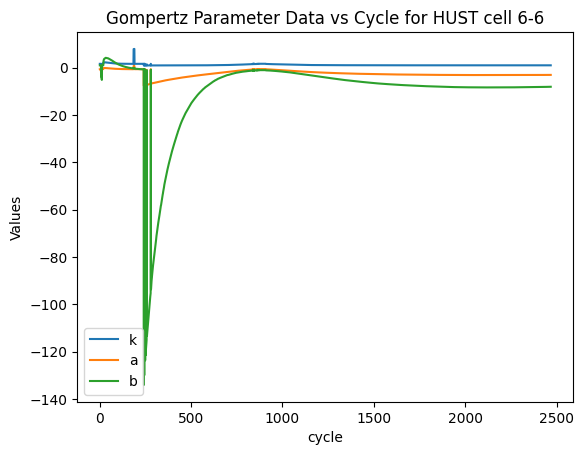

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns


choice = "6-6"
gompertz_df_full = pd.read_csv("/kaggle/input/generate-hust-data-gompertz-k-a-b/"+choice+"-hust_gompertz_params.csv")
print(gompertz_df_full.head())
# Plot multiple columns vs Time on one plot
y_columns = ["k","a","b"]#,'rul']#,"rul"]  # choose the columns to plot

for col in y_columns:
    # plt.plot(gompertz_df["cycle"], gompertz_df[col], label=col)
    plt.plot(gompertz_df_full["Cycle number"], gompertz_df_full[col], label=col)

plt.xlabel("cycle")
plt.ylabel("Values")
# Use log scale on y-axis (common in battery/fade plots)
#plt.yscale("log")
plt.title(f"Gompertz Parameter Data vs Cycle for HUST cell {choice}")
plt.legend()
plt.show()

In [2]:
print(gompertz_df_full.head(50))

    Cycle number         k         a         b   rul  max_SoC_above_80  \
0              1  1.622990 -0.677557  1.000168  2468         32.324931   
1              2  1.616820 -0.646415  1.000241  2467         32.324931   
2              3  1.617632 -0.632712  1.000316  2466         32.324931   
3              4  1.619295 -0.625137  1.000392  2465         32.324931   
4              5  1.621317 -0.619797  1.000468  2464         32.324931   
5              6  1.623402 -0.615708  1.000545  2463         32.324931   
6              7  1.625409 -0.612327  1.000622  2462         32.324931   
7              8  1.045990 -2.290637 -3.707530  2461         32.324931   
8              9  1.075261 -2.049221 -3.086277  2460         32.324931   
9             10  1.059410 -2.172314 -3.879210  2459         32.324931   
10            11  1.050066 -2.254654 -4.360821  2458         32.324931   
11            12  1.049851 -2.258442 -5.151233  2457         32.324931   
12            13  1.635584 -0.600671  

In [3]:
import os
os.makedirs('Parameter-Plots/',exist_ok=True)

In [4]:
# help(plt.savefig)

      Cycle number         k         a         b  rul  max_SoC_above_80  \
2463          2464  0.999838 -3.048204 -8.066355    5         32.324931   
2464          2465  0.999866 -3.047716 -8.064393    4         32.324931   
2465          2466  0.999892 -3.047267 -8.062584    3         32.324931   
2466          2467  0.999919 -3.046795 -8.060686    2         32.324931   
2467          2468  0.999947 -3.046302 -8.058702    1         32.324931   

           SoH  gompertz-value  gompertz-1st-derivative-value  \
2463  0.710894        0.953327                      -0.366313   
2464  0.710895        0.953368                      -0.366123   
2465  0.710419        0.953409                      -0.365925   
2466  0.710419        0.953449                      -0.365732   
2467  0.710418        0.953491                      -0.365544   

      gompertz-2nd-derivative-value  
2463                      -2.814058  
2464                      -2.811955  
2465                      -2.809860  
2466  

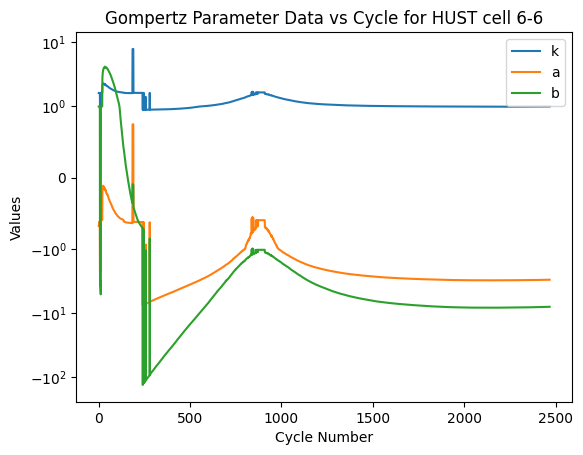

In [5]:
print(gompertz_df_full.tail())
# Plot multiple columns vs Time on one plot
y_columns = ["k","a","b"]#,'rul']#,"rul"]  # choose the columns to plot

for col in y_columns:
    # plt.plot(gompertz_df["cycle"], gompertz_df[col], label=col)
    plt.plot(gompertz_df_full["Cycle number"], gompertz_df_full[col], label=col)

plt.xlabel("Cycle Number")
plt.ylabel("Values")
# Use log scale on y-axis (common in battery/fade plots)
#plt.yscale("log")
plt.yscale('symlog', linthresh=1)
plt.title(f"Gompertz Parameter Data vs Cycle for HUST cell {choice}")
plt.legend()
plt.savefig(f"Parameter-Plots/HUST-cell-{choice}.png",dpi=300,format='png')
plt.show()

In [6]:
#Get List of CSVs
files = os.listdir("/kaggle/input/generate-hust-data-gompertz-k-a-b")
#Filter out non-csv files, folders or csv that don't start with a digit
import re
filtered = [f for f in files if re.match(r'^\d', f) and f.endswith('.csv')]
print(len(filtered))

77


In [7]:
pairs = [re.match(r'^(\d+-\d+)', f).group(1) for f in filtered]
print(pairs)

['6-6', '8-7', '8-6', '9-1', '10-1', '6-8', '8-8', '10-7', '3-5', '5-1', '5-5', '7-1', '2-7', '10-6', '4-7', '7-7', '7-6', '4-5', '9-2', '10-4', '3-1', '9-7', '8-1', '10-8', '8-4', '4-6', '4-4', '3-8', '5-4', '9-6', '10-5', '7-8', '5-2', '9-8', '1-2', '5-6', '10-2', '2-6', '6-1', '2-4', '1-4', '4-1', '1-6', '6-2', '8-5', '5-7', '1-5', '1-8', '5-3', '6-5', '9-5', '4-8', '7-2', '2-5', '7-3', '9-3', '9-4', '8-2', '10-3', '6-3', '3-2', '7-5', '3-7', '2-3', '1-3', '8-3', '2-8', '7-4', '4-2', '6-4', '1-1', '3-3', '4-3', '3-4', '2-2', '1-7', '3-6']


In [8]:
cycle_lengths = []
cycle_lengths_sort = {}
#Correlation of k, a and b with cycle number
##Place k, a and b of all cells in all cycles in one dataframe
for choice in pairs:
    gompertz_df_full = pd.read_csv("/kaggle/input/generate-hust-data-gompertz-k-a-b/" + choice + "-hust_gompertz_params.csv")
    cycle_lengths.append(gompertz_df_full.shape[0])
    cycle_lengths_sort[choice] = gompertz_df_full.shape[0]
print(f"Max : {max(cycle_lengths)}, Min : {min(cycle_lengths)}")


#sort pairs by RUL
pairs = sorted(cycle_lengths_sort, key=cycle_lengths_sort.get)
print(pairs)

Max : 2689, Min : 1142
['4-3', '1-6', '7-3', '8-1', '8-5', '4-6', '2-5', '7-4', '10-8', '7-6', '5-7', '2-8', '4-4', '2-4', '1-4', '1-1', '4-5', '2-6', '5-5', '6-1', '3-3', '1-7', '8-8', '7-7', '7-1', '10-2', '10-1', '4-8', '6-4', '9-6', '2-3', '3-4', '4-2', '10-7', '6-3', '10-4', '10-3', '1-3', '7-5', '8-4', '9-3', '6-2', '5-2', '3-1', '7-8', '5-4', '1-5', '9-4', '9-7', '10-5', '7-2', '8-2', '8-7', '9-1', '9-2', '9-5', '6-5', '2-7', '4-7', '4-1', '3-2', '10-6', '1-8', '8-3', '9-8', '3-8', '8-6', '6-8', '5-6', '6-6', '3-7', '3-6', '5-1', '2-2', '3-5', '1-2', '5-3']


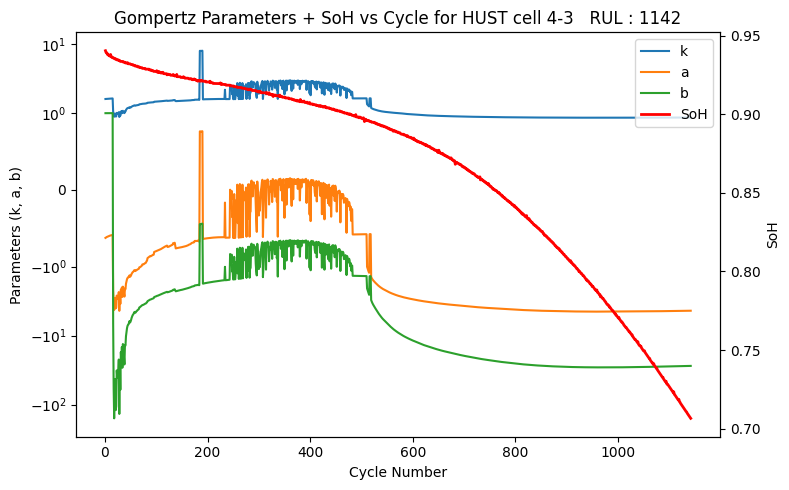

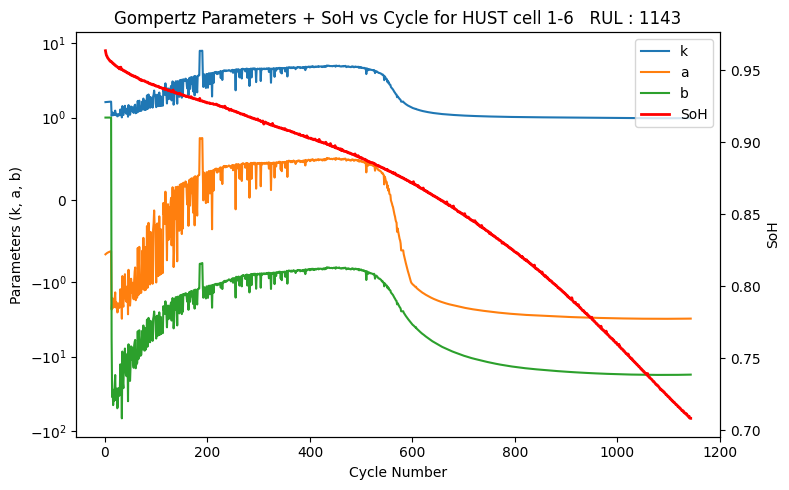

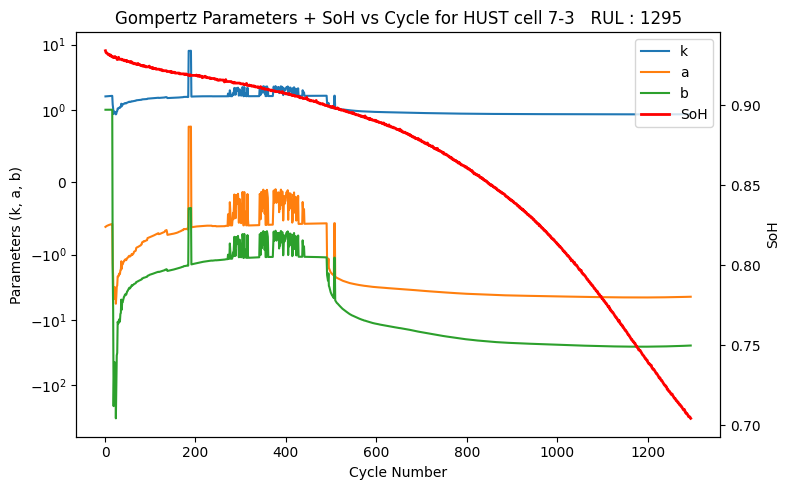

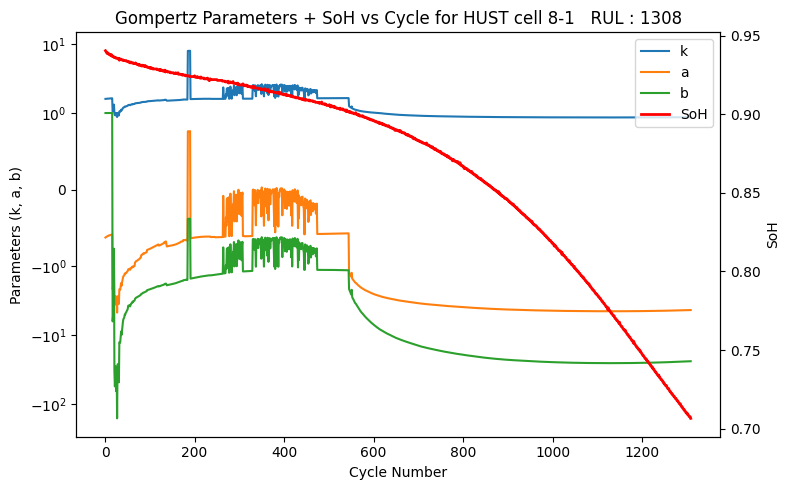

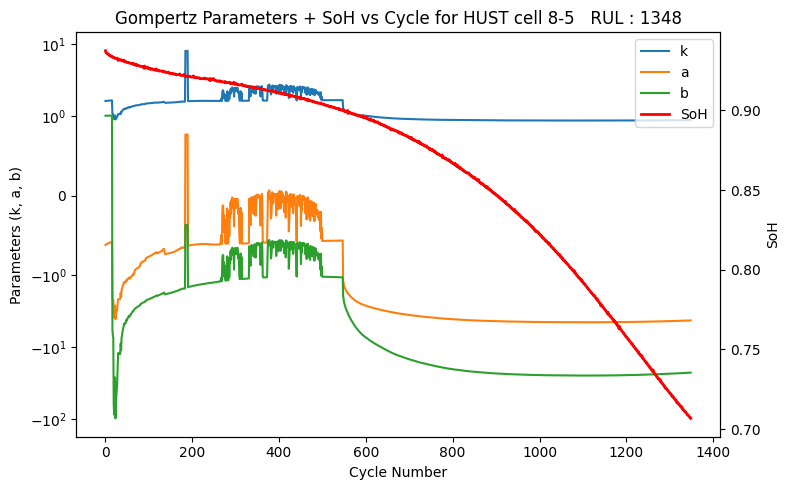

...

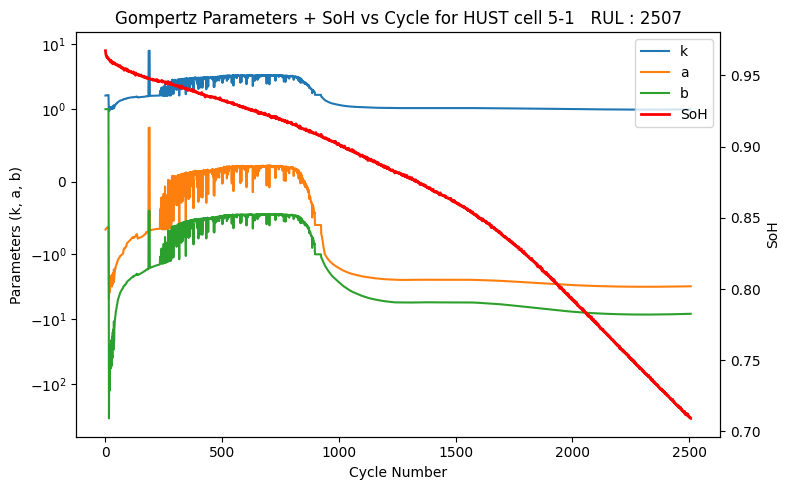

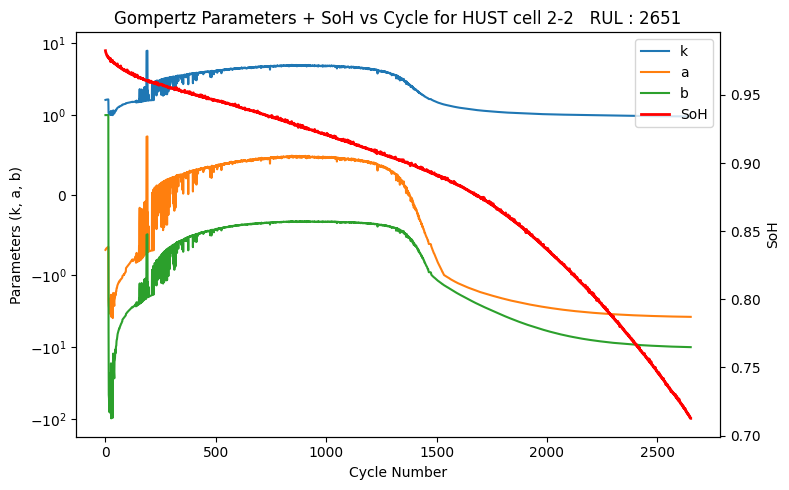

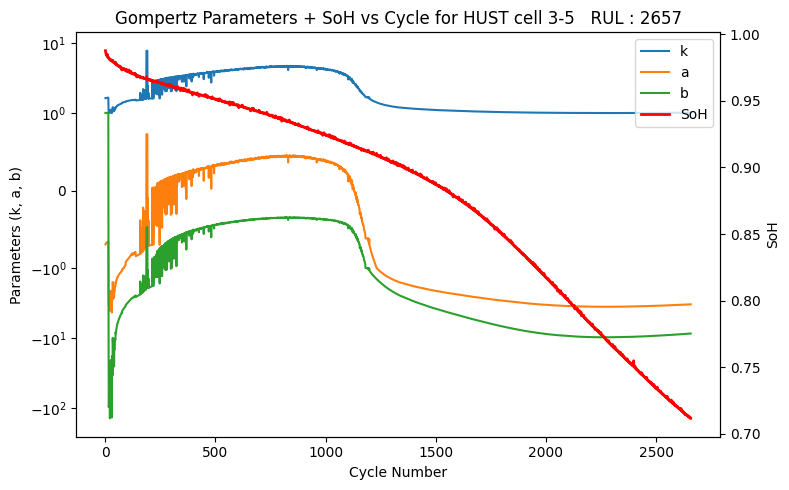

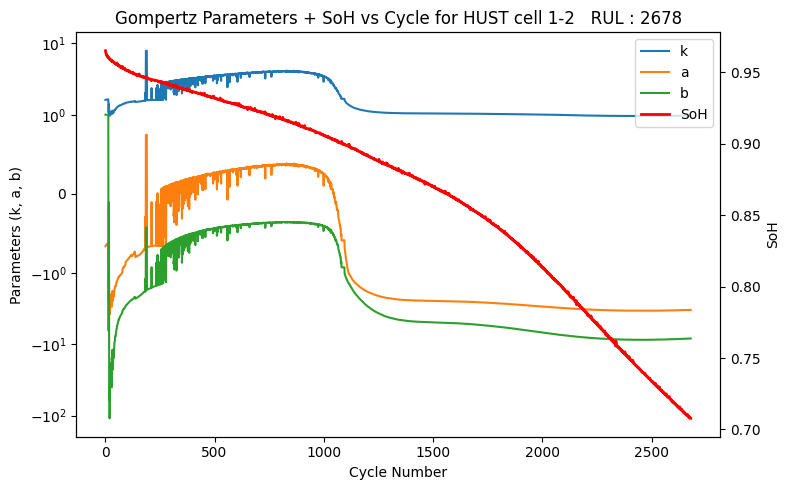

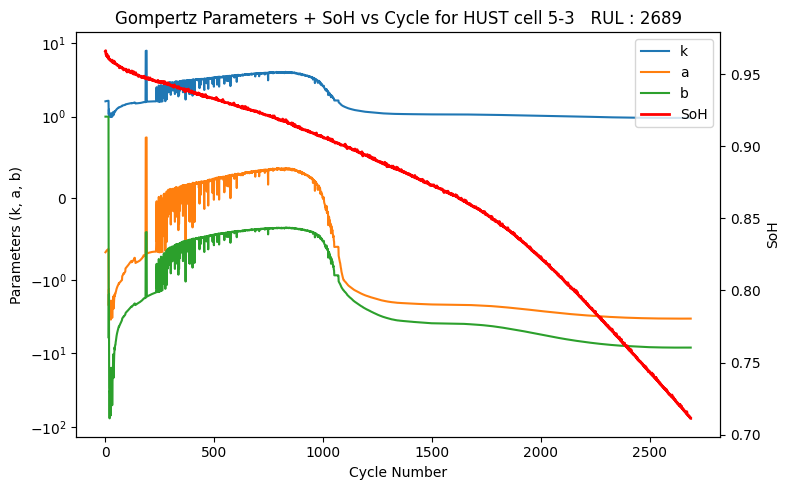

In [9]:
for choice in pairs:
    gompertz_df_full = pd.read_csv("/kaggle/input/generate-hust-data-gompertz-k-a-b/" + choice + "-hust_gompertz_params.csv")
    
    plt.figure(figsize=(8, 5))

    x = gompertz_df_full["Cycle number"]
    
    # --- Left axis ---
    ax1 = plt.gca()
    for col in ["k", "a", "b"]:
        ax1.plot(x, gompertz_df_full[col], label=col)
    
    ax1.set_xlabel("Cycle Number")
    ax1.set_ylabel("Parameters (k, a, b)")
    ax1.set_yscale('symlog', linthresh=1)
    
    # --- Right axis ---
    ax2 = ax1.twinx()
    ax2.plot(x, gompertz_df_full["SoH"], color="red", label="SoH", linewidth=2)
    ax2.set_ylabel("SoH")
    
    # --- Title ---
    plt.title(f"Gompertz Parameters + SoH vs Cycle for HUST cell {choice}   RUL : {cycle_lengths_sort[choice]}")
    
    # --- Combined legend ---
    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc="upper right")
    
    plt.tight_layout()
    plt.savefig(f"Parameter-Plots/HUST-cell-{choice}-Two-Y.png", dpi=300)
    plt.show()

    #break

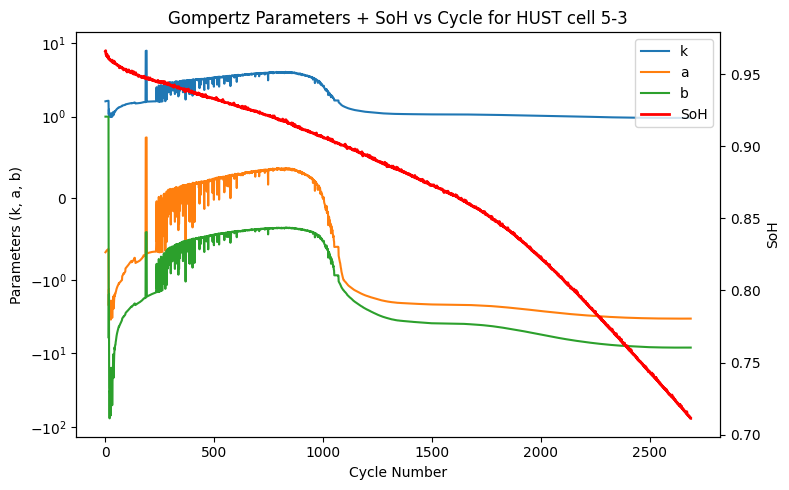

In [10]:
plt.figure(figsize=(8, 5))

x = gompertz_df_full["Cycle number"]

# --- Left axis ---
ax1 = plt.gca()
for col in ["k", "a", "b"]:
    ax1.plot(x, gompertz_df_full[col], label=col)

ax1.set_xlabel("Cycle Number")
ax1.set_ylabel("Parameters (k, a, b)")
ax1.set_yscale('symlog', linthresh=1)

# --- Right axis ---
ax2 = ax1.twinx()
ax2.plot(x, gompertz_df_full["SoH"], color="red", label="SoH", linewidth=2)
ax2.set_ylabel("SoH")

# --- Title ---
plt.title(f"Gompertz Parameters + SoH vs Cycle for HUST cell {choice}")

# --- Combined legend ---
lines_1, labels_1 = ax1.get_legend_handles_labels()
lines_2, labels_2 = ax2.get_legend_handles_labels()
ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc="upper right")

plt.tight_layout()
plt.savefig(f"Parameter-Plots/HUST-cell-{choice}-Two-Y.png", dpi=300)
plt.show()


In [11]:
unified_gompertz = {}
for choice in pairs:
    #get file
    gompertz_df_full = pd.read_csv("/kaggle/input/generate-hust-data-gompertz-k-a-b/" + choice + "-hust_gompertz_params.csv")
    #add cell name
    gompertz_df_full['cell_name'] = [choice]*gompertz_df_full.shape[0]
    for i in range(1,max(cycle_lengths)+1,1):
        try:
            temp_data = gompertz_df_full[gompertz_df_full["Cycle number"]==i].iloc[0].to_dict()
        except:
            temp_data = {'Cycle number': i, 'k': None, 'a': None,'b': None, 'rul': None, 'max_SoC_above_80': None,'SoH': None, 'cell_name': choice}
        try:
            unified_gompertz[str(i)].append(temp_data)
        except:
            unified_gompertz[str(i)] = []
            unified_gompertz[str(i)].append(temp_data)
##plot correlation of k, a and b with rul

## plot correlation of k, a and b with rul at different SoH values 

In [12]:
cycle_lengths_sort

{'6-6': 2468,
 '8-7': 2047,
 '8-6': 2365,
 '9-1': 2057,
 '10-1': 1702,
 '6-8': 2450,
 '8-8': 1679,
 '10-7': 1783,
 '3-5': 2657,
 '5-1': 2507,
 '5-5': 1583,
 '7-1': 1690,
 '2-7': 2202,
 '10-6': 2285,
 '4-7': 2216,
 '7-7': 1685,
 '7-6': 1419,
 '4-5': 1561,
 '9-2': 2143,
 '10-4': 1811,
 '3-1': 1938,
 '9-7': 2012,
 '8-1': 1308,
 '10-8': 1400,
 '8-4': 1885,
 '4-6': 1380,
 '4-4': 1491,
 '3-8': 2342,
 '5-4': 1962,
 '9-6': 1742,
 '10-5': 2030,
 '7-8': 1938,
 '5-2': 1926,
 '9-8': 2308,
 '1-2': 2678,
 '5-6': 2460,
 '10-2': 1697,
 '2-6': 1572,
 '6-1': 1609,
 '2-4': 1499,
 '1-4': 1500,
 '4-1': 2217,
 '1-6': 1143,
 '6-2': 1908,
 '8-5': 1348,
 '5-7': 1448,
 '1-5': 1971,
 '1-8': 2285,
 '5-3': 2689,
 '6-5': 2178,
 '9-5': 2168,
 '4-8': 1706,
 '7-2': 2030,
 '2-5': 1386,
 '7-3': 1295,
 '9-3': 1905,
 '9-4': 1975,
 '8-2': 2041,
 '10-3': 1848,
 '6-3': 1804,
 '3-2': 2283,
 '7-5': 1875,
 '3-7': 2479,
 '2-3': 1751,
 '1-3': 1858,
 '8-3': 2290,
 '2-8': 1481,
 '7-4': 1393,
 '4-2': 1782,
 '6-4': 1717,
 '1-1': 1504

In [13]:
for k in unified_gompertz.keys():
    unified_gompertz[k] = pd.DataFrame(unified_gompertz[k])
# df_unified_gompertz = pd.DataFrame([unified_gompertz])
# df_unified_gompertz.head()

In [14]:
unified_gompertz['100'].dtypes

Cycle number                       int64
k                                float64
a                                float64
b                                float64
rul                                int64
max_SoC_above_80                 float64
SoH                              float64
gompertz-value                   float64
gompertz-1st-derivative-value    float64
gompertz-2nd-derivative-value    float64
cell_name                         object
dtype: object

In [15]:
unified_gompertz['100'][['Cycle number','k','a','b','rul','max_SoC_above_80','SoH']].corr()

/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1458: RuntimeWarning: invalid value encountered in greater
  has_large_values = (abs_vals > 1e6).any()
/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1459: RuntimeWarning: invalid value encountered in less
  has_small_values = ((abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)).any()
/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1459: RuntimeWarning: invalid value encountered in greater
  has_small_values = ((abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)).any()


,Cycle number,k,a,b,rul,max_SoC_above_80,SoH
Cycle number,NaN,NaN,NaN,NaN,NaN,NaN,NaN
k,NaN,1.000000,0.963861,0.984219,0.100226,0.616616,0.486085
a,NaN,0.963861,1.000000,0.978630,-0.064108,0.392605,0.248209
b,NaN,0.984219,0.978630,1.000000,0.055912,0.536499,0.422517
rul,NaN,0.100226,-0.064108,0.055912,1.000000,0.485320,0.620789
max_SoC_above_80,NaN,0.616616,0.392605,0.536499,0.485320,1.000000,0.951608
SoH,NaN,0.486085,0.248209,0.422517,0.620789,0.951608,1.000000


In [16]:
unified_gompertz['1'][['SoH']].max(),unified_gompertz['1'][['SoH']].min()

(SoH    0.987695
 dtype: float64,
 SoH    0.93409
 dtype: float64)

In [17]:
unified_gompertz['2'].head(50)

,Cycle number,k,a,b,rul,max_SoC_above_80,SoH,gompertz-value,gompertz-1st-derivative-value,gompertz-2nd-derivative-value,cell_name
0,2,1.607710,-0.621960,1.000243,1141,27.649002,0.939403,0.995835,0.477105,-0.248640,4-3
1,2,1.619494,-0.653543,1.000248,1142,30.534354,0.961753,1.018232,0.472623,-0.253367,1-6
2,2,1.604698,-0.613032,1.000242,1294,27.183925,0.933143,0.997000,0.474627,-0.248793,7-3
3,2,1.607858,-0.622400,1.000243,1307,27.679969,0.939956,1.004022,0.472898,-0.250276,8-1
4,2,1.606347,-0.617915,1.000243,1347,27.363420,0.936567,1.002849,0.472575,-0.249997,8-5
5,2,1.607511,-0.621369,1.000243,1379,27.269036,0.938987,1.006717,0.471251,-0.250770,4-6
6,2,1.610508,-0.629631,1.000240,1385,30.336403,0.931332,1.012767,0.469899,-0.251990,2-5
7,2,1.606014,-0.616927,1.000242,1392,27.358027,0.935867,1.004299,0.471598,-0.250260,7-4
8,2,1.612698,-0.635434,1.000245,1399,28.600341,0.949120,1.017526,0.468721,-0.252921,10-8
9,2,1.607886,-0.622485,1.000243,1418,27.587859,0.939785,1.009313,0.470102,-0.251259,7-6


6-6 2468


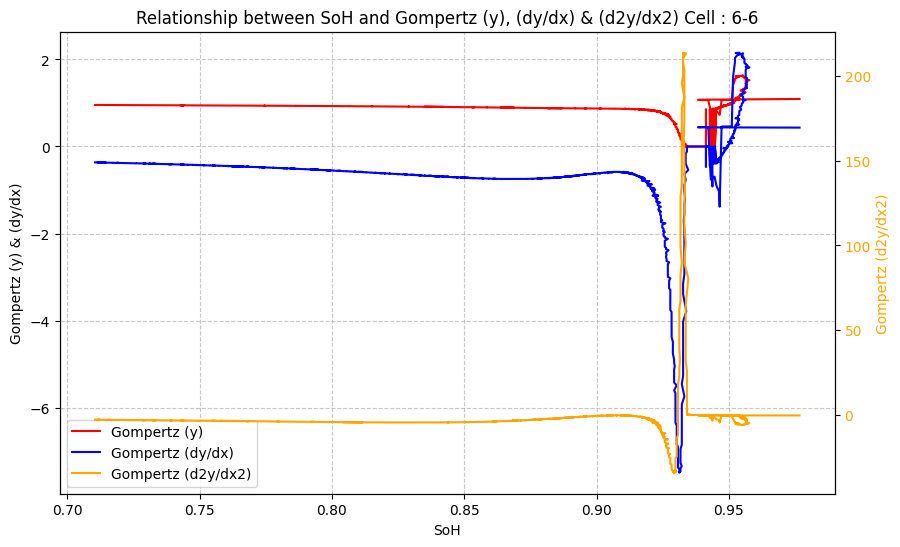

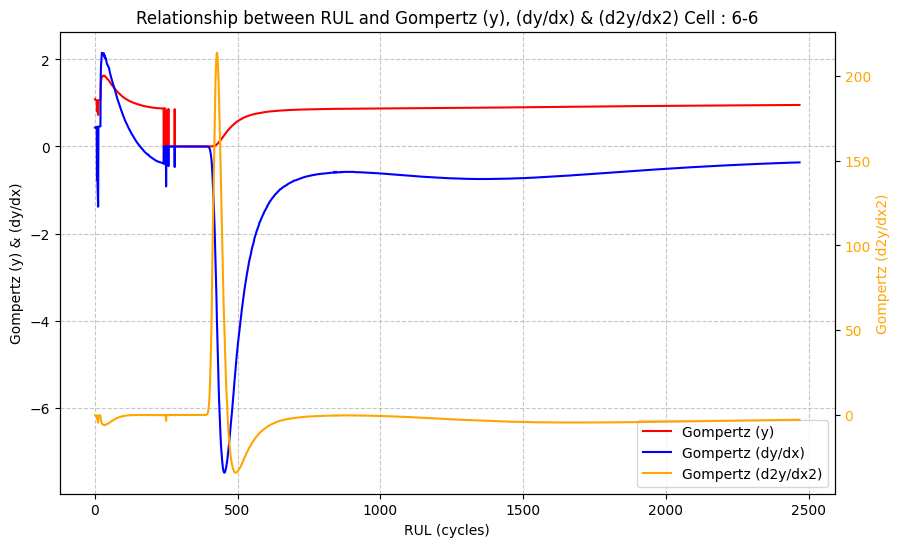

8-7 2047


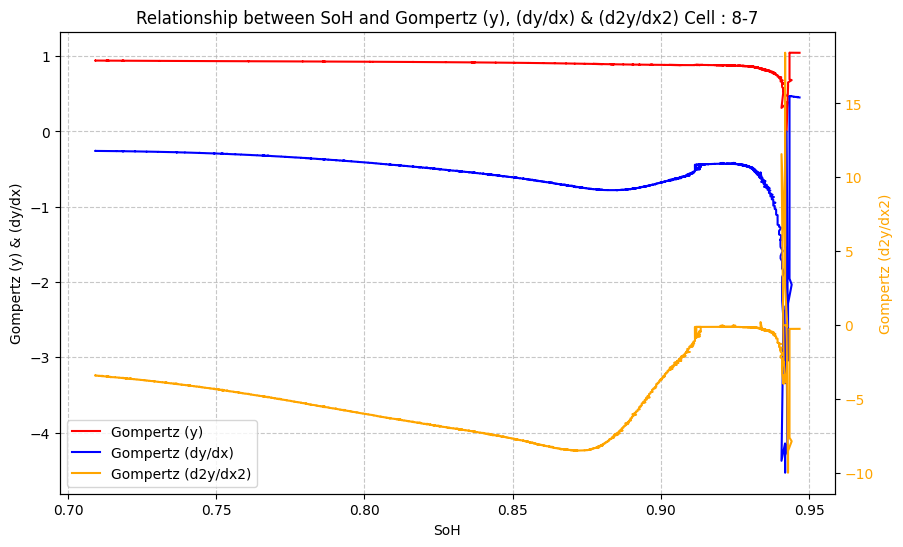

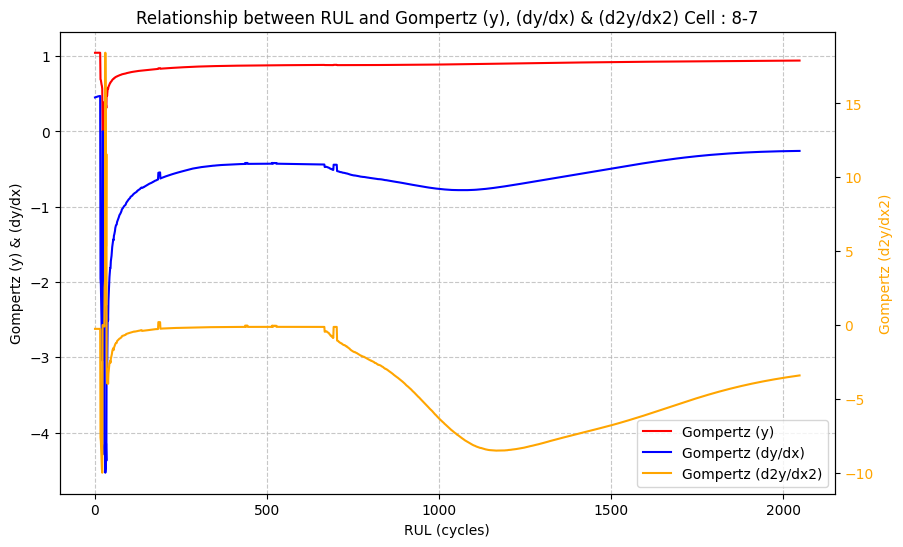

8-6 2365


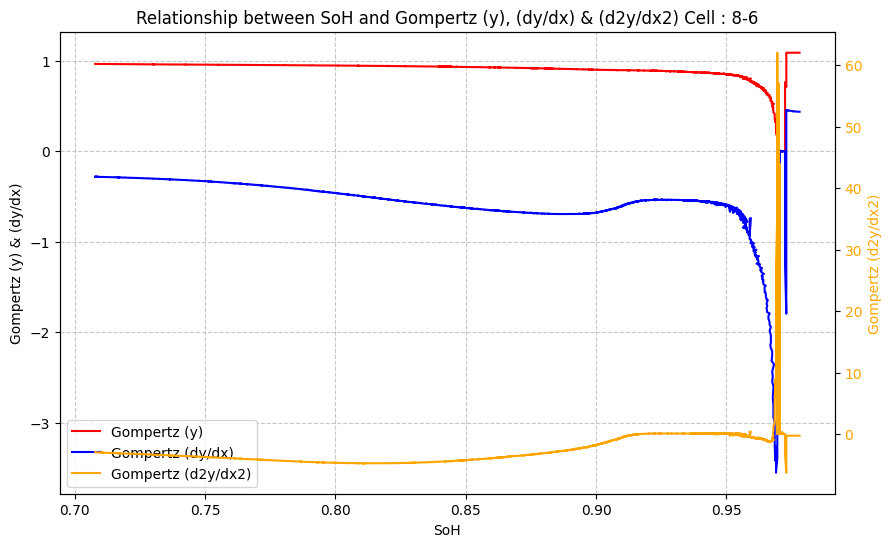

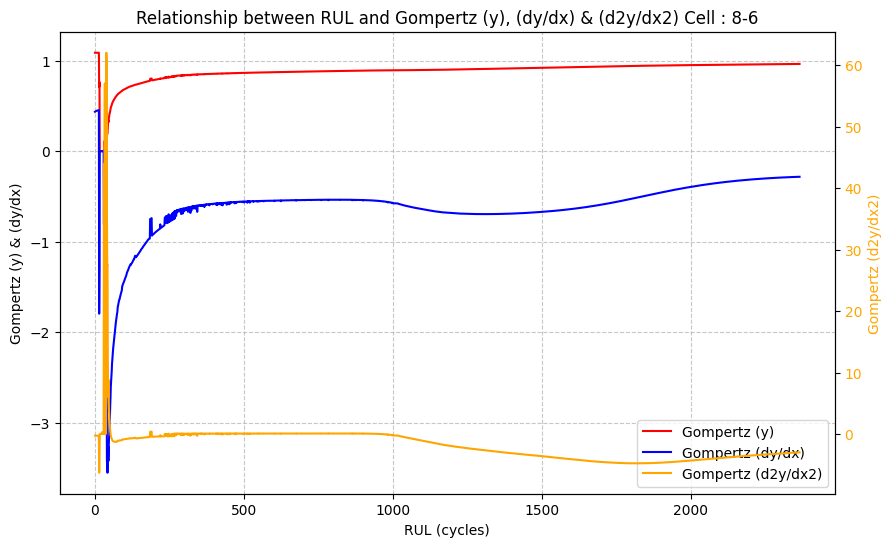

9-1 2057


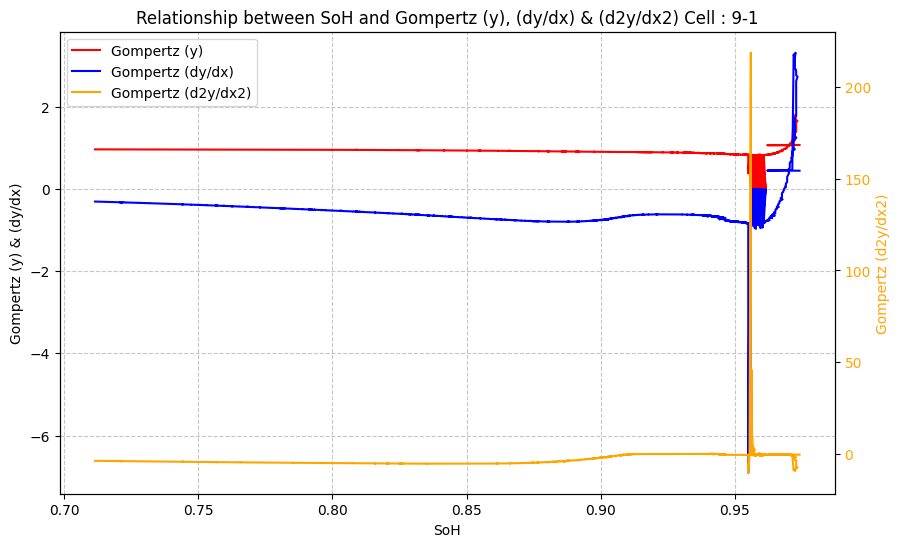

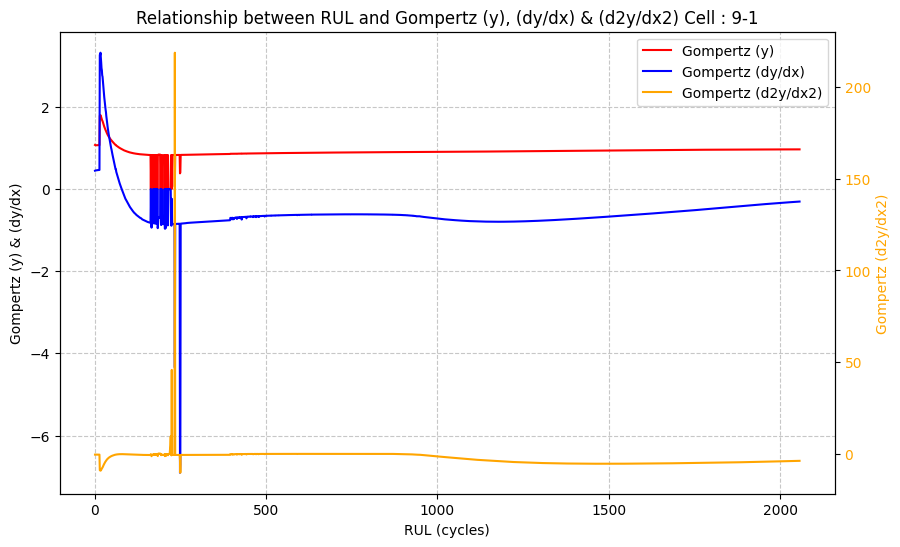

10-1 1702


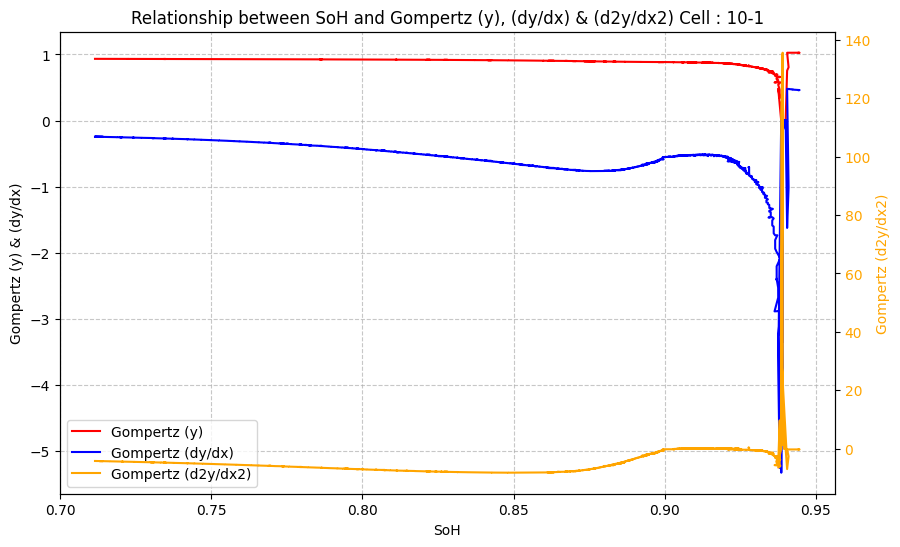

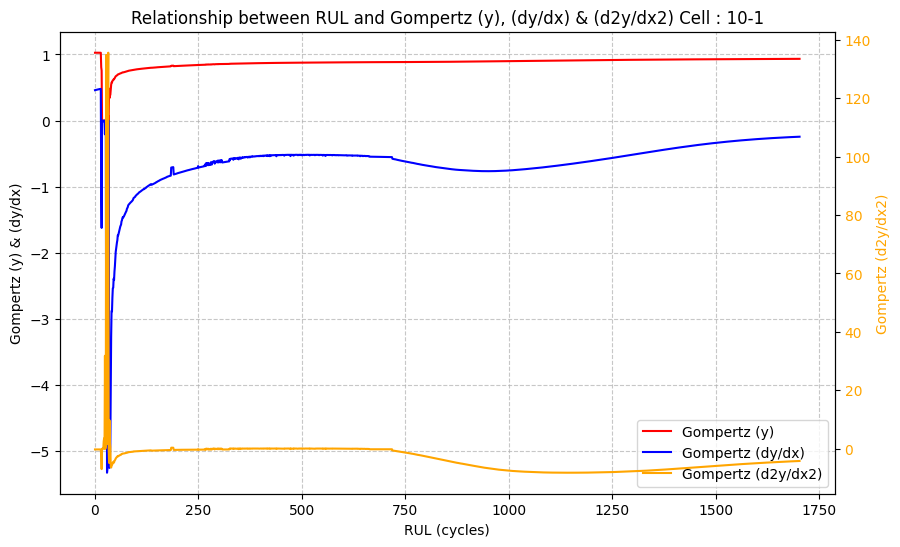

6-8 2450


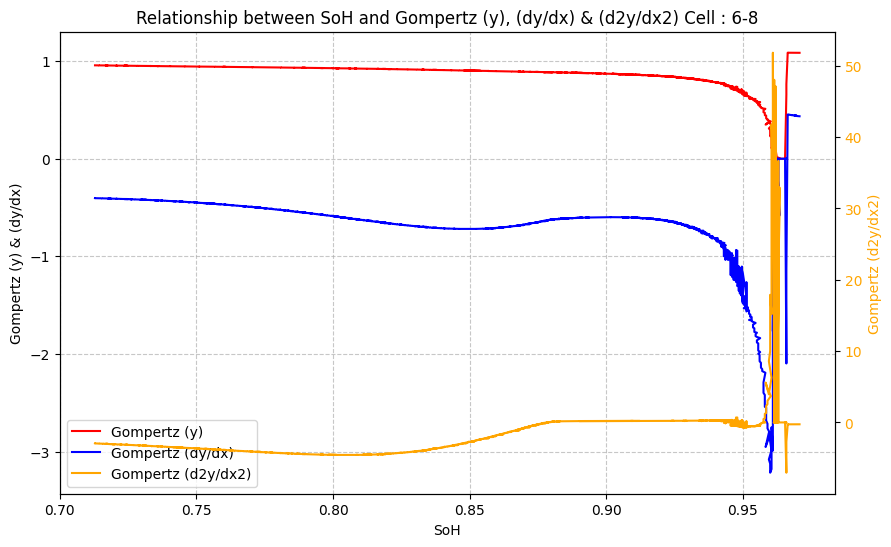

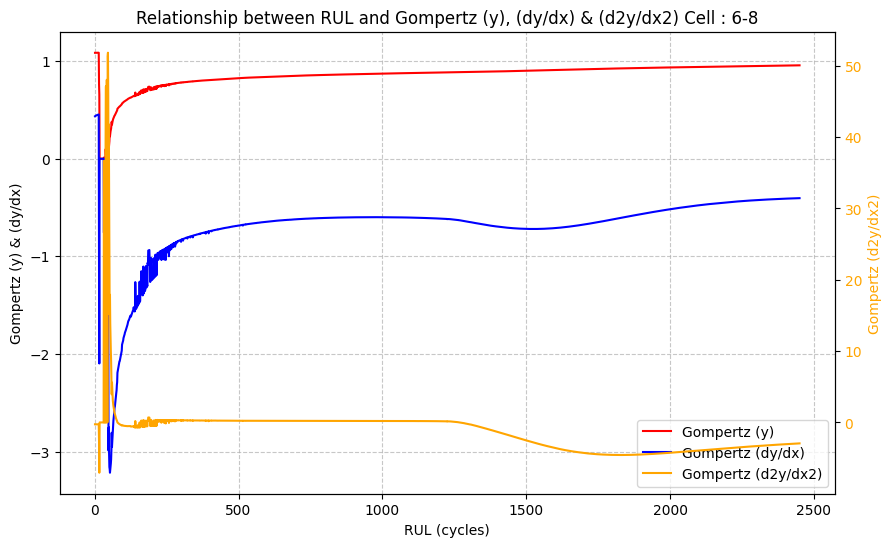

8-8 1679


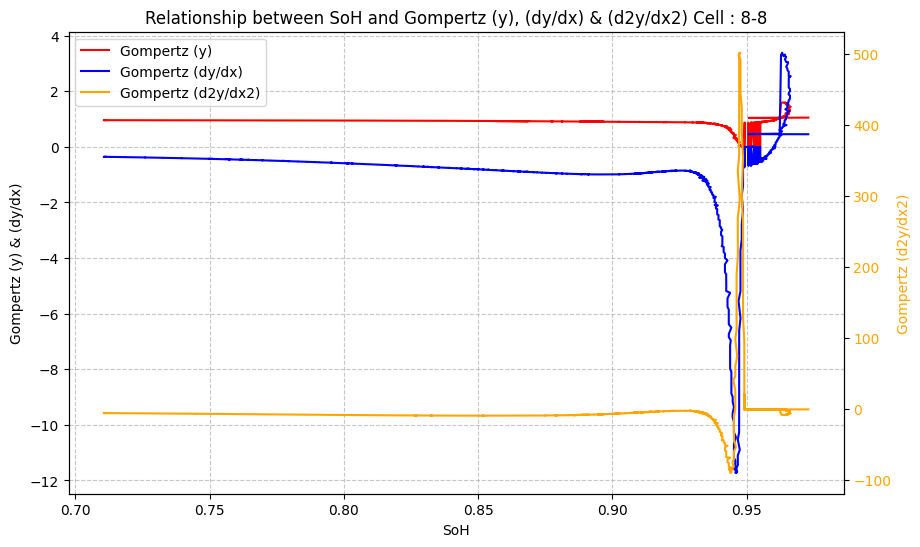

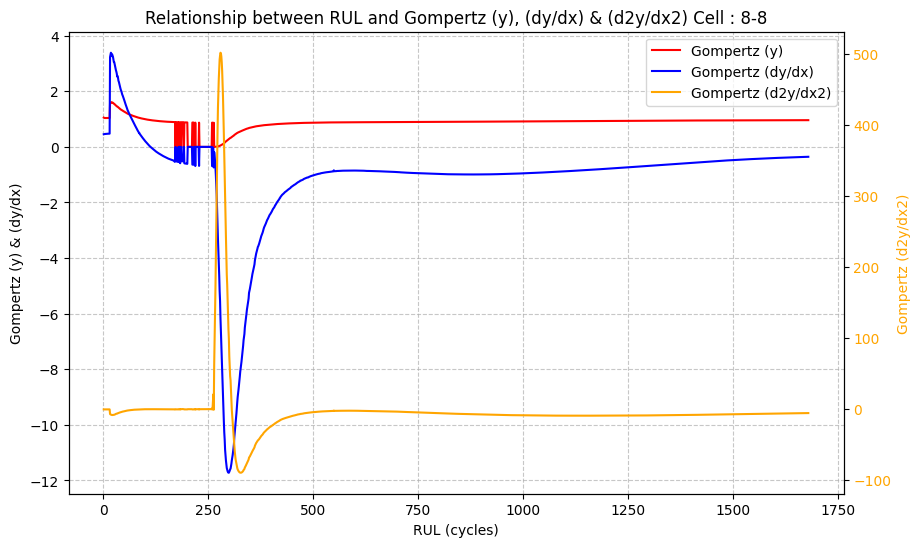

10-7 1783


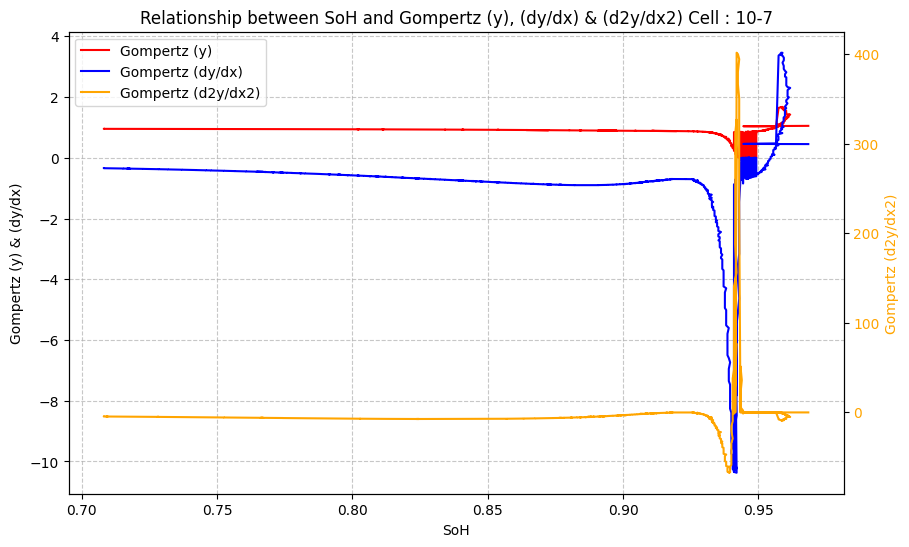

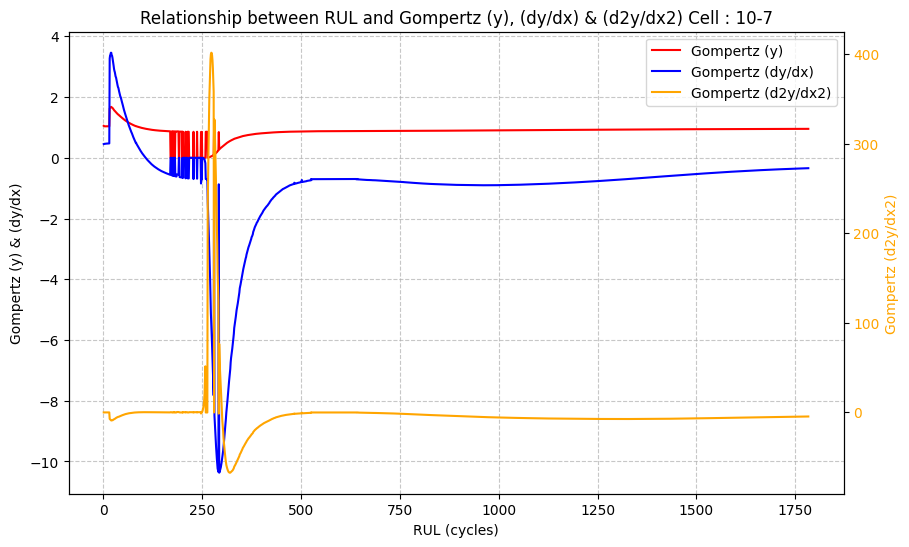

3-5 2657


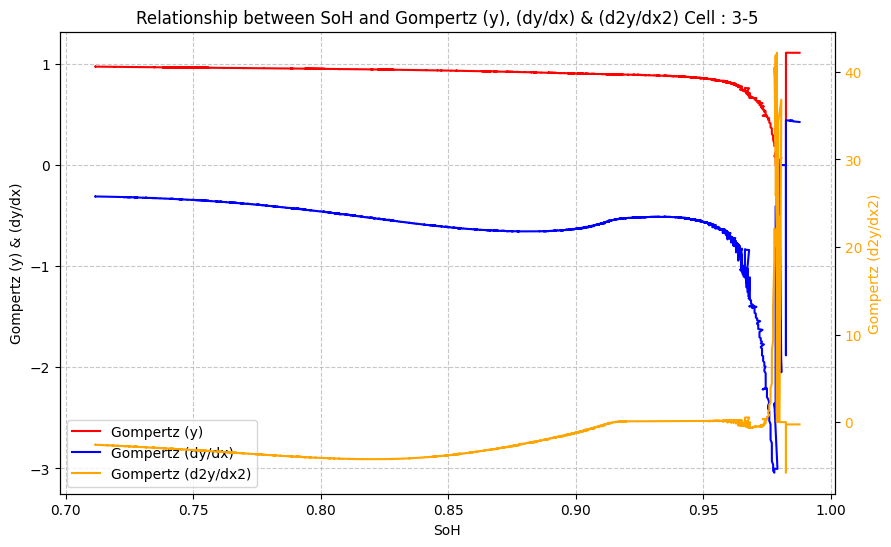

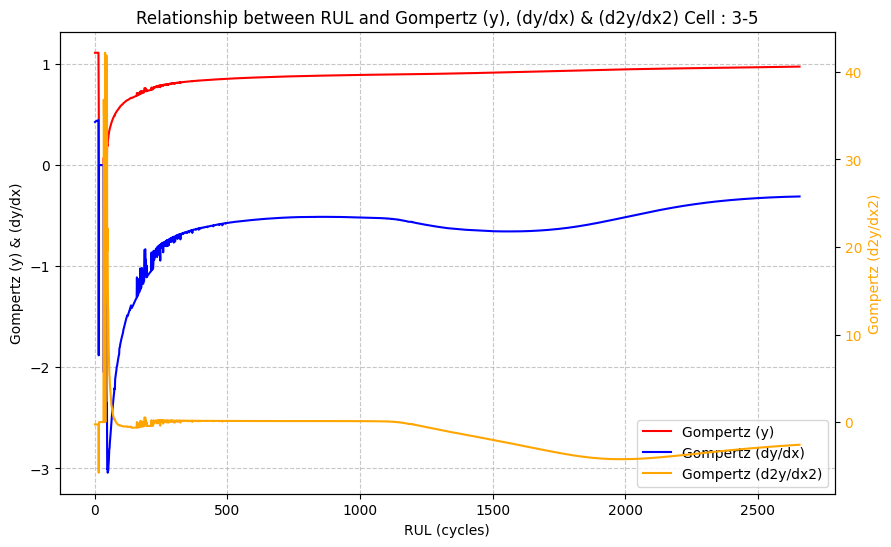

5-1 2507


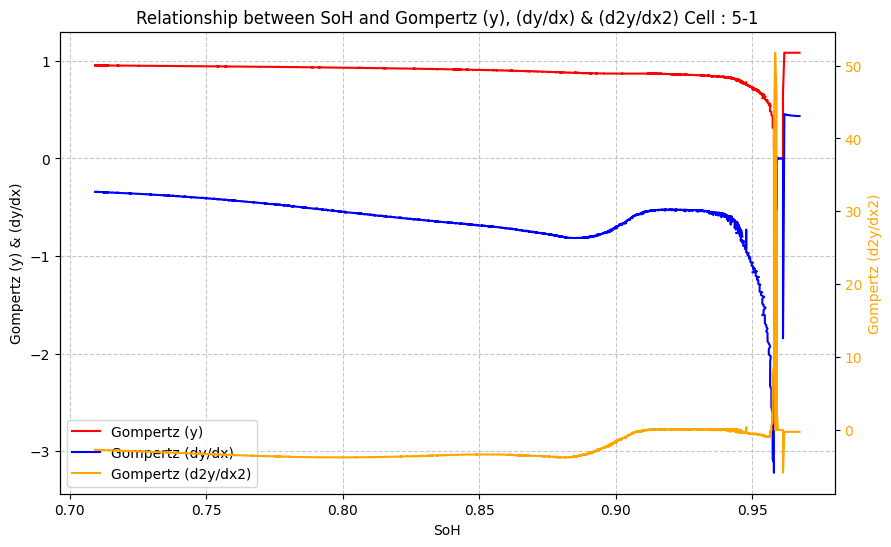

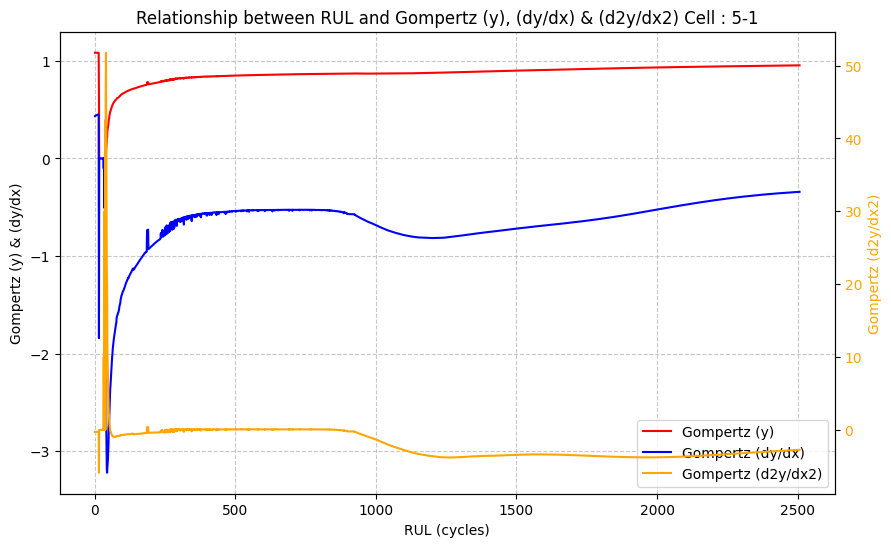

5-5 1583


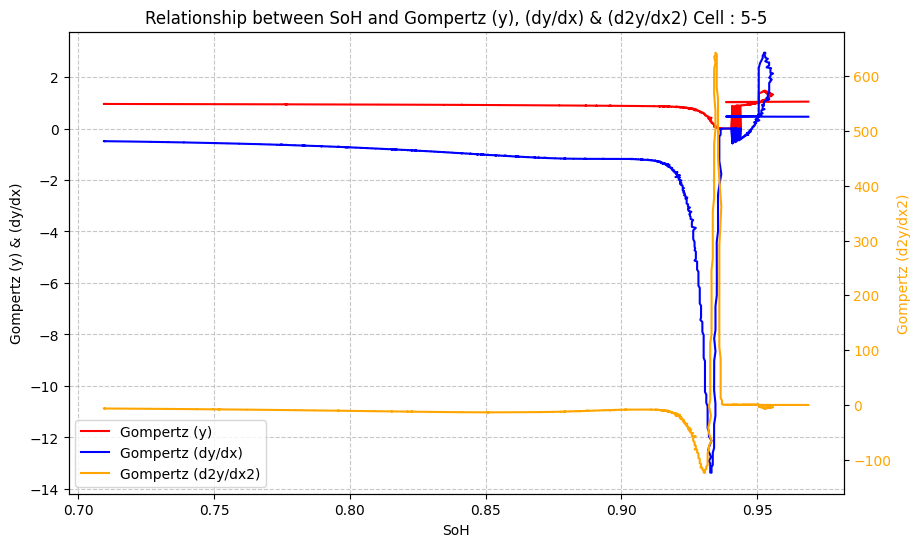

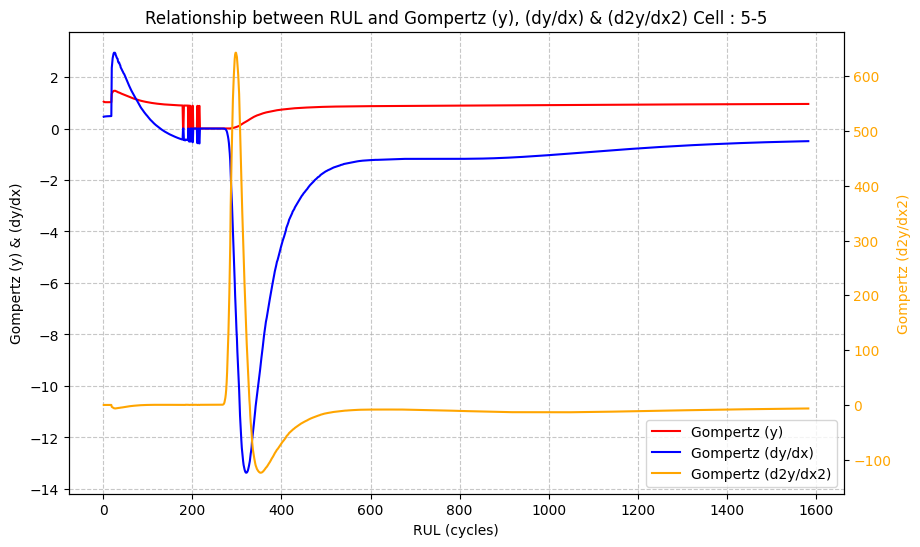

7-1 1690


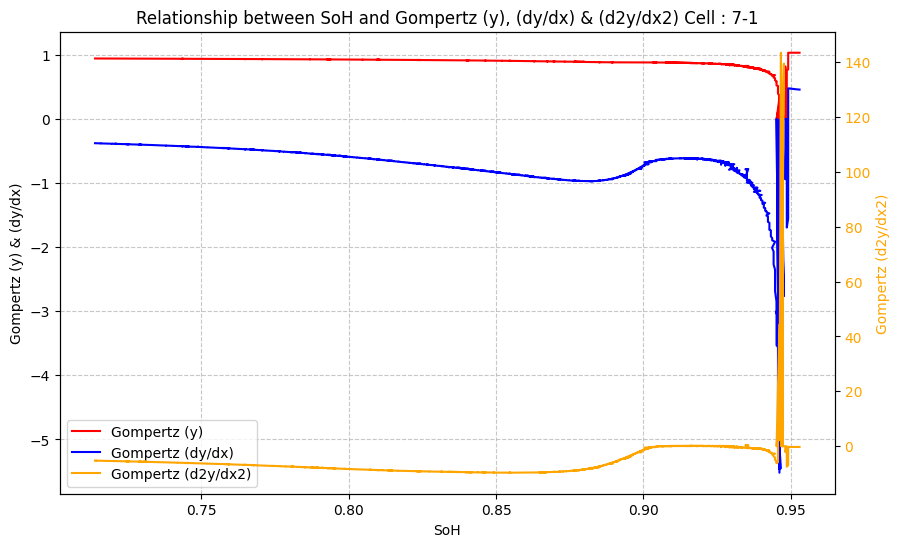

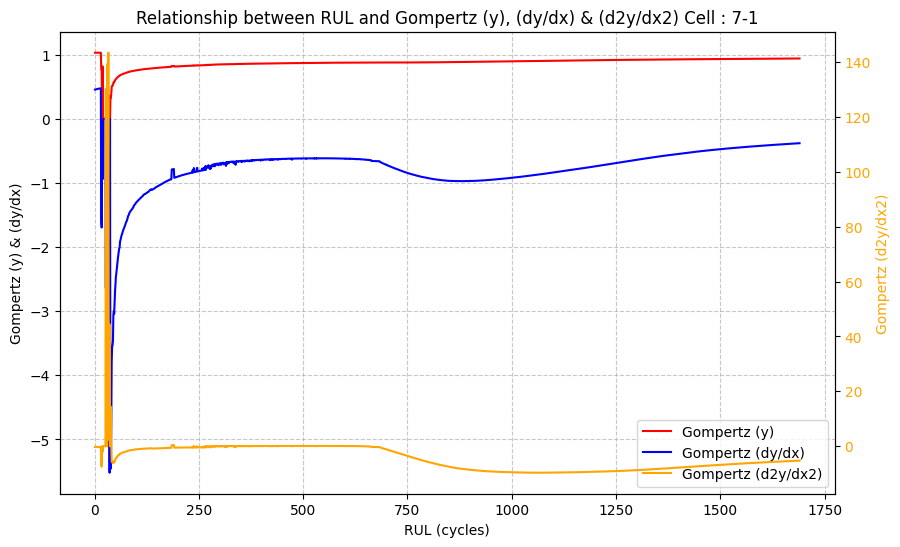

2-7 2202


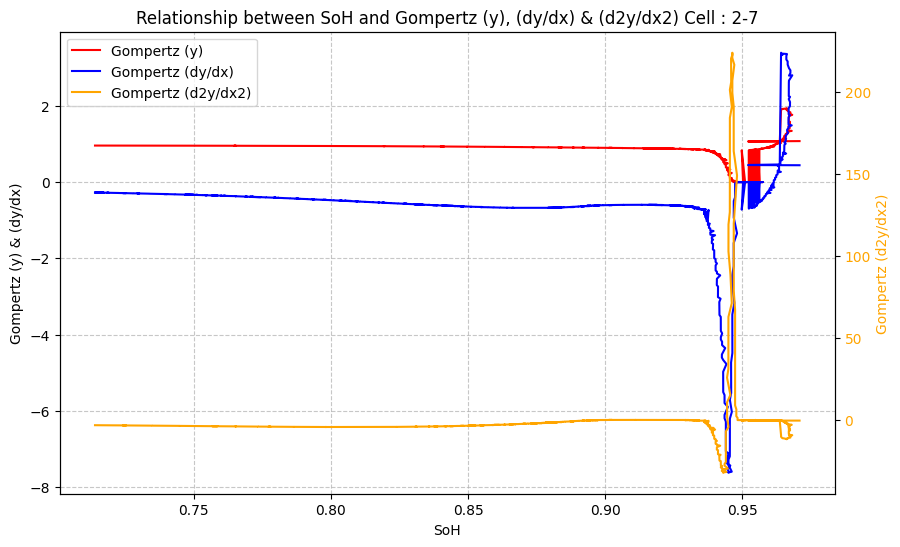

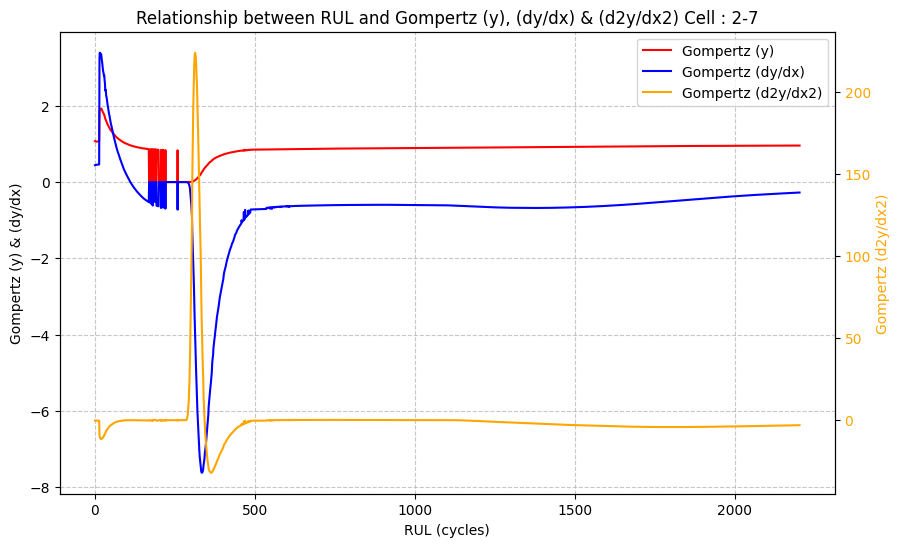

10-6 2285


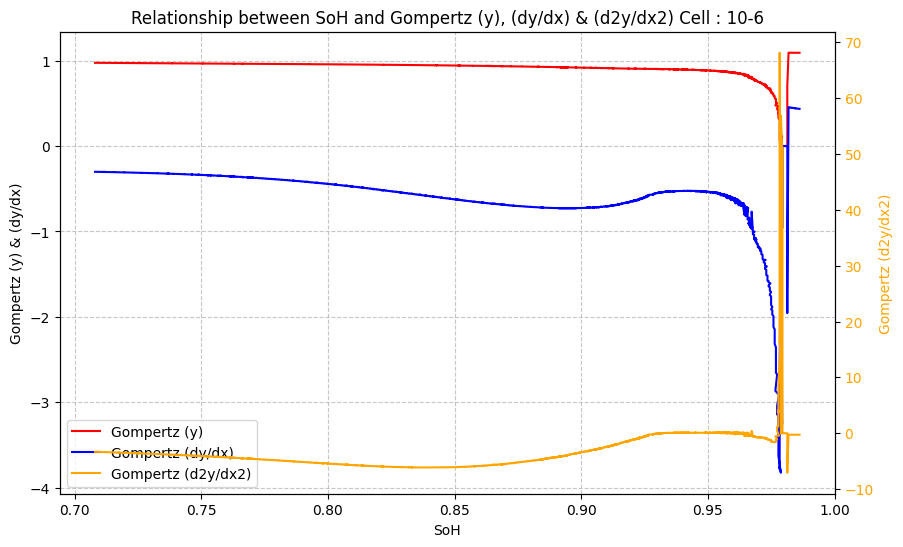

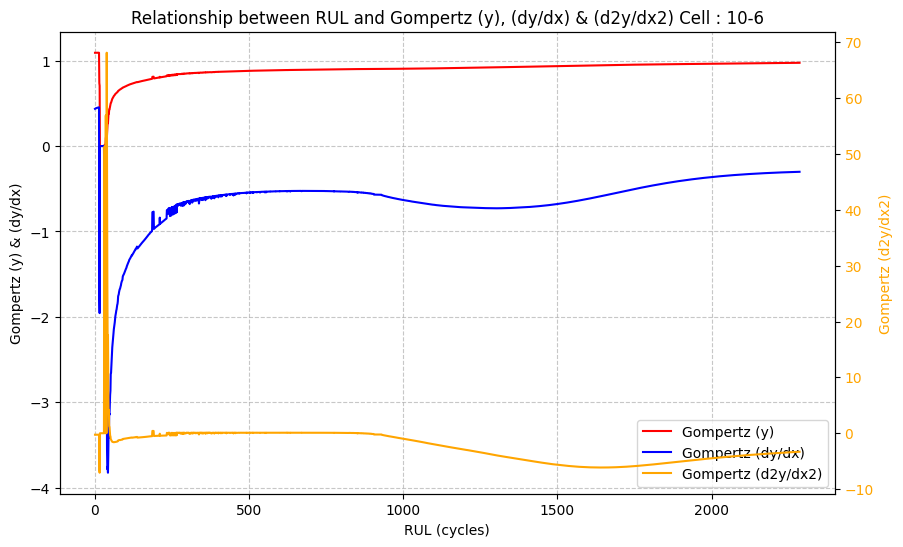

4-7 2216


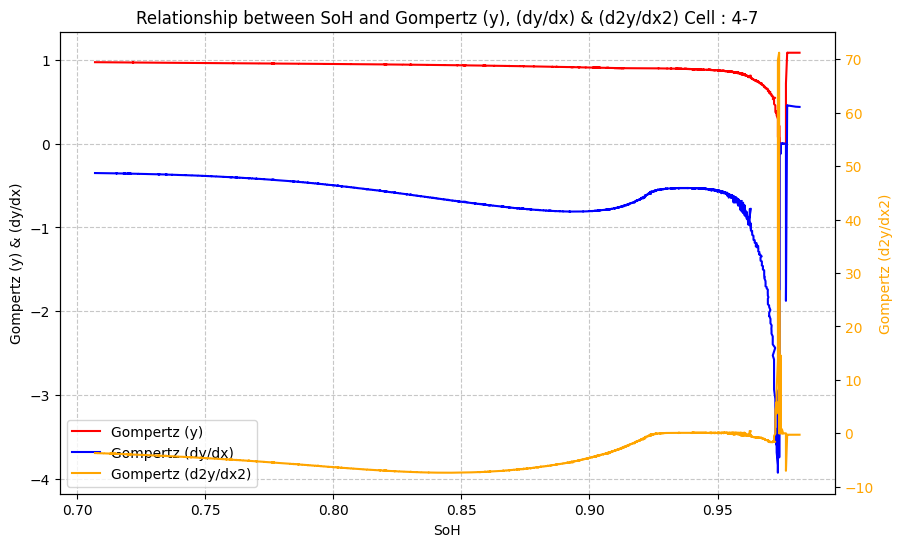

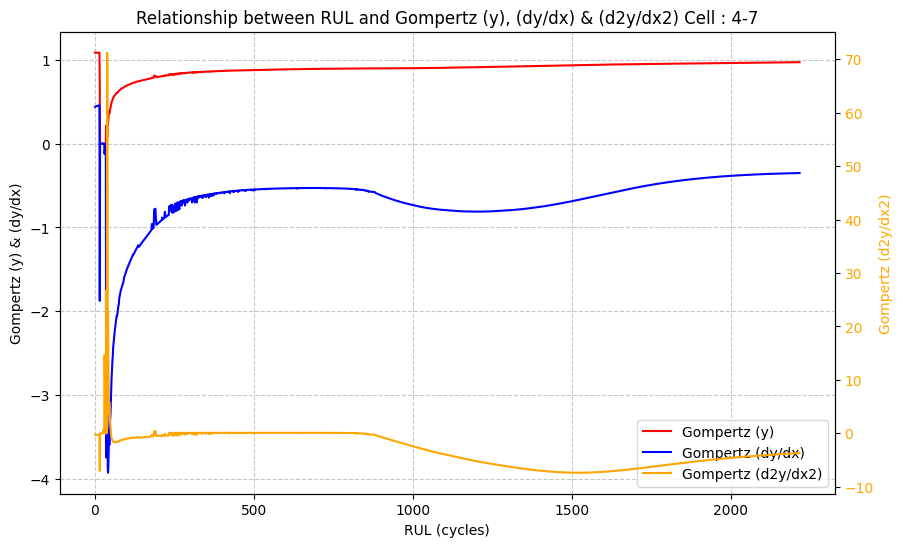

7-7 1685


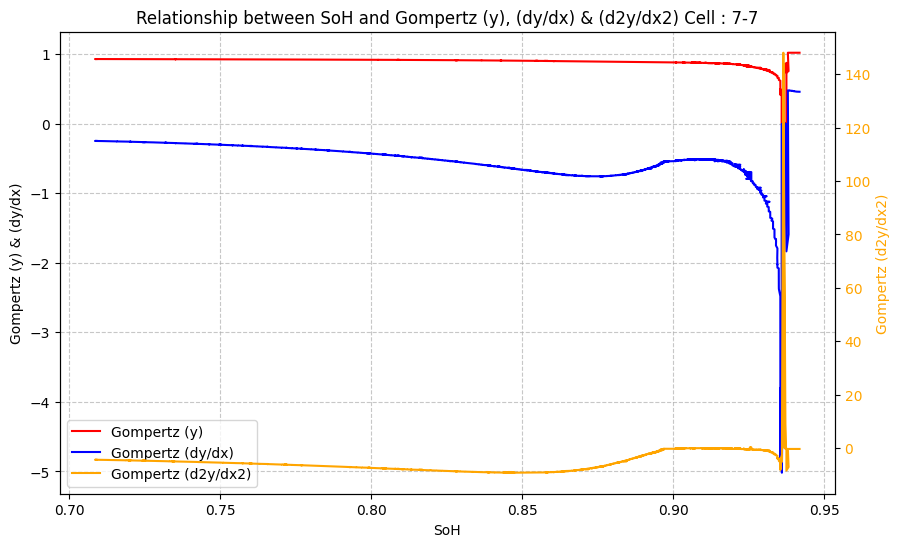

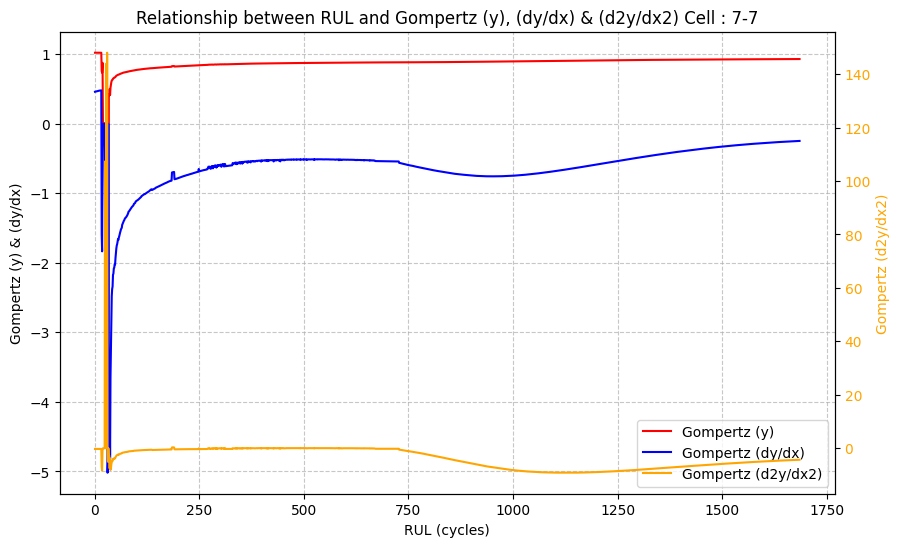

7-6 1419


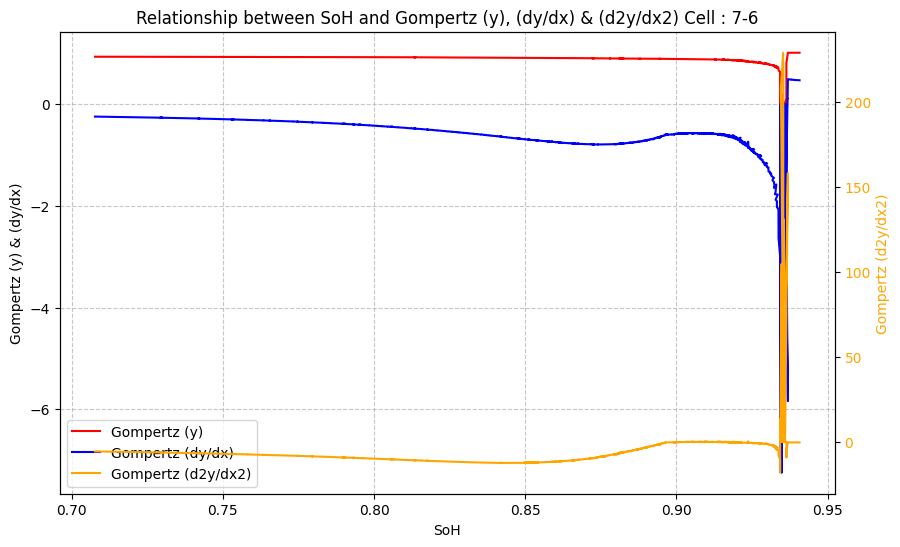

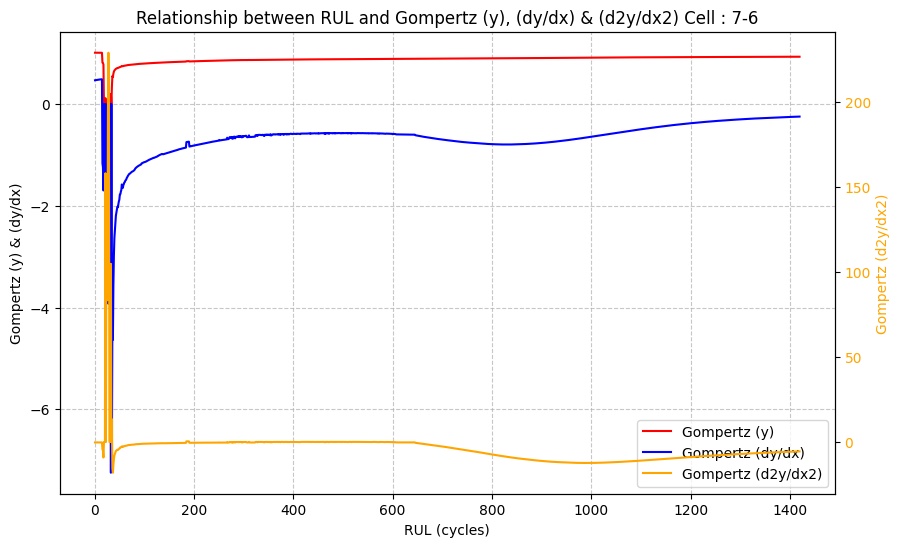

4-5 1561


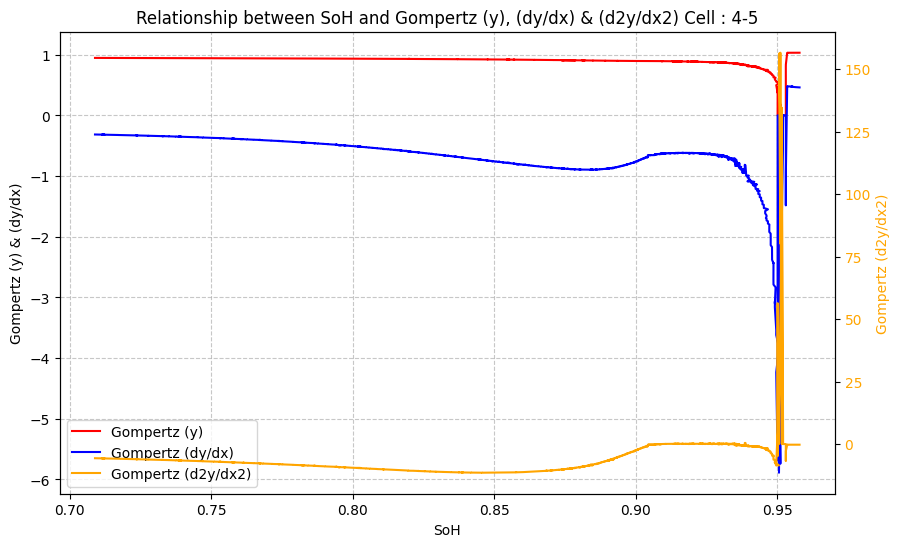

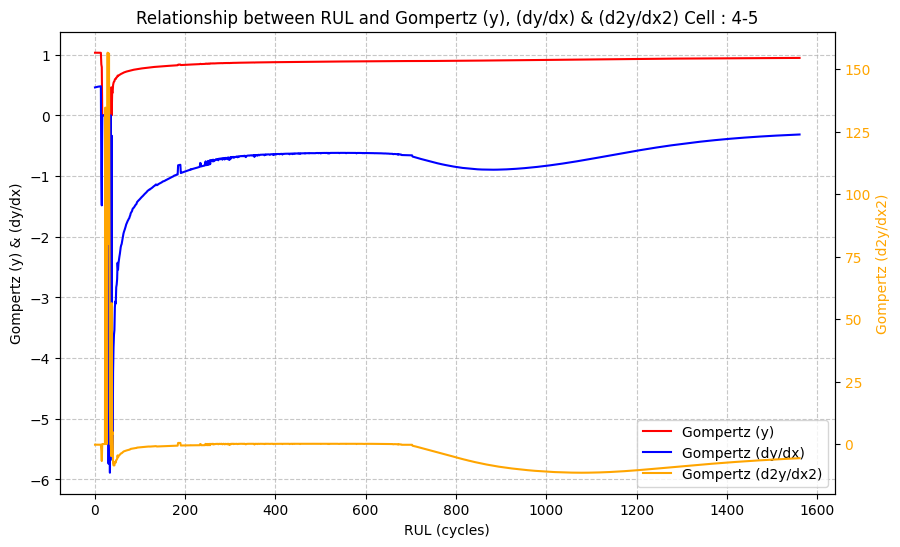

9-2 2143


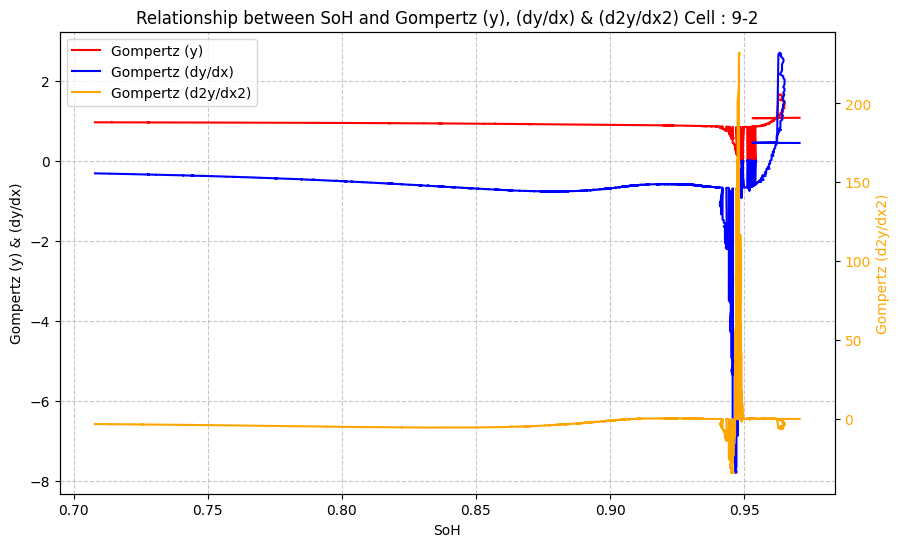

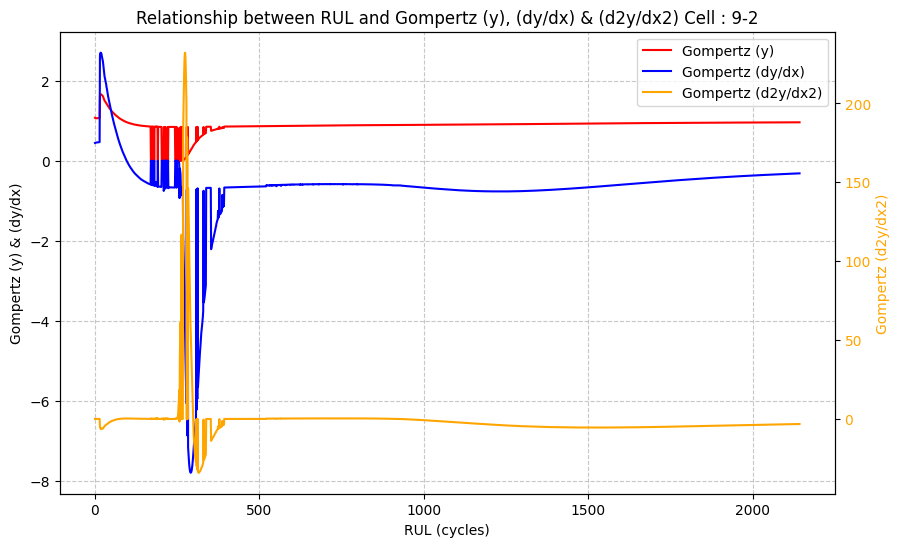

10-4 1811


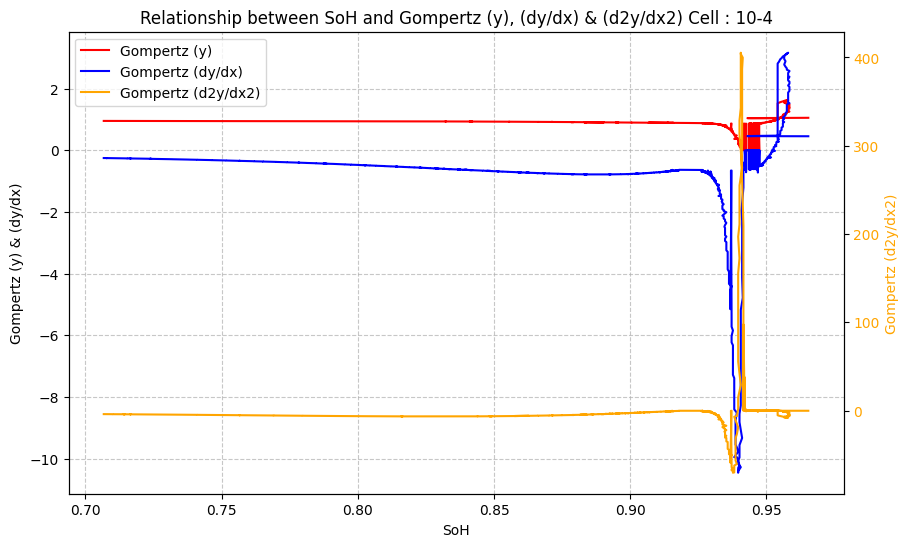

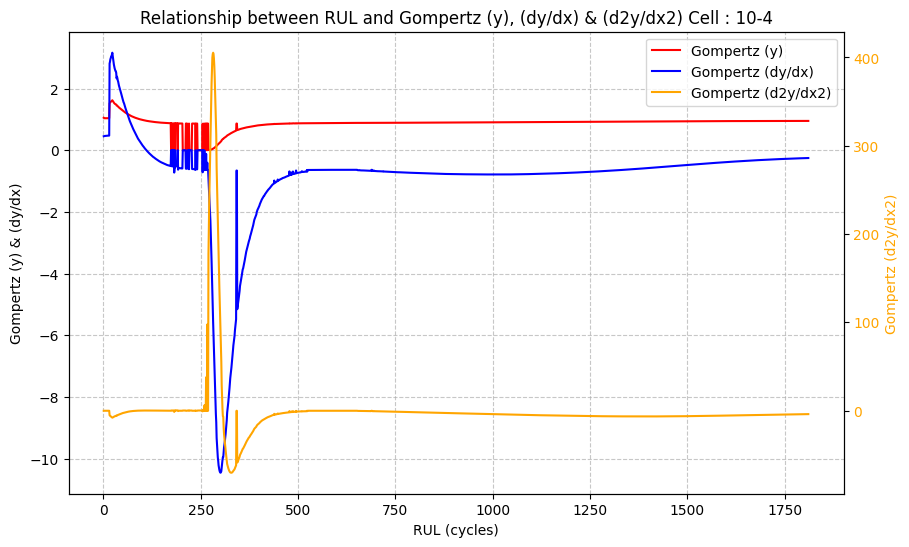

3-1 1938


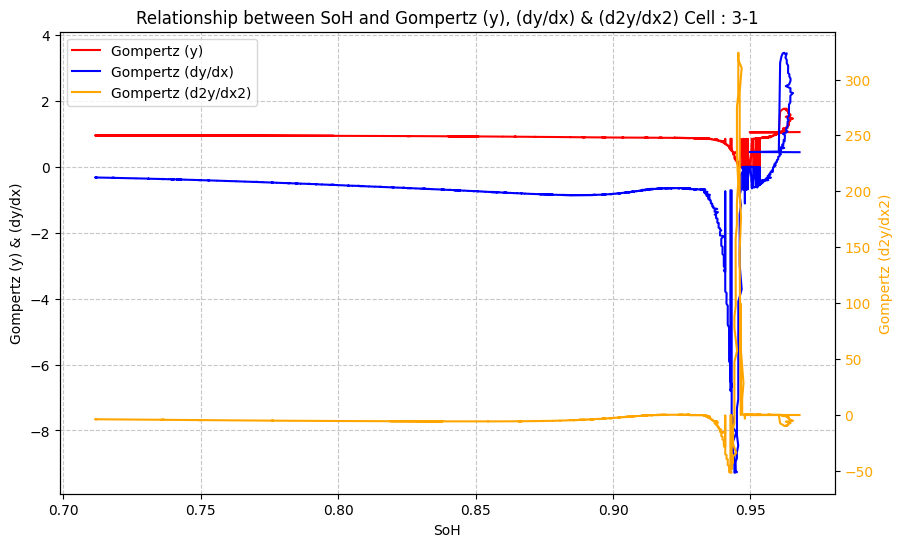

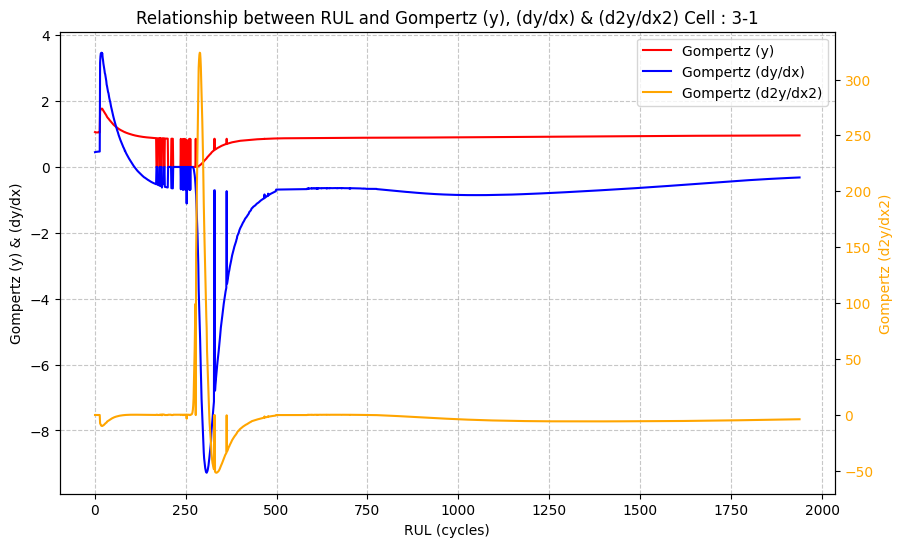

9-7 2012


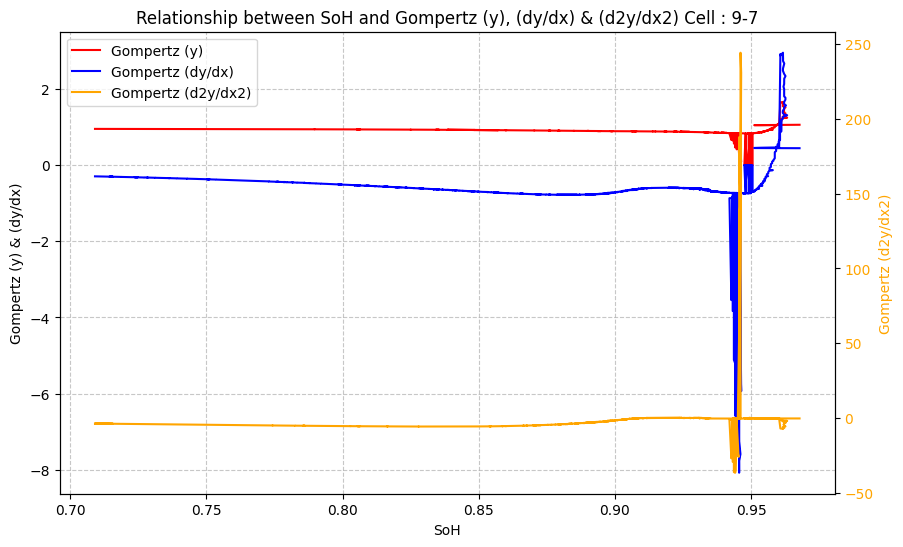

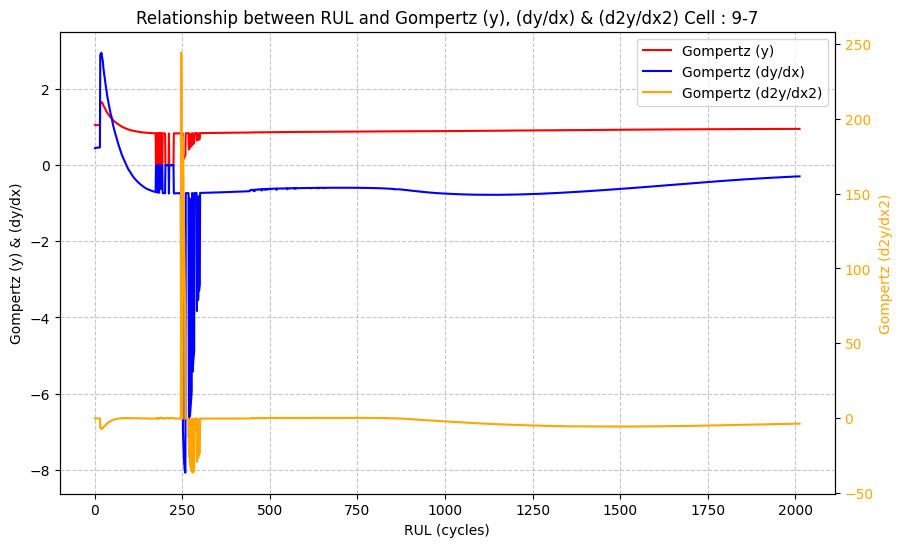

8-1 1308


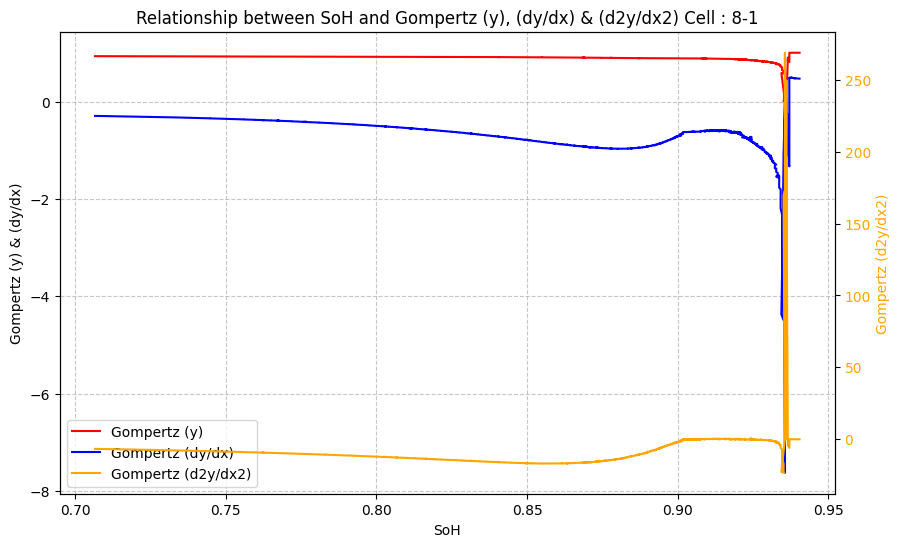

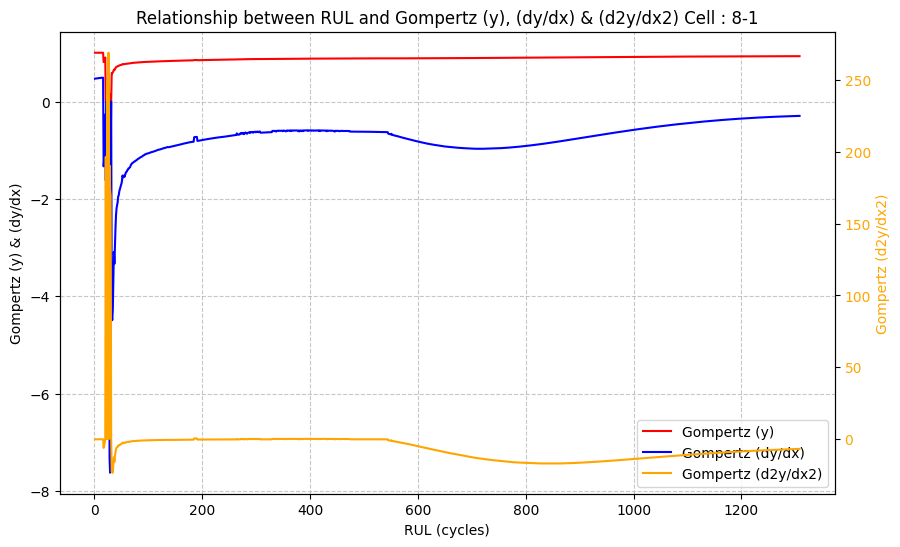

10-8 1400


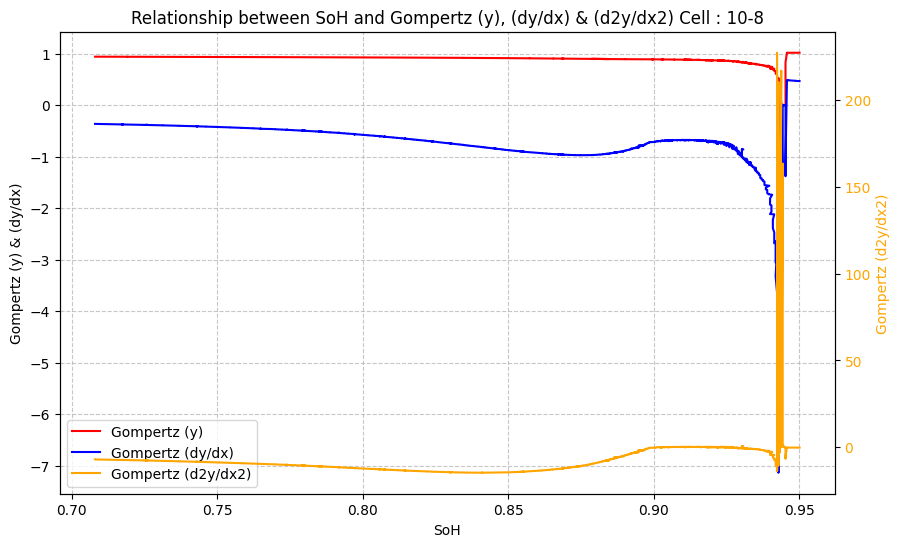

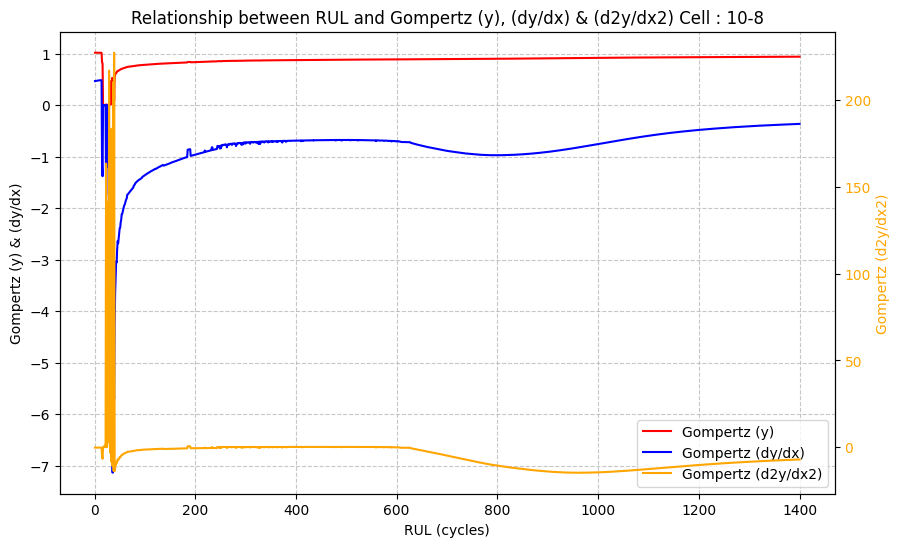

8-4 1885


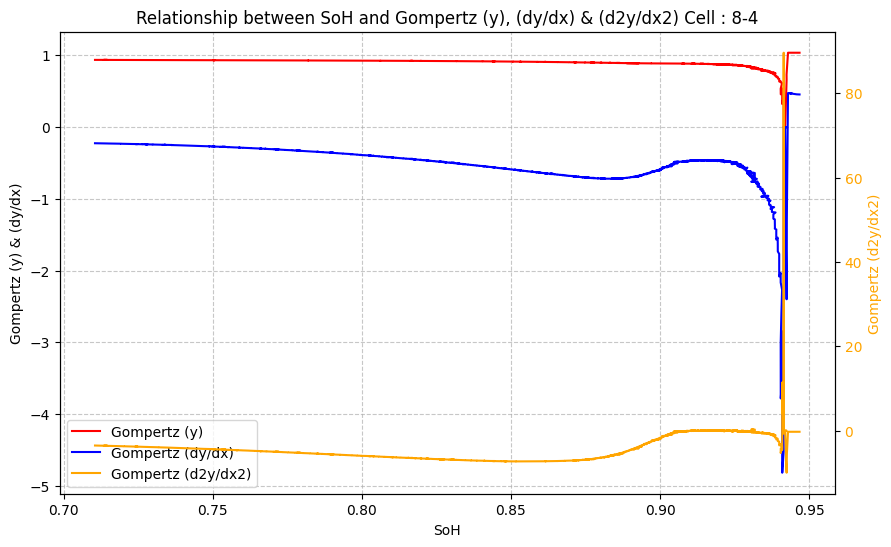

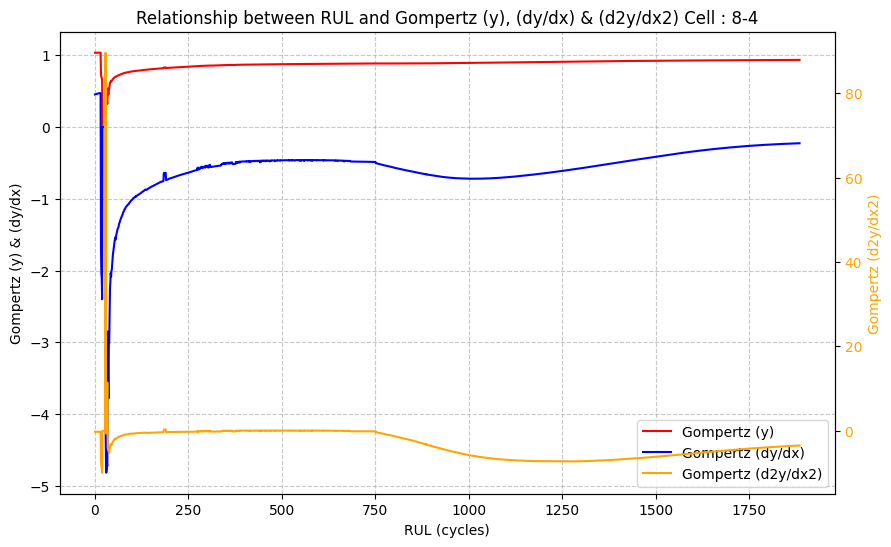

4-6 1380


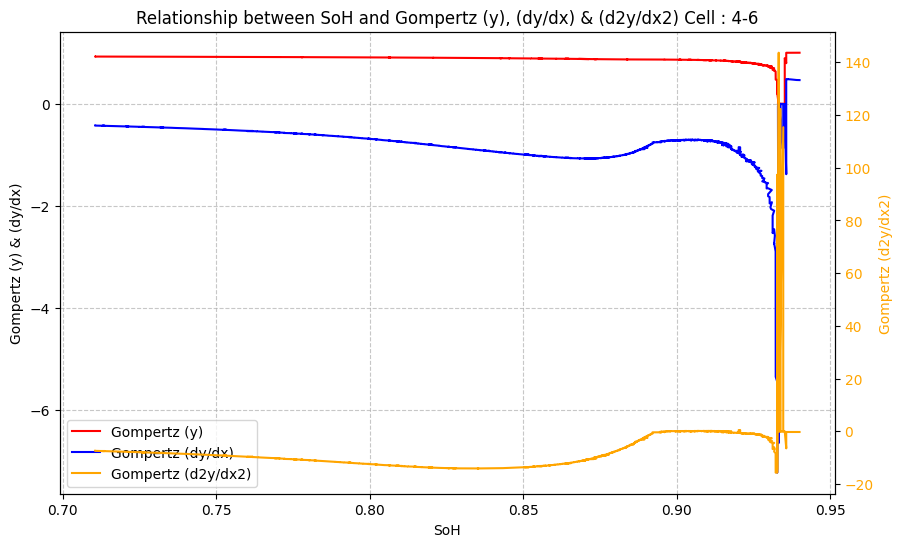

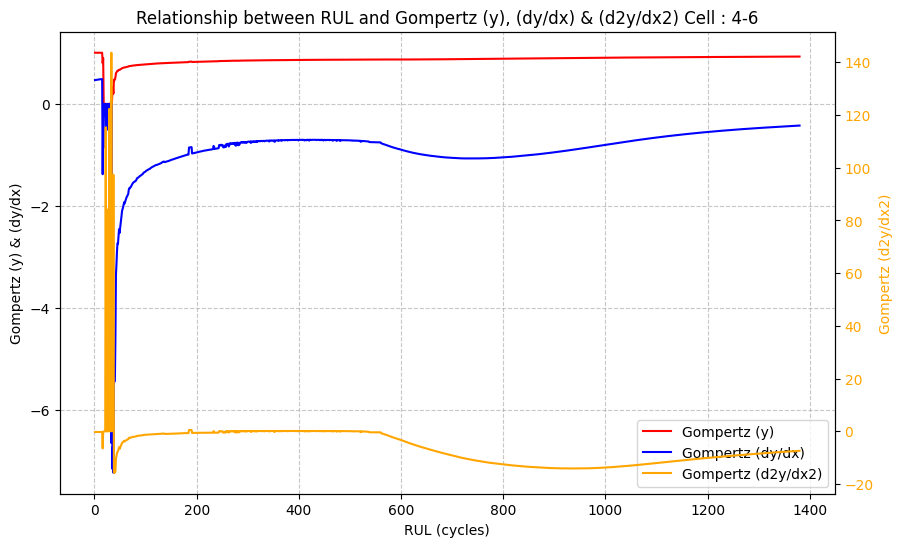

4-4 1491


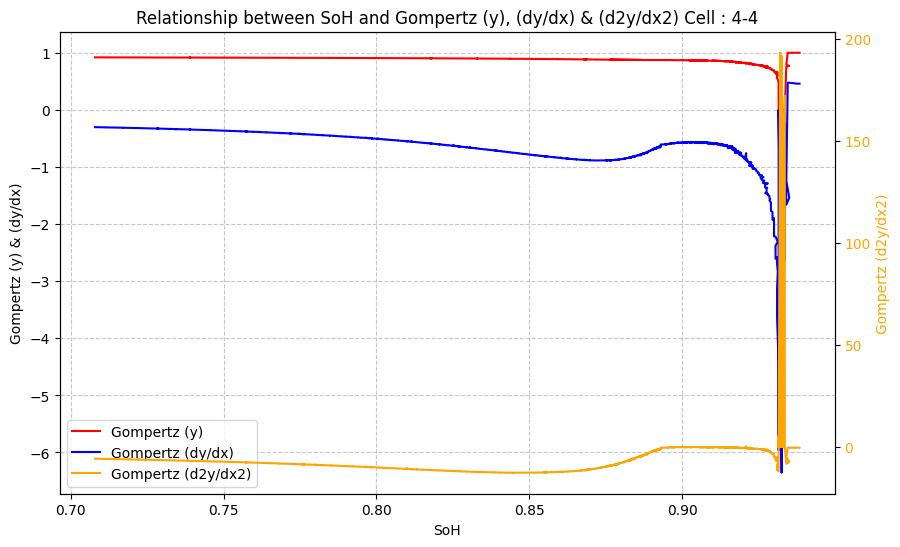

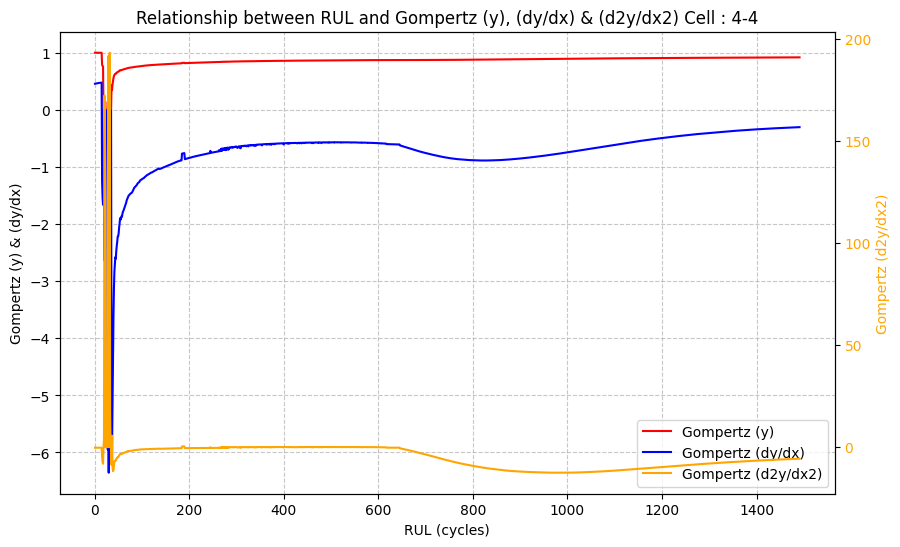

3-8 2342


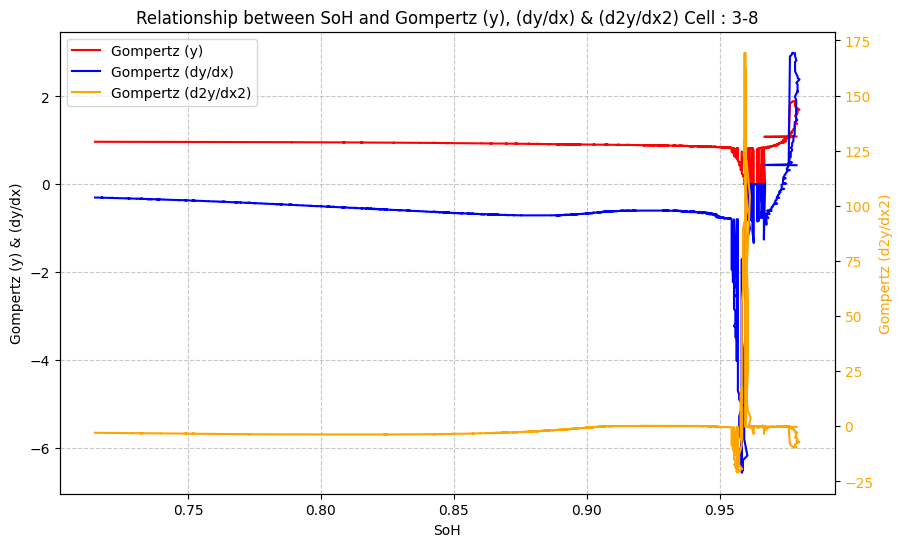

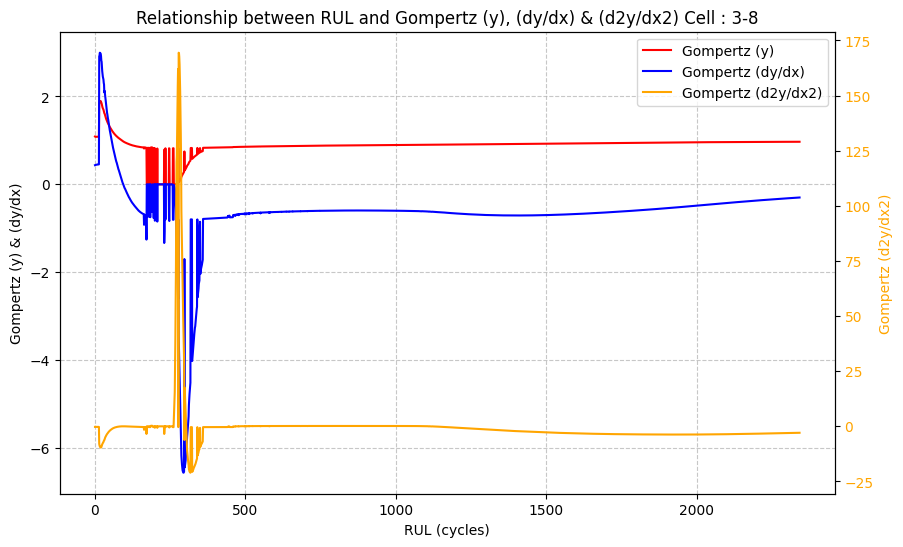

5-4 1962


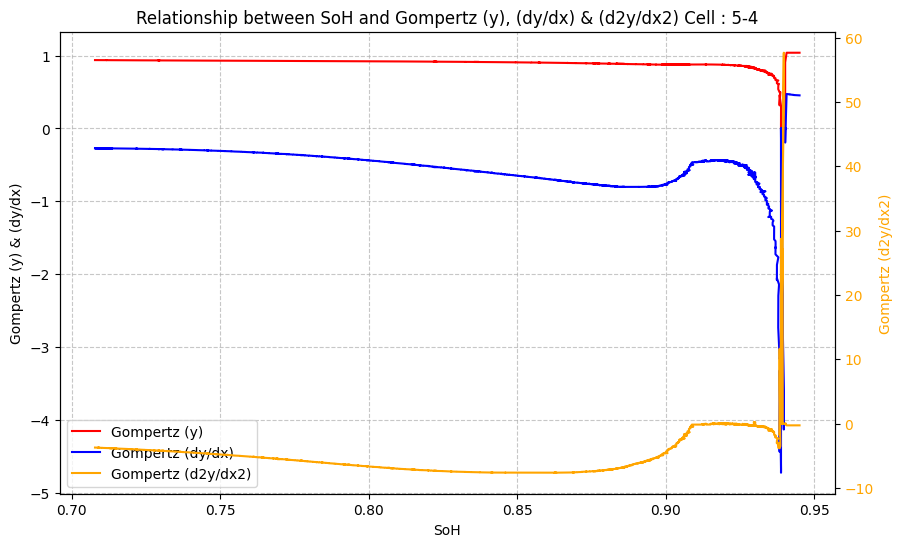

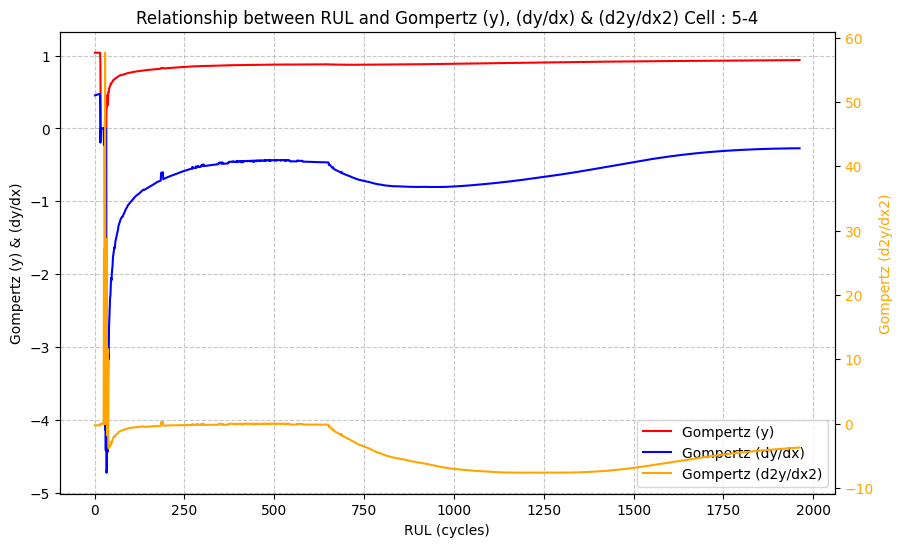

9-6 1742


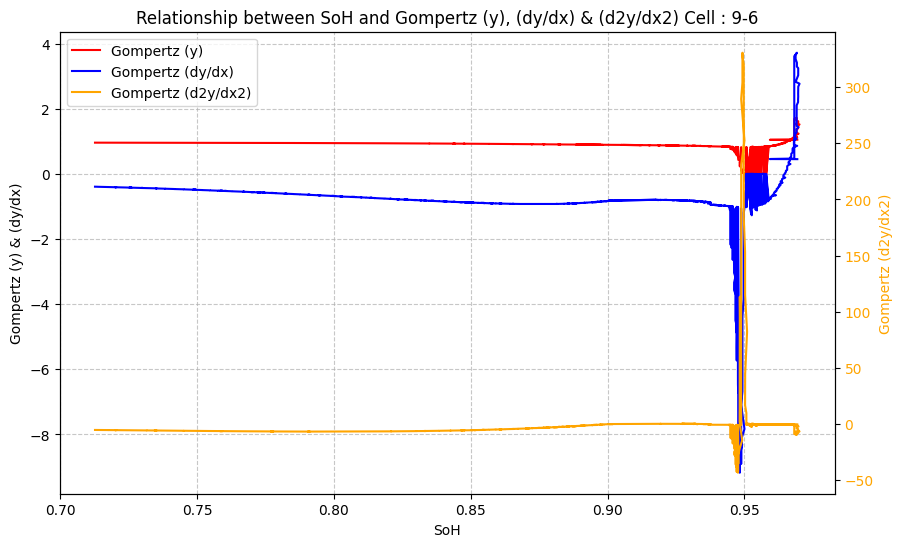

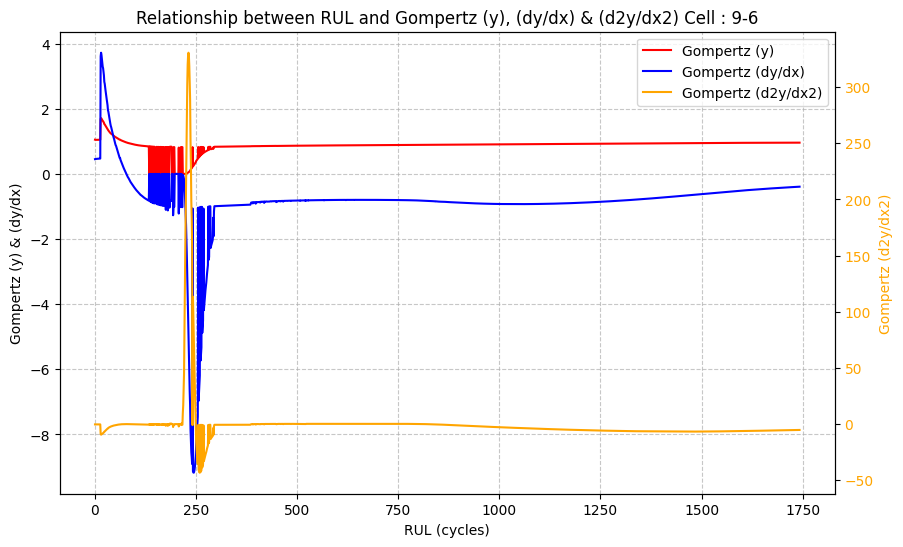

10-5 2030


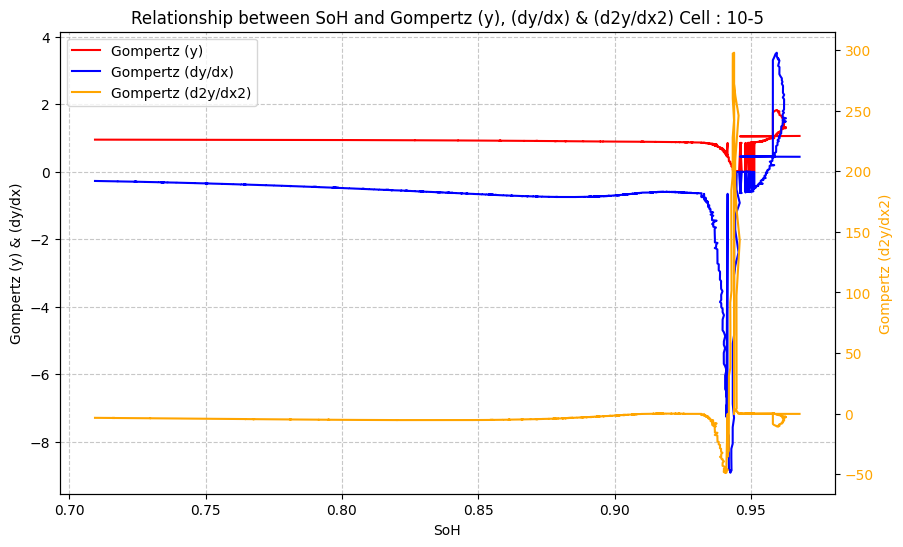

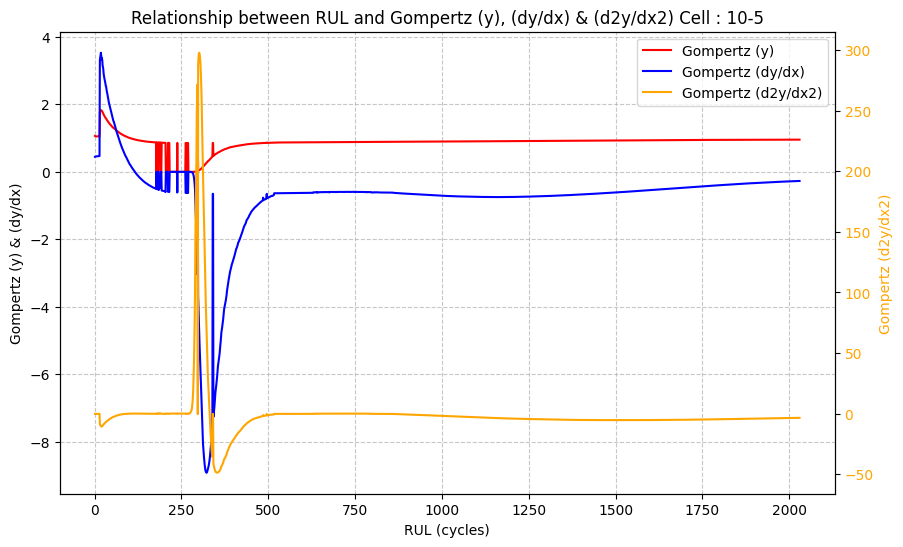

7-8 1938


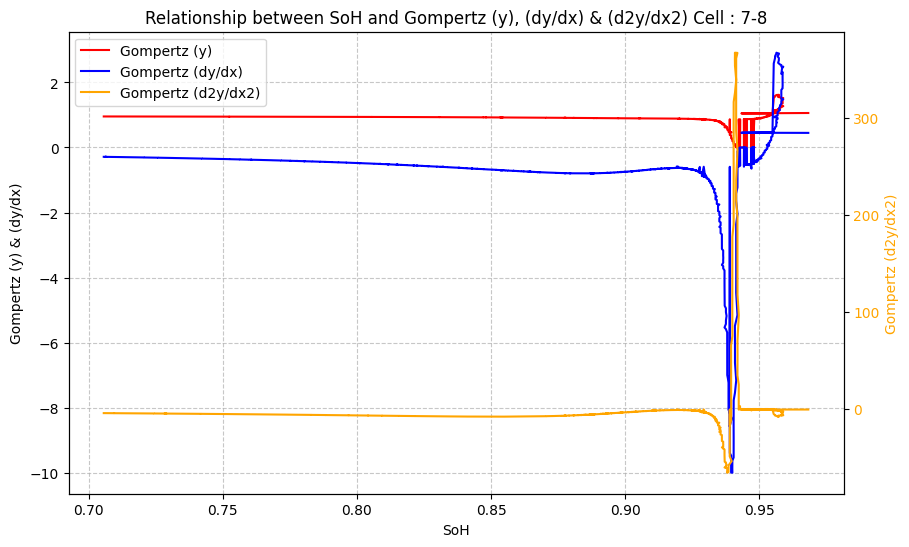

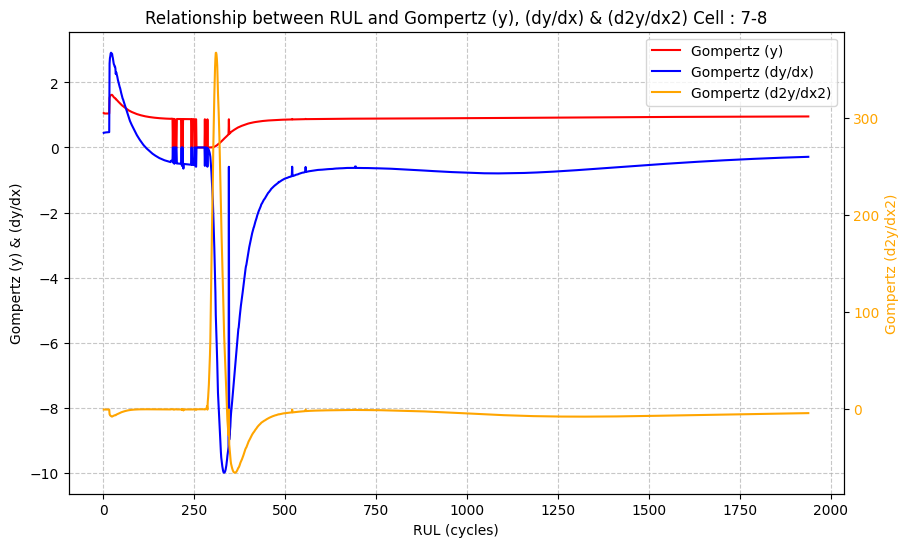

5-2 1926


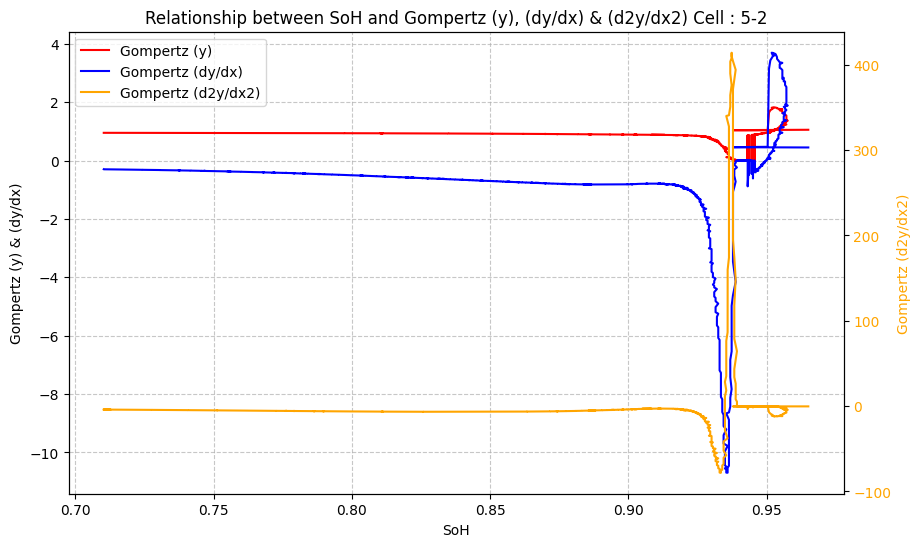

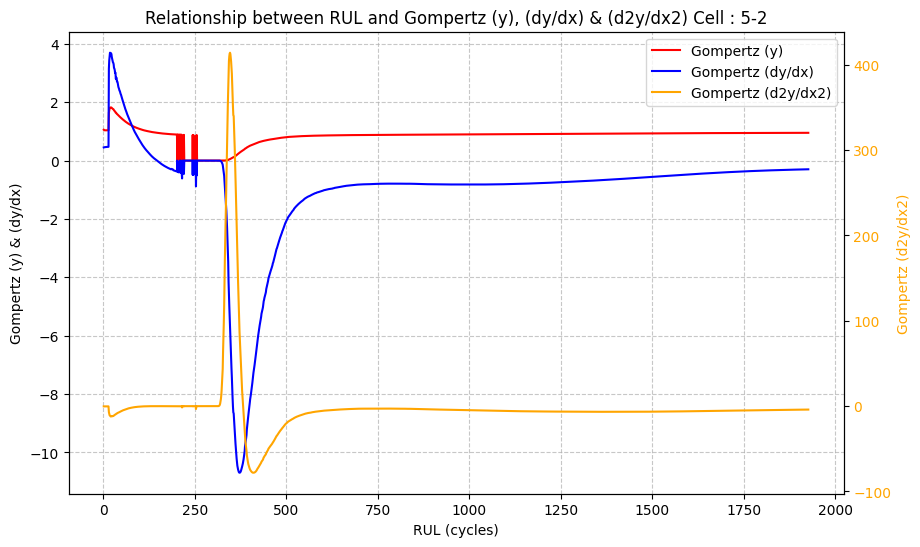

9-8 2308


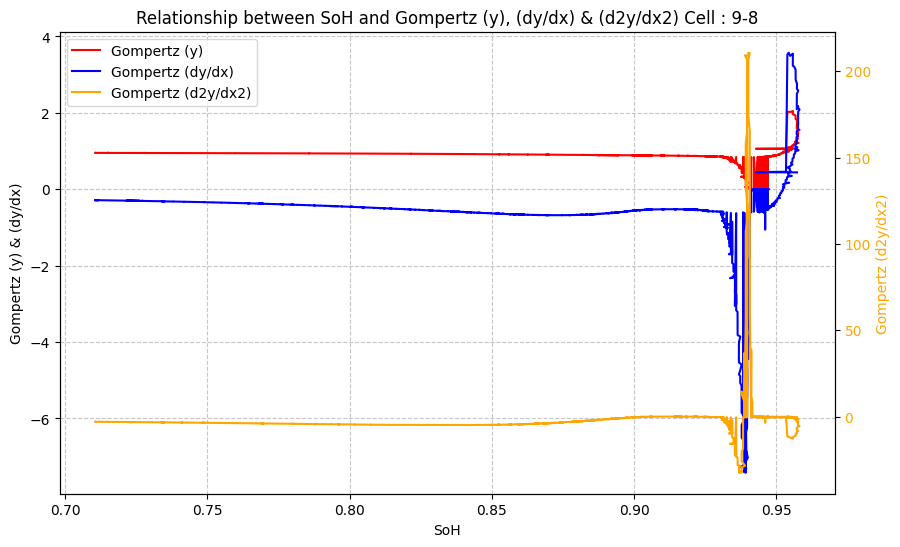

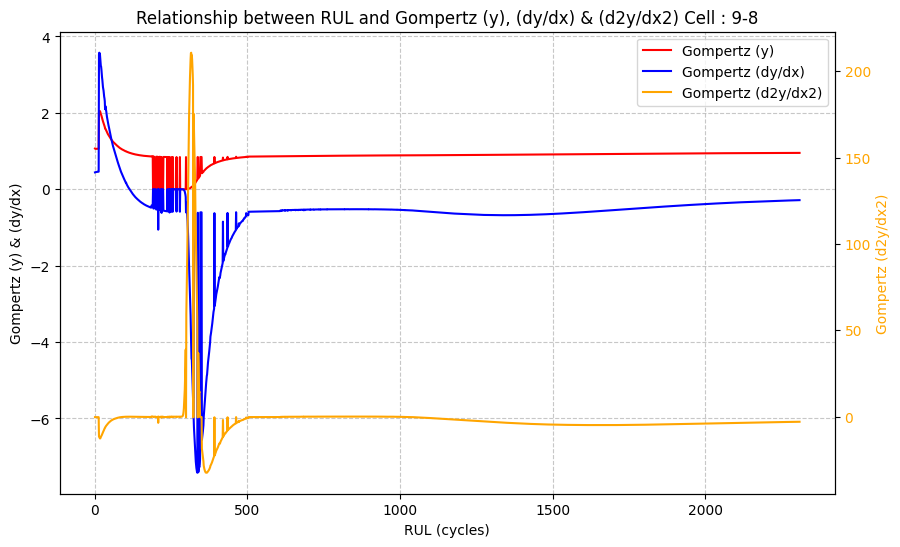

1-2 2678


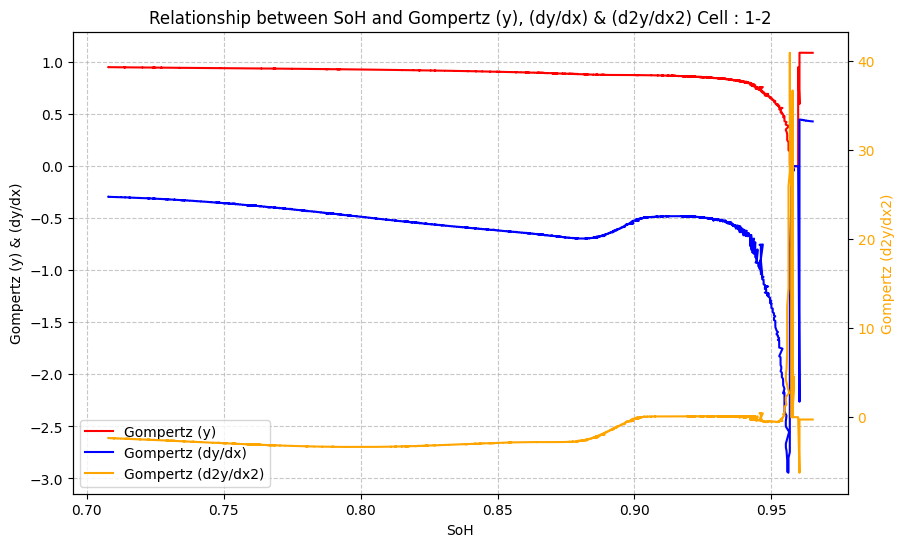

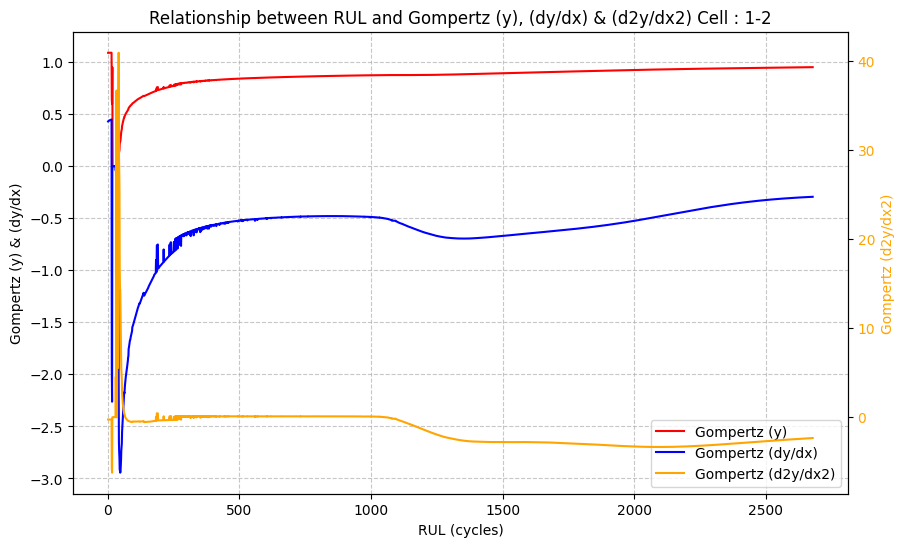

5-6 2460


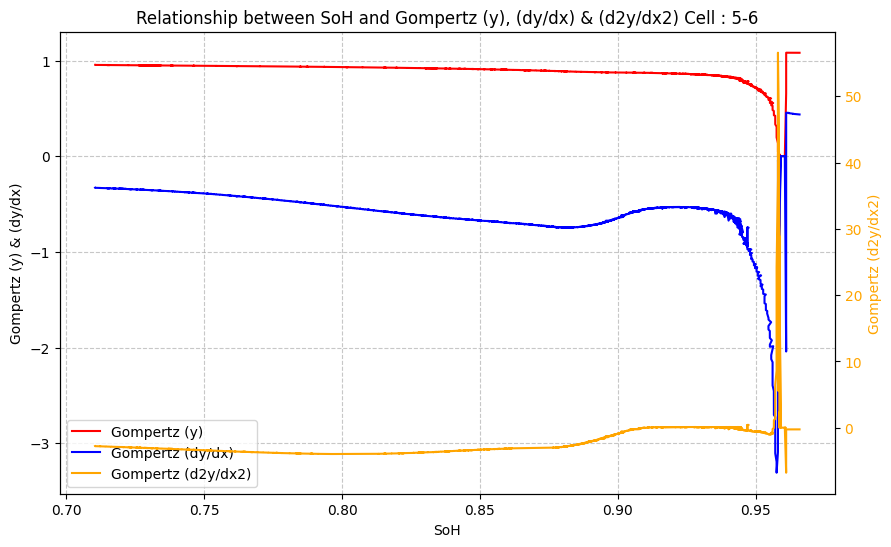

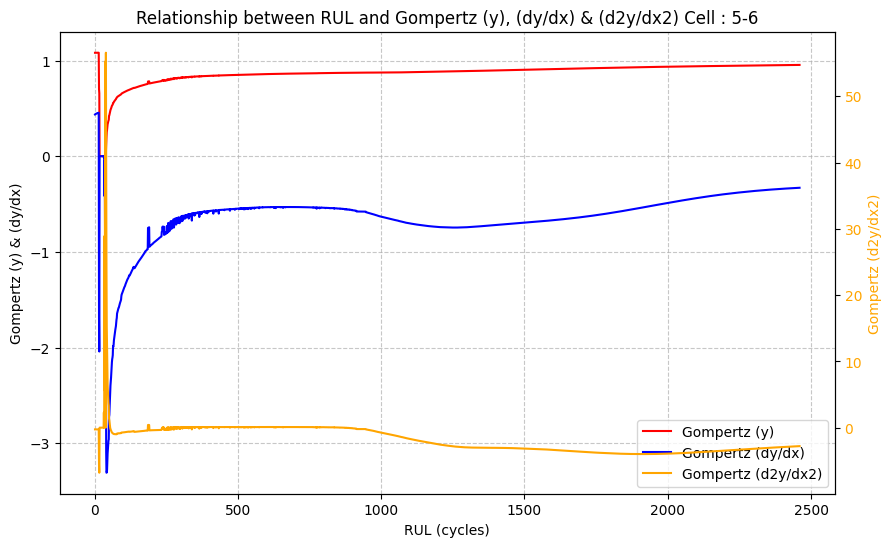

10-2 1697


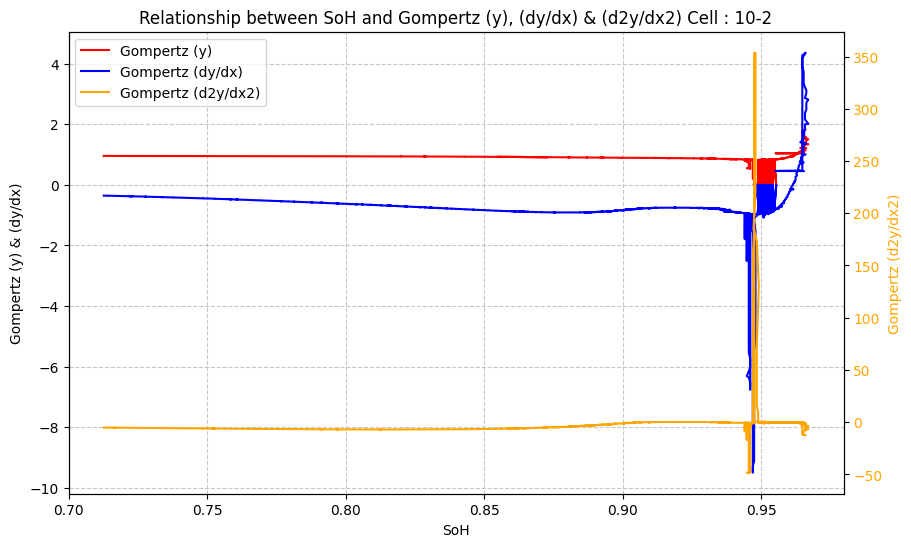

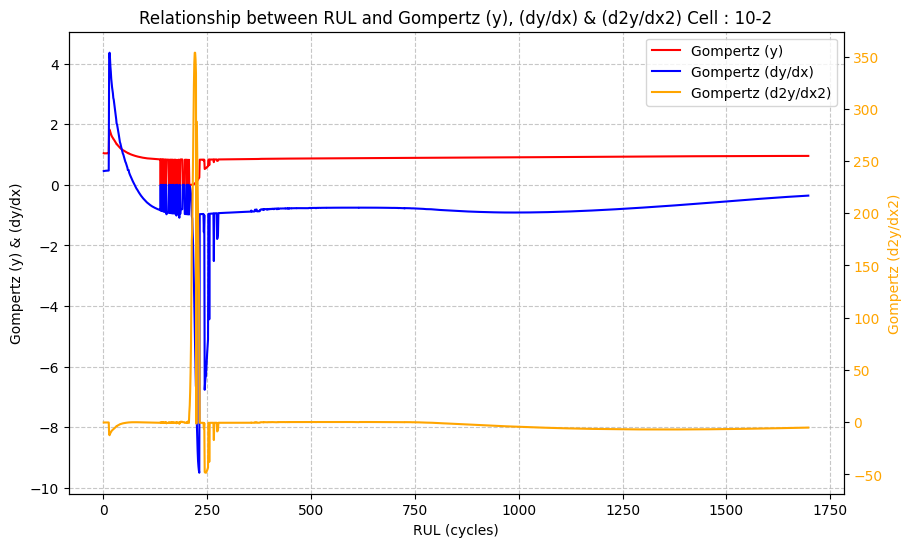

2-6 1572


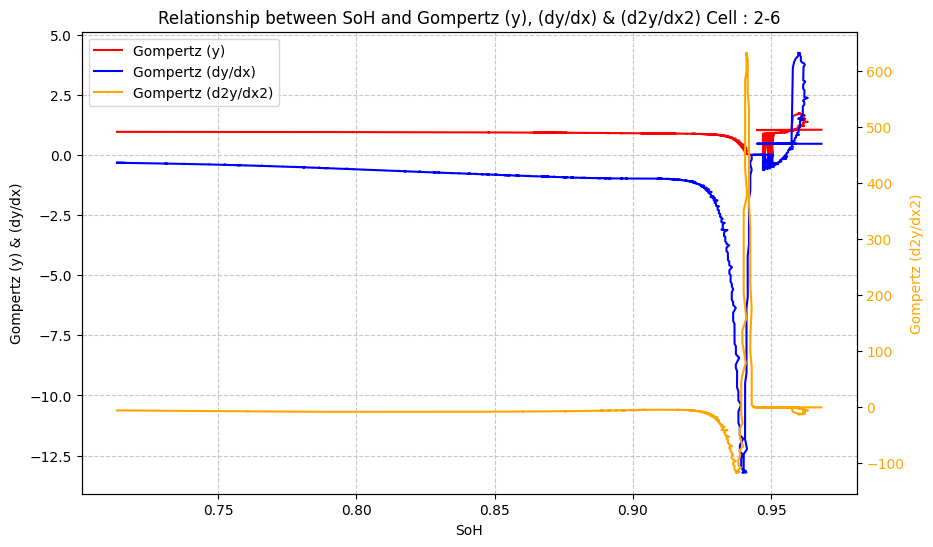

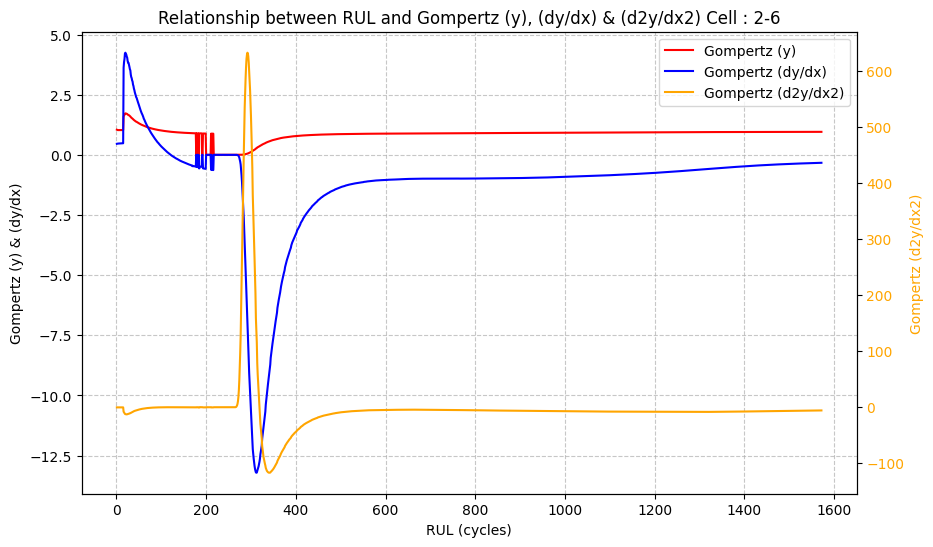

6-1 1609


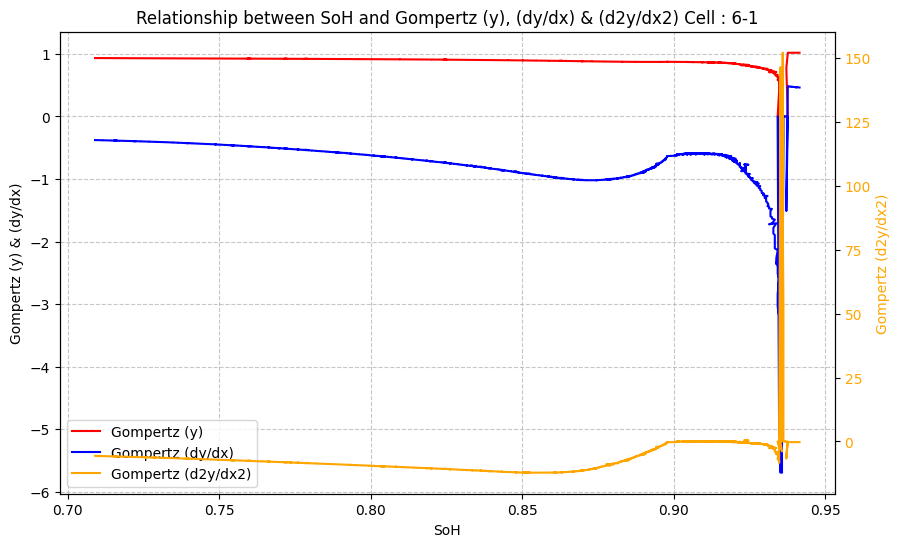

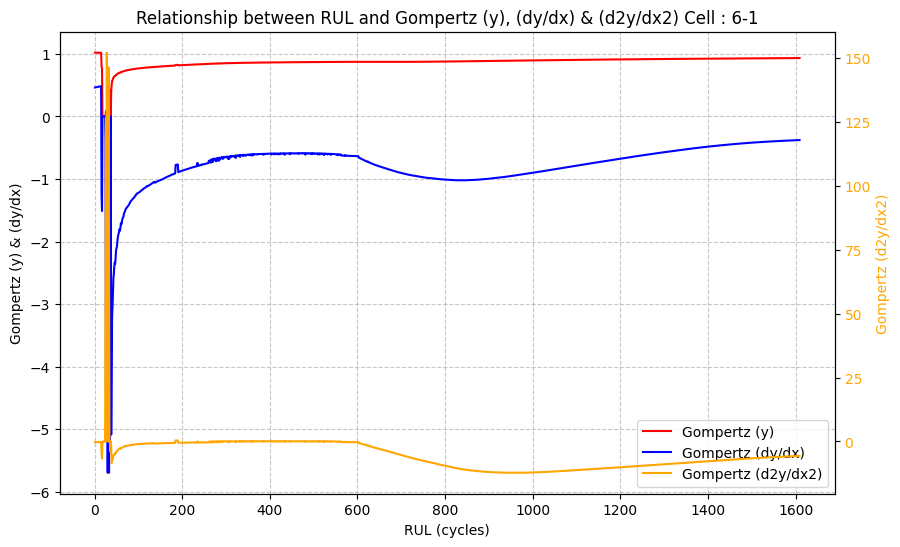

2-4 1499


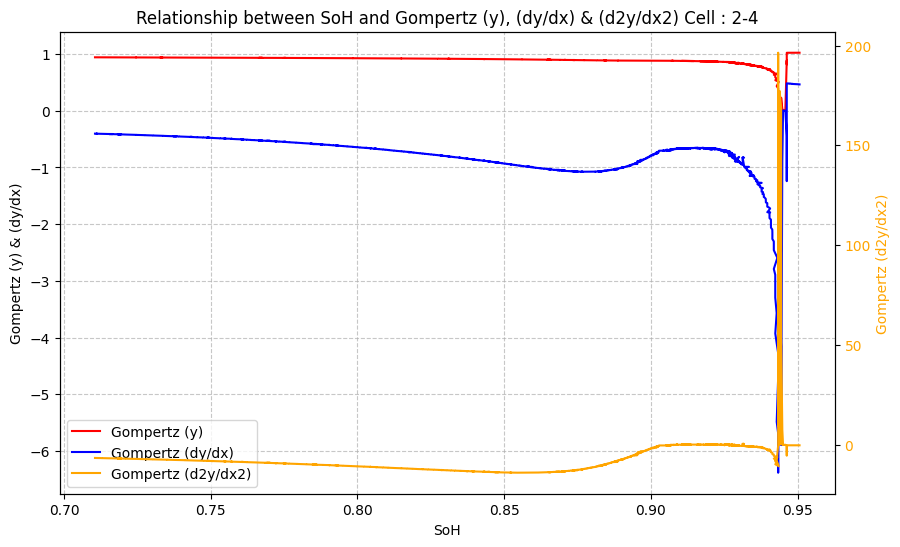

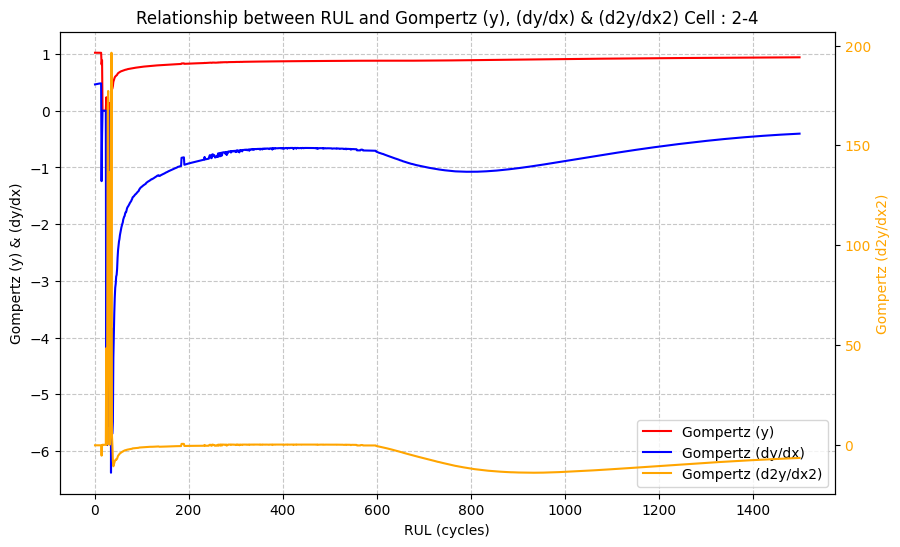

1-4 1500


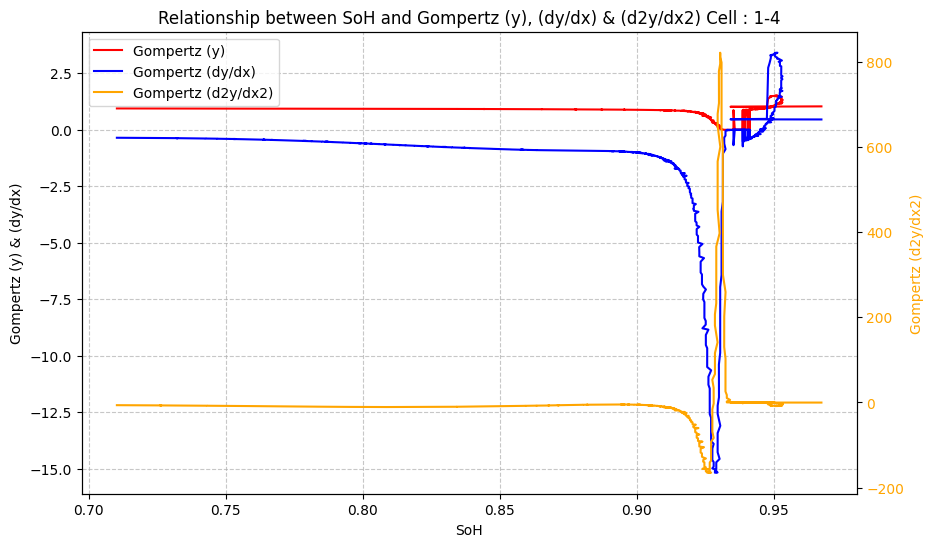

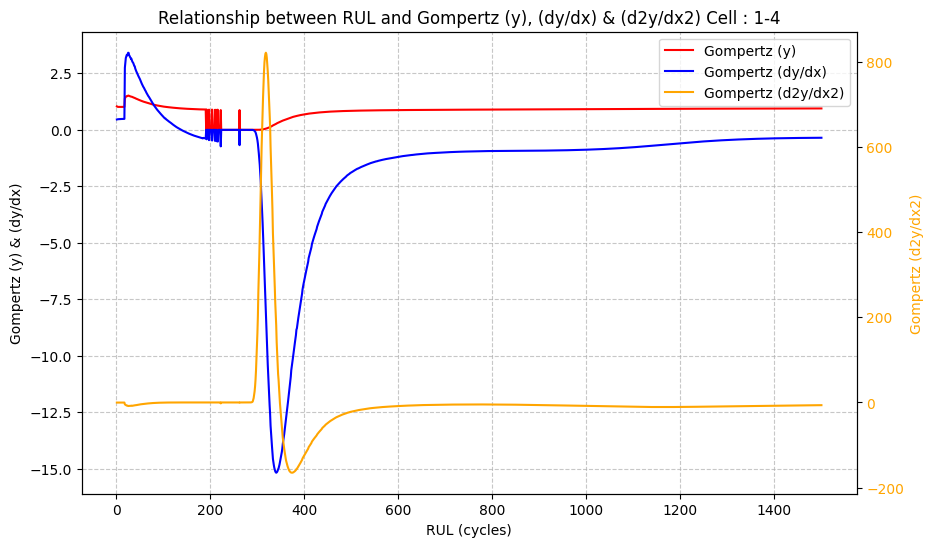

4-1 2217


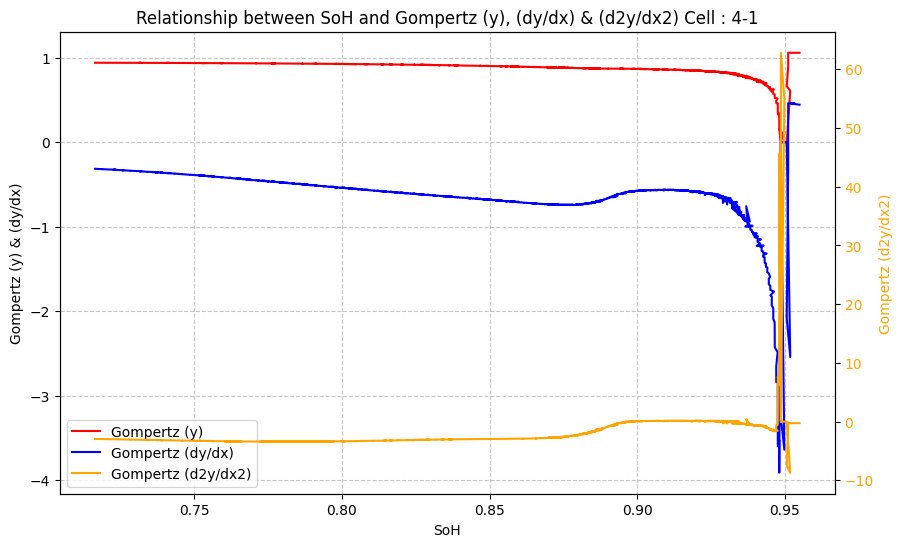

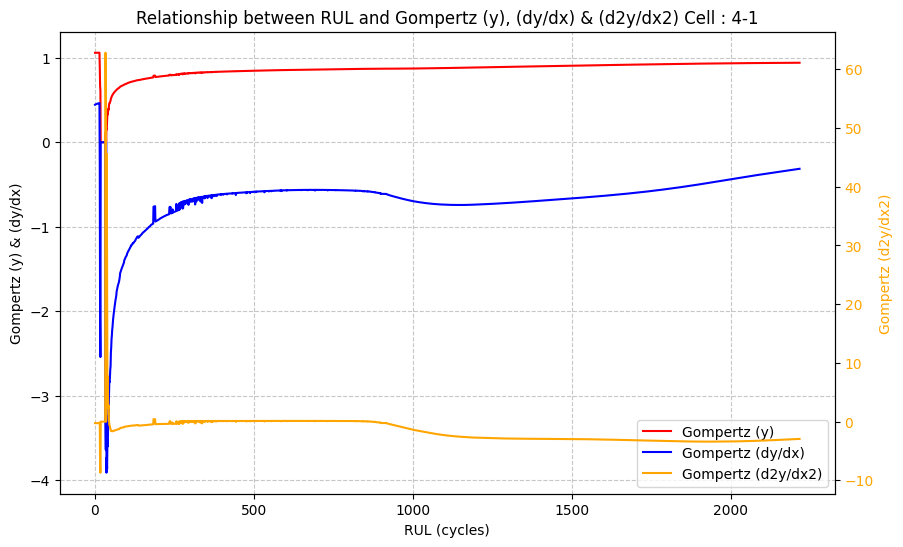

1-6 1143


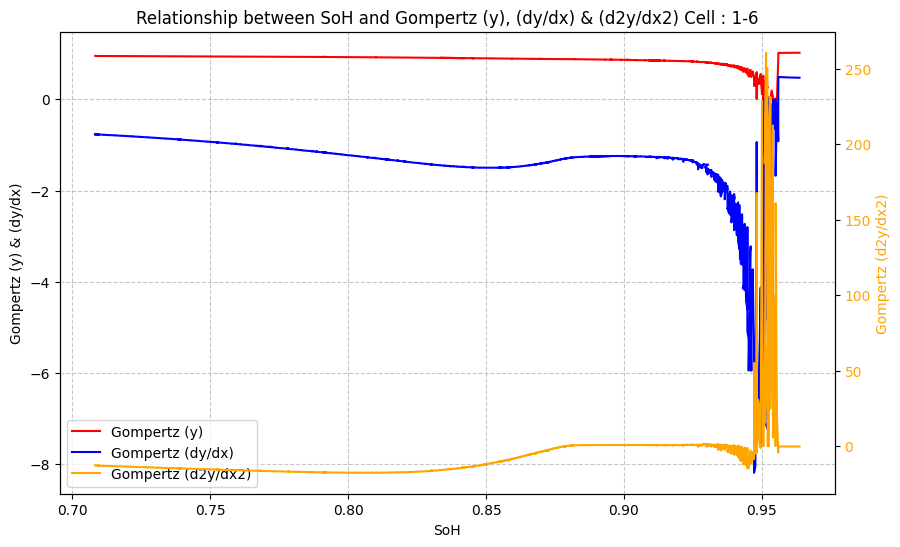

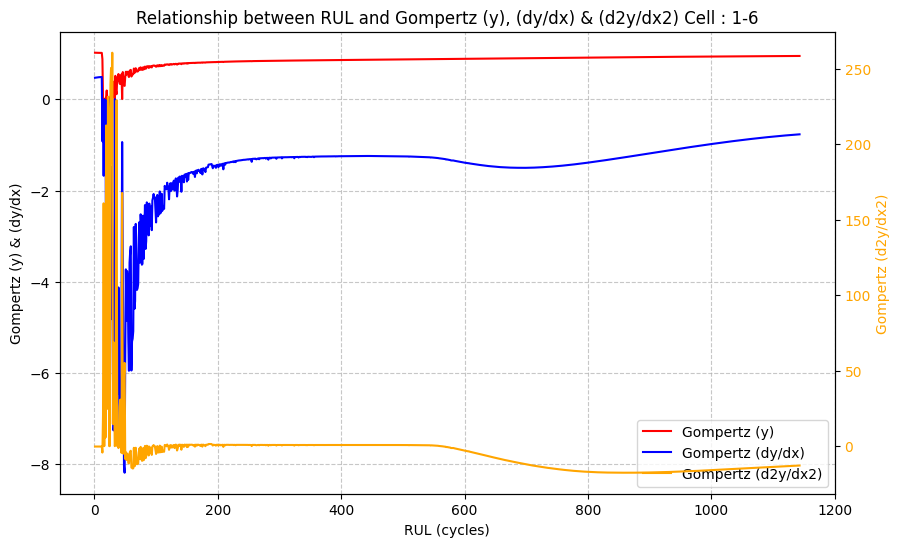

6-2 1908


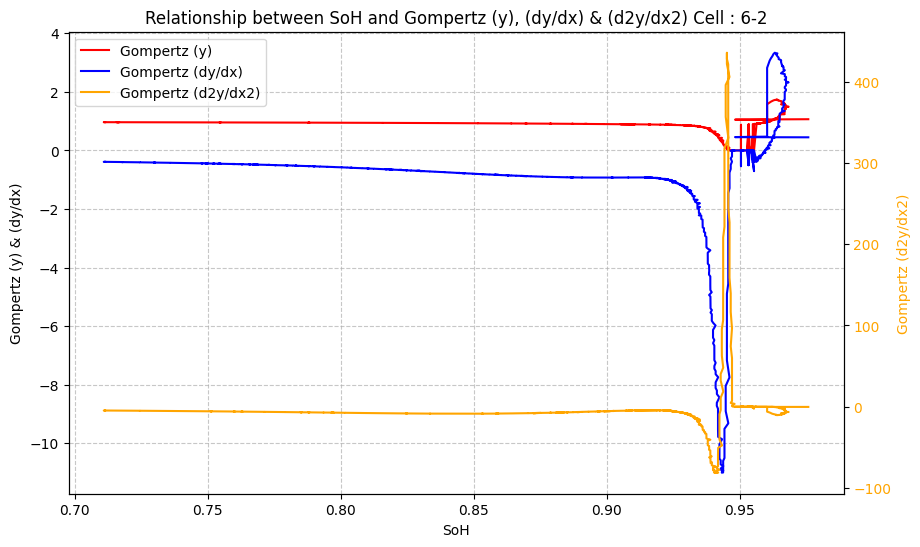

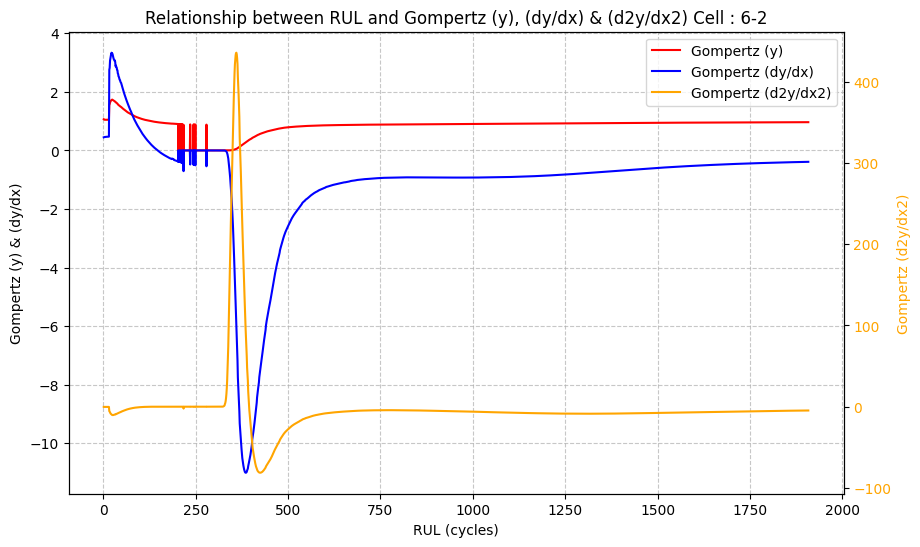

8-5 1348


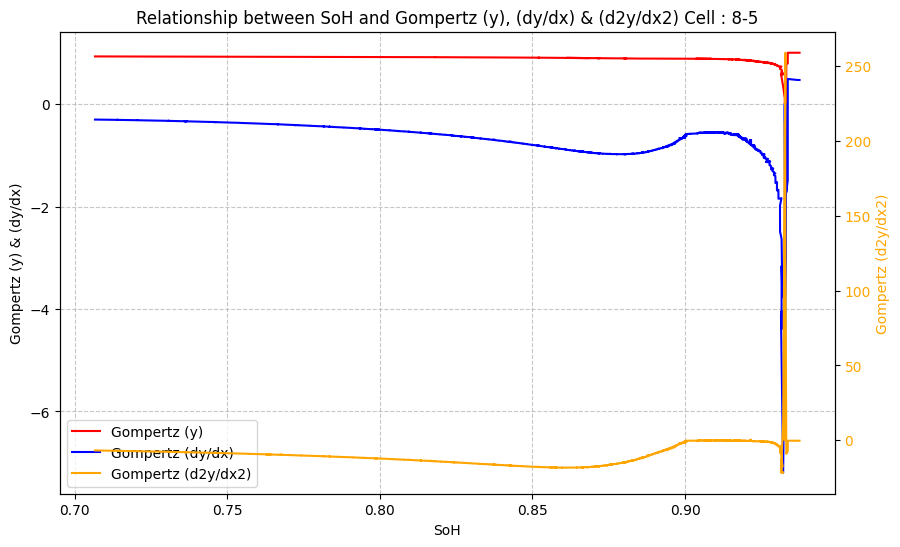

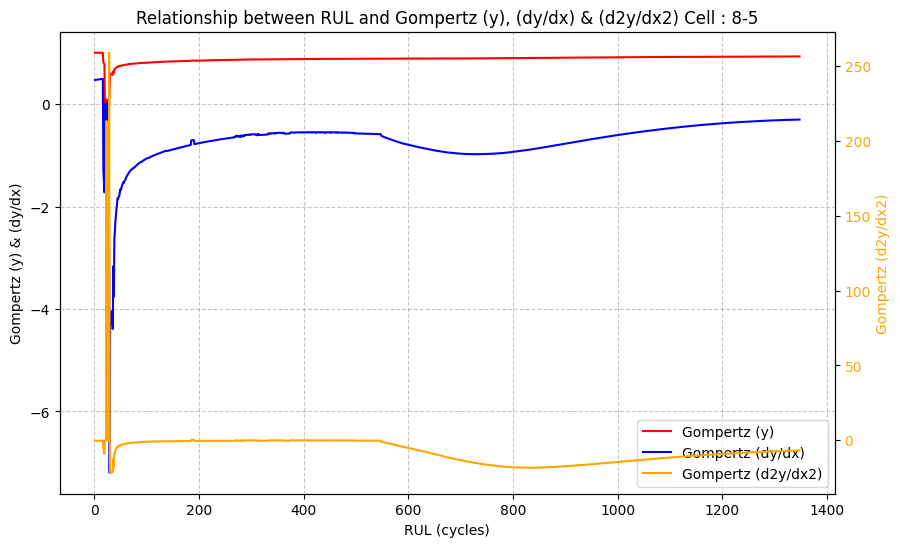

5-7 1448


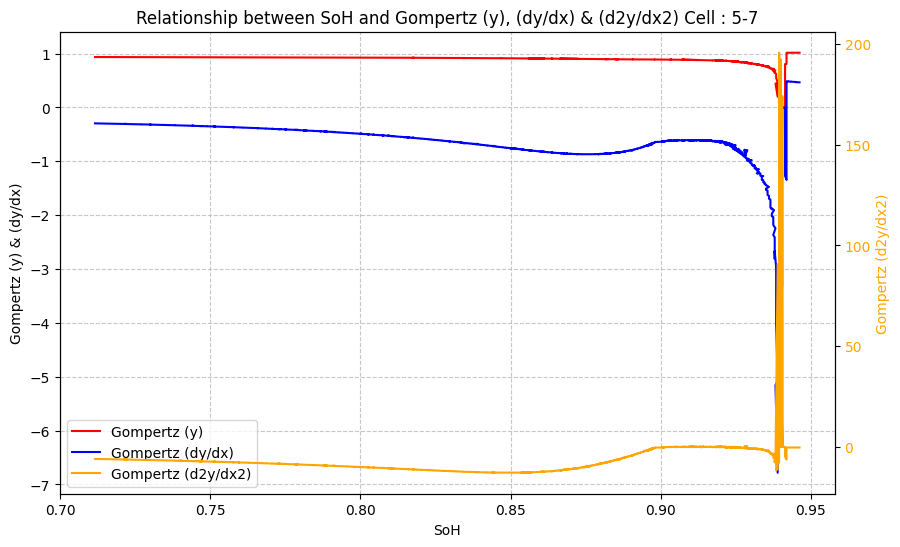

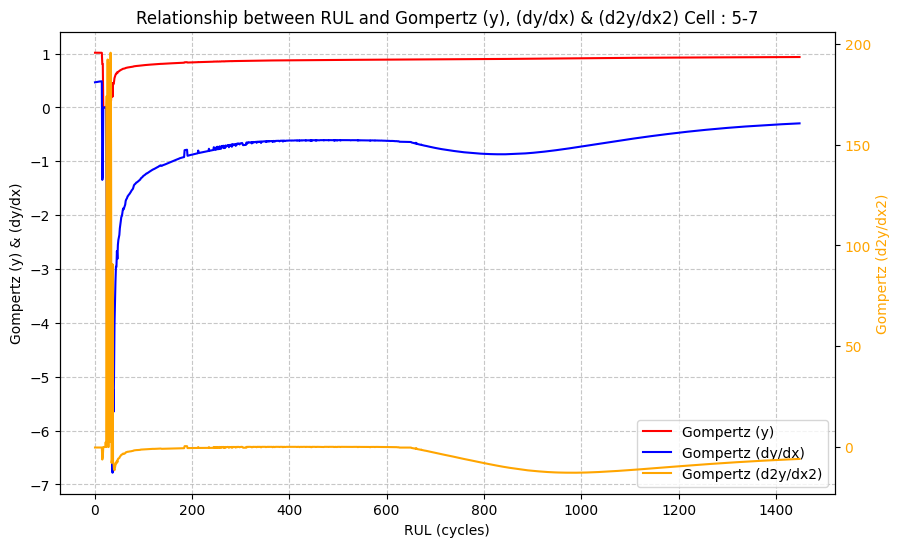

1-5 1971


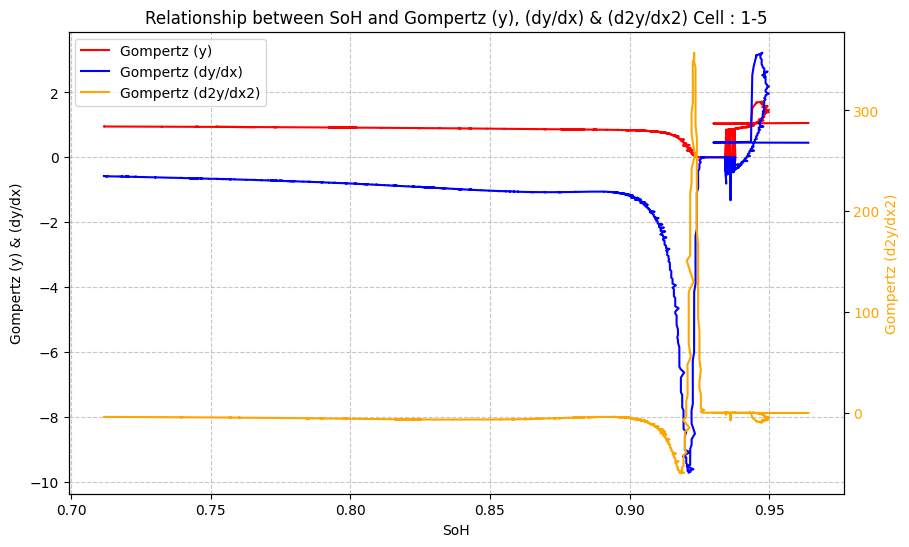

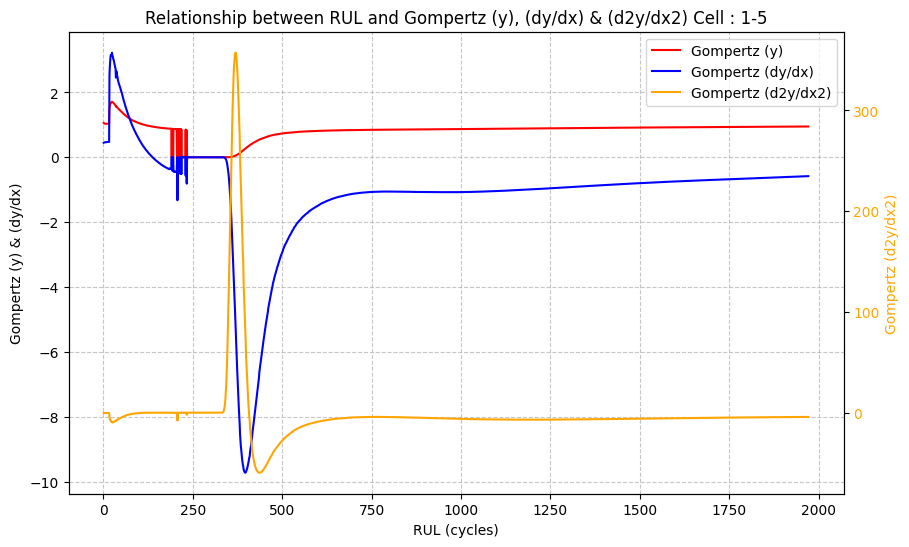

1-8 2285
5-3 2689


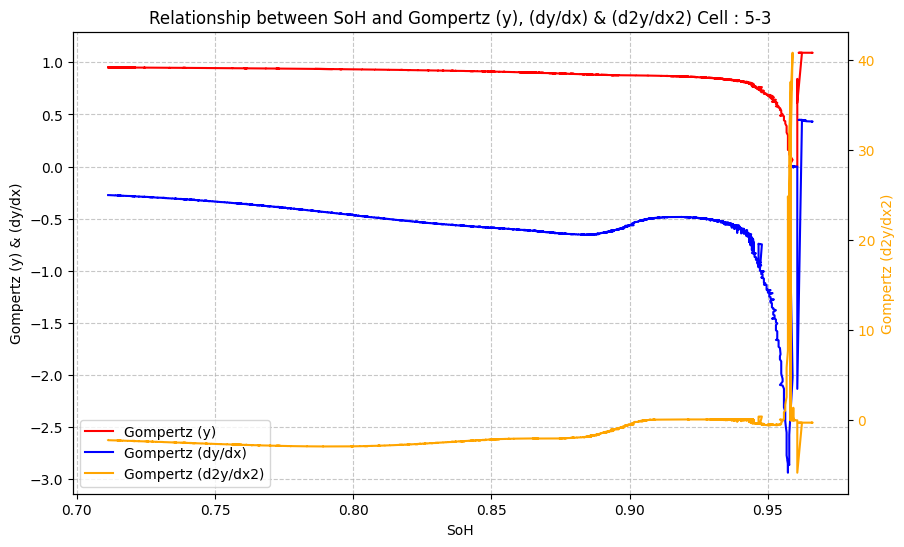

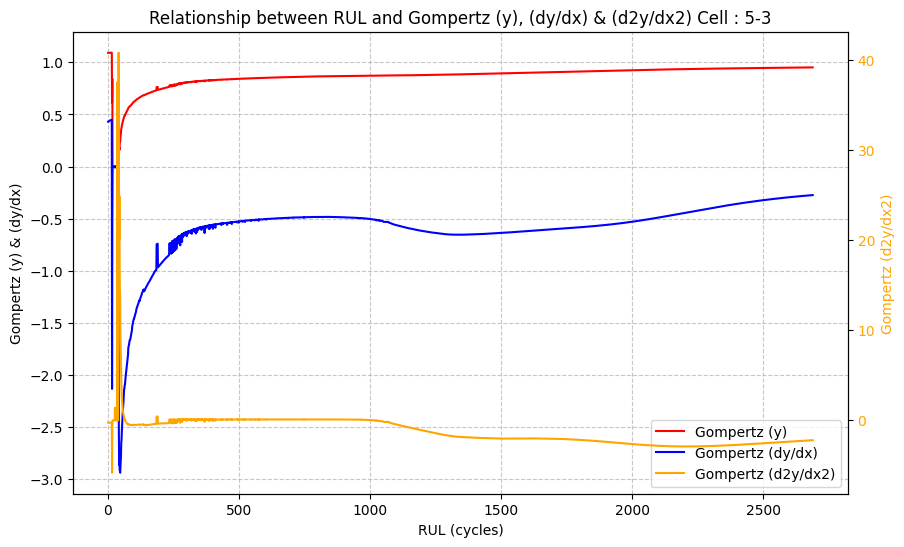

6-5 2178


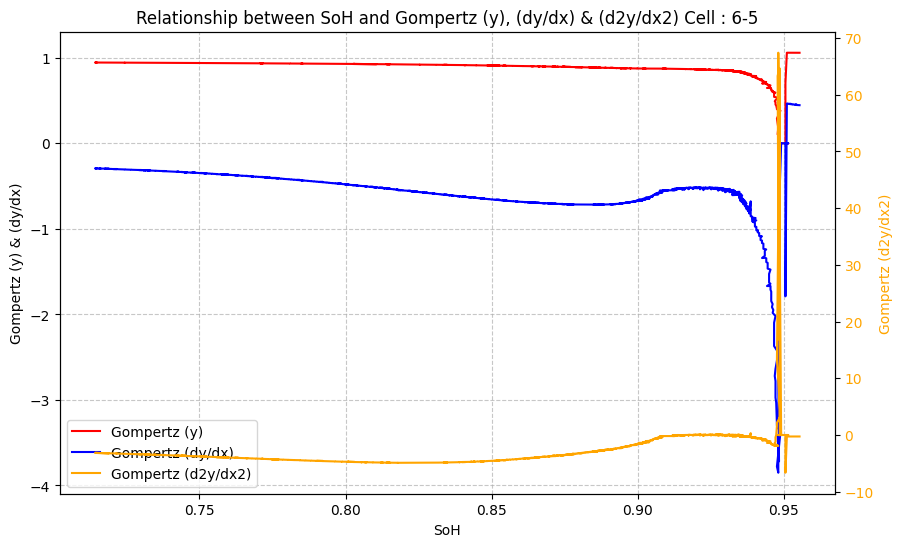

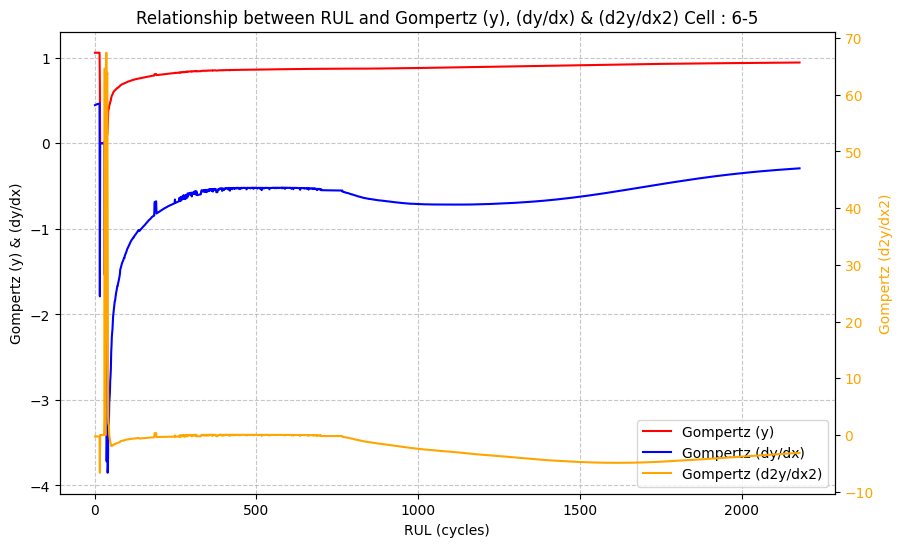

9-5 2168


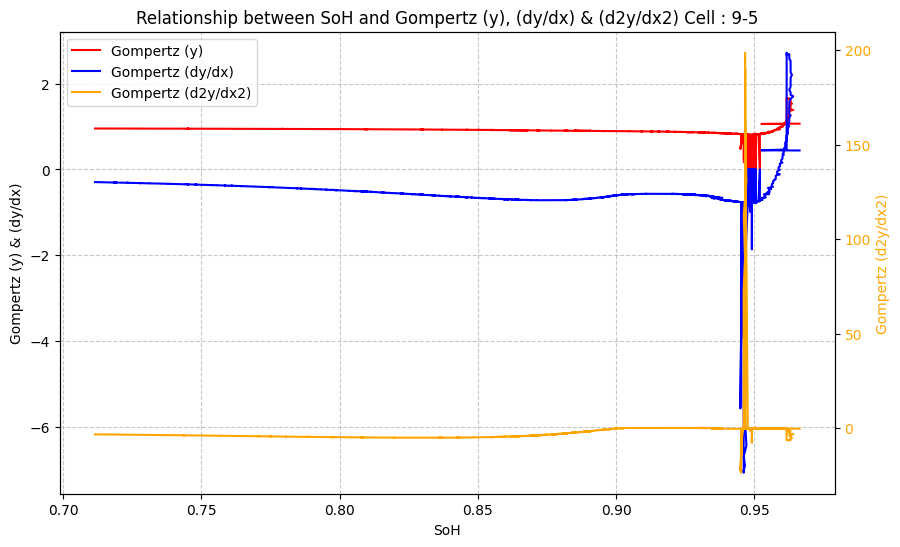

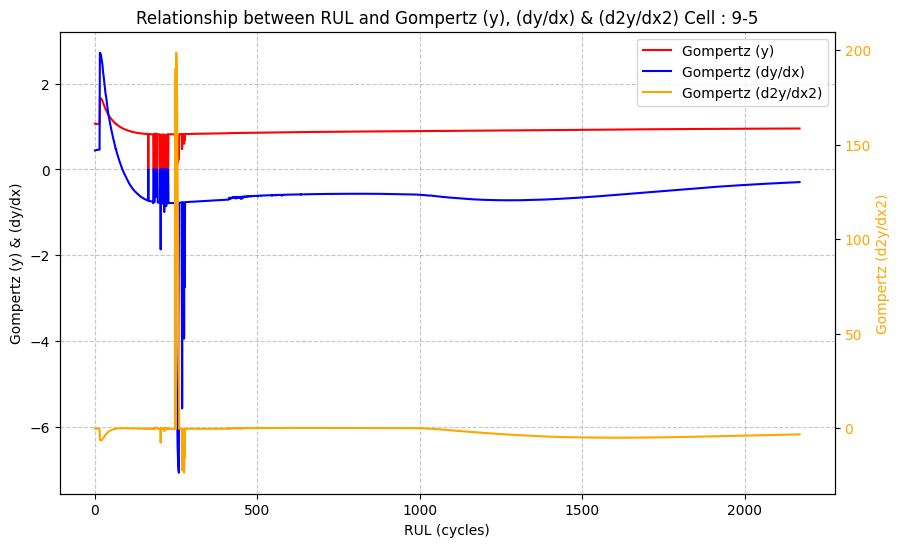

4-8 1706


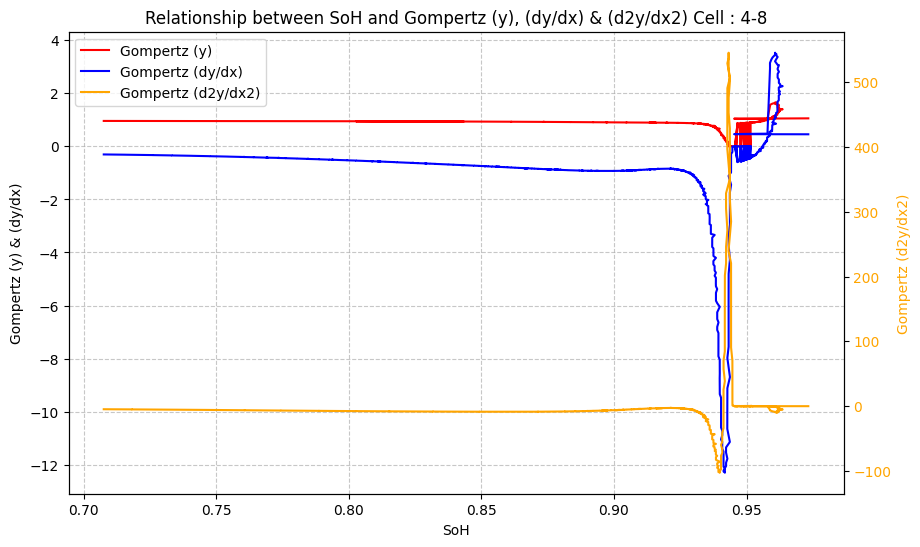

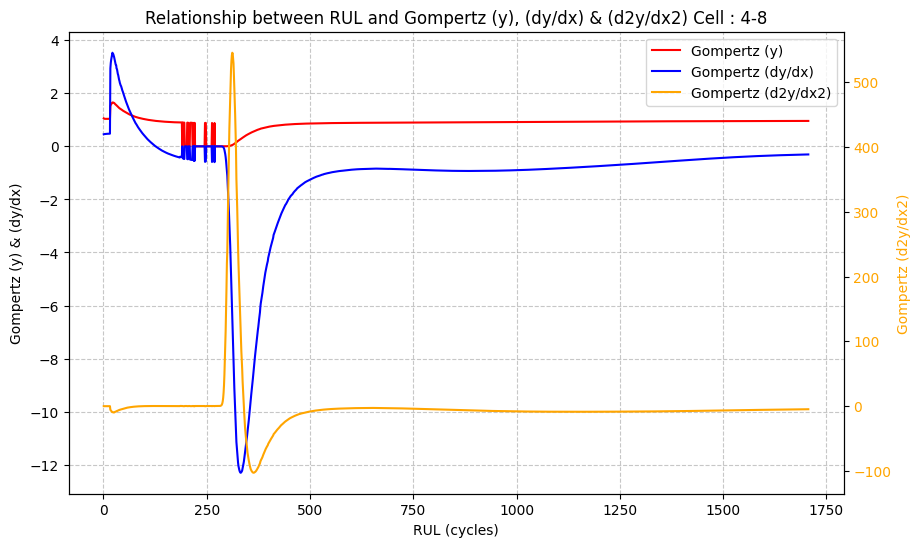

7-2 2030


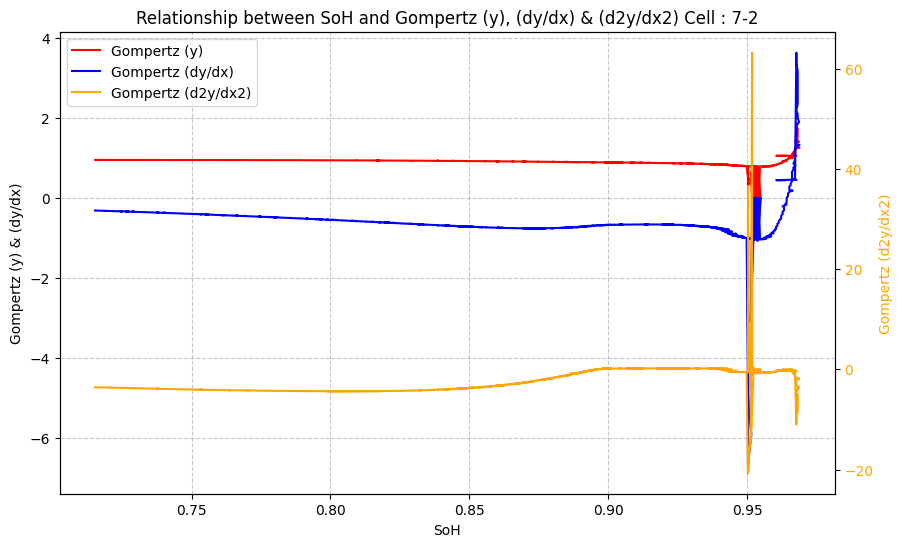

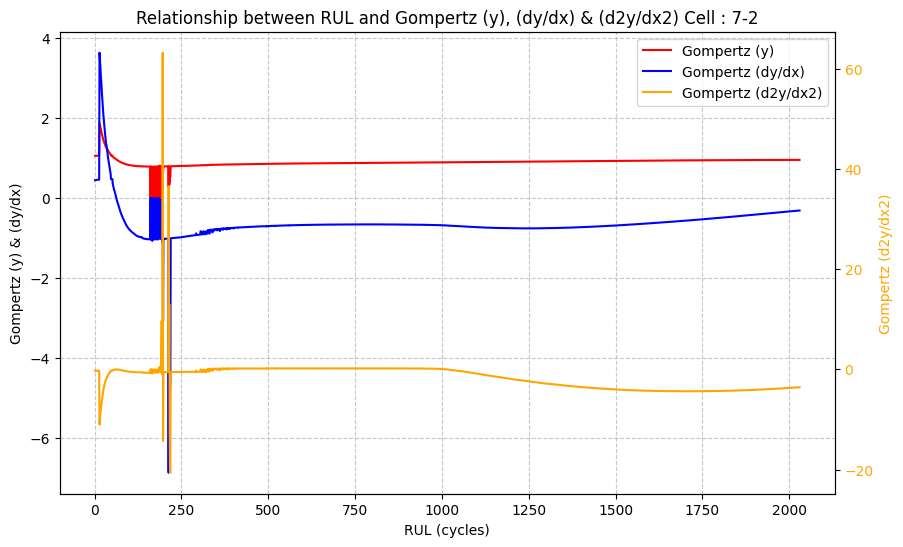

2-5 1386


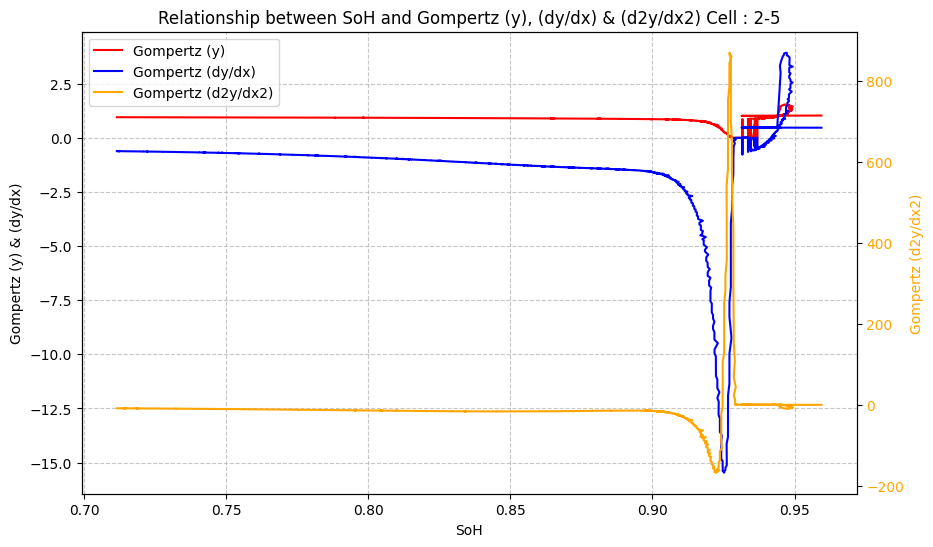

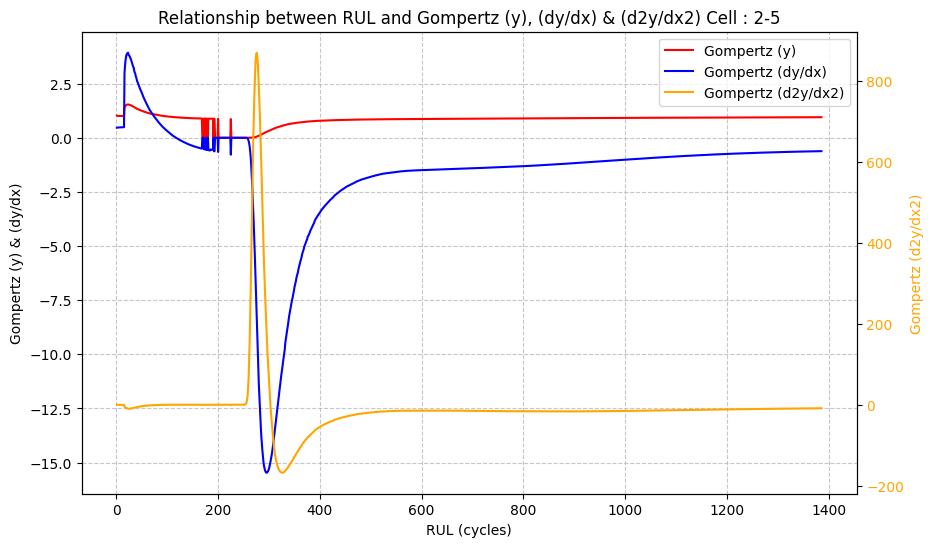

7-3 1295


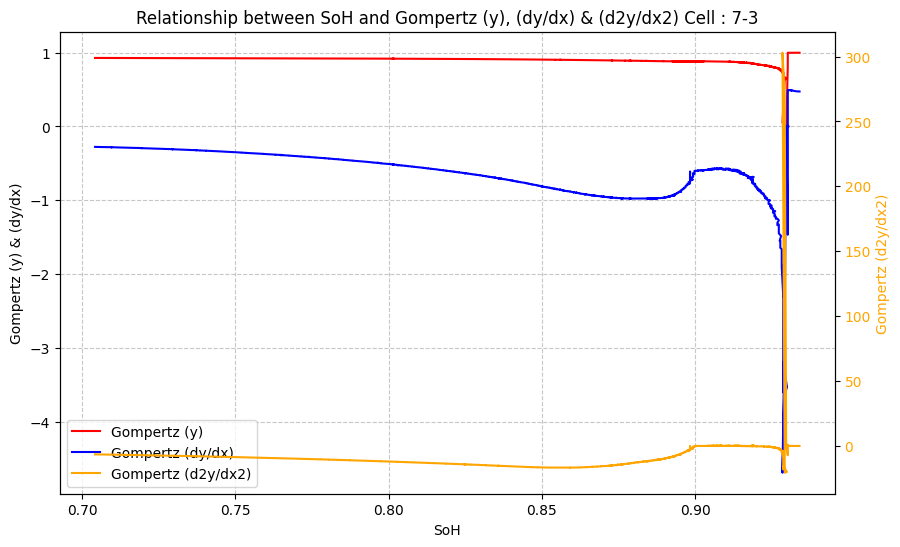

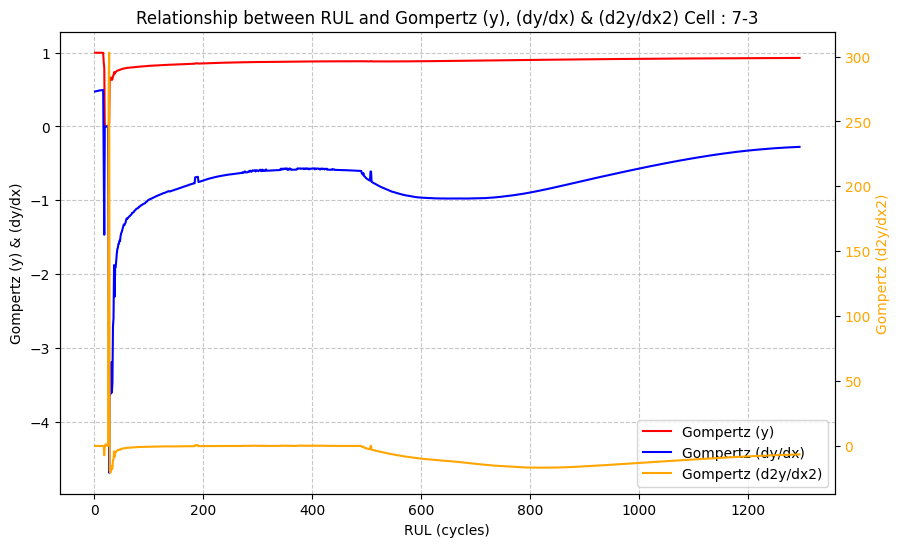

9-3 1905


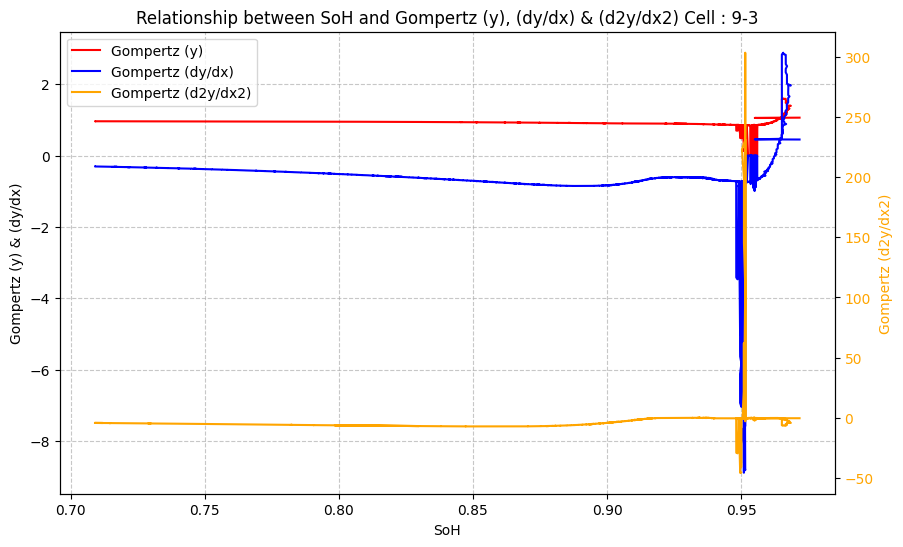

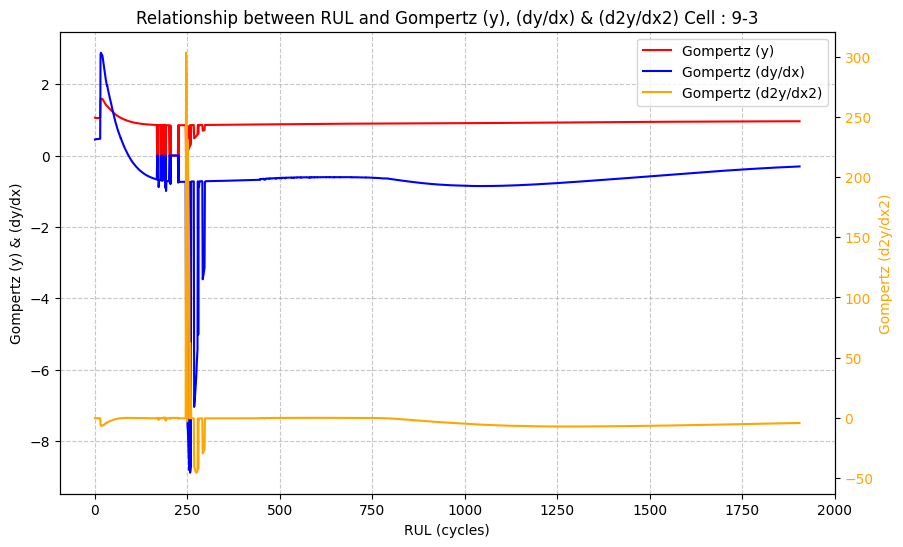

9-4 1975


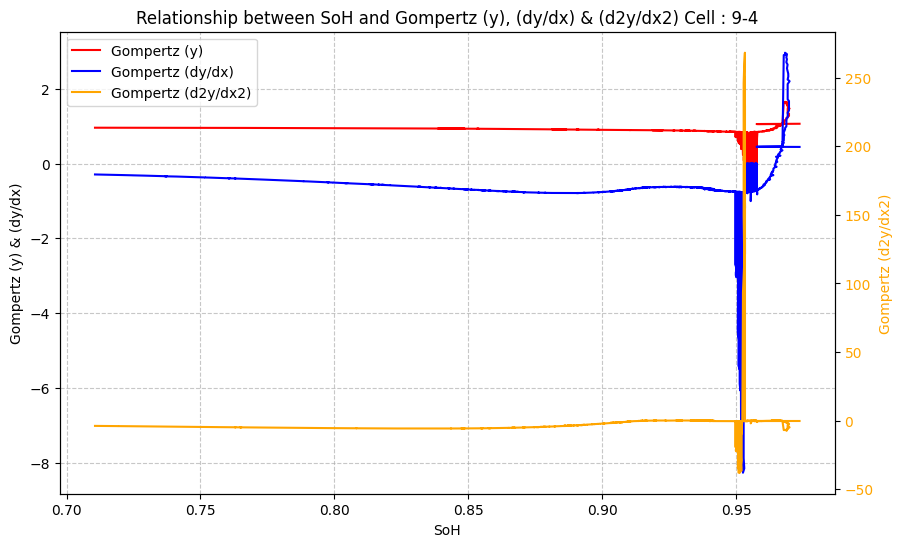

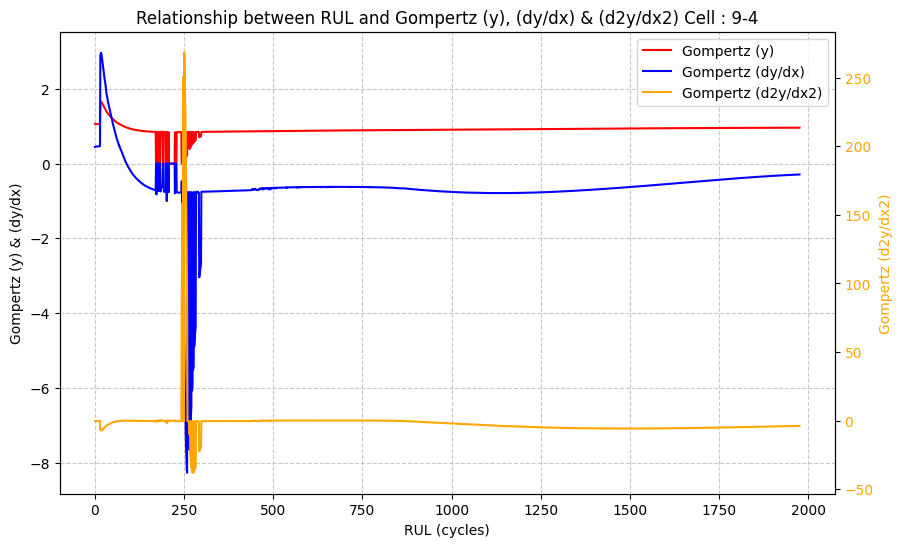

8-2 2041


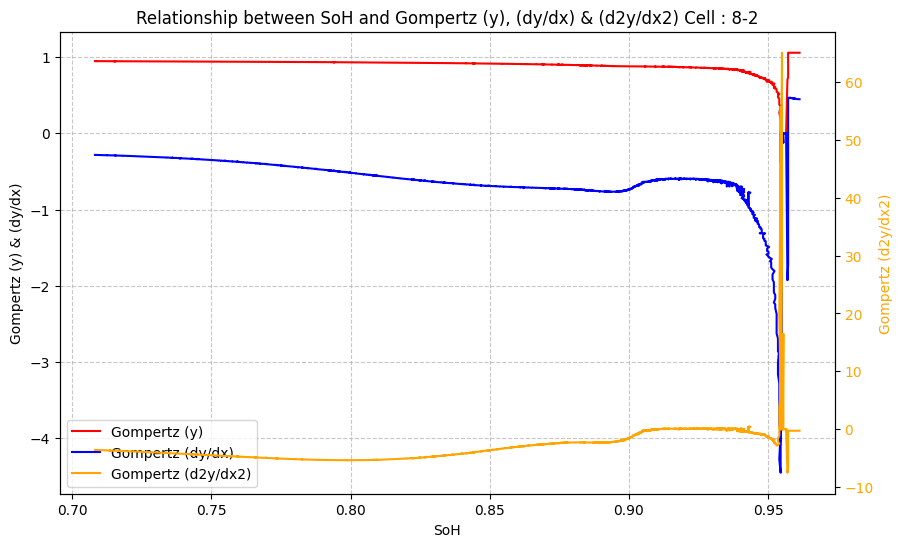

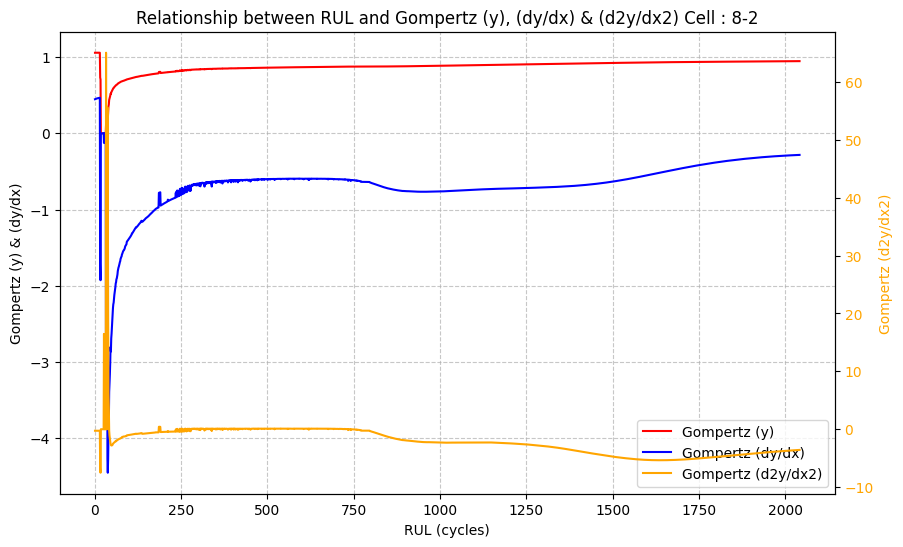

10-3 1848


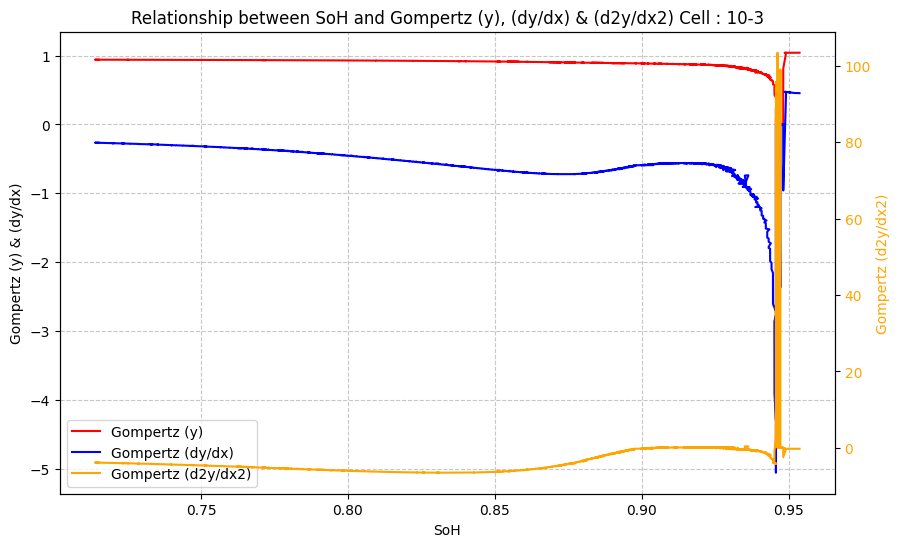

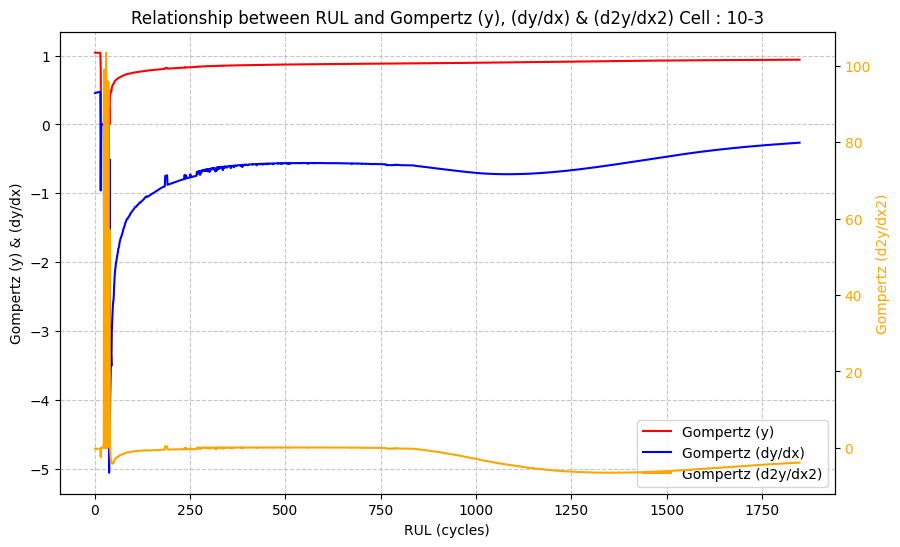

6-3 1804


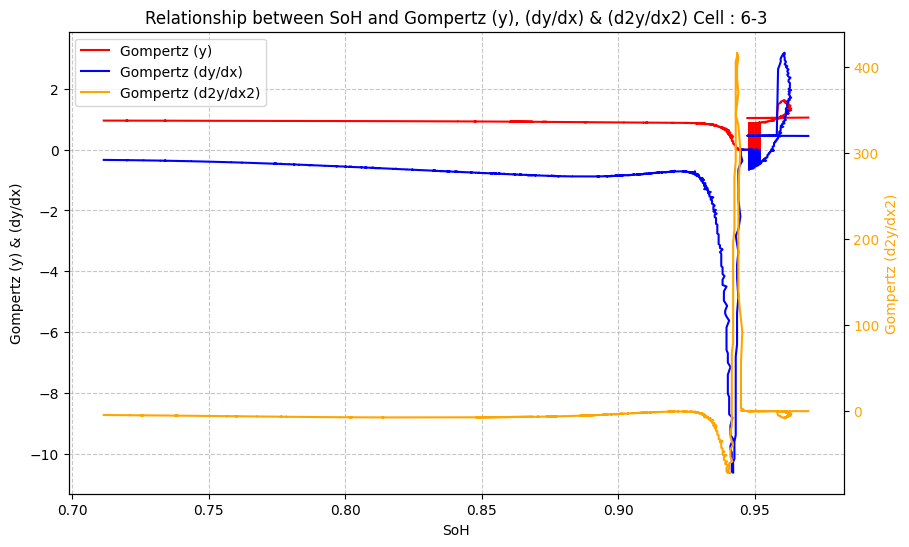

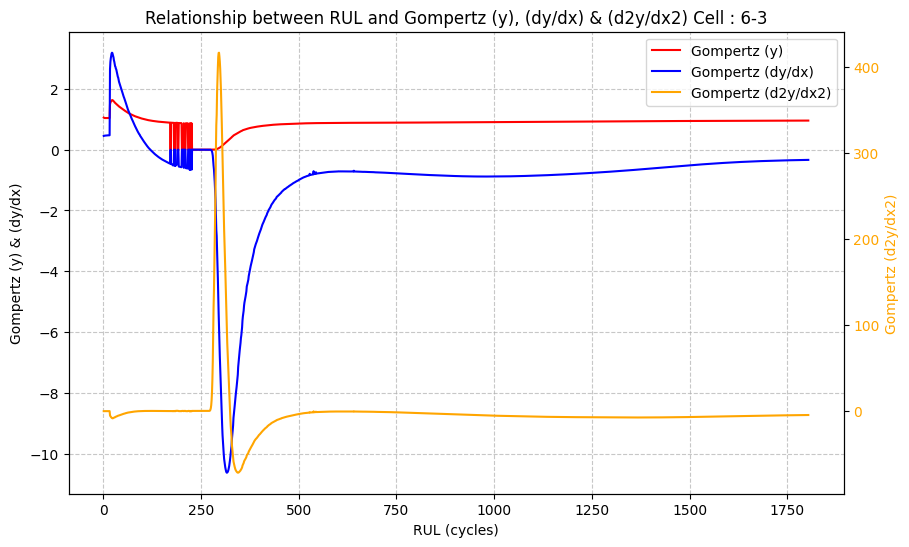

3-2 2283


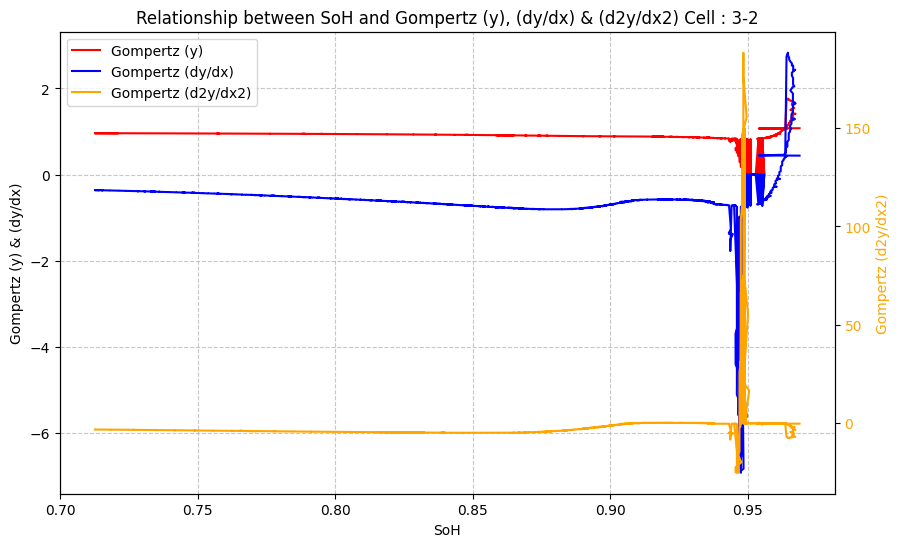

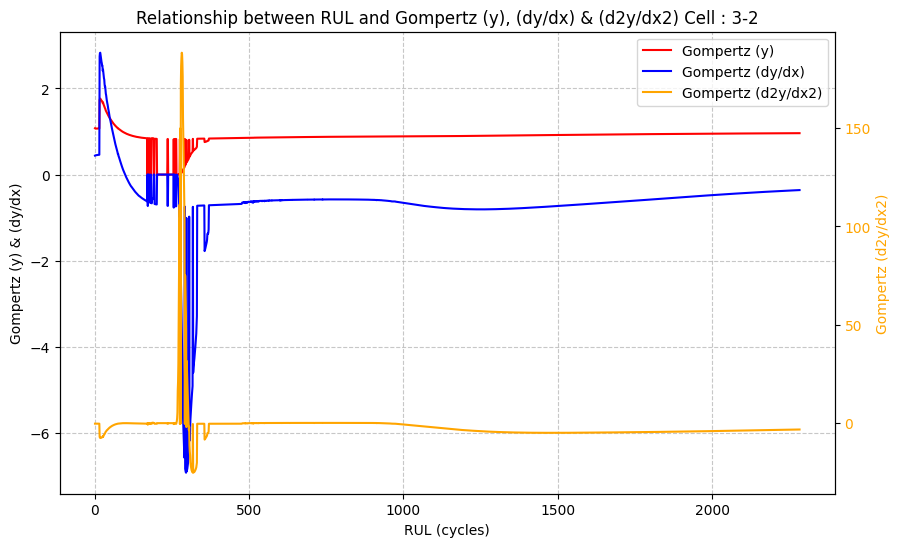

7-5 1875


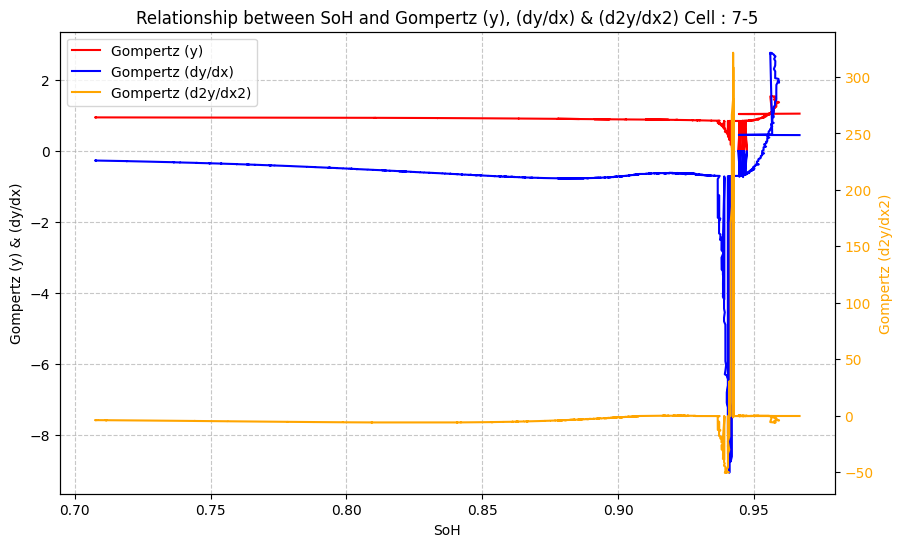

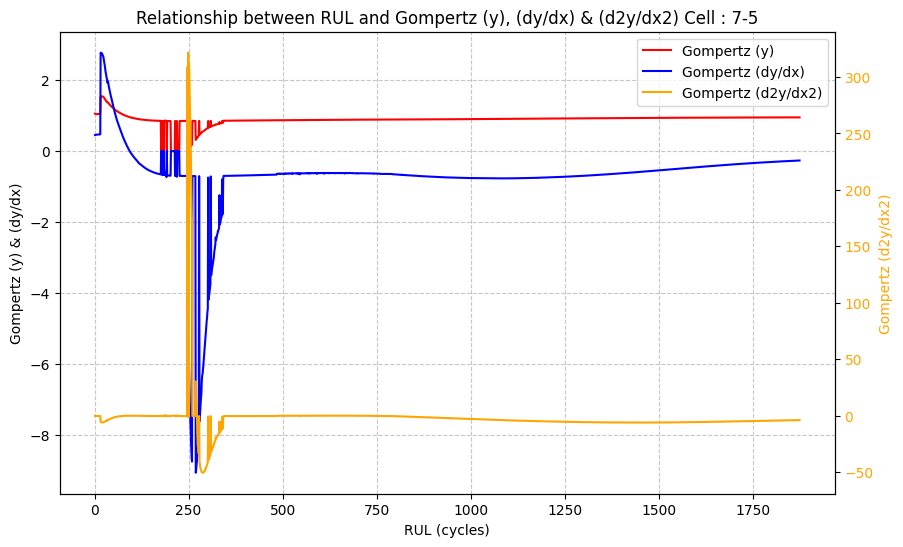

3-7 2479


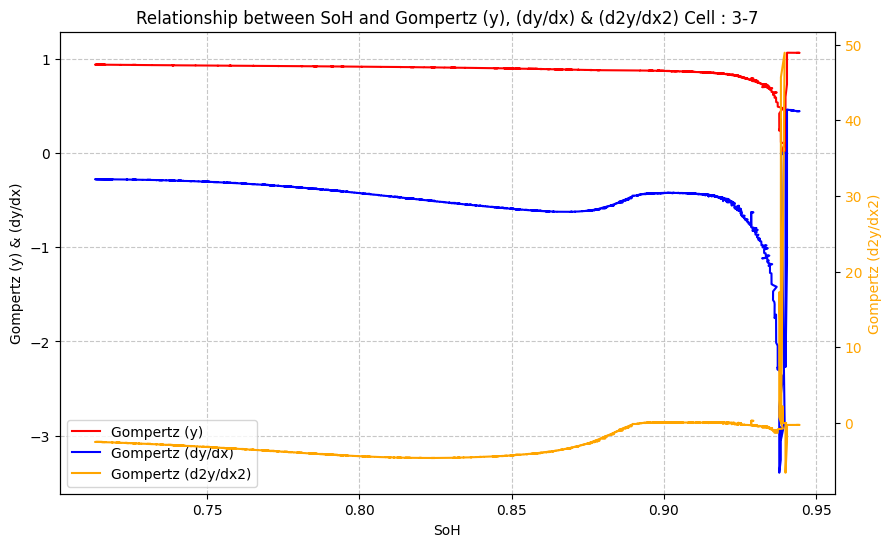

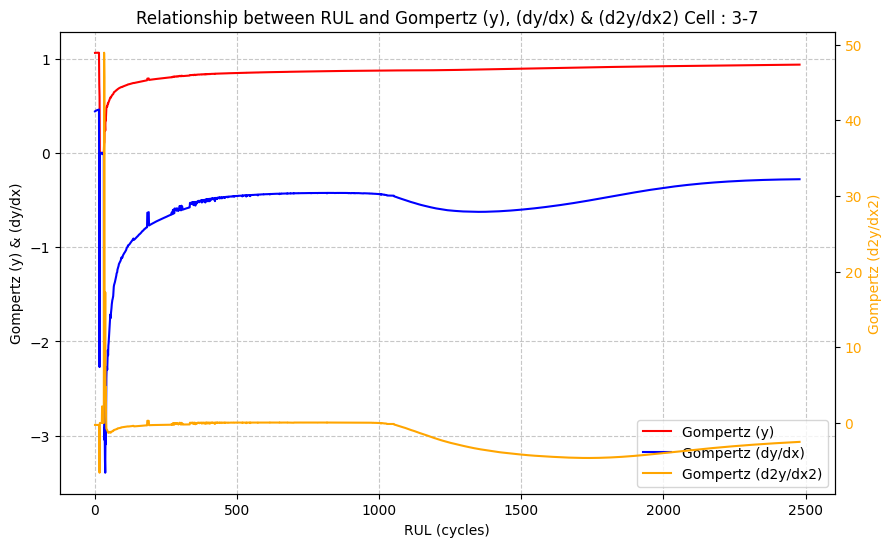

2-3 1751


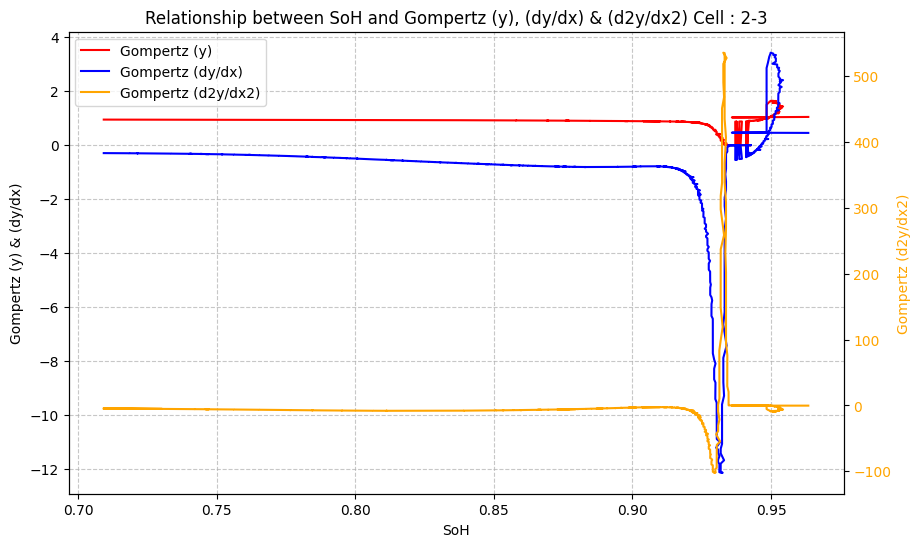

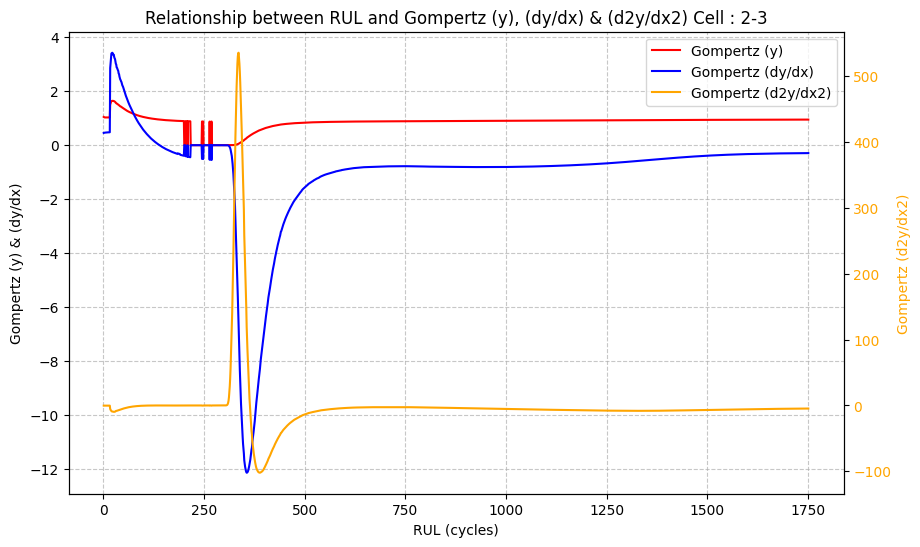

1-3 1858


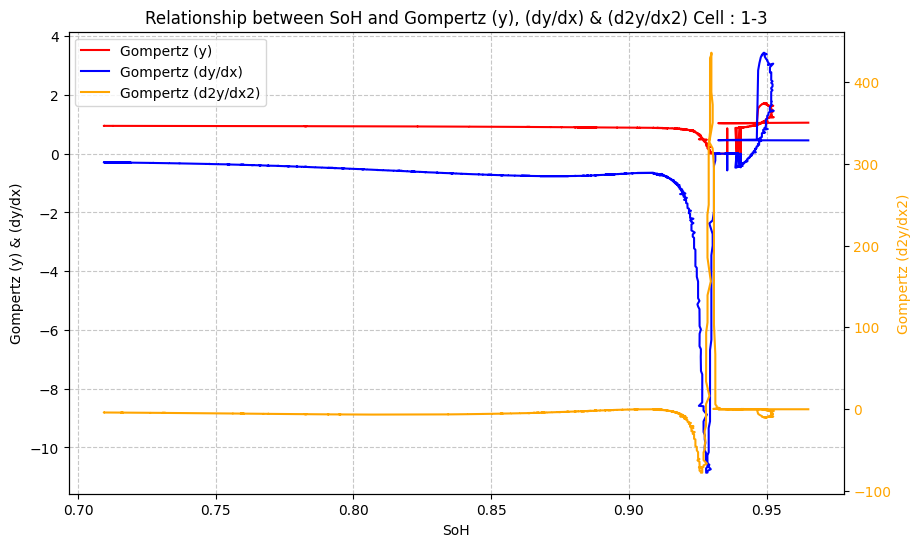

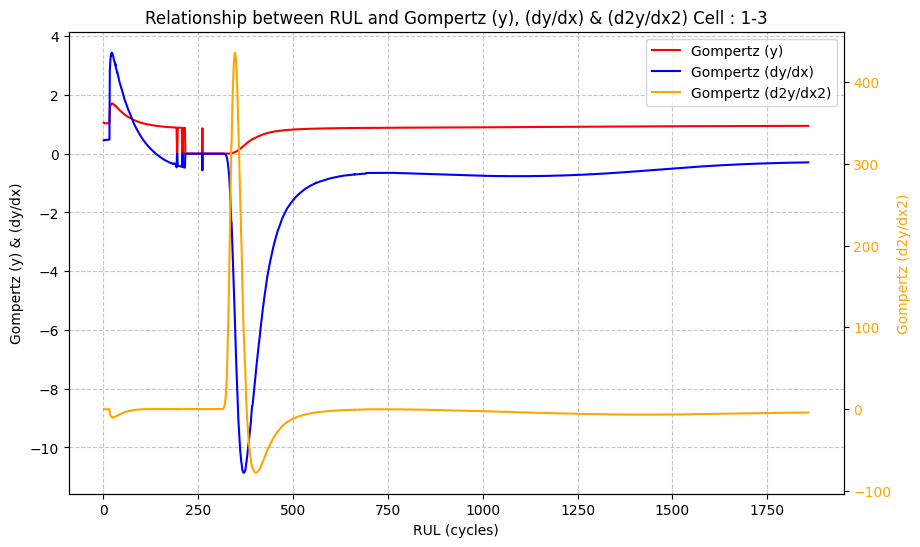

8-3 2290


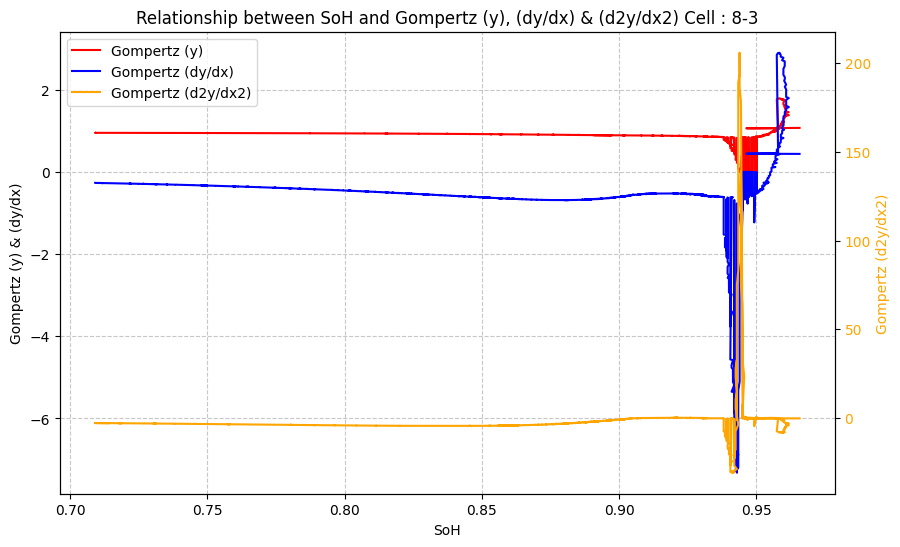

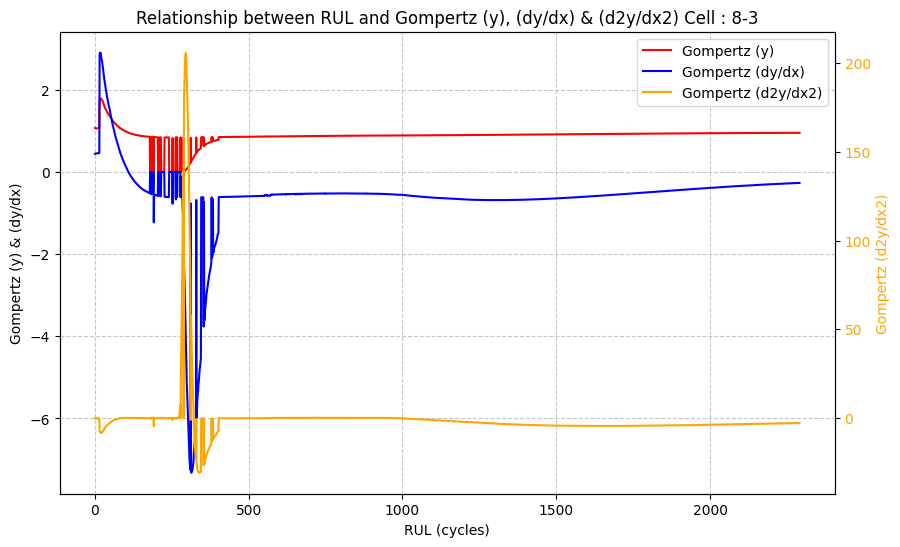

2-8 1481


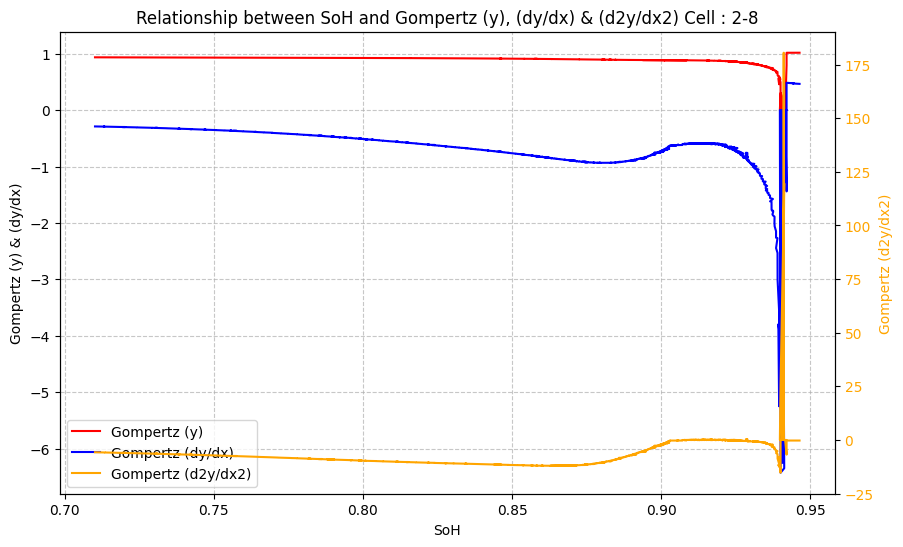

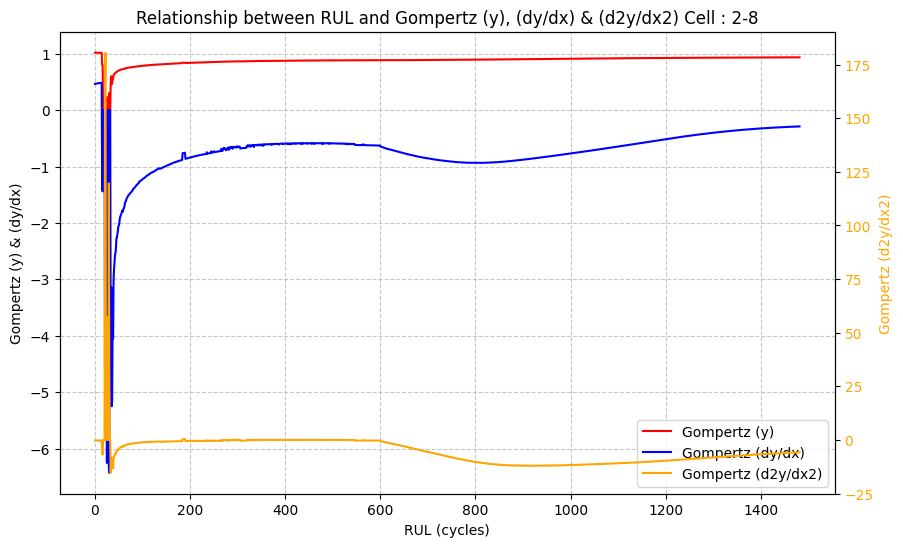

7-4 1393


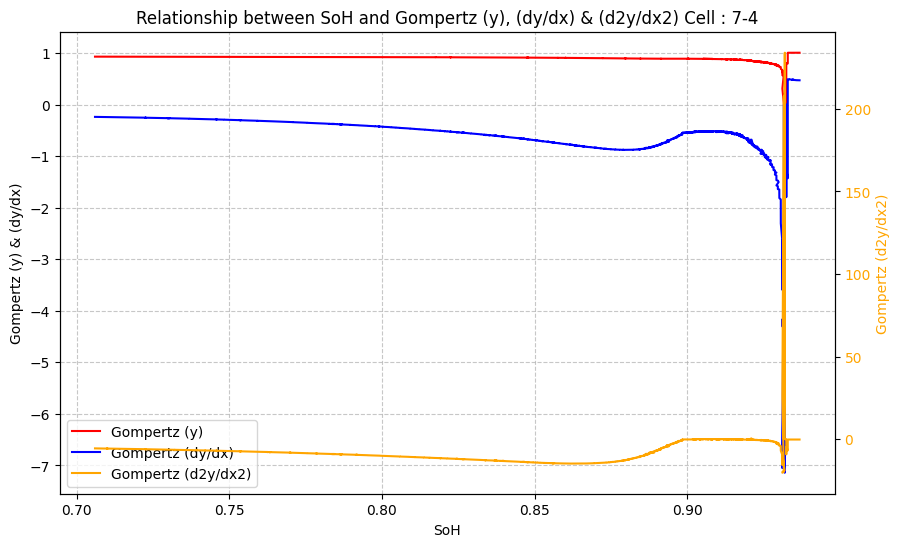

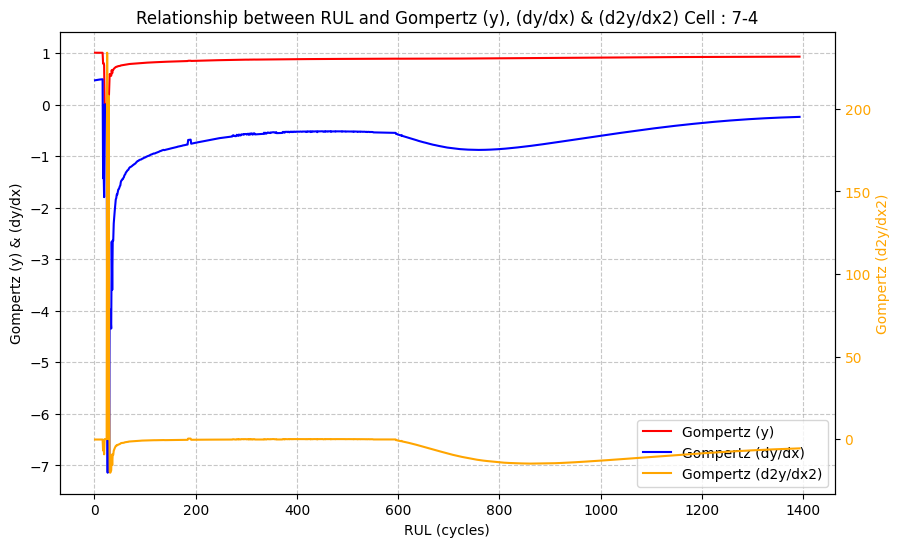

4-2 1782


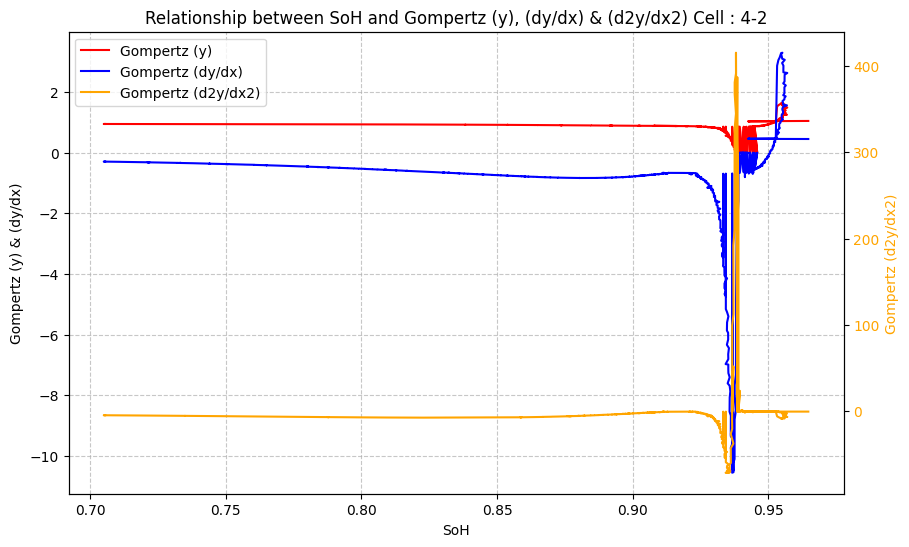

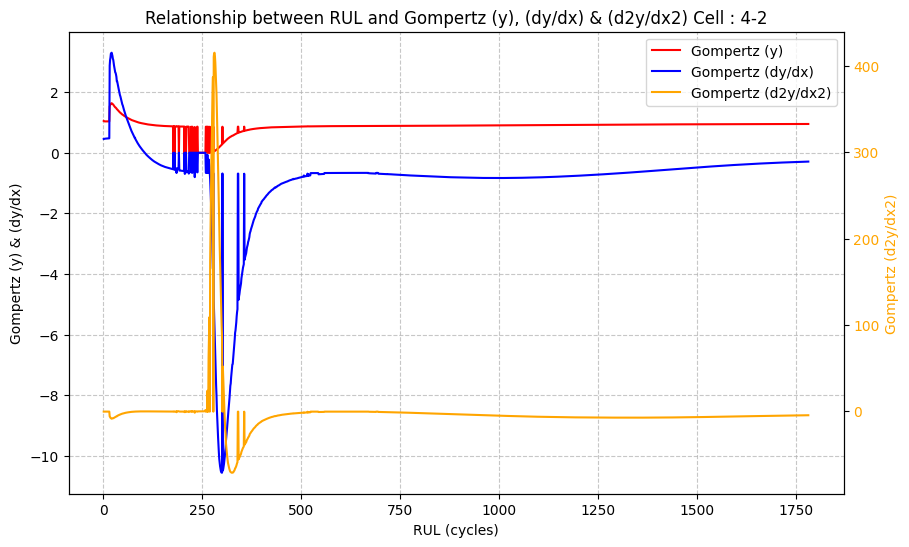

6-4 1717


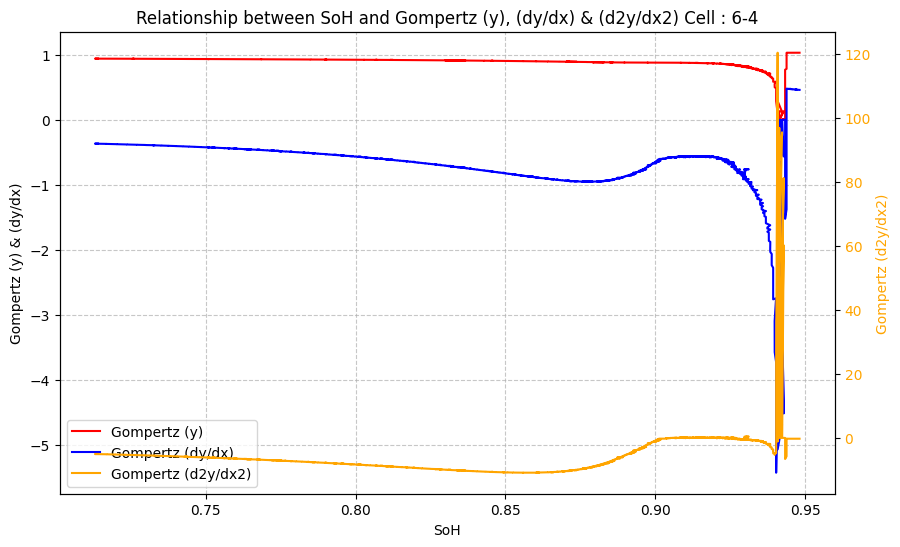

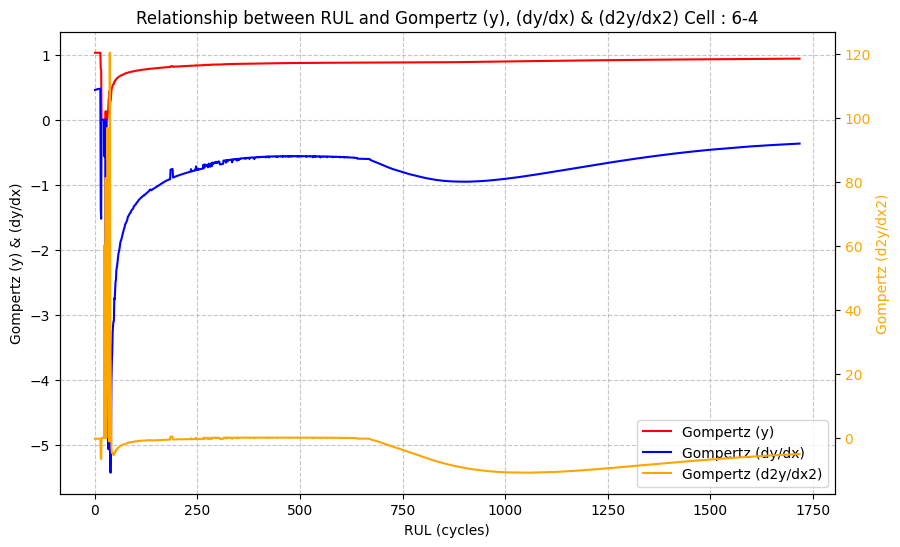

1-1 1504


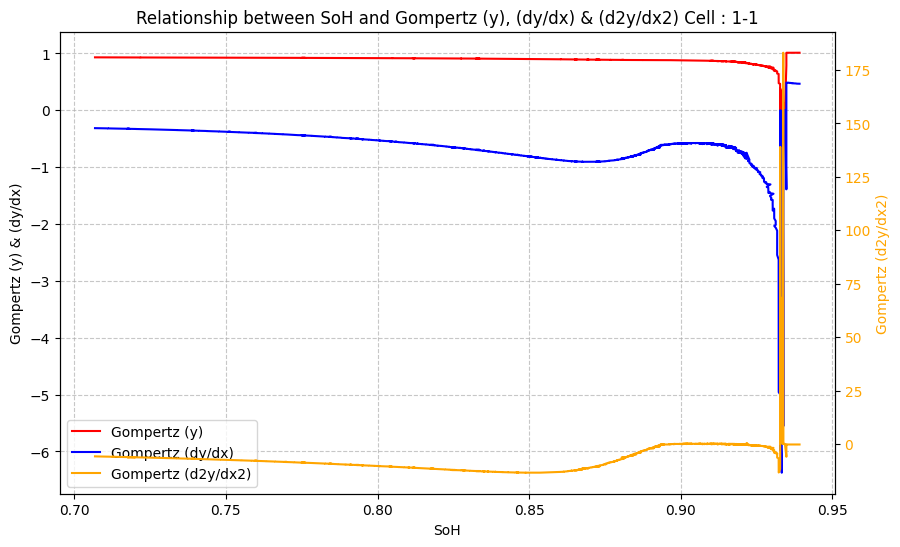

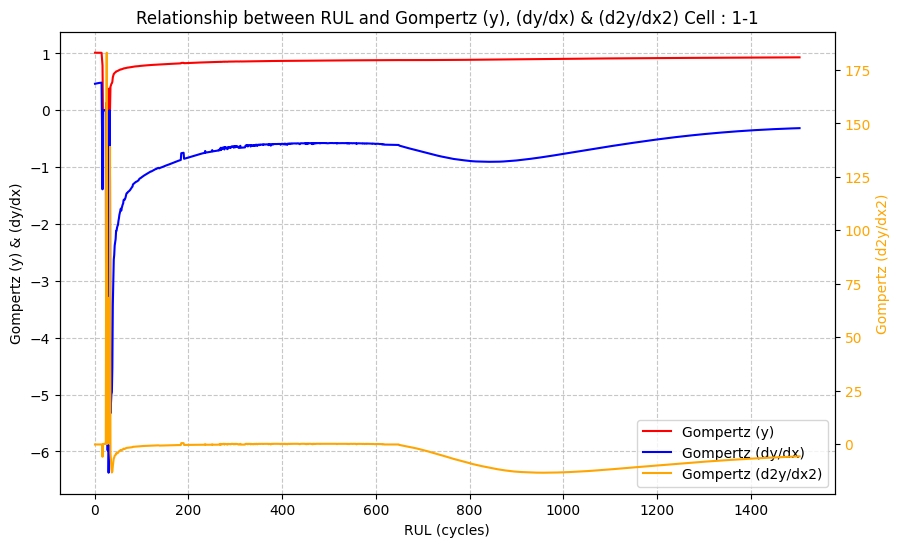

3-3 1649


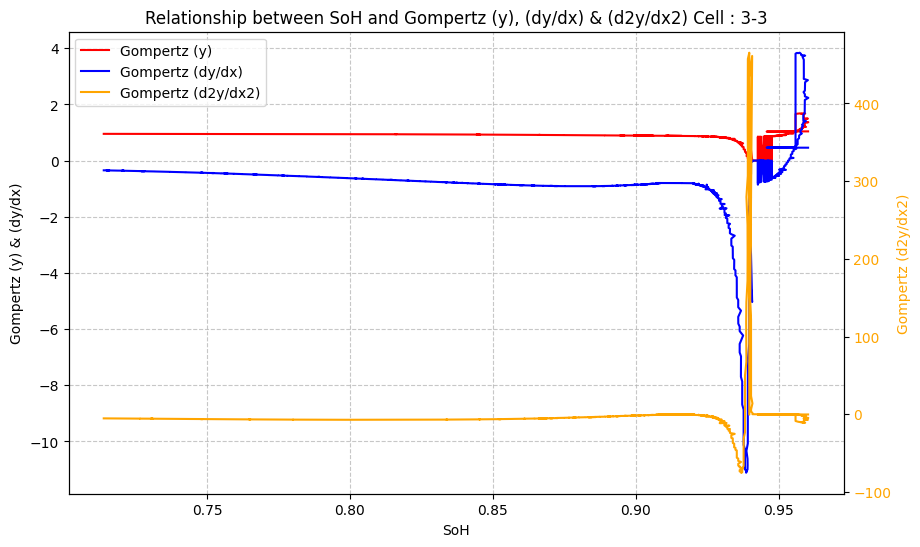

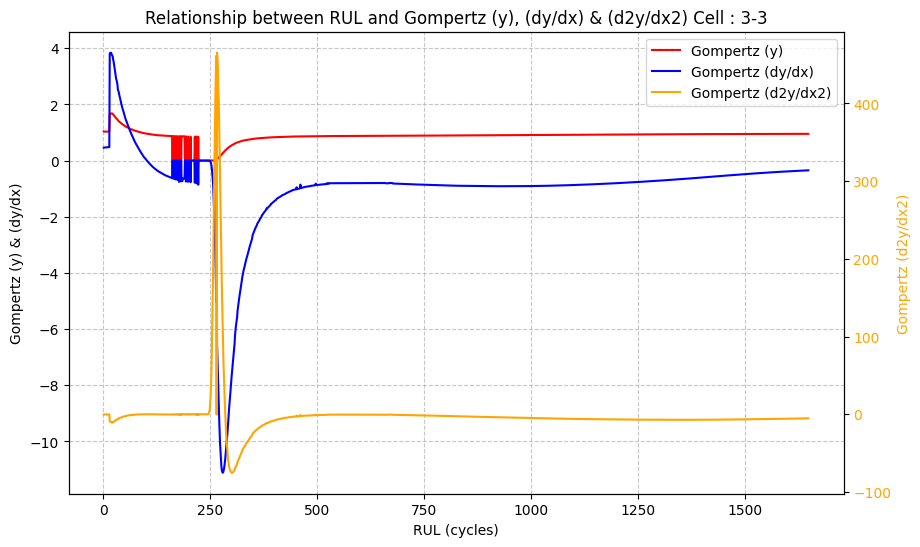

4-3 1142


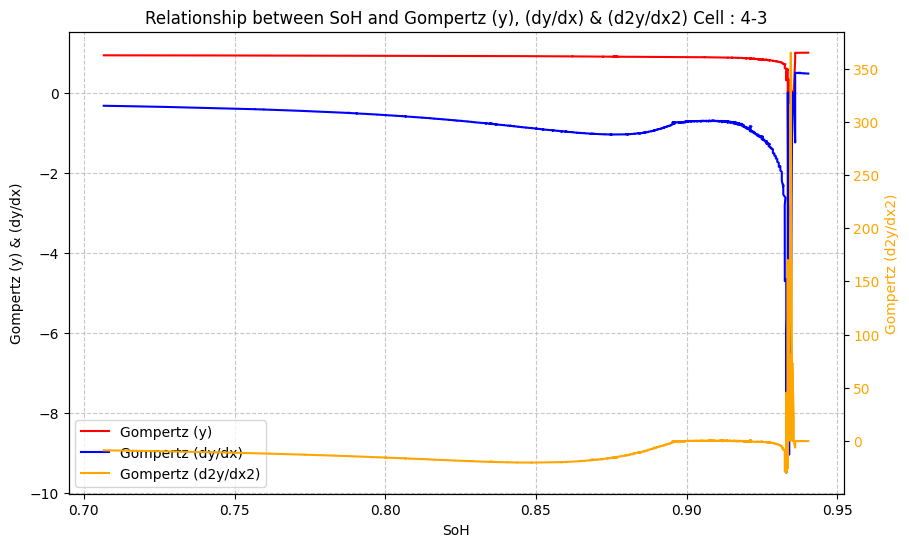

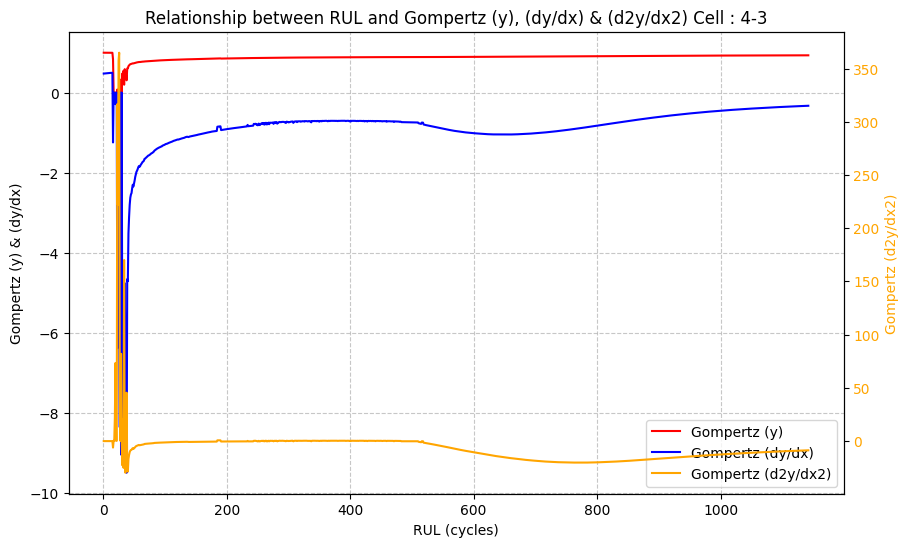

3-4 1766


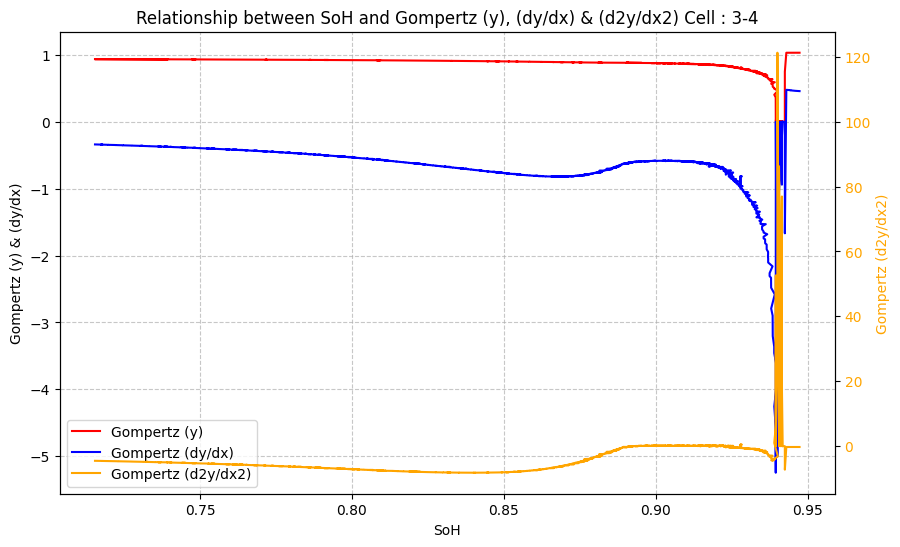

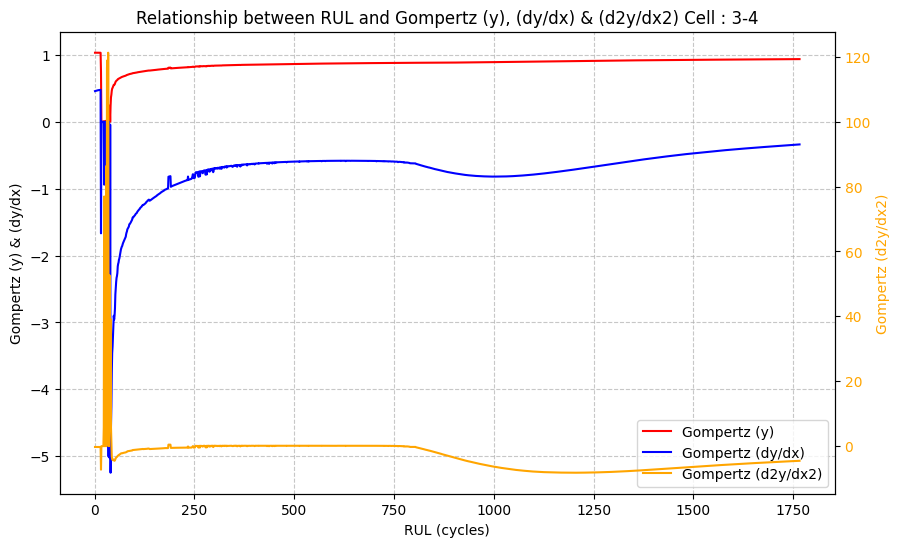

2-2 2651


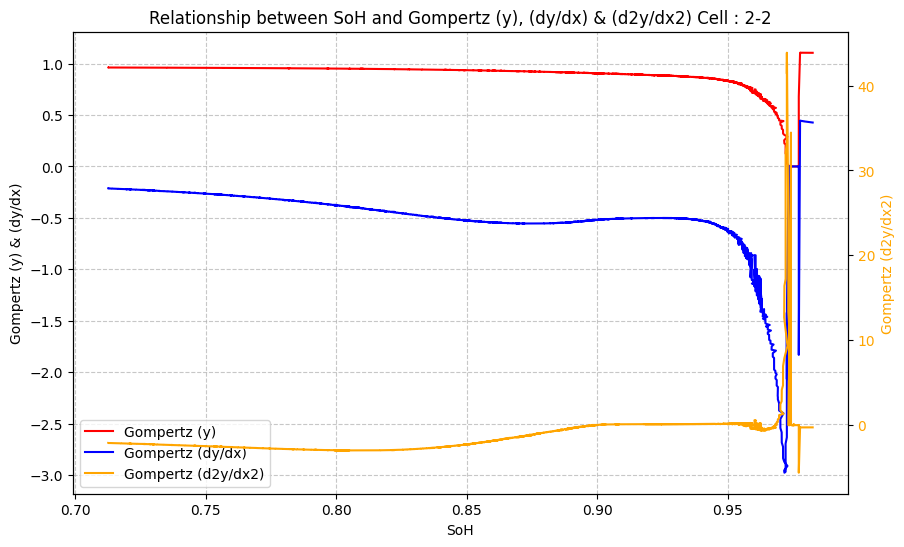

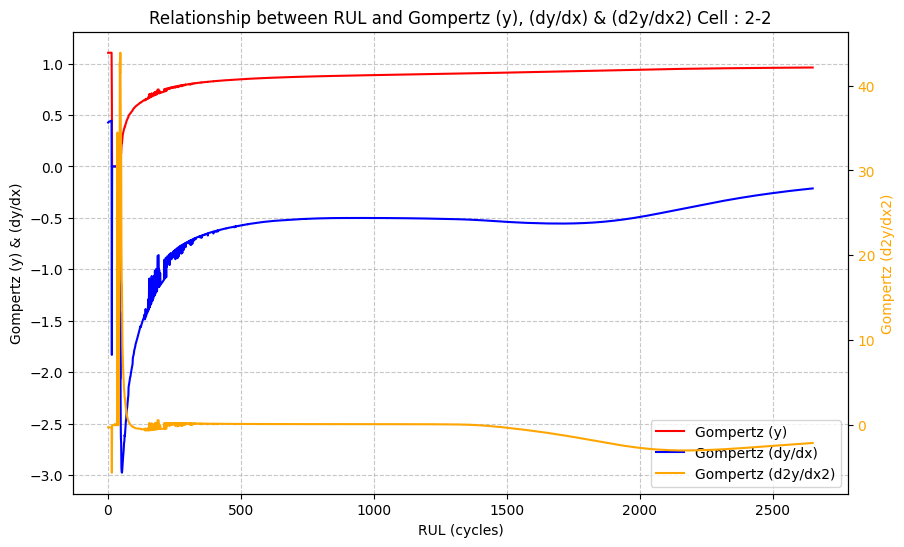

1-7 1678


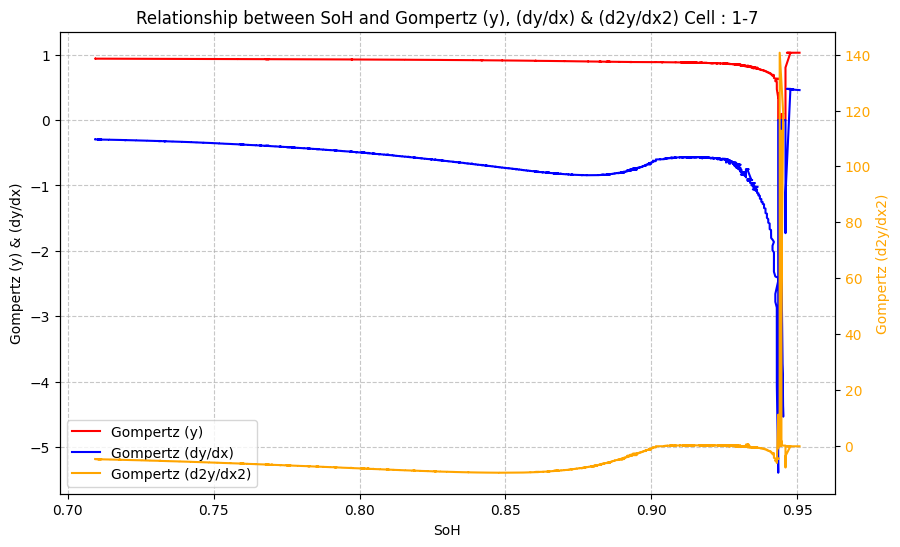

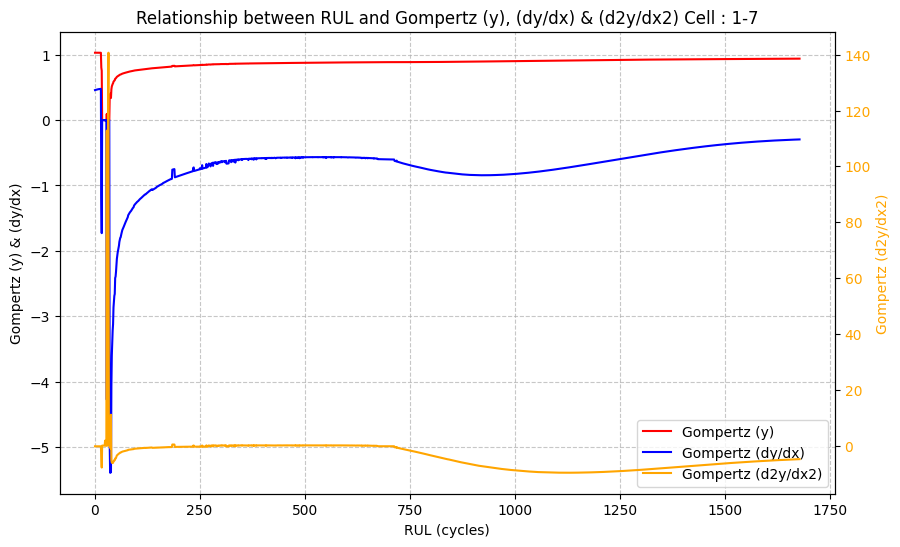

3-6 2491


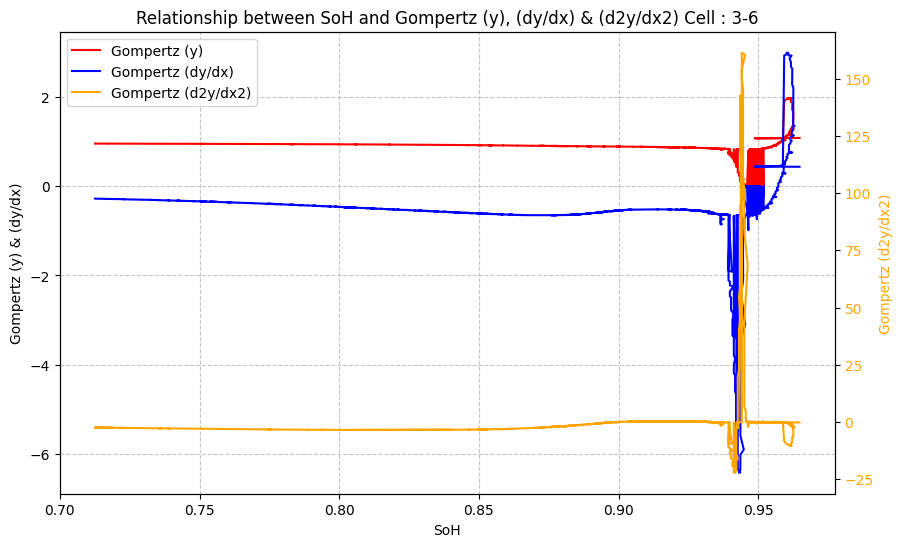

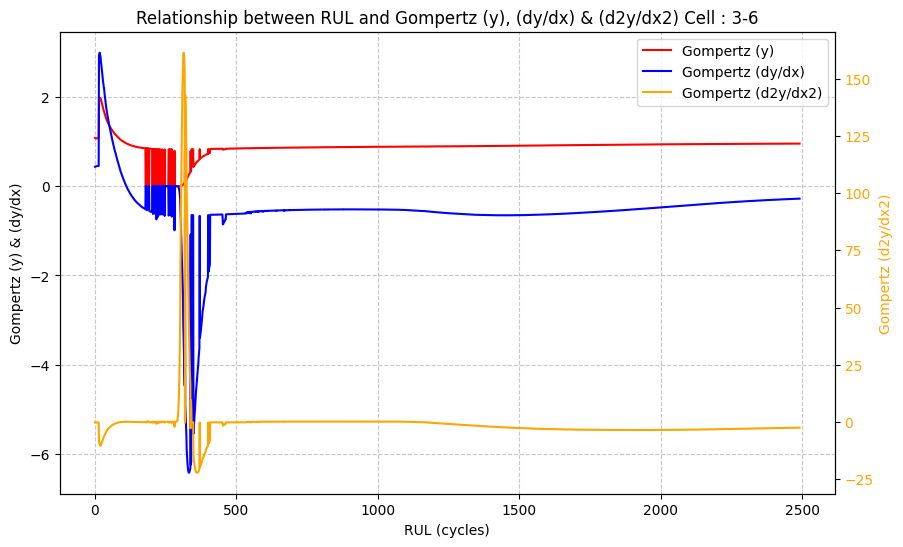

In [18]:
tRULs, tSoHs, tGompertz_y,tGompertz_dy_dx,tGompertz_d2y_dx2 = [],[], [], [], [] #list of lists
cRULs, cSoHs, cGompertz_y,cGompertz_dy_dx, cGompertz_d2y_dx2 = [],[], [], [], [] #combine single list   
for k in cycle_lengths_sort.keys():
    print(k,cycle_lengths_sort[k])
    if k == '1-8':
        continue #skip cell 1-8 as it has errors found my experiments and in reproducible experiments as per batteryml#
    RULs, SoHs, Gompertz_y,Gompertz_dy_dx, Gompertz_d2y_dx2 = [],[], [], [], []
    for i in range(1,cycle_lengths_sort[k]+1,1):

        row = unified_gompertz[str(i)][unified_gompertz[str(i)]['cell_name'] == k].squeeze()
        # print('SoH : ',row['SoH'],'Gompertz value',row['gompertz-value'])
        RULs.append(row['Cycle number']), SoHs.append((row['SoH'])),Gompertz_y.append(row['gompertz-value']),Gompertz_dy_dx.append(row['gompertz-1st-derivative-value']),Gompertz_d2y_dx2.append(row['gompertz-2nd-derivative-value'])
        cRULs.append(row['Cycle number']), cSoHs.append((row['SoH'])),cGompertz_y.append(row['gompertz-value']),cGompertz_dy_dx.append(row['gompertz-1st-derivative-value']),cGompertz_d2y_dx2.append(row['gompertz-2nd-derivative-value'])
    #Reverse SoHs and Gomperz so that plots are in reducing RUL order
    # RULs = RULs[::-1]
    # SoHs = SoHs[::-1]
    # Gompertz_y = Gompertz_y[::-1]
    # Gompertz_dy_dx = Gompertz_dy_dx[::-1]
    tRULs.append(RULs), tSoHs.append(SoHs),tGompertz_y.append(Gompertz_y),tGompertz_dy_dx.append(Gompertz_dy_dx),tGompertz_d2y_dx2.append(Gompertz_d2y_dx2)
    
    
    # plt.figure(figsize=(10, 6))
    
    # plt.plot(SoHs, Gompertz_dy_dx, linestyle='-', color='blue', label='Gompertz (dy/dx)')
    # #plt.plot(SoHs, Gompertz_d2y_dx2, color='orange', label='Gompertz (d2y/dx2)')
    # plt.plot(SoHs, Gompertz_y, color='red', label='Gompertz (y)')
    # #SoHs, Gompertz_y
    # # Labels and Title
    # plt.title(f'Relationship between SoH and Gompertz (y) , (dy/dx) & (d2y/dx2) Cell : {k}')
    # plt.xlabel('SoH')
    # plt.ylabel('Gompertz (y)/(dy/dx)/(d2y/dx2)')
    # plt.xlim(0,1)
    # plt.yscale('log')
    # plt.legend()
    # plt.grid(True, linestyle='--', alpha=0.7)
    
    # # Show/Save the plot
    # plt.savefig(f'cell-name-{k}-SoH-y-dy-dx.png')
    # plt.show()
    fig, ax1 = plt.subplots(figsize=(10, 6))
    
    # Plot Gompertz_y and Gompertz_dy_dx on the primary axis (ax1)
    # Storing the line objects to create a combined legend later
    l1, = ax1.plot(SoHs, Gompertz_y, color='red', label='Gompertz (y)')
    l2, = ax1.plot(SoHs, Gompertz_dy_dx, linestyle='-', color='blue', label='Gompertz (dy/dx)')
    
    # Configure the primary axis
    ax1.set_xlabel('SoH')
    ax1.set_ylabel('Gompertz (y) & (dy/dx)') # Label for left axis
    #ax1.set_yscale('log')
    ax1.grid(True, linestyle='--', alpha=0.7)
    
    # Create the secondary axis (right side) sharing the same x-axis
    ax2 = ax1.twinx()
    
    # Plot Gompertz_d2y_dx2 on the secondary axis (ax2)
    l3, = ax2.plot(SoHs, Gompertz_d2y_dx2, color='orange', label='Gompertz (d2y/dx2)')
    
    # Configure the secondary axis
    ax2.set_ylabel('Gompertz (d2y/dx2)', color='orange') # Label for right axis
    ax2.tick_params(axis='y', labelcolor='orange')       # Color the ticks to match
    #ax2.set_yscale('log')
    
    # Combine legends from both axes
    lines = [l1, l2, l3]
    labels = [l.get_label() for l in lines]
    ax1.legend(lines, labels, loc='best') 
    
    # Title and Save
    plt.title(f'Relationship between SoH and Gompertz (y), (dy/dx) & (d2y/dx2) Cell : {k}')
    plt.savefig(f'cell-name-{k}-Cycle-y-dy-dx-d2y-dx2.png')
    plt.show()
    # plt.figure(figsize=(10, 6))
    
    # plt.plot(RULs, Gompertz_dy_dx, linestyle='-', color='blue', label='Gompertz (dy/dx)')
    
    # plt.plot(RULs, Gompertz_d2y_dx2, color='orange', label='Gompertz (d2y/dx2)')
    # plt.plot(RULs, Gompertz_y, color='red', label='Gompertz (y)')
    # #SoHs, Gompertz_y
    # # Labels and Title
    # plt.title(f'Relationship between RUL and Gompertz (y) , (dy/dx) & (d2y/dx2) Cell : {k}')
    # plt.xlabel('RUL (cycles)')
    # plt.ylabel('Gompertz (y)/(dy/dx)/(d2y/dx2)')
    # plt.legend()
    # plt.yscale('log')
    # plt.grid(True, linestyle='--', alpha=0.7)
    
    # # Show/Save the plot
    # plt.savefig(f'cell-name-{k}-Cycle-y-dy-dx.png')
    # plt.show()

    # Create the figure and the primary axis (left side)
    fig, ax1 = plt.subplots(figsize=(10, 6))
    
    # Plot Gompertz_y and Gompertz_dy_dx on the primary axis (ax1)
    # Storing the line objects to create a combined legend later
    l1, = ax1.plot(RULs, Gompertz_y, color='red', label='Gompertz (y)')
    l2, = ax1.plot(RULs, Gompertz_dy_dx, linestyle='-', color='blue', label='Gompertz (dy/dx)')
    
    # Configure the primary axis
    ax1.set_xlabel('RUL (cycles)')
    ax1.set_ylabel('Gompertz (y) & (dy/dx)') # Label for left axis
    #ax1.set_yscale('log')
    ax1.grid(True, linestyle='--', alpha=0.7)
    
    # Create the secondary axis (right side) sharing the same x-axis
    ax2 = ax1.twinx()
    
    # Plot Gompertz_d2y_dx2 on the secondary axis (ax2)
    l3, = ax2.plot(RULs, Gompertz_d2y_dx2, color='orange', label='Gompertz (d2y/dx2)')
    
    # Configure the secondary axis
    ax2.set_ylabel('Gompertz (d2y/dx2)', color='orange') # Label for right axis
    ax2.tick_params(axis='y', labelcolor='orange')       # Color the ticks to match
    #ax2.set_yscale('log')
    
    # Combine legends from both axes
    lines = [l1, l2, l3]
    labels = [l.get_label() for l in lines]
    ax1.legend(lines, labels, loc='best') 
    
    # Title and Save
    plt.title(f'Relationship between RUL and Gompertz (y), (dy/dx) & (d2y/dx2) Cell : {k}')
    plt.savefig(f'cell-name-{k}-Cycle-y-dy-dx-d2y-dx2.png')
    plt.show()
        #break
    #break

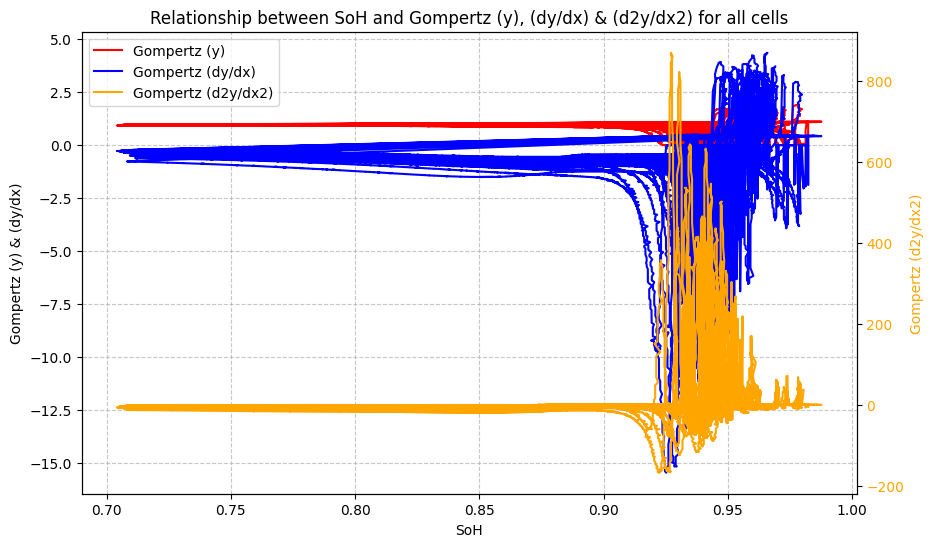

In [19]:
# plt.figure(figsize=(10, 6))

# # 1. Line Graph (shows the trend)
# plt.plot(cSoHs, cGompertz_dy_dx, linestyle='-', color='blue', label='Gompertz (dy/dx)')

# # 2. Scatter Plot (shows specific data points)
# plt.plot(cSoHs, cGompertz_y, color='red', label='Gompertz (y)')
# #SoHs, Gompertz_y
# # Labels and Title
# plt.title('Relationship between SoH and Gompertz (y) & Gompertz (dy/dx) for all cells')
# plt.xlabel('SoH')
# plt.ylabel('Gompertz (y)/Gompertz (dy/dx)')
# plt.legend()
# plt.grid(True, linestyle='--', alpha=0.7)

# # Show/Save the plot
# plt.savefig(f'combined-SoH-y-dy-dx.png')
# plt.show()



# Create the figure and the primary axis (left side)
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot Gompertz_y and Gompertz_dy_dx on the primary axis (ax1)
# Storing the line objects to create a combined legend later
l1, = ax1.plot(cSoHs, cGompertz_y, color='red', label='Gompertz (y)')
l2, = ax1.plot(cSoHs, cGompertz_dy_dx, linestyle='-', color='blue', label='Gompertz (dy/dx)')

# Configure the primary axis
ax1.set_xlabel('SoH')
ax1.set_ylabel('Gompertz (y) & (dy/dx)') # Label for left axis
#ax1.set_yscale('log')
ax1.grid(True, linestyle='--', alpha=0.7)

# Create the secondary axis (right side) sharing the same x-axis
ax2 = ax1.twinx()

# Plot Gompertz_d2y_dx2 on the secondary axis (ax2)
l3, = ax2.plot(cSoHs, cGompertz_d2y_dx2, color='orange', label='Gompertz (d2y/dx2)')

# Configure the secondary axis
ax2.set_ylabel('Gompertz (d2y/dx2)', color='orange') # Label for right axis
ax2.tick_params(axis='y', labelcolor='orange')       # Color the ticks to match
#ax2.set_yscale('log')

# Combine legends from both axes
lines = [l1, l2, l3]
labels = [l.get_label() for l in lines]
ax1.legend(lines, labels, loc='best') 

# Title and Save
plt.title(f'Relationship between SoH and Gompertz (y), (dy/dx) & (d2y/dx2) for all cells')
plt.savefig(f'combined-SoH-y-dy-dx.png')
plt.show()

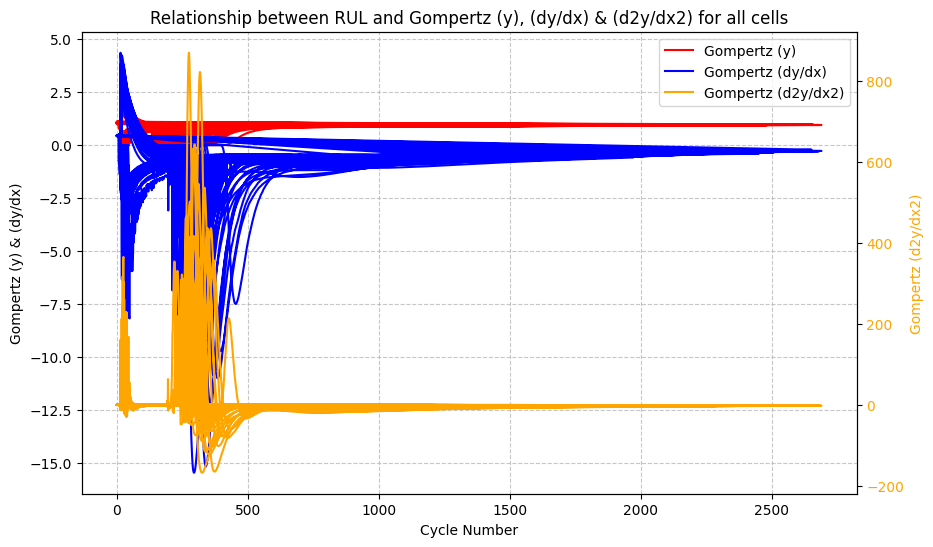

In [20]:
# plt.figure(figsize=(10, 6))

# # 1. Line Graph (shows the trend)
# plt.plot(cRULs, cGompertz_dy_dx, linestyle='-', color='blue', label='Gompertz (dy/dx)')

# # 2. Scatter Plot (shows specific data points)
# plt.plot(cRULs, cGompertz_y, color='red', label='Gompertz (y)')
# #SoHs, Gompertz_y
# # Labels and Title
# plt.title('Relationship between Cycle and Gompertz (y) & Gompertz (dy/dx) for all cells')
# plt.xlabel('Cycle')
# plt.ylabel('Gompertz (y)/Gompertz (dy/dx)')
# plt.legend()
# plt.grid(True, linestyle='--', alpha=0.7)

# # Show/Save the plot
# plt.savefig(f'combined-Cycle-y-dy-dx.png')
# plt.show()

# Create the figure and the primary axis (left side)
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot Gompertz_y and Gompertz_dy_dx on the primary axis (ax1)
# Storing the line objects to create a combined legend later
l1, = ax1.plot(cRULs, cGompertz_y, color='red', label='Gompertz (y)')
l2, = ax1.plot(cRULs, cGompertz_dy_dx, linestyle='-', color='blue', label='Gompertz (dy/dx)')

# Configure the primary axis
ax1.set_xlabel('Cycle Number')
ax1.set_ylabel('Gompertz (y) & (dy/dx)') # Label for left axis
#ax1.set_yscale('log')
ax1.grid(True, linestyle='--', alpha=0.7)

# Create the secondary axis (right side) sharing the same x-axis
ax2 = ax1.twinx()

# Plot Gompertz_d2y_dx2 on the secondary axis (ax2)
l3, = ax2.plot(cRULs, cGompertz_d2y_dx2, color='orange', label='Gompertz (d2y/dx2)')

# Configure the secondary axis
ax2.set_ylabel('Gompertz (d2y/dx2)', color='orange') # Label for right axis
ax2.tick_params(axis='y', labelcolor='orange')       # Color the ticks to match
#ax2.set_yscale('log')

# Combine legends from both axes
lines = [l1, l2, l3]
labels = [l.get_label() for l in lines]
ax1.legend(lines, labels, loc='best') 

# Title and Save
plt.title(f'Relationship between RUL and Gompertz (y), (dy/dx) & (d2y/dx2) for all cells')
plt.savefig(f'combined-Cycle-y-dy-dx-d2y-dx2.png')
plt.show()

In [21]:
cell_mins, cell_maxs = [], []
for cell in tSoHs:
    cell_min = (min(cell))
    cell_max = (max(cell))
    cell_mins.append(cell_min)
    cell_maxs.append(cell_max)
    #print(cell_min)
print('Local lowest cut off : ',min(cell_mins),' \nGlobal lowest cut off ',max(cell_mins))
print('Local highest cut off : ',min(cell_maxs),' \nGlobal highest cut off ',max(cell_maxs))

Local lowest cut off :  0.7041660584101862  
Global lowest cut off  0.7164727140974975
Local highest cut off :  0.9340902086078116  
Global highest cut off  0.9876945564339056


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


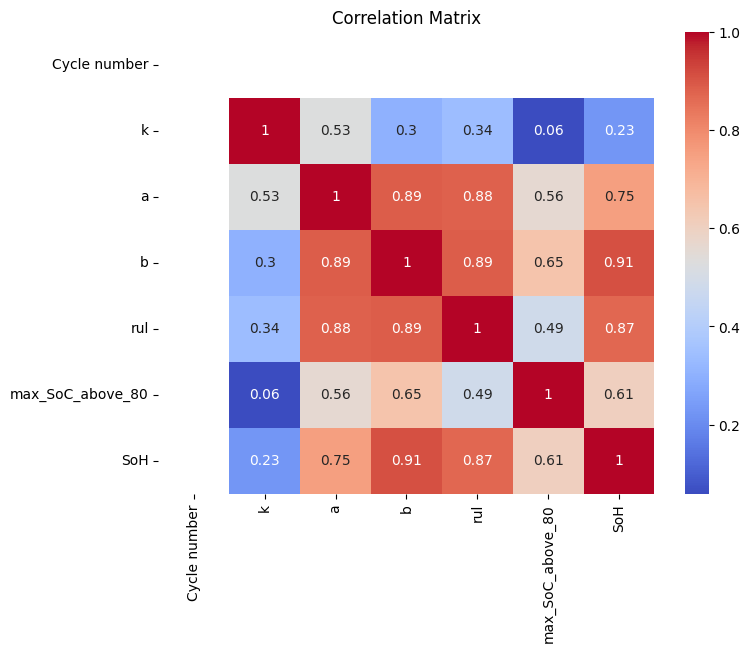

In [22]:
corr = unified_gompertz['1000'][['Cycle number','k','a','b','rul','max_SoC_above_80','SoH']].corr()#df.corr()

plt.figure(figsize=(8,6))
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.title("Correlation Matrix")
plt.show()


In [23]:
gompertz_df_full.head()

,Cycle number,k,a,b,rul,max_SoC_above_80,SoH,gompertz-value,gompertz-1st-derivative-value,gompertz-2nd-derivative-value,cell_name
0,1,1.617735,-0.662151,1.000166,2689,30.101008,0.965929,1.090793,0.429977,-0.260557,5-3
1,2,1.621223,-0.658170,1.000249,2688,30.101008,0.966171,1.091395,0.431999,-0.261111,5-3
2,3,1.624741,-0.652583,1.000330,2687,30.101008,0.964001,1.091306,0.434453,-0.261639,5-3
3,4,1.627512,-0.648350,1.000411,2686,30.101008,0.963521,1.091289,0.436359,-0.262057,5-3
4,5,1.630011,-0.644633,1.000491,2685,30.101008,0.963042,1.091305,0.438060,-0.262434,5-3


In [24]:
temp_data = gompertz_df_full[gompertz_df_full["Cycle number"]==1].iloc[0].to_dict()
temp_data

{'Cycle number': 1,
 'k': 1.617734965578861,
 'a': -0.6621505468595662,
 'b': 1.0001662186768443,
 'rul': 2689,
 'max_SoC_above_80': 30.101007853534725,
 'SoH': 0.9659291238471642,
 'gompertz-value': 1.090793253195987,
 'gompertz-1st-derivative-value': 0.4299768747394458,
 'gompertz-2nd-derivative-value': -0.260556910808387,
 'cell_name': '5-3'}

In [25]:
i

2491

In [26]:
values = sorted(cycle_lengths)
import numpy as np
bins = np.linspace(min(values), max(values), 12)
digitized = np.digitize(values, bins)

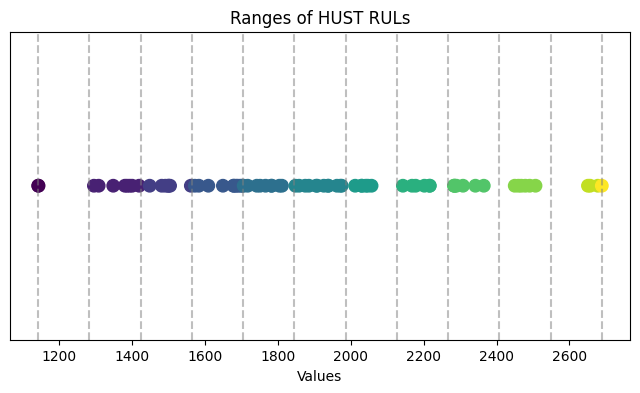

In [27]:
# --- Plotting ---
plt.figure(figsize=(8, 4))

# Scatter plot colored by bin index
plt.scatter(values, np.zeros_like(values), c=digitized, s=80)

# Plot bin edges as vertical lines
for b in bins:
    plt.axvline(b, color='gray', linestyle='--', alpha=0.5)

plt.xlabel("Values")
plt.yticks([])  # hide y-axis
plt.title("Ranges of HUST RULs")

plt.show()

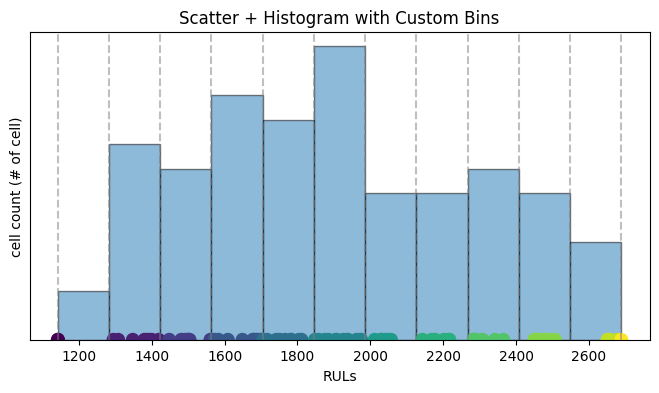

In [28]:
plt.figure(figsize=(8, 4))

# Histogram
plt.hist(values, bins=bins, edgecolor="black", alpha=0.5)

# Scatter points colored by bin
plt.scatter(values, np.zeros_like(values), c=digitized, s=80)

# Bin edges
for b in bins:
    plt.axvline(b, color='gray', linestyle='--', alpha=0.5)

plt.yticks([])
plt.xlabel("RULs")
plt.ylabel("cell count (# of cell)")
plt.title("Scatter + Histogram with Custom Bins")
plt.show()

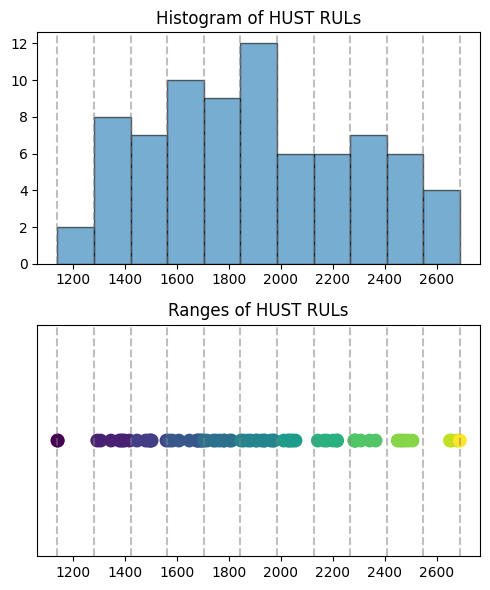

In [29]:
k = 77
# Bin counts
counts = [(digitized == i).sum() for i in range(1, k+1)]

# --- Plot ---
fig, axes = plt.subplots(2, 1, figsize=(5, 6), sharex=False)

# 1️⃣ Histogram
axes[0].hist(values, bins=bins, edgecolor="black", alpha=0.6)
axes[0].set_title("Histogram of HUST RULs")
for b in bins:
    axes[0].axvline(b, color='gray', linestyle='--', alpha=0.5)

# 2️⃣ Scatter + bin edges
axes[1].scatter(values, np.zeros_like(values), c=digitized, s=80)
for b in bins:
    axes[1].axvline(b, color='gray', linestyle='--', alpha=0.5)
axes[1].set_yticks([])
axes[1].set_title("Ranges of HUST RULs")

plt.tight_layout()
plt.show()

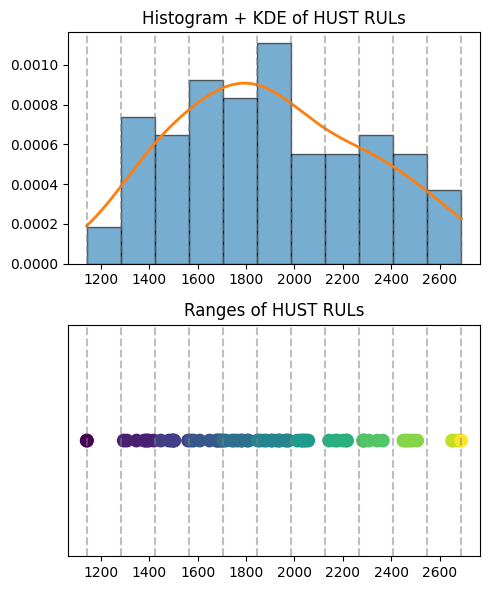

In [30]:
from scipy.stats import gaussian_kde
# KDE estimator
kde = gaussian_kde(values)

# Create a smooth x-grid for plotting KDE
x_grid = np.linspace(min(values), max(values), 500)
kde_vals = kde(x_grid)

# Bin counts
counts = [(digitized == i).sum() for i in range(1, k+1)]

# --- Plot ---
fig, axes = plt.subplots(2, 1, figsize=(5, 6), sharex=False)

# 1️⃣ Histogram + KDE
axes[0].hist(values, bins=bins, edgecolor="black", alpha=0.6, density=True)

# Add KDE curve
axes[0].plot(x_grid, kde_vals, linewidth=2)

axes[0].set_title("Histogram + KDE of HUST RULs")

# Bin edges
for b in bins:
    axes[0].axvline(b, color='gray', linestyle='--', alpha=0.5)

# 2️⃣ Scatter + bin edges
axes[1].scatter(values, np.zeros_like(values), c=digitized, s=80)
for b in bins:
    axes[1].axvline(b, color='gray', linestyle='--', alpha=0.5)

axes[1].set_yticks([])
axes[1].set_title("Ranges of HUST RULs")

plt.tight_layout()
plt.show()


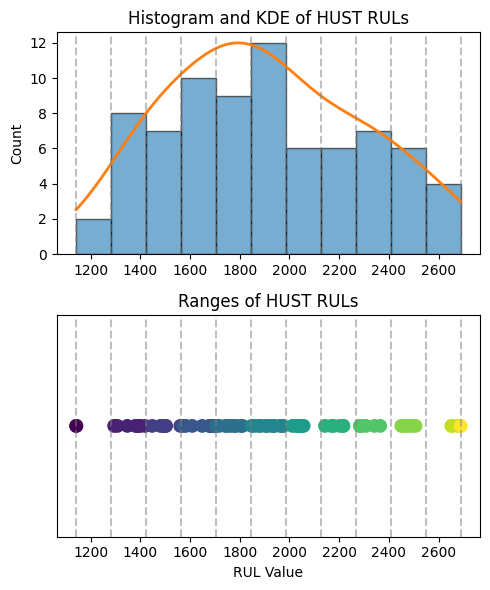

In [31]:
k = 77

# KDE estimator
kde = gaussian_kde(values)

# Smooth x-grid for KDE
x_grid = np.linspace(min(values), max(values), 500)
kde_vals = kde(x_grid)

# Compute histogram counts WITHOUT density=True
hist_counts, hist_bins = np.histogram(values, bins=bins)

# Scale KDE to match histogram peak
kde_scaled = kde_vals * max(hist_counts) / max(kde_vals)

# --- Plot ---
fig, axes = plt.subplots(2, 1, figsize=(5, 6), sharex=False)

# 1️⃣ Histogram (counts) + scaled KDE
axes[0].hist(values, bins=bins, edgecolor="black", alpha=0.6)   # counts mode

# Plot scaled KDE
axes[0].plot(x_grid, kde_scaled, linewidth=2)

axes[0].set_title("Histogram and KDE of HUST RULs")
axes[0].set_ylabel("Count")

# Bin edges
for b in bins:
    axes[0].axvline(b, color='gray', linestyle='--', alpha=0.5)

# 2️⃣ Scatter plot with bin edges
axes[1].scatter(values, np.zeros_like(values), c=digitized, s=80)
for b in bins:
    axes[1].axvline(b, color='gray', linestyle='--', alpha=0.5)

axes[1].set_yticks([])
axes[1].set_title("Ranges of HUST RULs")
axes[1].set_xlabel("RUL Value")

plt.tight_layout()
plt.show()

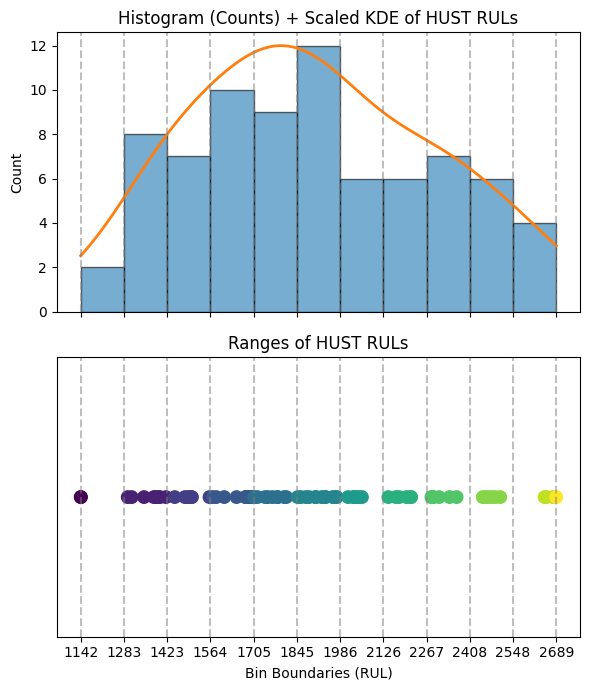

In [32]:
# Compute histogram counts without density=True
hist_counts, hist_bins = np.histogram(values, bins=bins)

# Scale KDE to histogram height
kde_scaled = kde_vals * max(hist_counts) / max(kde_vals)

# --- Plot ---
fig, axes = plt.subplots(2, 1, figsize=(6, 7), sharex=True)

# ------------------------- #
# 1️⃣ Histogram + KDE
# ------------------------- #
axes[0].hist(values, bins=bins, edgecolor="black", alpha=0.6)

axes[0].plot(x_grid, kde_scaled, linewidth=2)
axes[0].set_title("Histogram (Counts) + Scaled KDE of HUST RULs")
axes[0].set_ylabel("Count")

# Vertical bin boundaries
for b in bins:
    axes[0].axvline(b, color='gray', linestyle='--', alpha=0.5)

# Set x-axis tick marks at bin boundaries
axes[0].set_xticks(bins)
axes[0].set_xticklabels([f"{b:.1f}" for b in bins])

# ------------------------- #
# 2️⃣ Scatter + bin edges
# ------------------------- #
axes[1].scatter(values, np.zeros_like(values), c=digitized, s=80)

for b in bins:
    axes[1].axvline(b, color='gray', linestyle='--', alpha=0.5)

axes[1].set_yticks([])
axes[1].set_title("Ranges of HUST RULs")
axes[1].set_xlabel("Bin Boundaries (RUL)")

# Same tick labels for x-axis
axes[1].set_xticks(bins)
axes[1].set_xticklabels([f"{b:.0f}" for b in bins])

plt.tight_layout()
plt.show()

In [33]:
print(gompertz_df_full.tail(50))

      Cycle number         k         a         b  rul  max_SoC_above_80  \
2639          2640  0.984315 -3.373157 -8.372804   50         30.101008   
2640          2641  0.984314 -3.373194 -8.372946   49         30.101008   
2641          2642  0.984313 -3.373206 -8.372994   48         30.101008   
2642          2643  0.984314 -3.373193 -8.372941   47         30.101008   
2643          2644  0.984315 -3.373155 -8.372796   46         30.101008   
2644          2645  0.984315 -3.373156 -8.372800   45         30.101008   
2645          2646  0.984317 -3.373129 -8.372696   44         30.101008   
2646          2647  0.984323 -3.372986 -8.372141   43         30.101008   
2647          2648  0.984323 -3.372978 -8.372111   42         30.101008   
2648          2649  0.984324 -3.372944 -8.371980   41         30.101008   
2649          2650  0.984324 -3.372949 -8.372000   40         30.101008   
2650          2651  0.984325 -3.372929 -8.371922   39         30.101008   
2651          2652  0.984

Obtain 33 SoH values 1% interval from 113%, for each get the RUL, k, a, b and cycle number 

In [34]:
def plot_battery_fade(x, y, choice):
    """
    Plots battery capacity fade with intersection points labeled next to the markers.
    
    Args:
        x (array-like): Cycle numbers.
        y (array-like): State of Health (SoH) or Capacity values.
        choice (str/int): Identifier for the battery (e.g., cell ID).
    """
    fig, ax = plt.subplots(figsize=(8, 5))
    ax.plot(x, y, label=f"Bat {choice}", color='b') # Uncomment if you want the main line
    
    ax.set_xlabel('Cycle number')
    ax.set_ylabel('SoH')
    ax.set_title(f'HUST Battery {choice} Capacity Fade')
    
    # --- FIX START: Force plot to start at 0,0 ---
    ax.set_xlim(left=0)   # X-axis starts at 0
    ax.set_ylim(bottom=70) # Y-axis starts at 0
    # ---------------------------------------------
    
    x_hits = []
    y_hits = []
    
    # Horizontal reference lines
    for val in range(72, 93+3+1, 3):
        # ax.axhline(y=val, color='r', linestyle='--', linewidth=0.8)
        
        # Find intersection
        # Check if 'y' exists before this; assuming it's defined elsewhere
        idx = np.where(np.diff(np.sign(y - val)))[0]
        if len(idx) > 0:
            i = idx[0]
            x_int = x[i] + (x[i+1] - x[i]) * (val - y[i]) / (y[i+1] - y[i])
            
            # Save intersection
            x_hits.append(x_int)
            y_hits.append(val)
            
    #         # Draw vertical line and label
    #         # ax.axvline(x=x_int, color='k', linestyle='-', linewidth=0.8)
    #         ax.text(x_int, 107, f"{int(x_int)}", rotation=45,
    #                 va='bottom', ha='center', fontsize=7, color='k')
    
    # # --- Plot intersection points ---
    # ax.scatter(x_hits, y_hits, color='k', s=20, zorder=5, label='Intersections')
    # --- PLOT TEXT NEARBY ---
            # Instead of 107, we use 'val + 0.5' to place it just above the point
            ax.text(x_int, val + 0.4, f"{int(x_int)}", 
                    rotation=0,         # No rotation needed if close to point
                    va='center',        # Anchor bottom of text to the point
                    ha='left',        # Center horizontally
                    fontsize=8, 
                    color='black',
                    fontweight='bold')
    
    # --- Plot all intersection points at once ---
    if x_hits:
        ax.scatter(x_hits, y_hits, color='k', s=20, zorder=5, label='Intersections')
    
    plt.legend()
    plt.tight_layout()
    plt.show()

In [35]:
# Define the function
def gompertz_func(x,k,a,b):
    return k*np.exp(-np.exp(a-(b*x)))

def inverse_gompertz_func(y,k,a,b):
    return (a - np.log(np.log(k/y)))/b

def plot_inverse_mapping_strategy(df,k,a,b,SoH_threshold=None,choice=None,cycle_nums=[]):
    x = np.array([j/10000 for j in range(1,10000,1)]) #df['Cycle number'].to_numpy()/10000
    # Compute y values
    y = gompertz_func(x,k,a,b)
    print("72% SoH RUL estimation: ",int(inverse_gompertz_func(y=0.72173913,k=k,a=a,b=b)*10000))
    # Plot the function
    plt.figure(figsize=(8, 5))
    
    # plt.plot(df['Cycle number']/len(df['Cycle number']), ((df['max_SOC']-80)/(df['max_SOC'].max()-80)), label="Bat 2-2")
    # plt.plot(x[:len(df['SoH'])], ((df['SoH']-80)/(115-80)), label=choice,color='b')
    plt.plot(x[:len(df['SoH'])], df['SoH'], label=choice,color='b')
    plt.plot(x, y, label=r'Gompertz function', color='r')
    plt.axhline(0, color='black', linewidth=0.5)
    plt.axhline(1, color='black', linewidth=0.5)
    plt.axvline(0, color='black', linewidth=0.5)
    plt.xlabel("normalized Cycle Number (x)")
    #plt.xlim(0, 1)
    plt.ylabel("SoH")
    plt.title(f"Plot of gompertz function k = {round(k,2)}, a = {round(a,2)} and b = {round(b,2)}")
    plt.legend()
    plt.grid(not True)
    
    # Show the plot
    plt.show()

7-8
SoH Threshold :  93%
1.0673852909226793 -2.22717858511325 -4.865657298632758
72% SoH RUL estimation:  2648


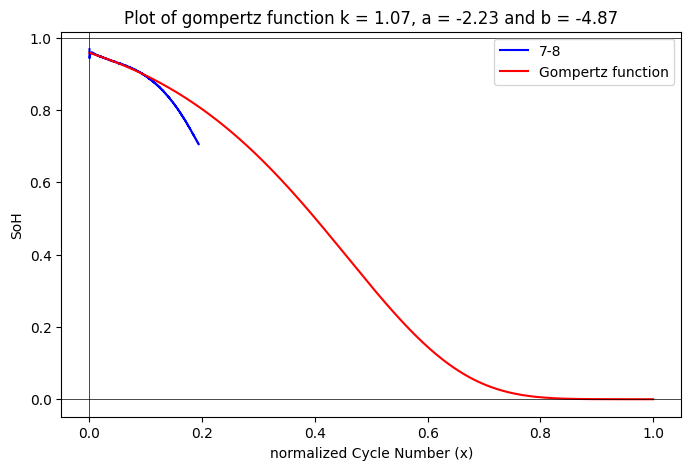

7-8
SoH Threshold :  90%
1.0583285209359563 -2.305330146284086 -5.036442417368492
72% SoH RUL estimation:  2670


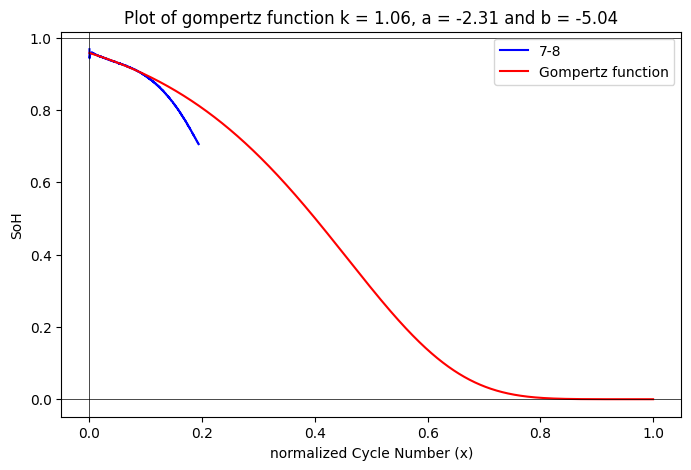

7-8
SoH Threshold :  87%
0.9939607648642036 -3.249649854215684 -10.14127412563434
72% SoH RUL estimation:  2080


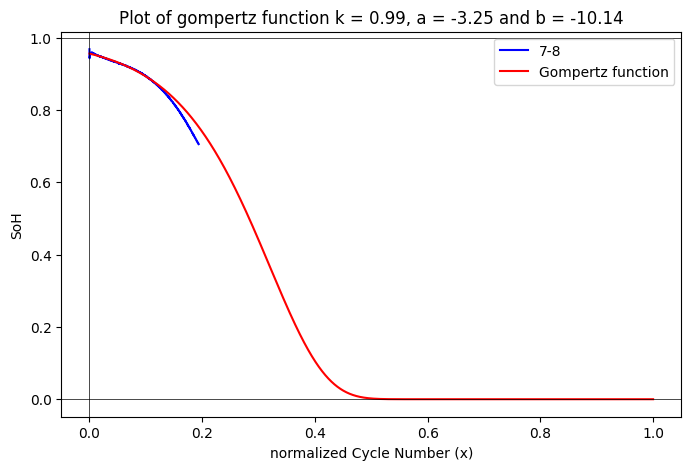

7-8
SoH Threshold :  84%
0.9813528944397588 -3.601209325385062 -12.461701485973858
72% SoH RUL estimation:  1942


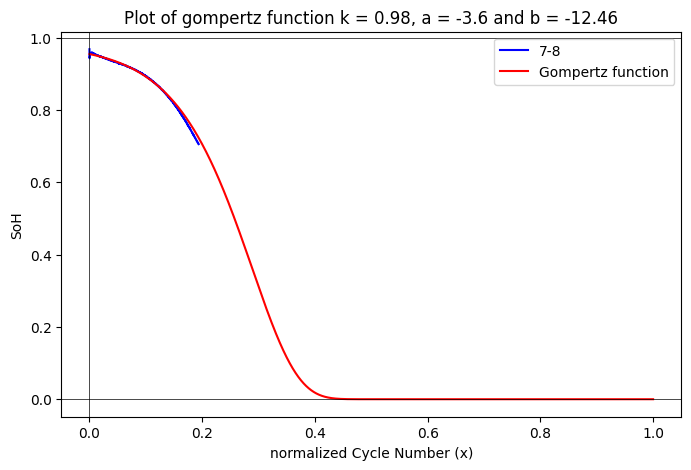

7-8
SoH Threshold :  81%
0.9767298973559104 -3.7579951071961486 -13.49691348293234
72% SoH RUL estimation:  1898


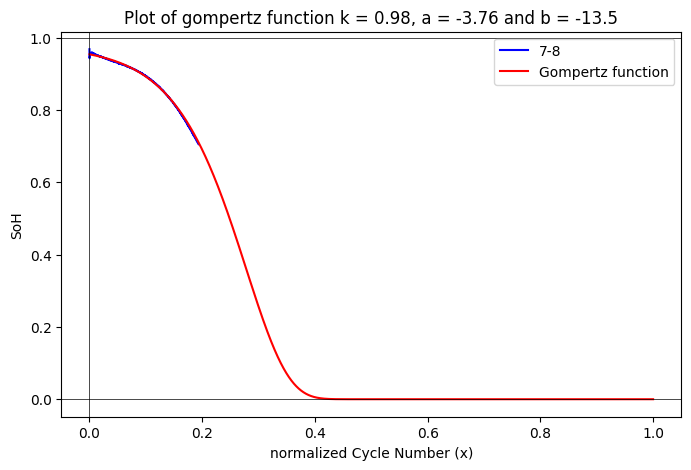

7-8
SoH Threshold :  78%
0.9746440296550062 -3.8331813553306255 -13.975895839416582
72% SoH RUL estimation:  1882


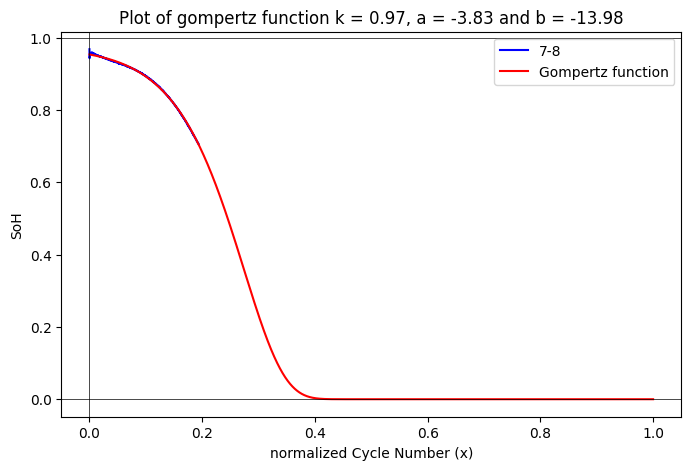

7-8
SoH Threshold :  75%
0.973773731887427 -3.864805585907504 -14.169535417333448
72% SoH RUL estimation:  1876


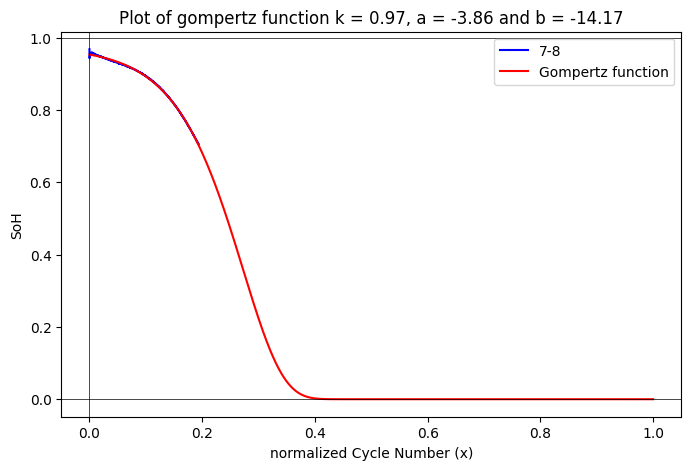

7-8
SoH Threshold :  72%
0.9738225807467826 -3.863167339256208 -14.160566890341167
72% SoH RUL estimation:  1876


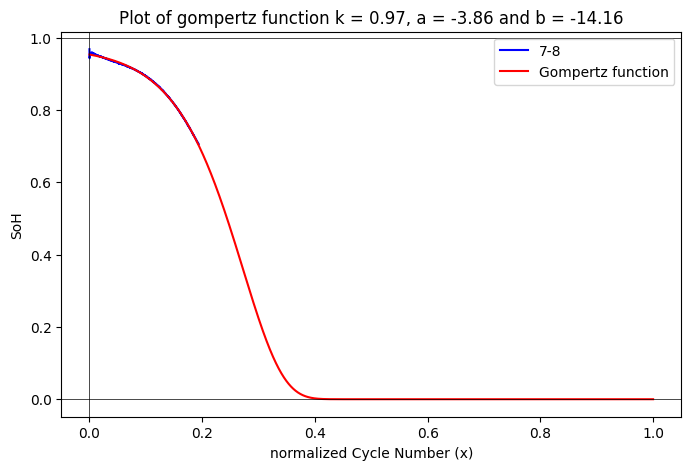

7-8
SoH Threshold :  EoL
0.97426043797264 -3.848156231659844 -14.075337896306312
72% SoH RUL estimation:  1878


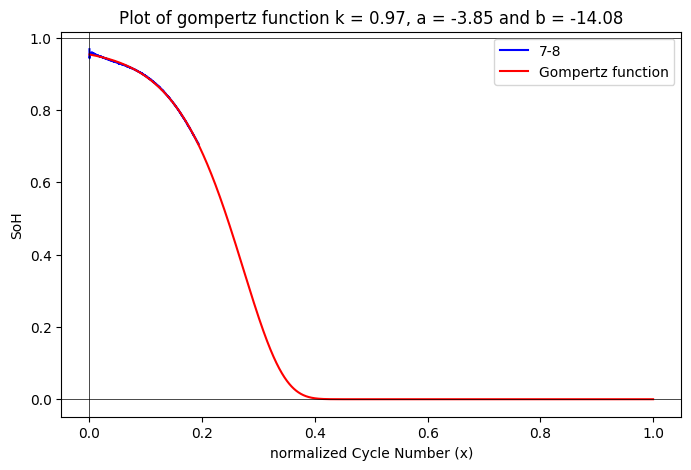

In [36]:
choice = '7-8'
df = pd.read_csv("/kaggle/input/generate-hust-data-gompertz-k-a-b/" + choice + "-hust_gompertz_params.csv")
df['SoH'] = ((df['SoH']))
SoH_Thresholds = ['93%','90%','87%','84%','81%','78%','75%','72%','EoL']
cycle_nums = [511,941,1193,1380,1532,1663,1778,1886,1938]#[63,431,637,758,849,925, 992, 1054,1110,1142] #[548,1031,1423,1756,1972,2153,2315,2473,2628,2688]
for i, cycle_num in enumerate(cycle_nums):
    print(choice)
    print('SoH Threshold : ',SoH_Thresholds[i])
    temp_df = df[df['Cycle number']==cycle_num]
    k,a,b = temp_df['k'].item(),temp_df['a'].item(),temp_df['b'].item()
    print(k,a,b)
    #temp_df.head()
    # gompertz_func(x=df,k=k,a=a,b=b)
    plot_inverse_mapping_strategy(df=df,k = k,a = a,b = b,choice=choice)

In [37]:
df

,Cycle number,k,a,b,rul,max_SoC_above_80,SoH,gompertz-value,gompertz-1st-derivative-value,gompertz-2nd-derivative-value
0,1,1.618852,-0.665422,1.000167,1938,31.345985,0.968226,1.059969,0.448948,-0.258872
1,2,1.615892,-0.643937,1.000243,1937,31.345985,0.943283,1.048306,0.453724,-0.257455
2,3,1.617938,-0.633559,1.000320,1936,31.345985,0.943776,1.044867,0.457028,-0.257269
3,4,1.620256,-0.627828,1.000398,1935,31.345985,0.945707,1.043698,0.459215,-0.257349
4,5,1.622708,-0.623738,1.000477,1934,31.345985,0.947171,1.043357,0.461022,-0.257533
...,...,...,...,...,...,...,...,...,...,...
1933,1934,0.974211,-3.849842,-14.084832,5,31.345985,0.706665,0.953552,-0.287865,-3.967633
1934,1935,0.974221,-3.849476,-14.082773,4,31.345985,0.706173,0.953584,-0.287533,-3.962558
1935,1936,0.974236,-3.848977,-14.079958,3,31.345985,0.706664,0.953617,-0.287224,-3.957588
1936,1937,0.974248,-3.848594,-14.077800,2,31.345985,0.705690,0.953649,-0.286895,-3.952542


--------------------------------------------------------------------------------
4-3
1142


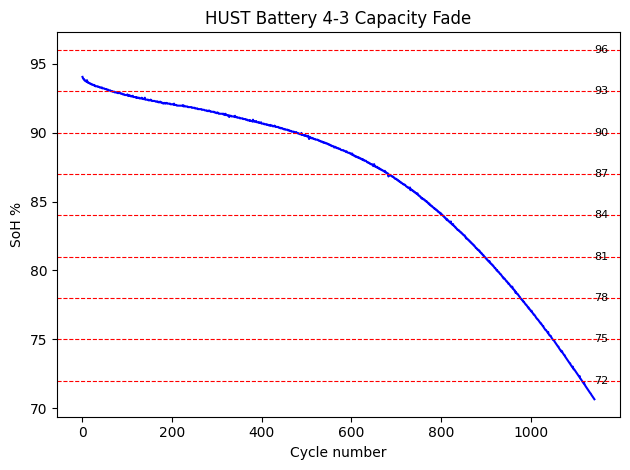

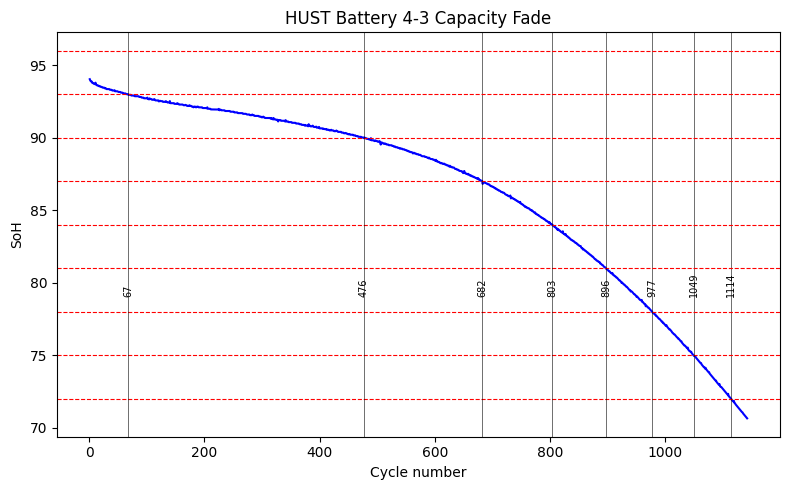

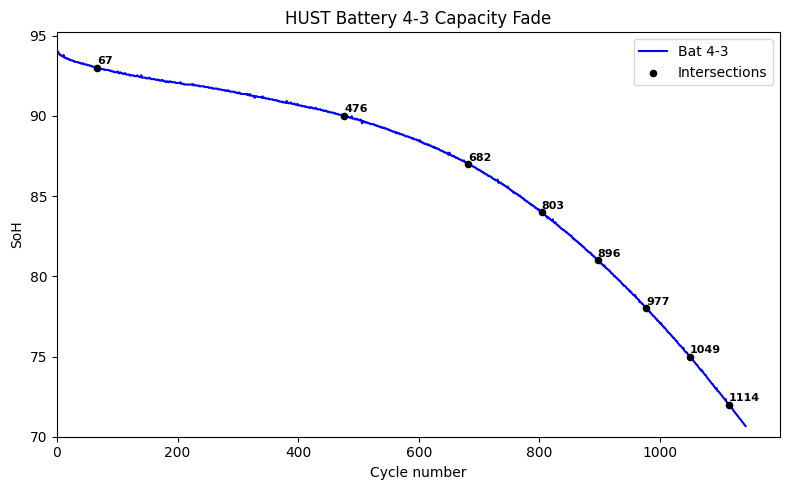

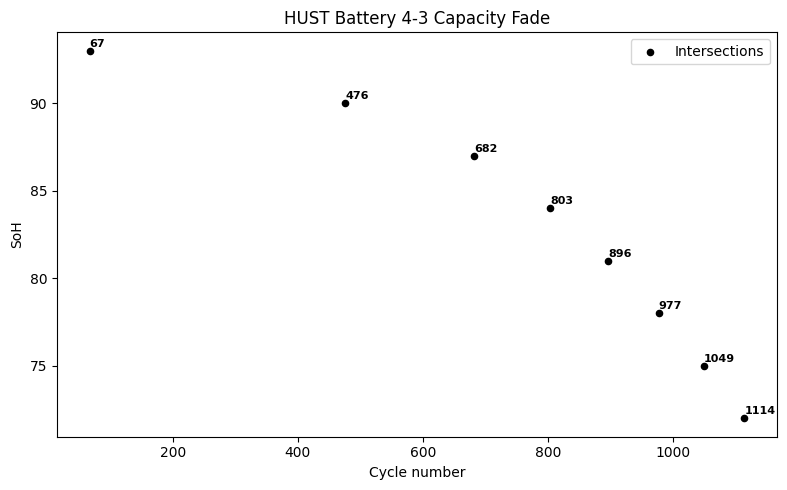

--------------------------------------------------------------------------------
1-6
1143


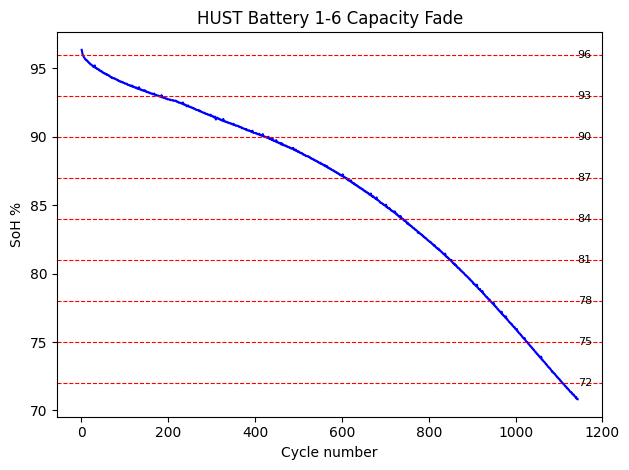

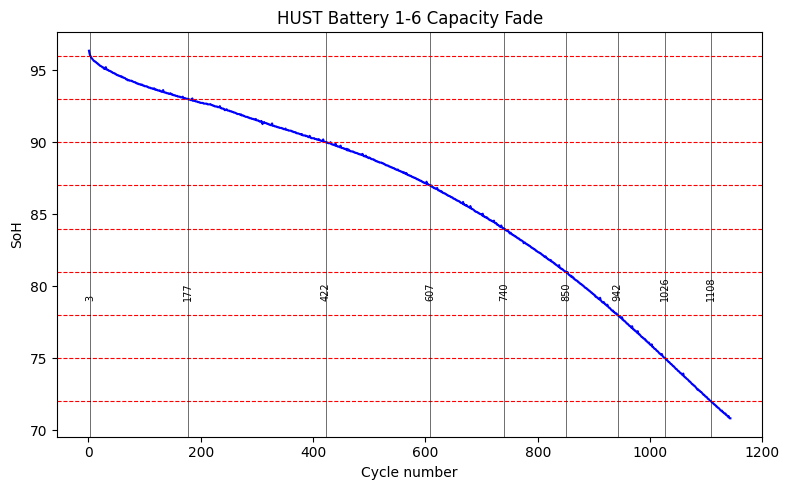

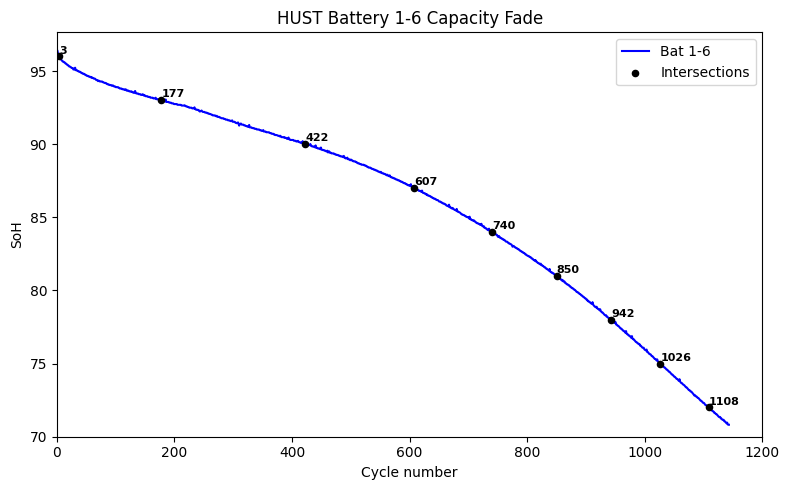

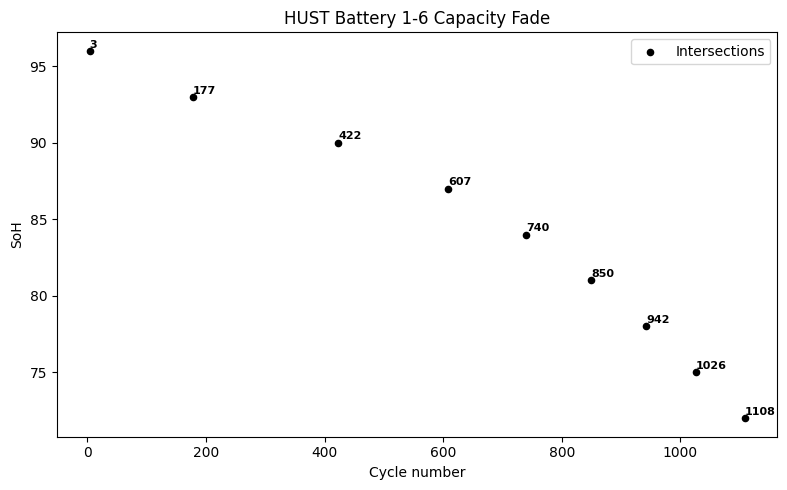

--------------------------------------------------------------------------------
7-3
1295


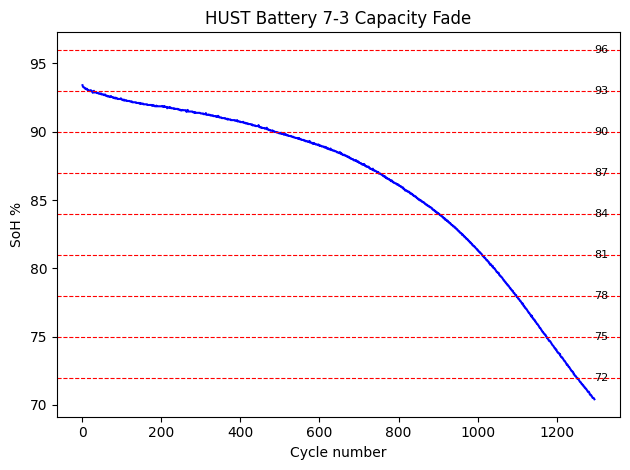

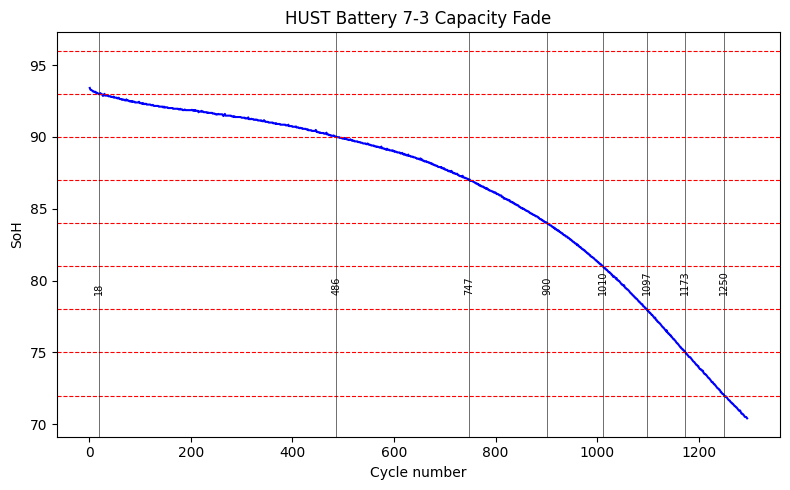

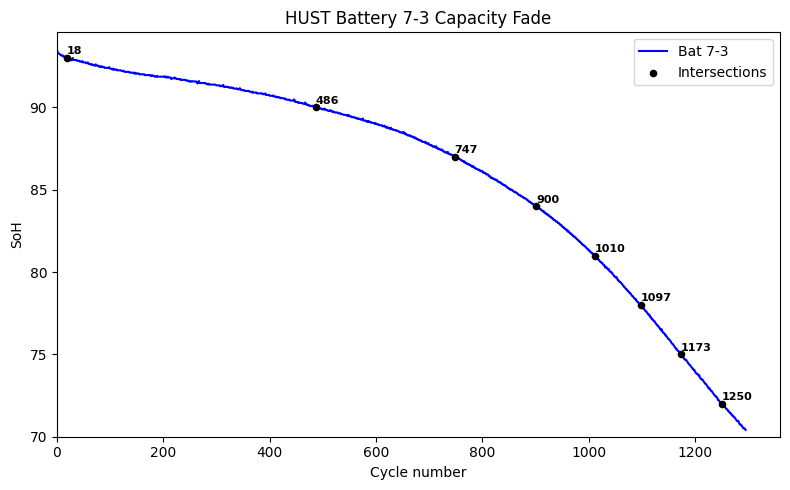

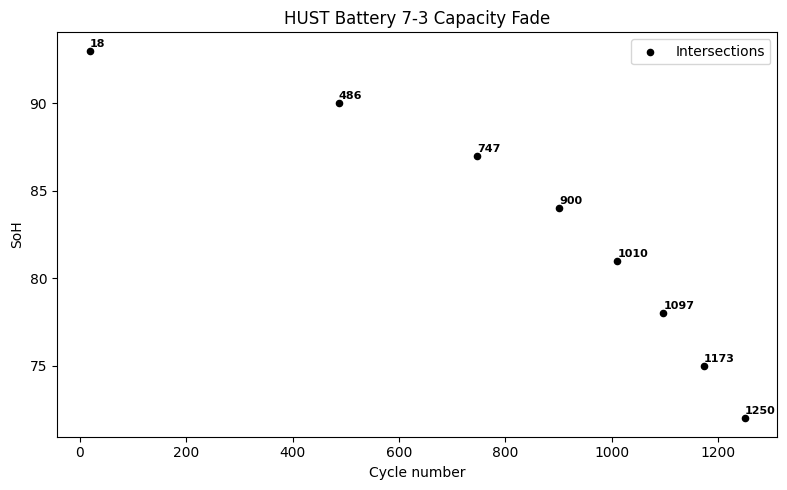

--------------------------------------------------------------------------------
8-1
1308


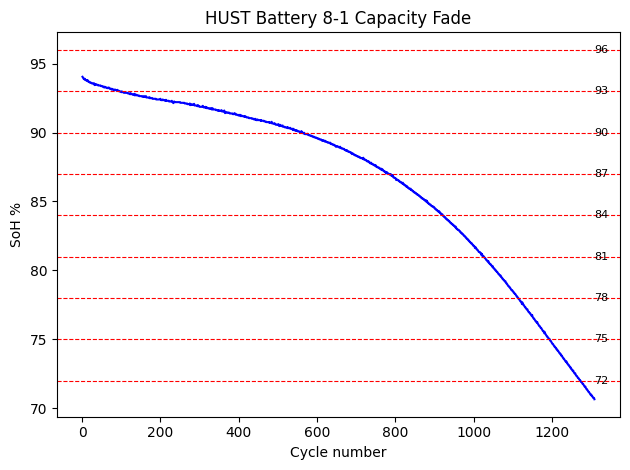

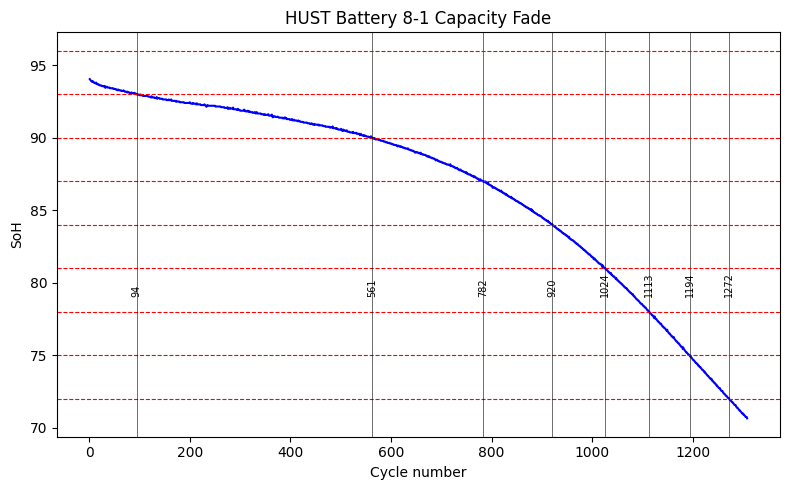

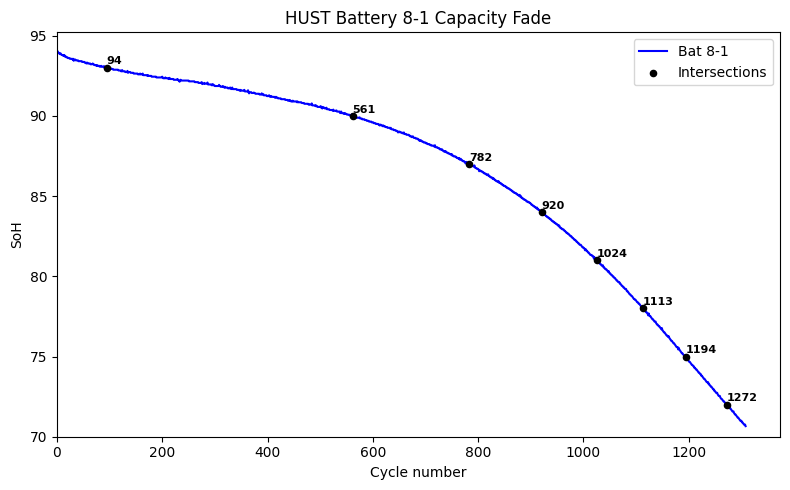

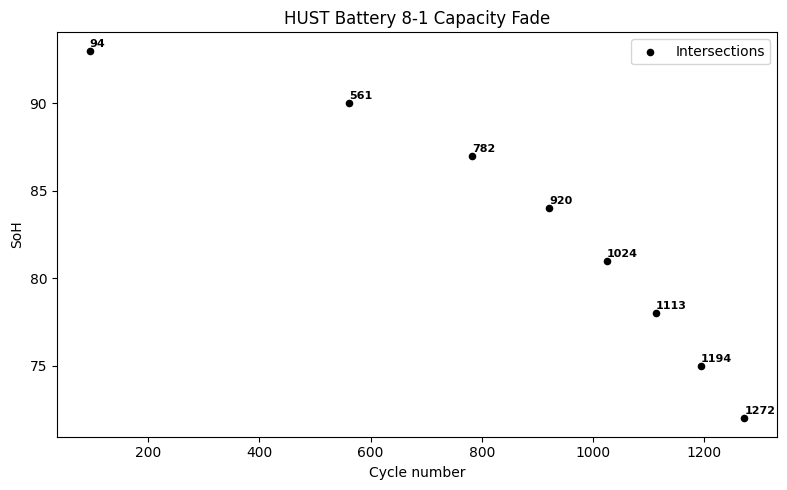

--------------------------------------------------------------------------------
8-5
1348


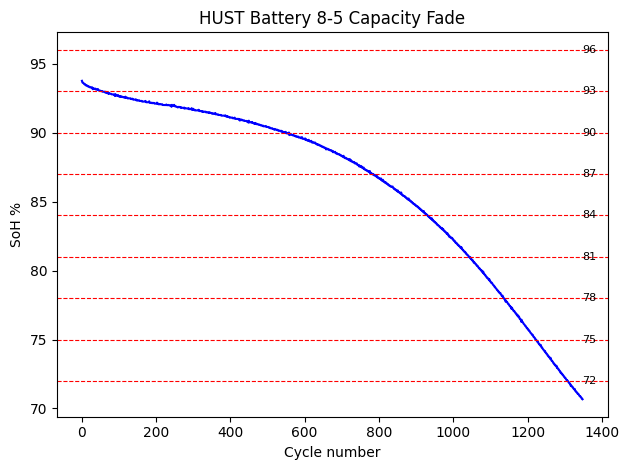

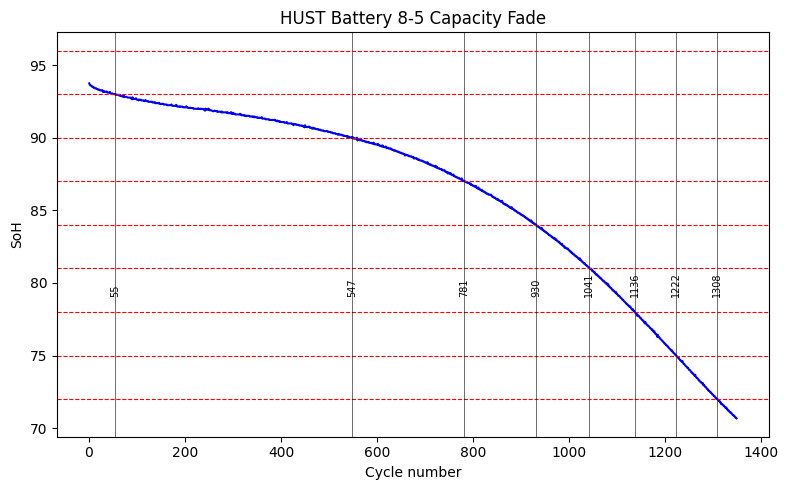

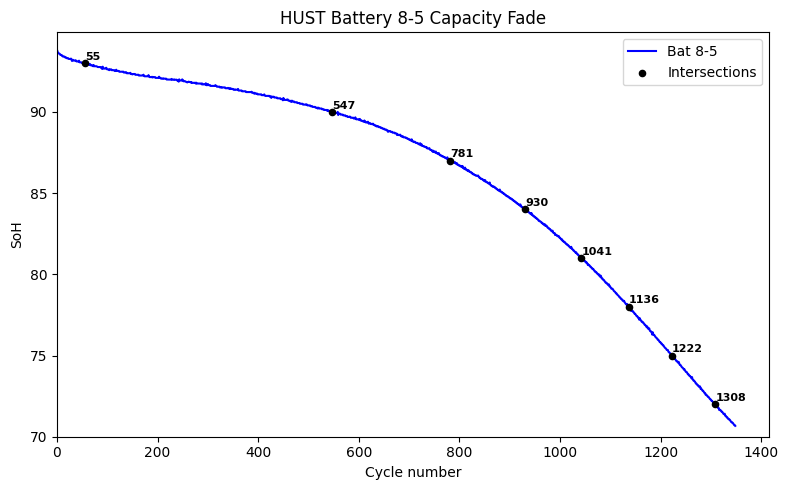

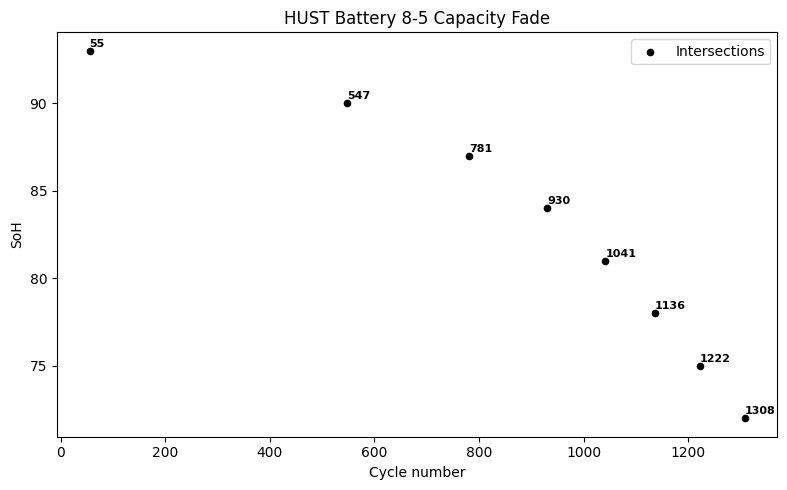

--------------------------------------------------------------------------------
4-6
1380


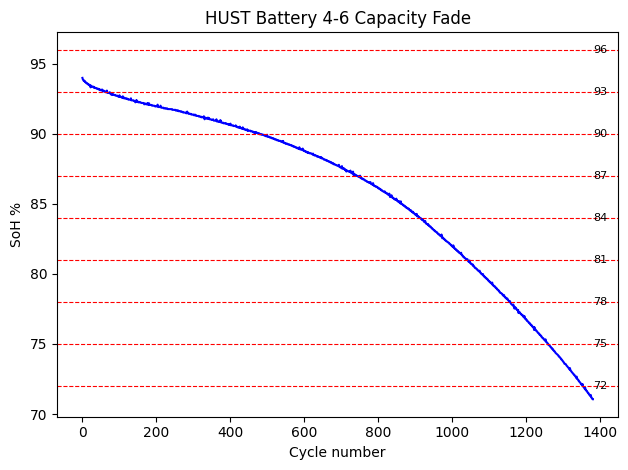

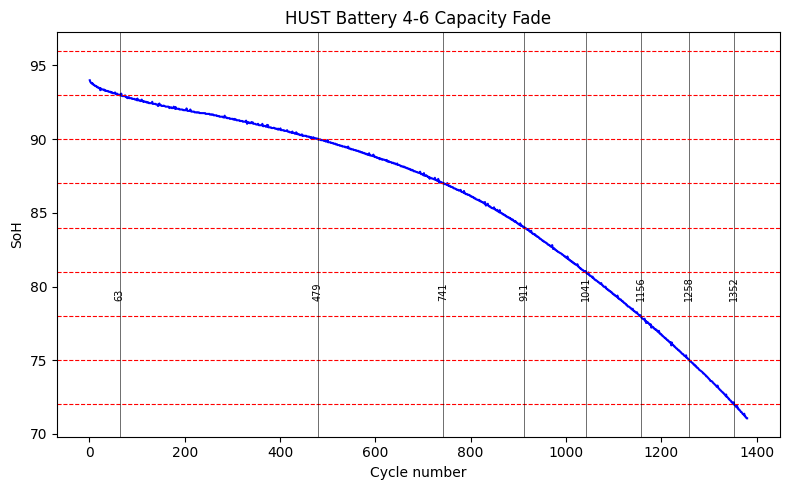

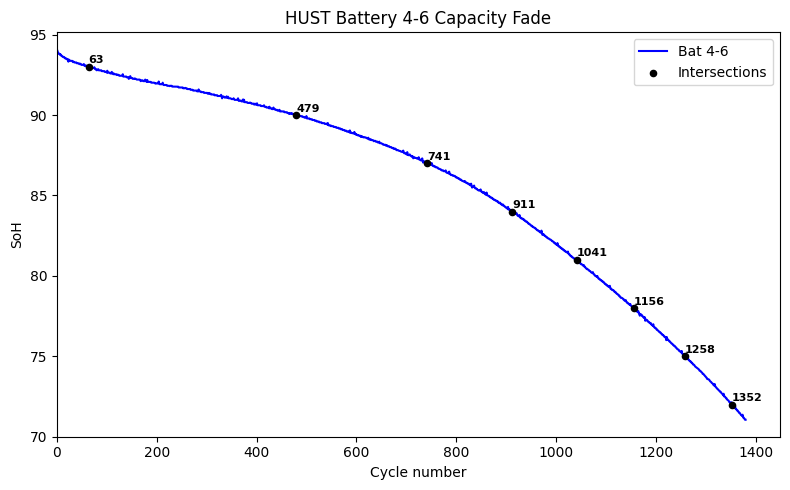

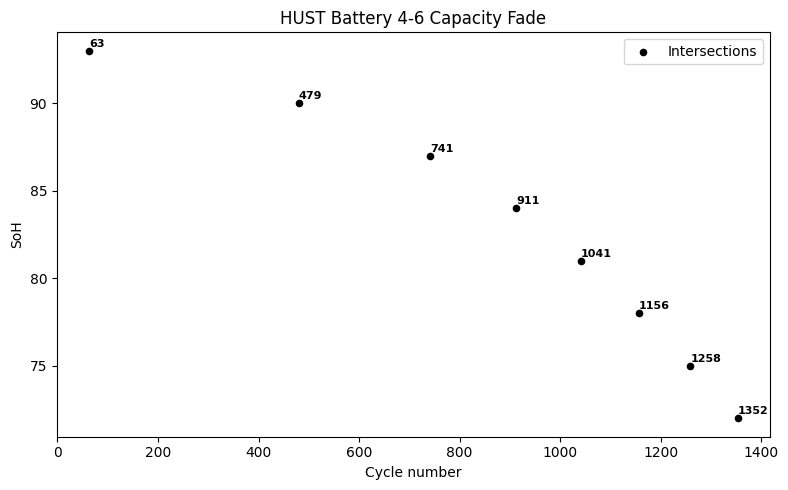

--------------------------------------------------------------------------------
2-5
1386


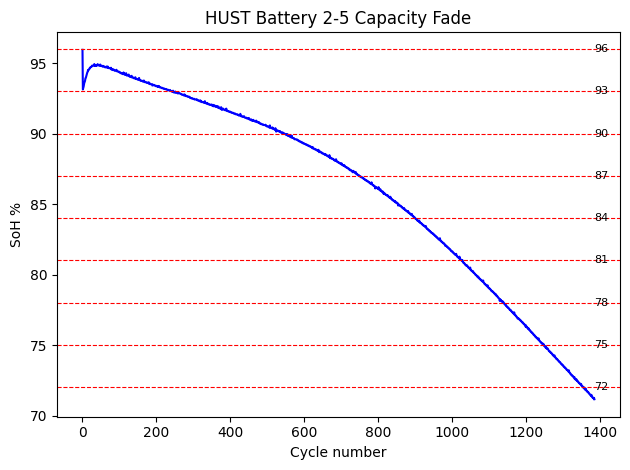

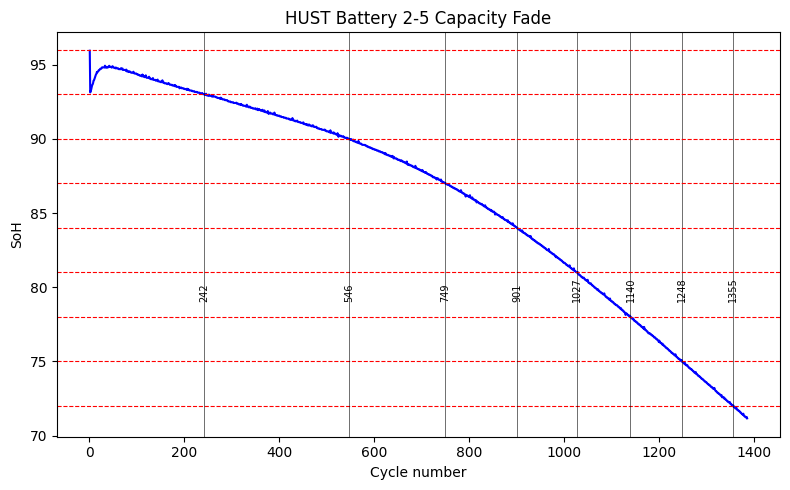

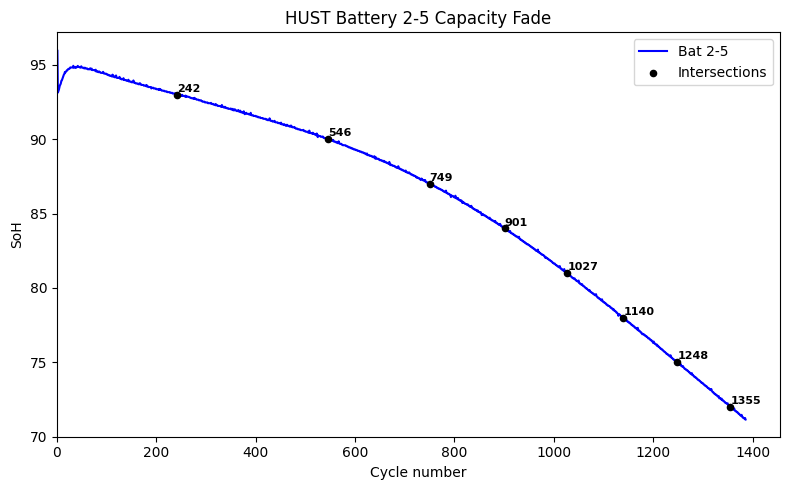

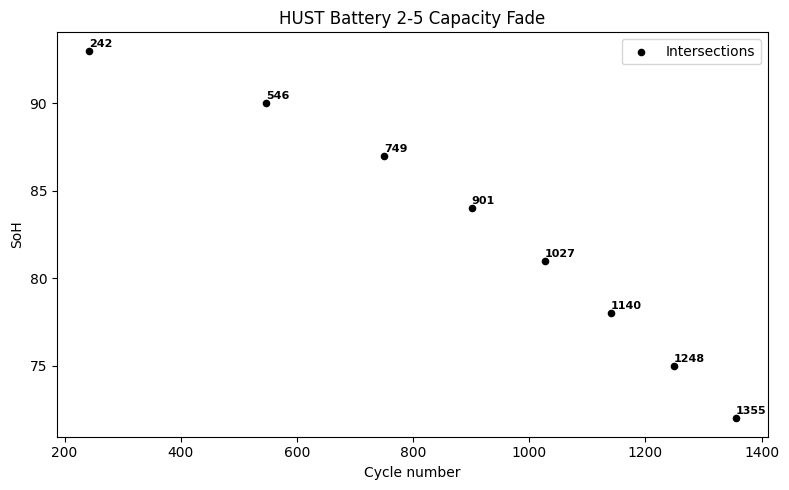

--------------------------------------------------------------------------------
7-4
1393


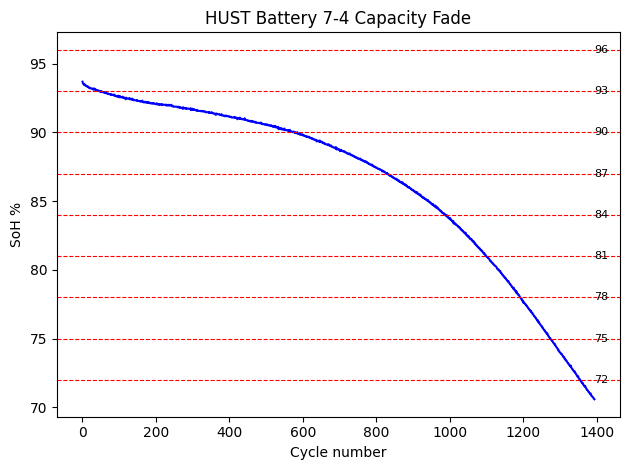

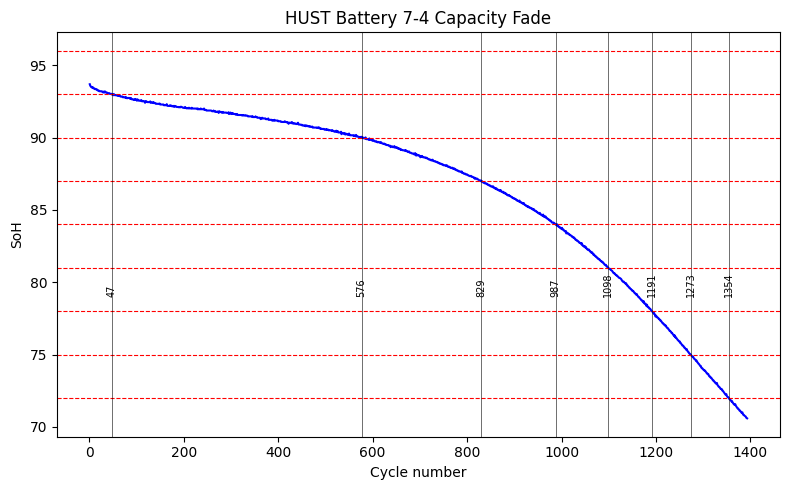

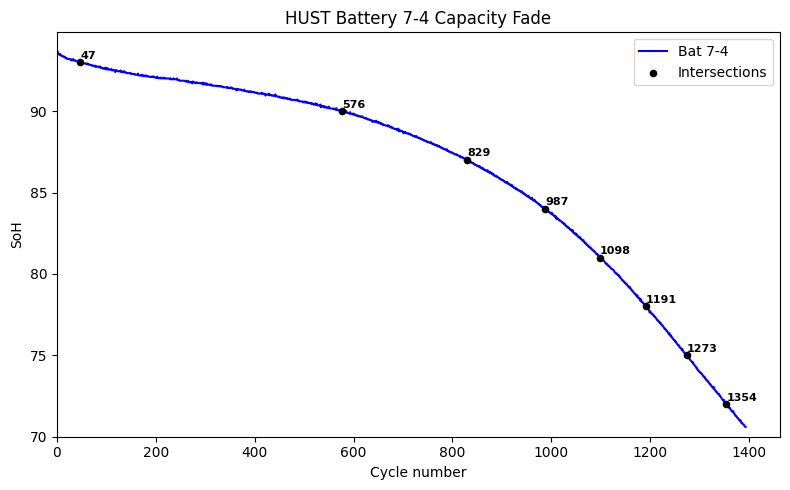

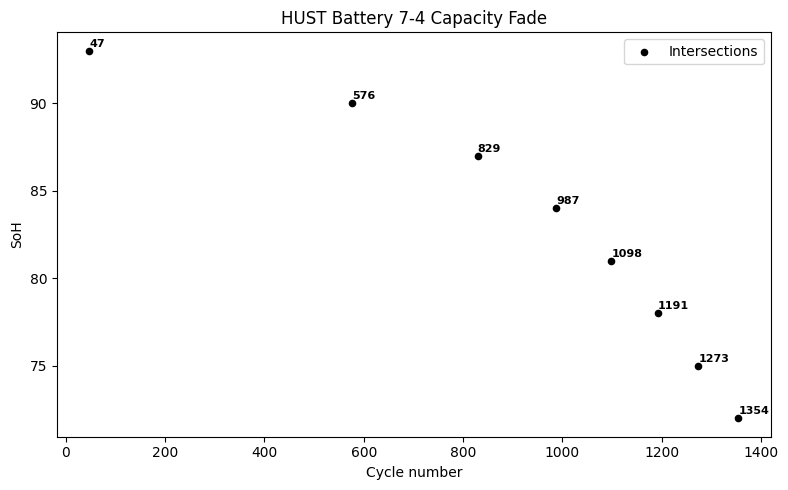

--------------------------------------------------------------------------------
10-8
1400


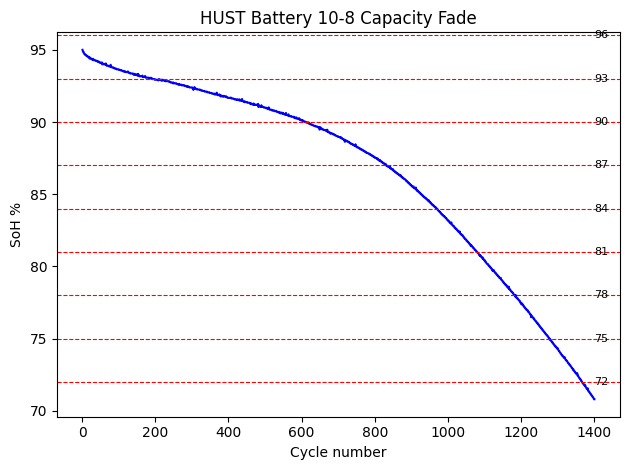

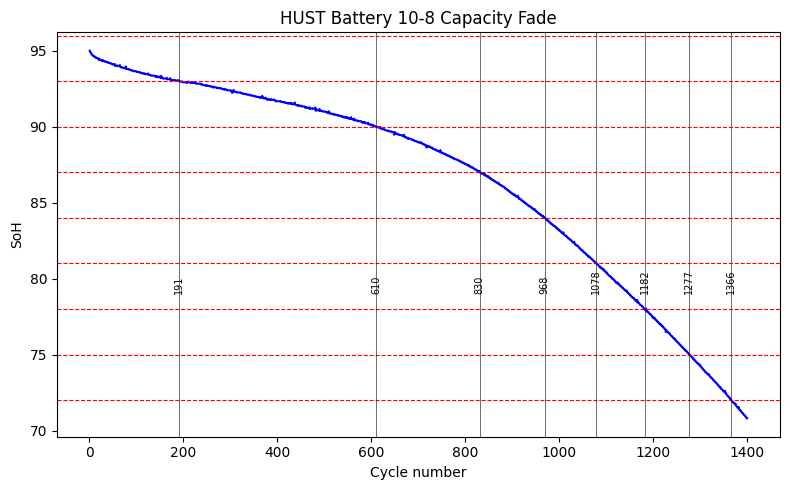

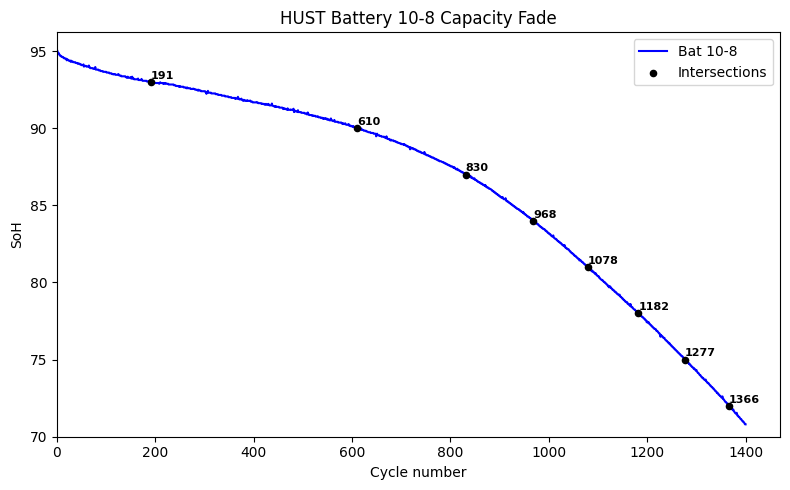

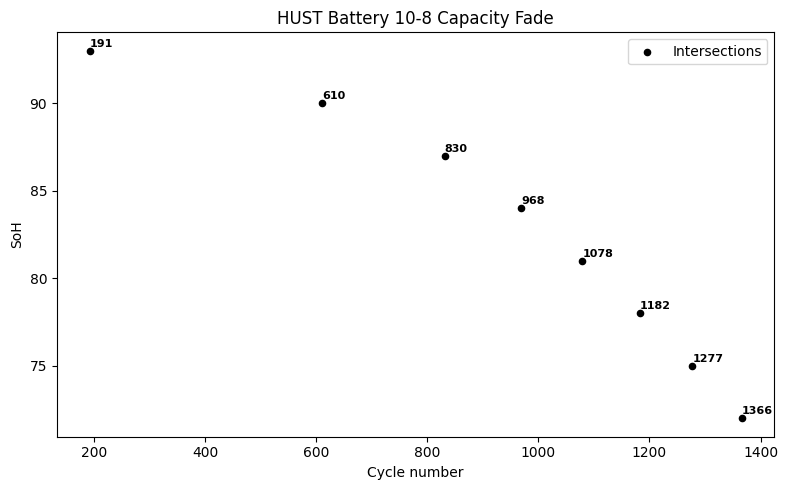

--------------------------------------------------------------------------------
7-6
1419


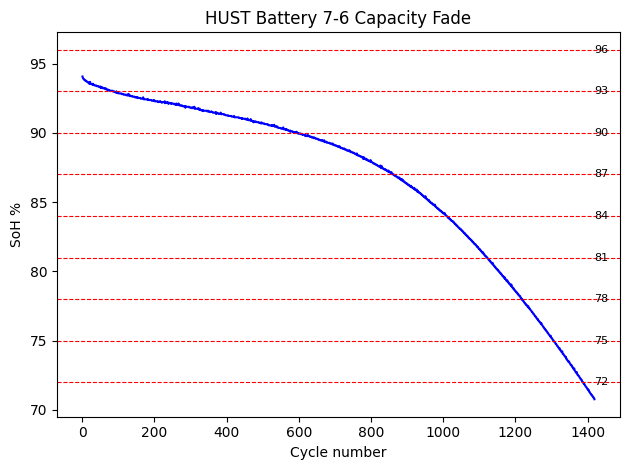

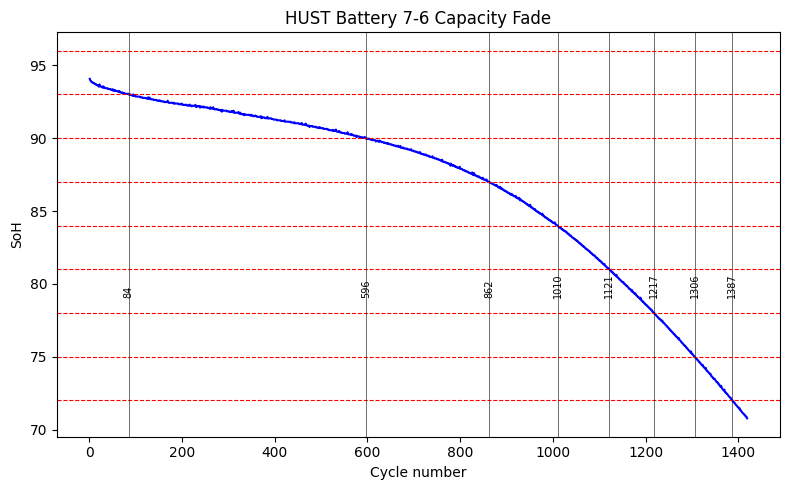

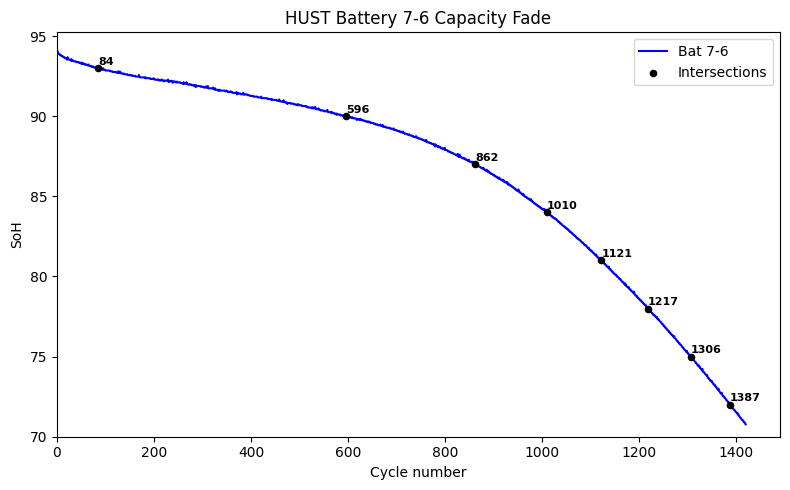

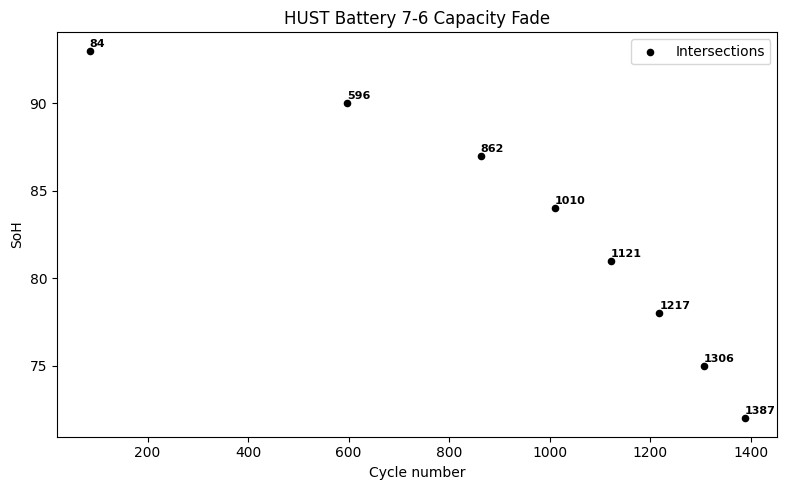

--------------------------------------------------------------------------------
5-7
1448


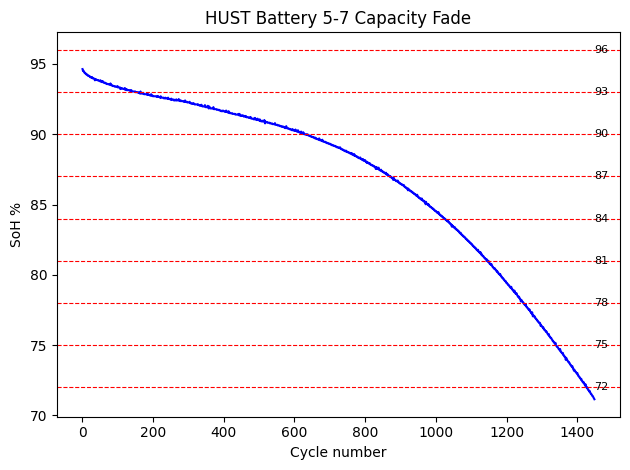

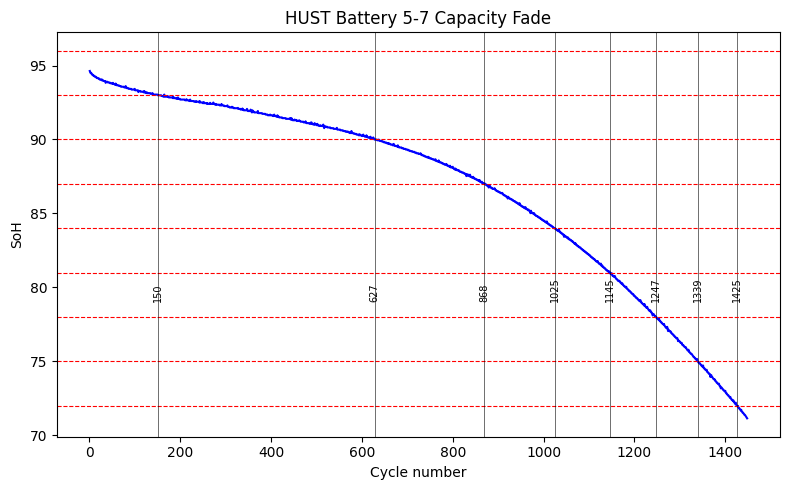

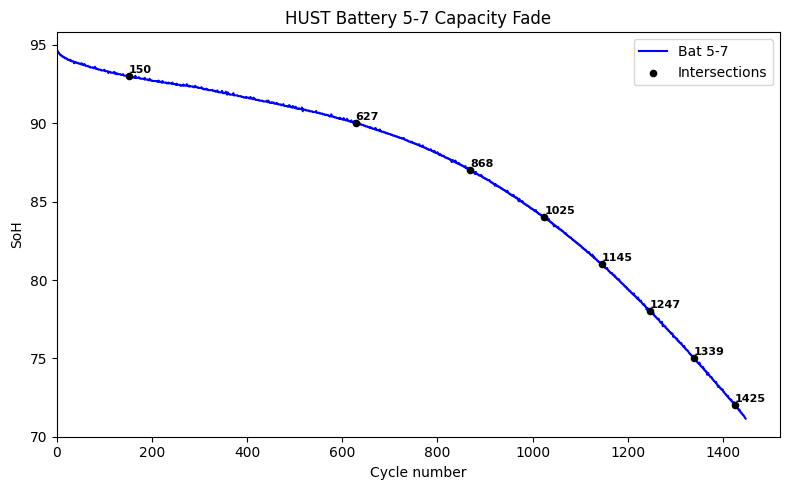

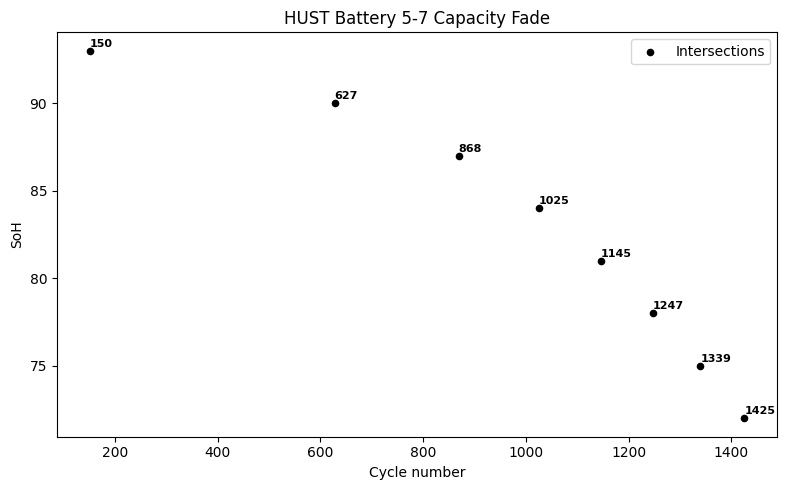

--------------------------------------------------------------------------------
2-8
1481


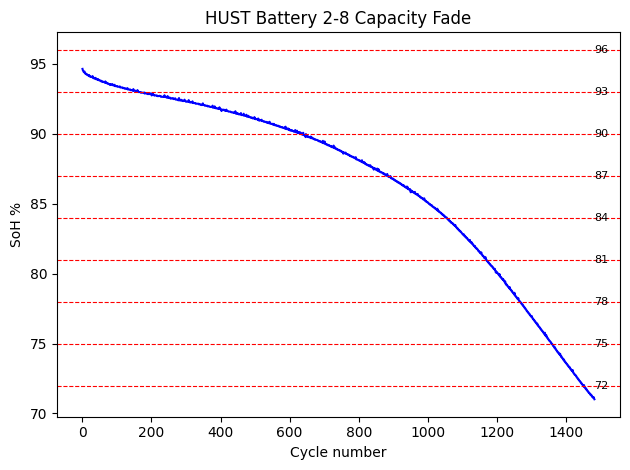

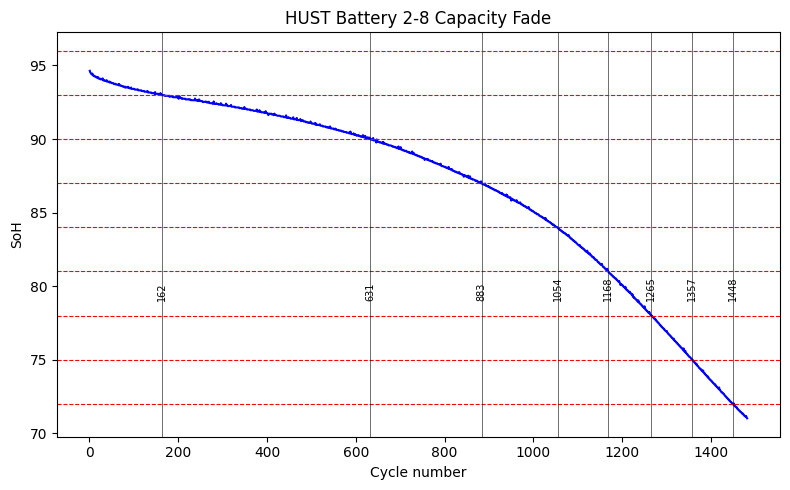

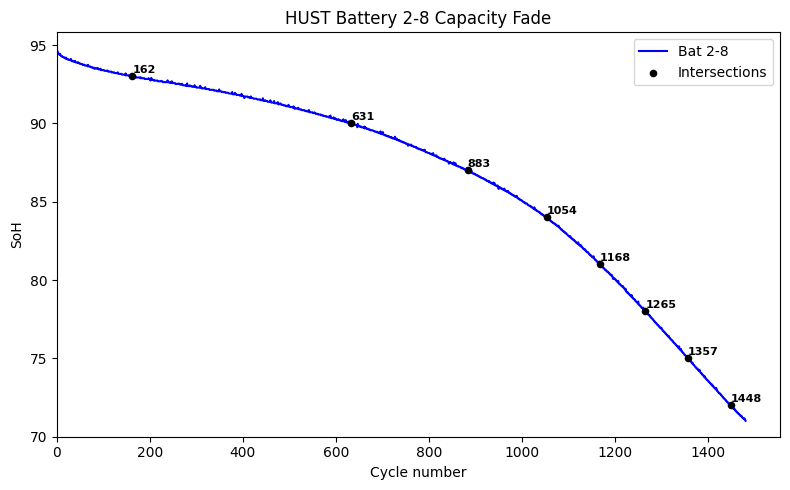

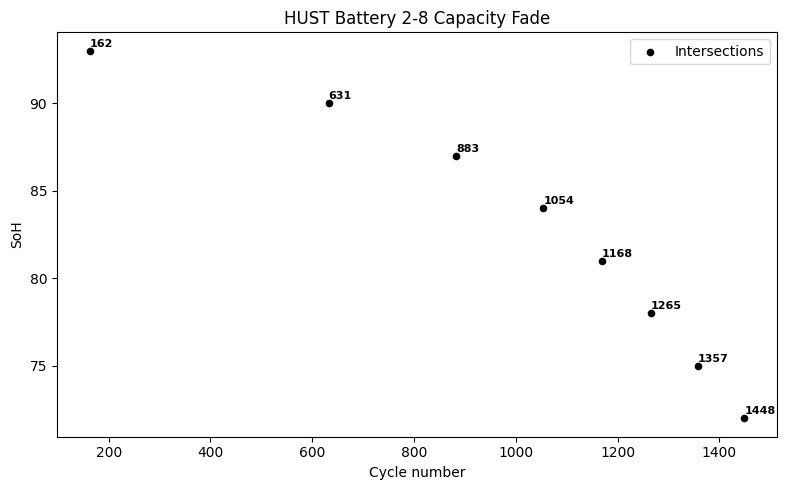

--------------------------------------------------------------------------------
4-4
1491


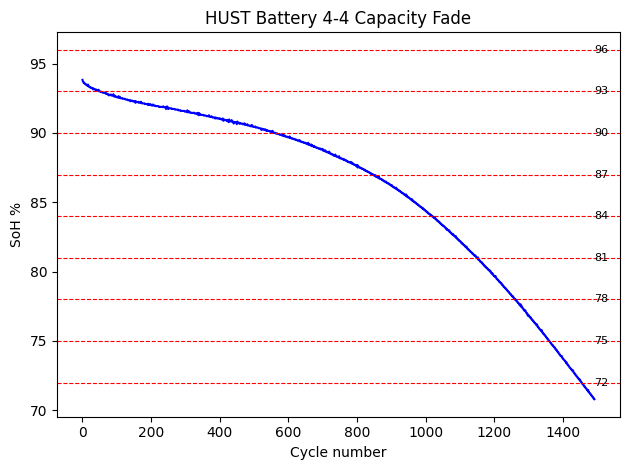

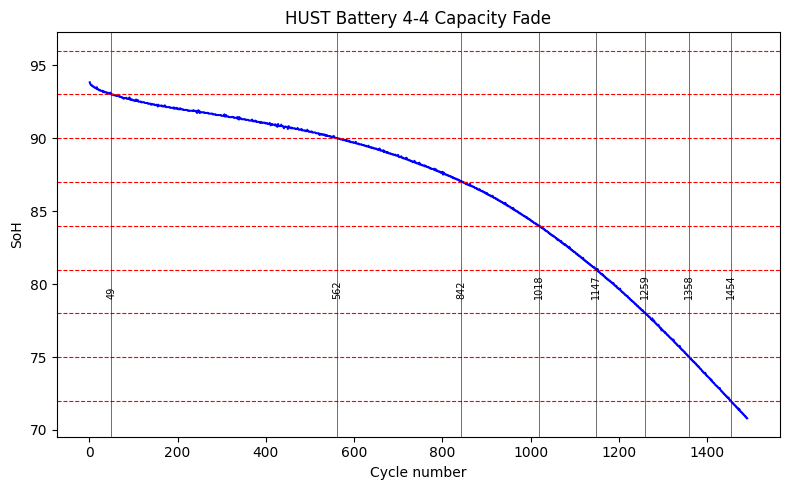

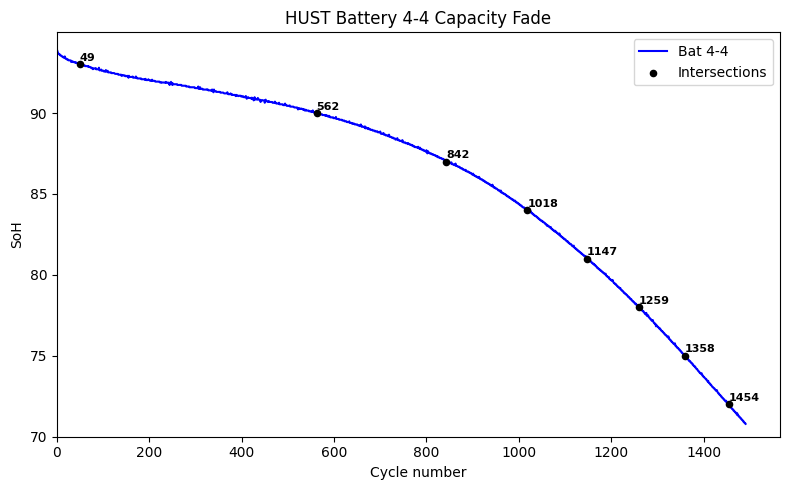

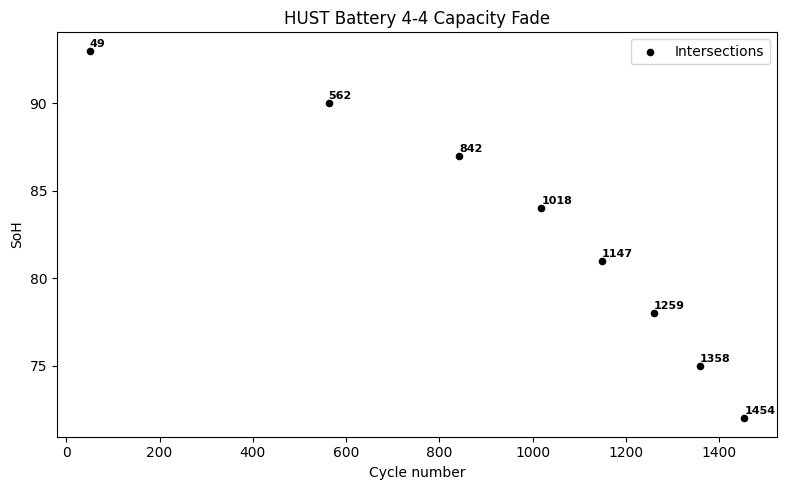

--------------------------------------------------------------------------------
2-4
1499


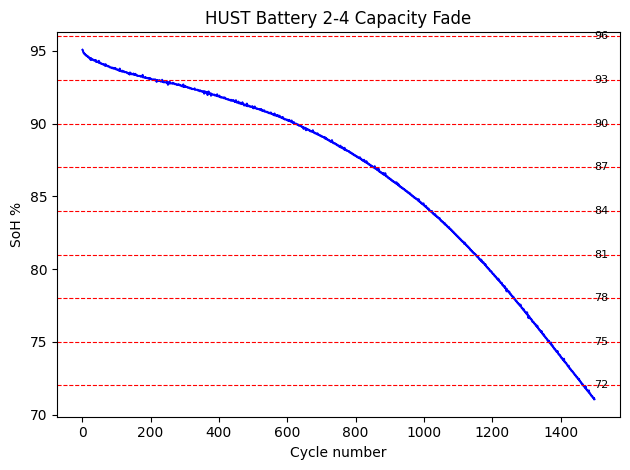

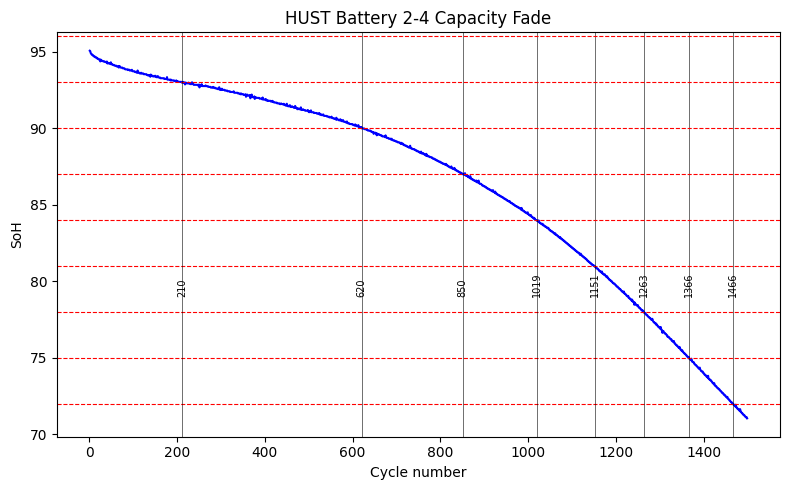

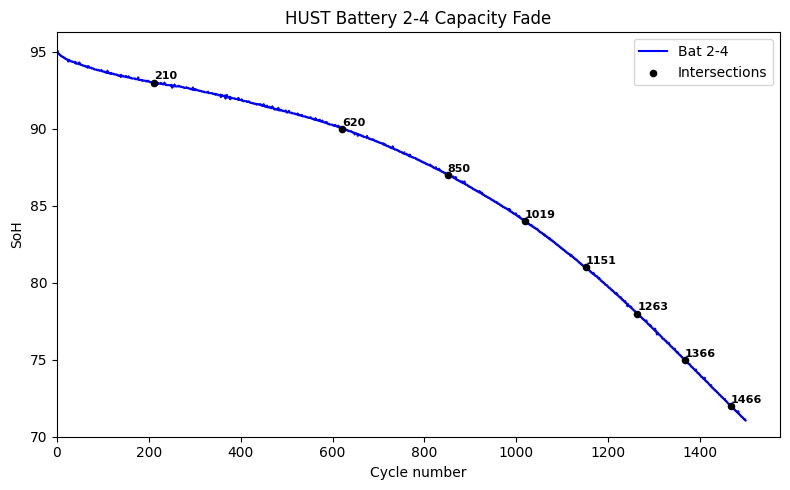

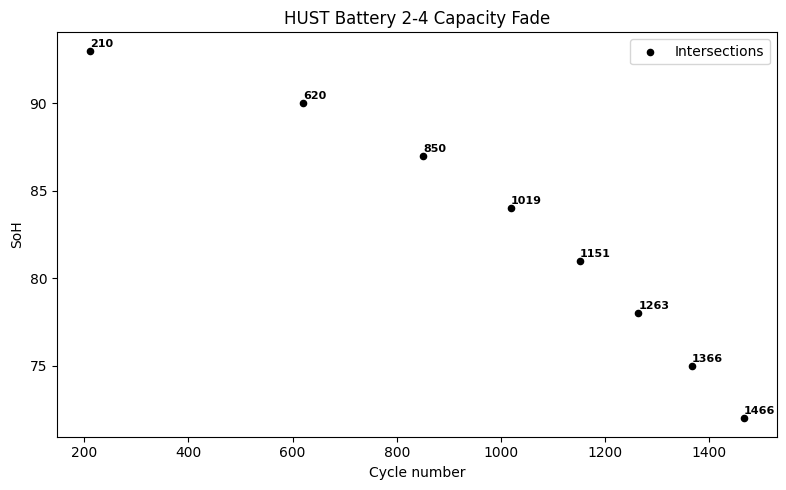

--------------------------------------------------------------------------------
1-4
1500


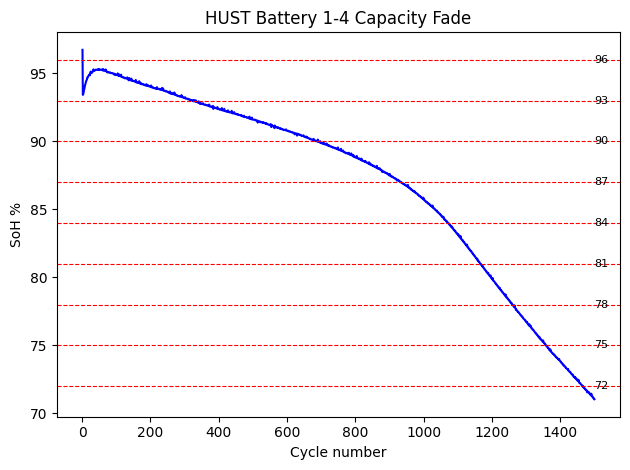

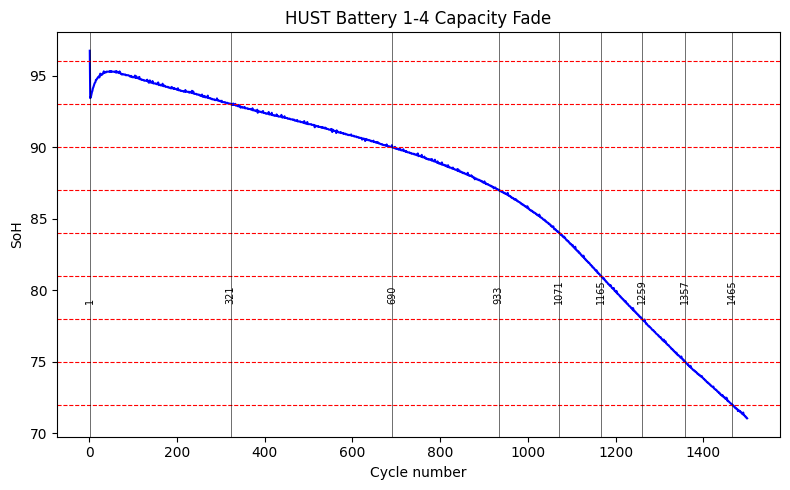

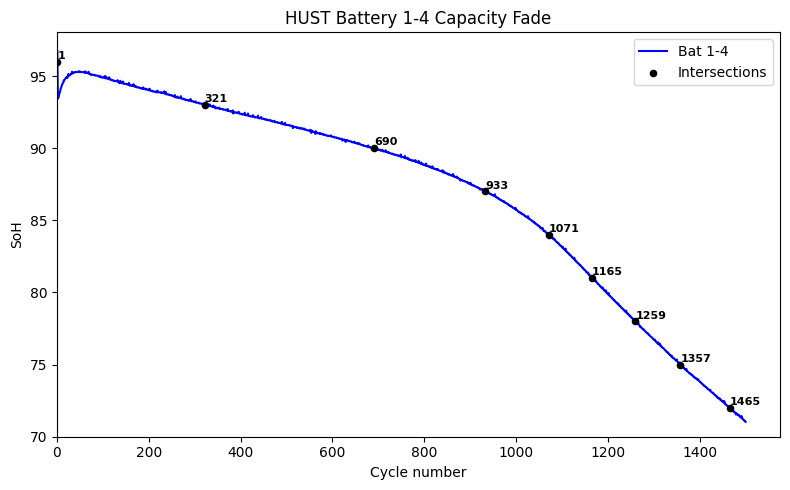

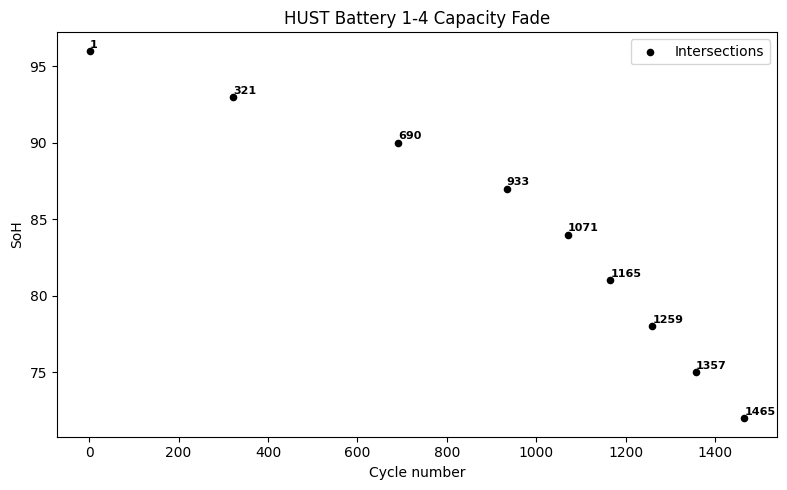

--------------------------------------------------------------------------------
1-1
1504


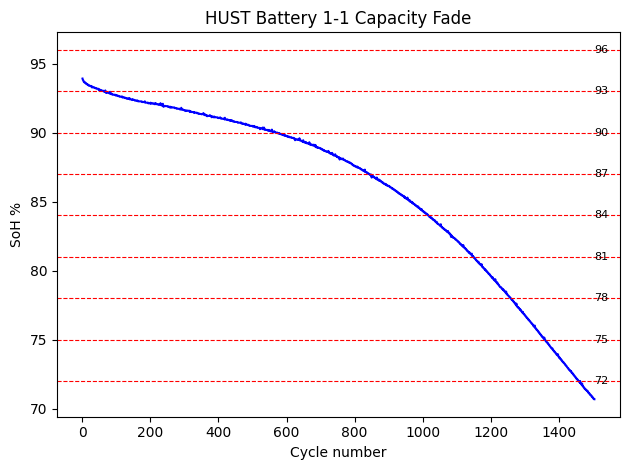

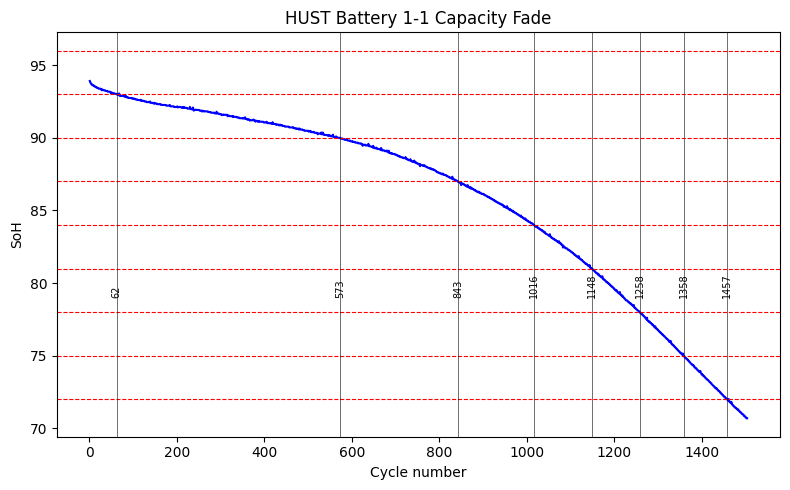

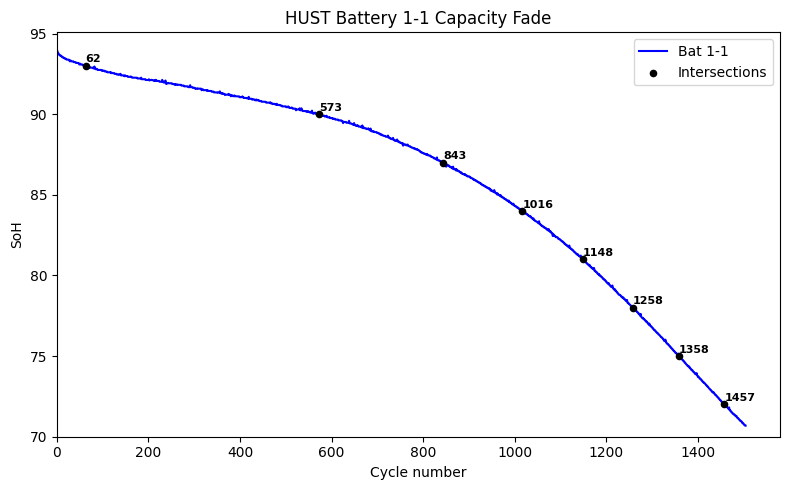

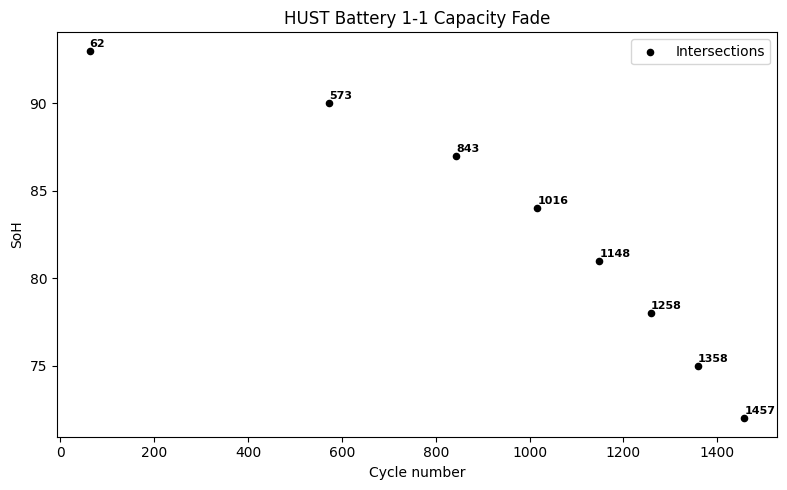

--------------------------------------------------------------------------------
4-5
1561


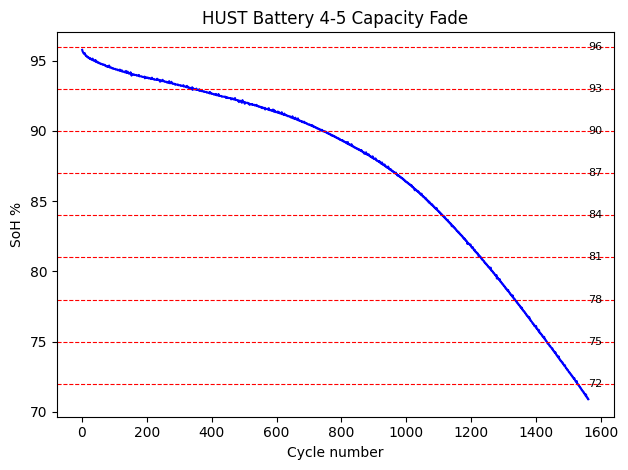

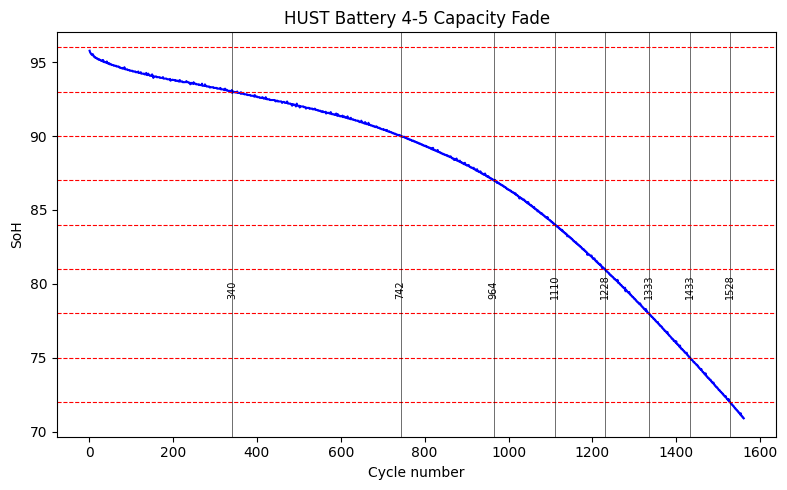

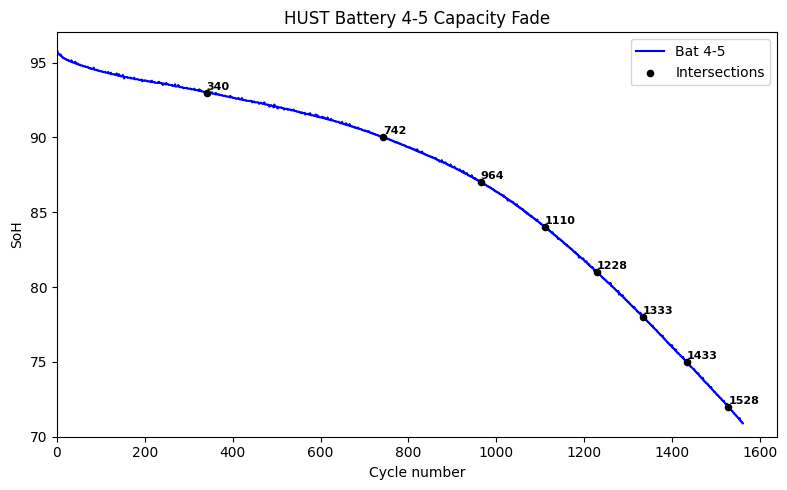

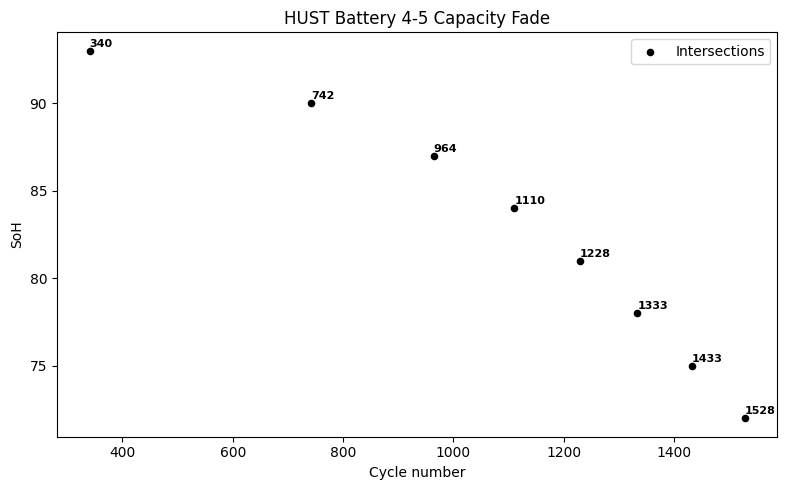

--------------------------------------------------------------------------------
2-6
1572


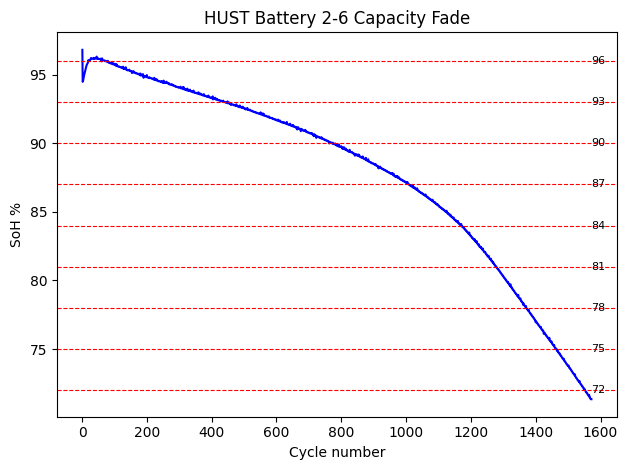

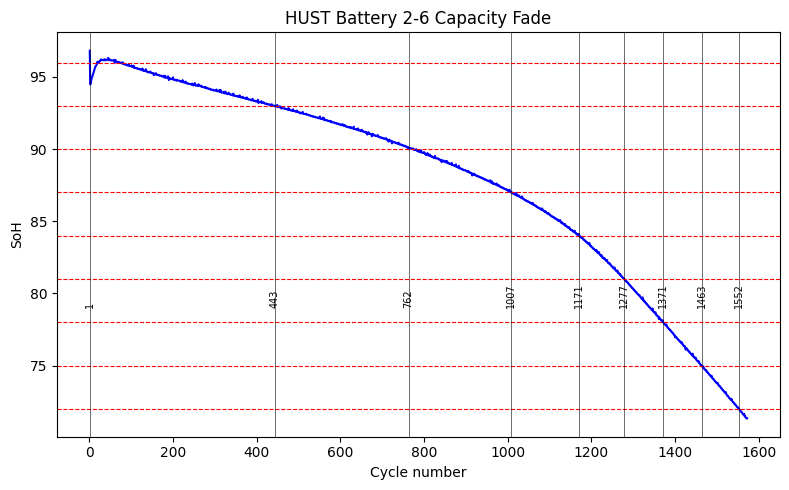

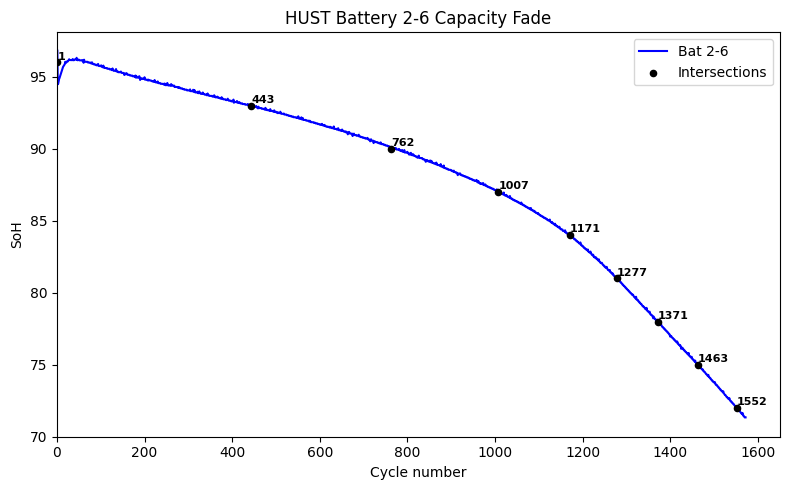

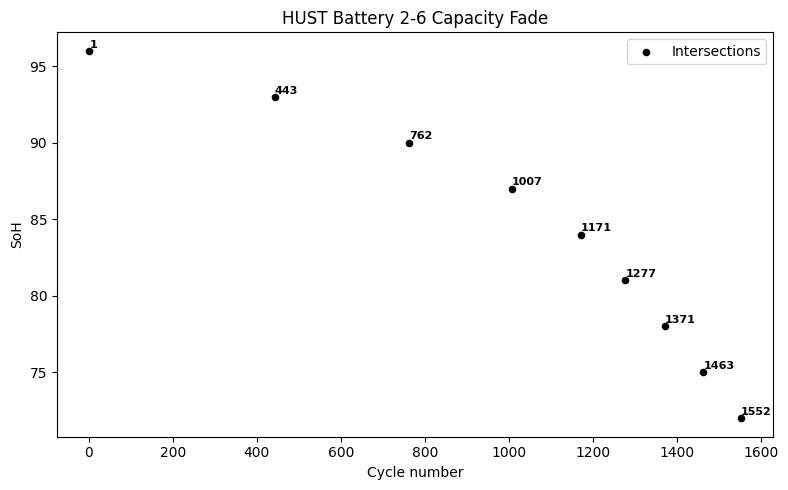

--------------------------------------------------------------------------------
5-5
1583


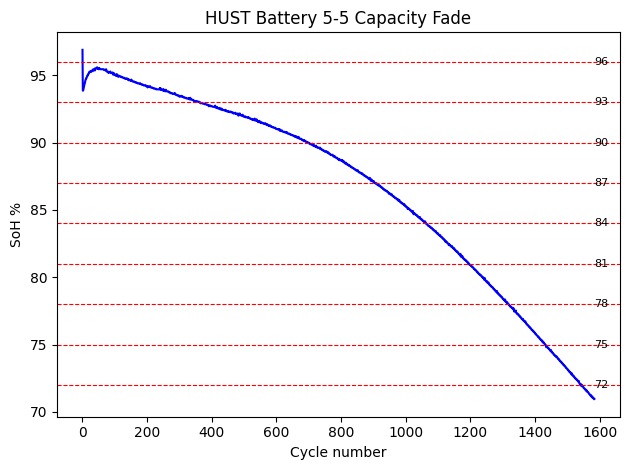

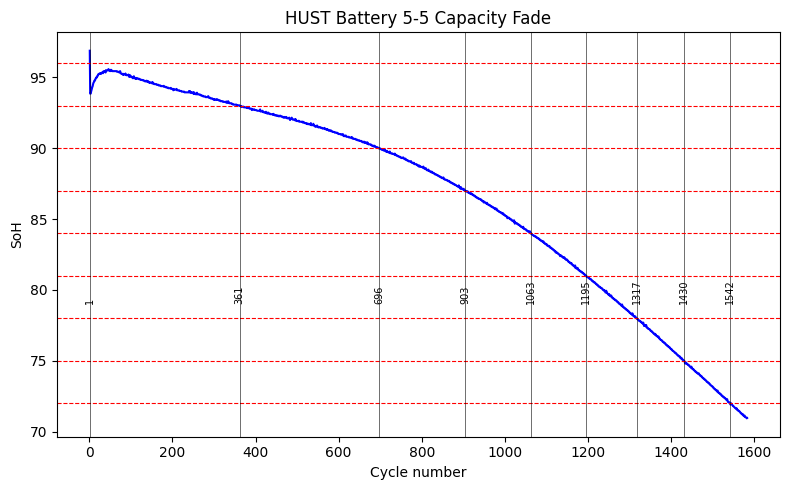

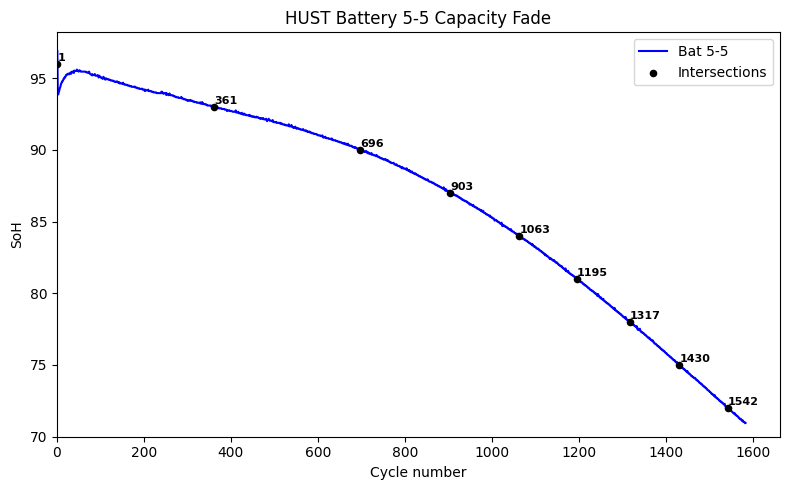

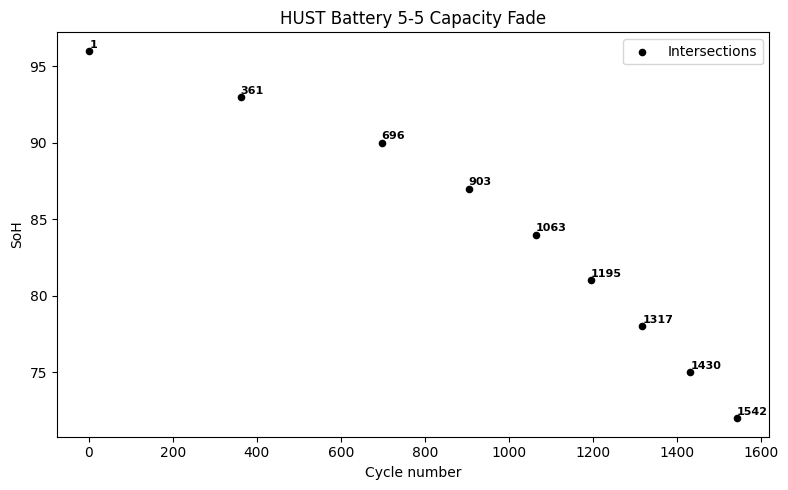

--------------------------------------------------------------------------------
6-1
1609


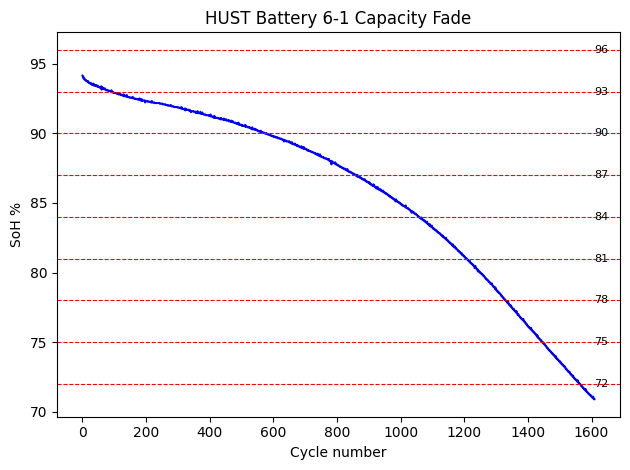

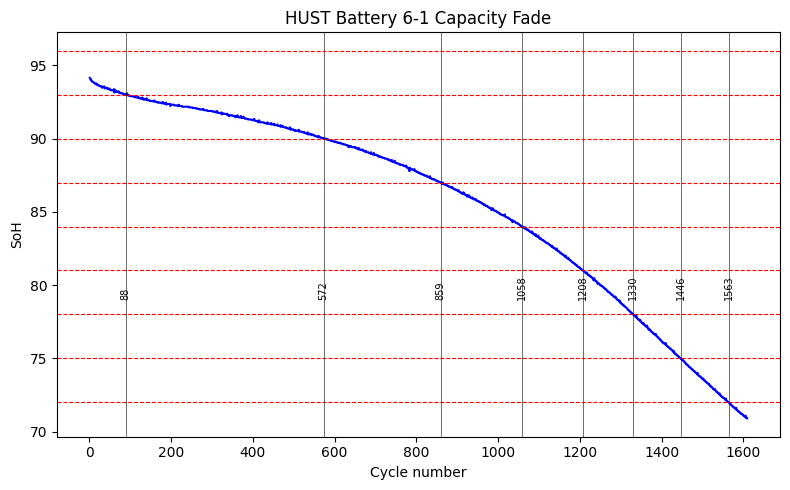

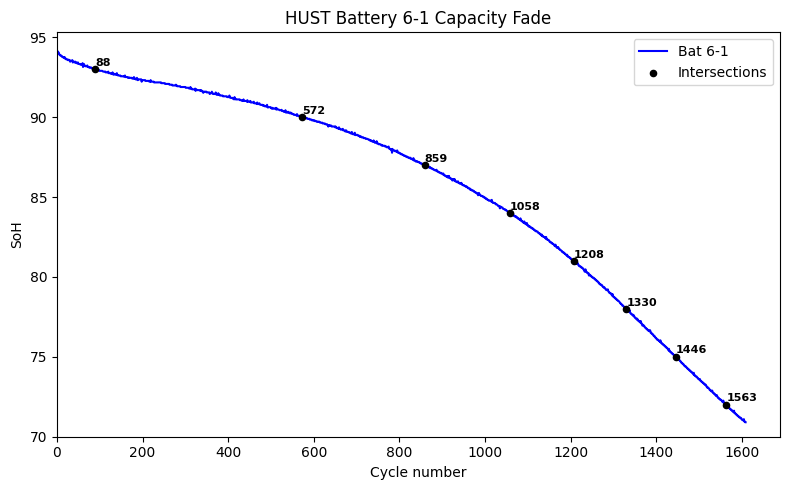

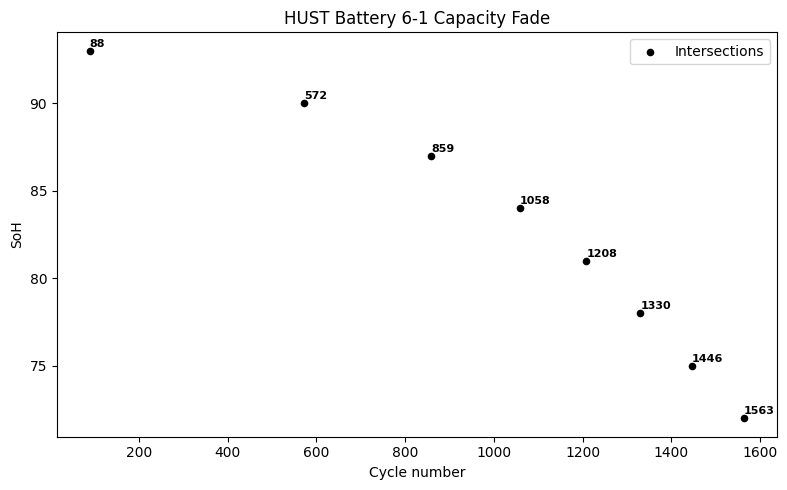

--------------------------------------------------------------------------------
3-3
1649


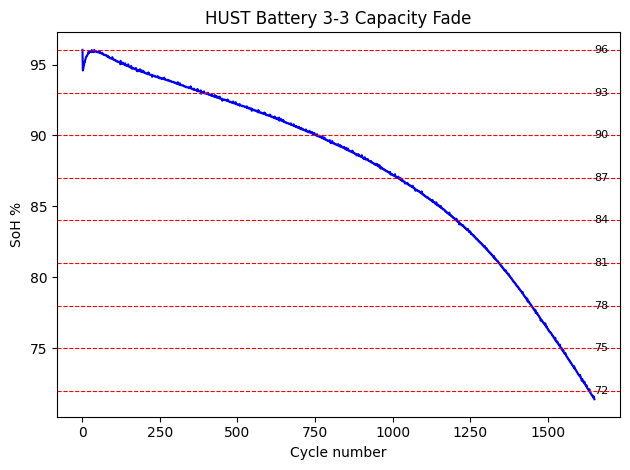

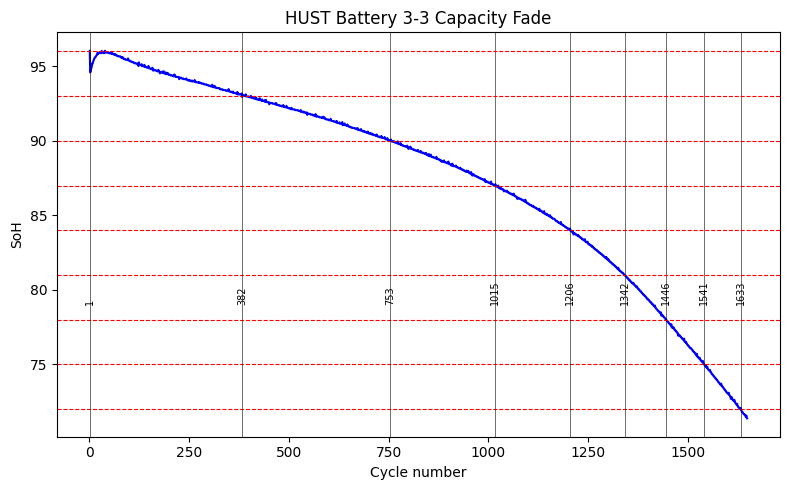

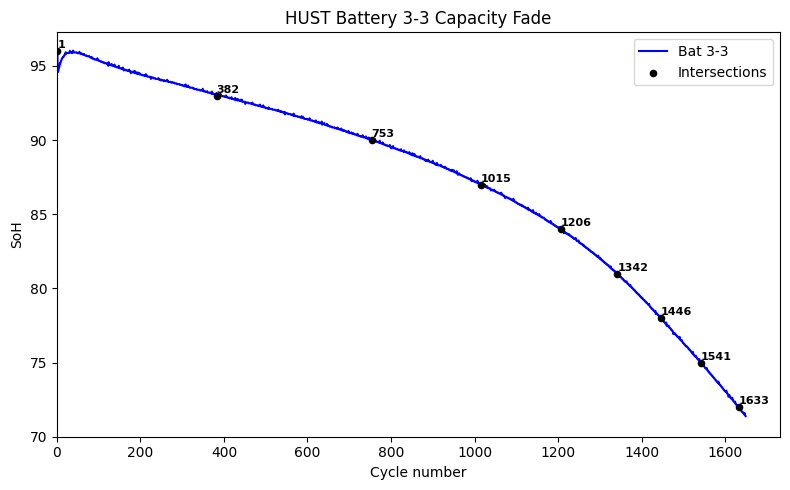

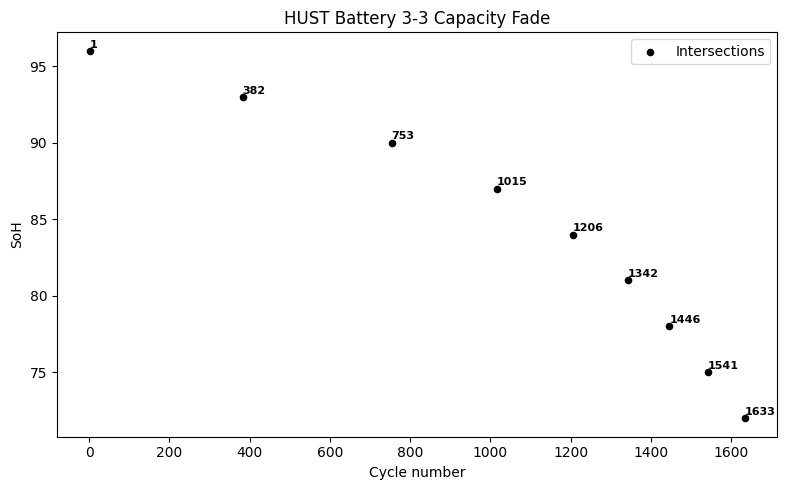

--------------------------------------------------------------------------------
1-7
1678


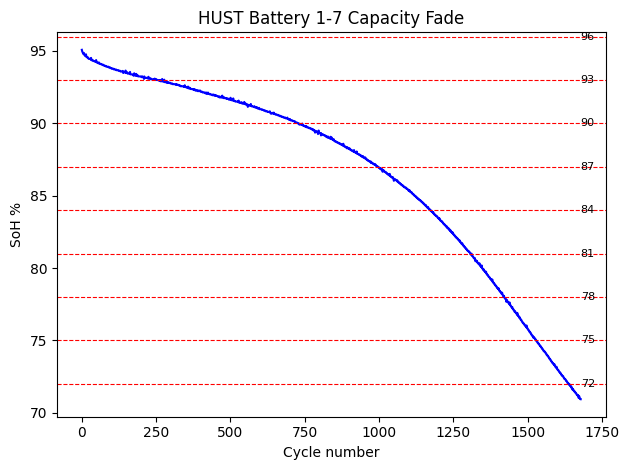

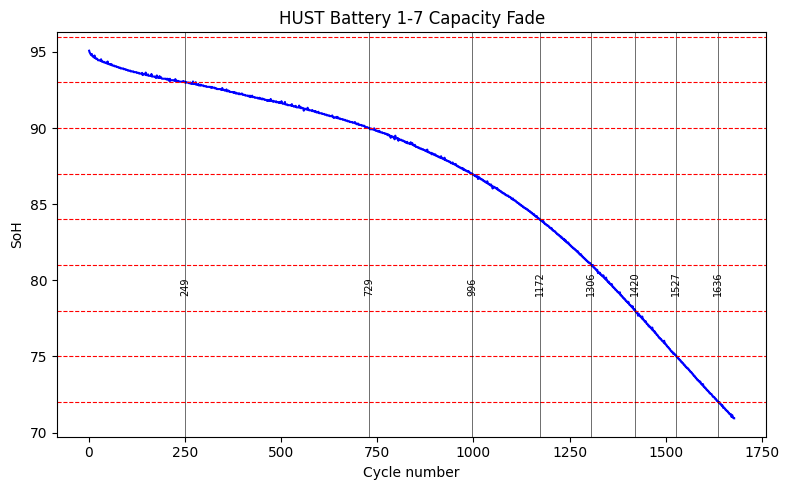

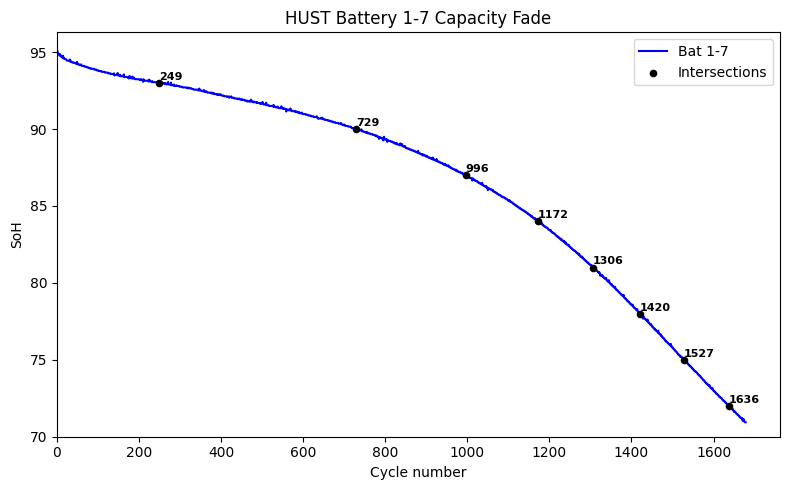

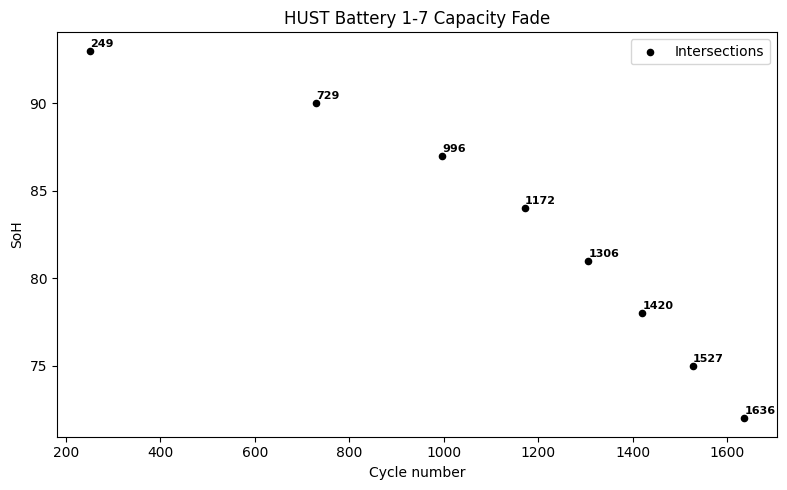

--------------------------------------------------------------------------------
8-8
1679


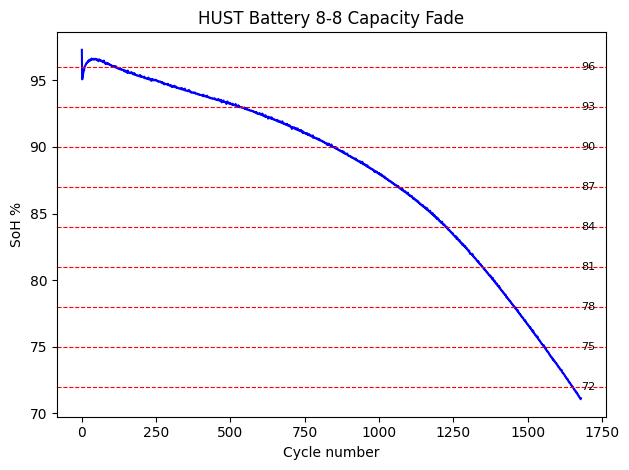

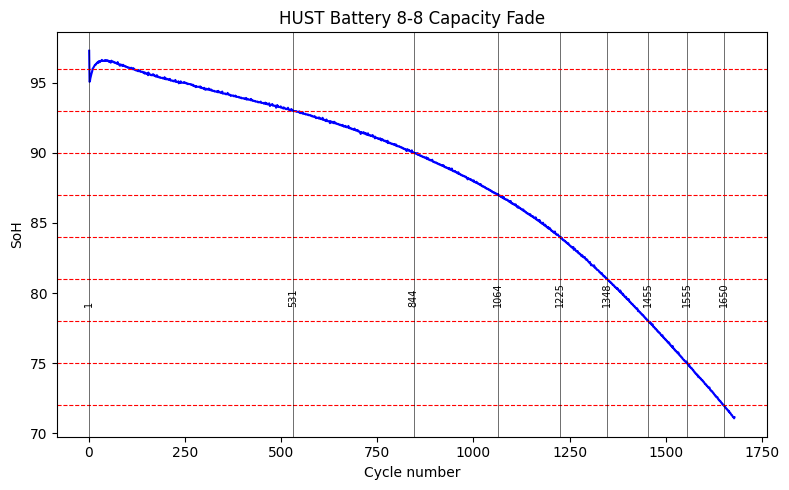

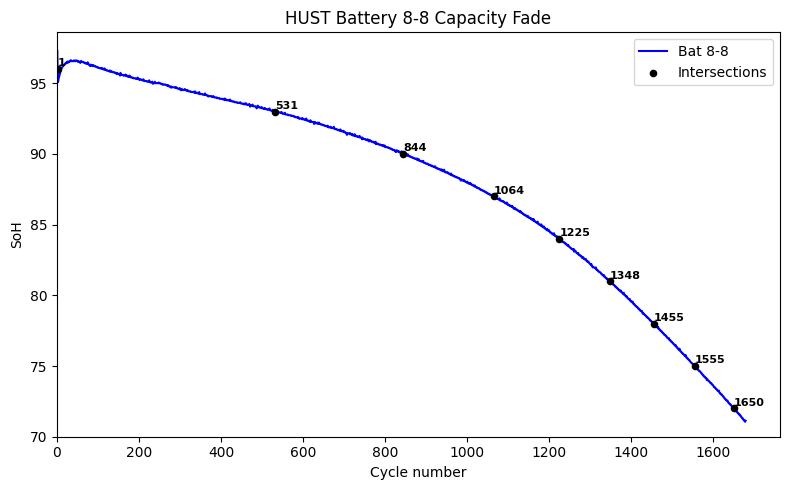

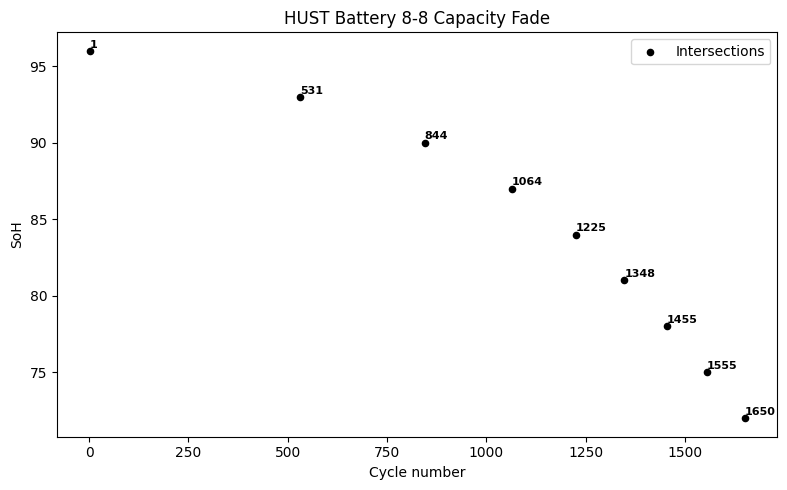

--------------------------------------------------------------------------------
7-7
1685


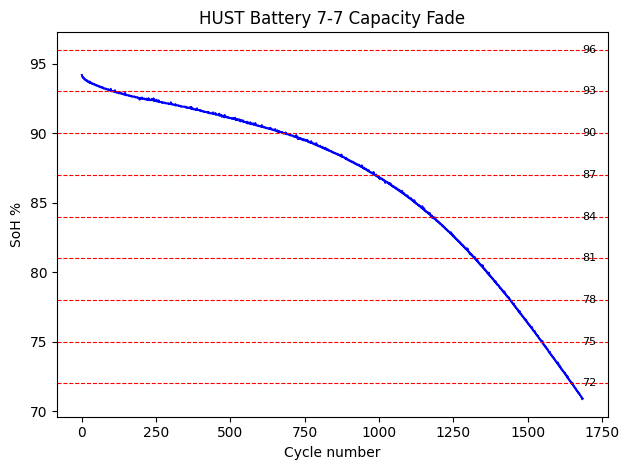

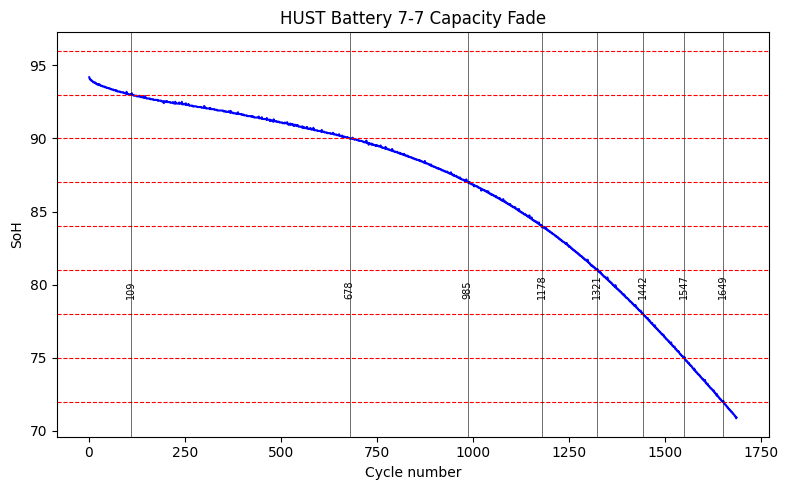

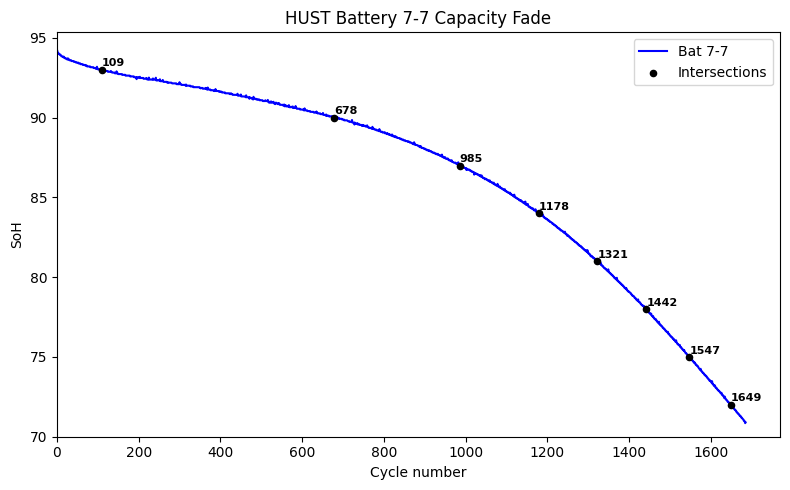

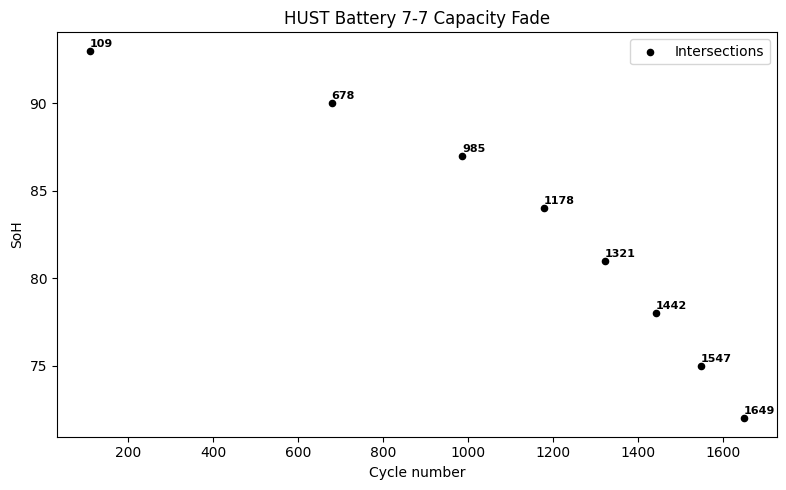

--------------------------------------------------------------------------------
7-1
1690


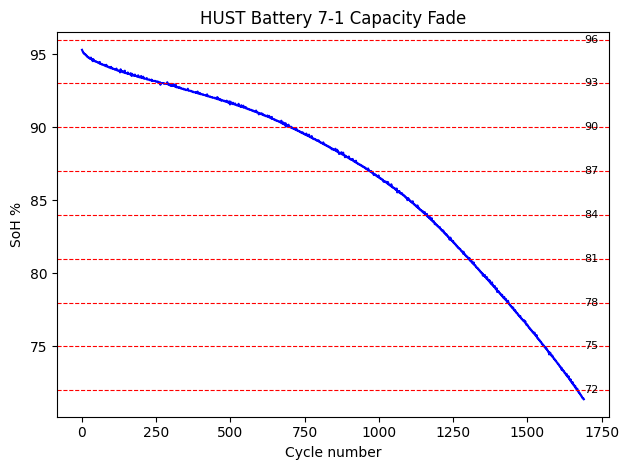

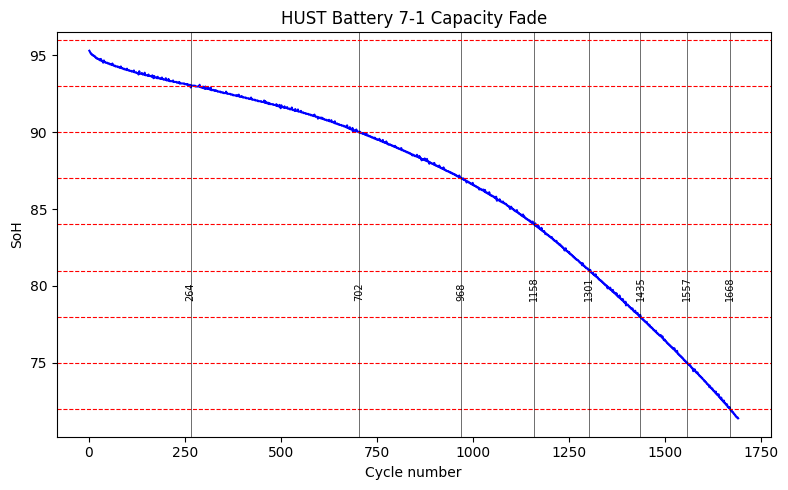

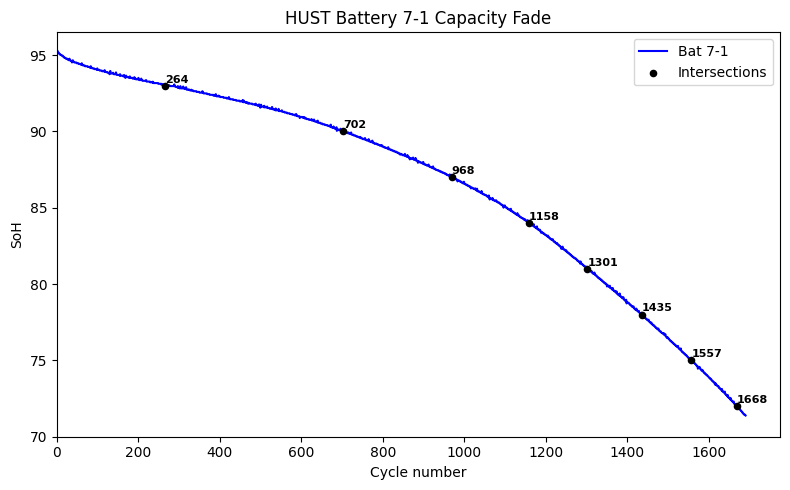

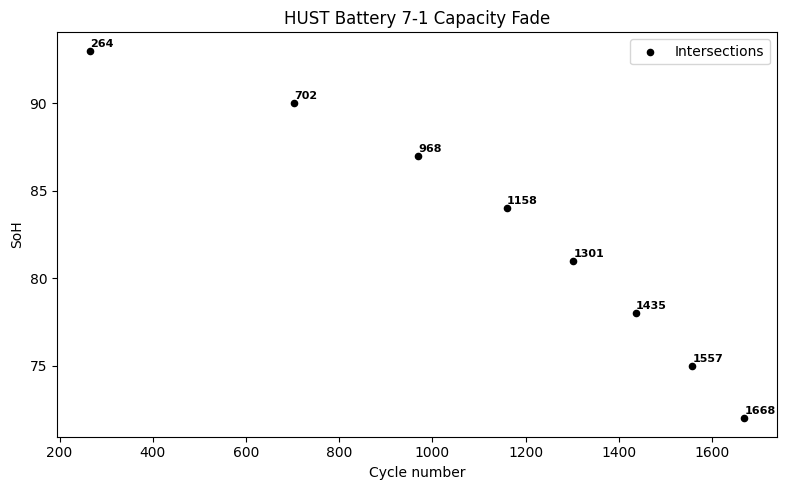

--------------------------------------------------------------------------------
10-2
1697


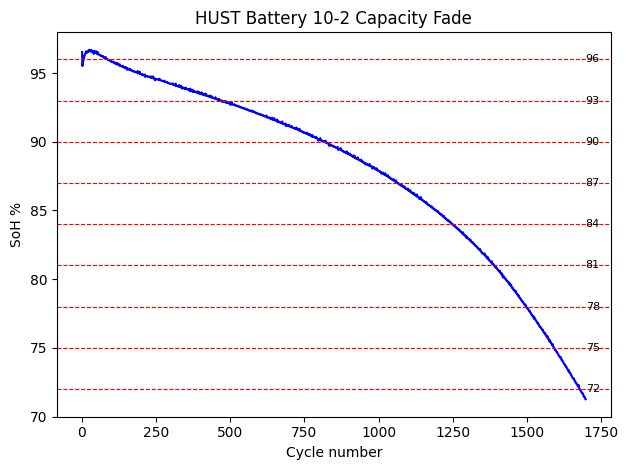

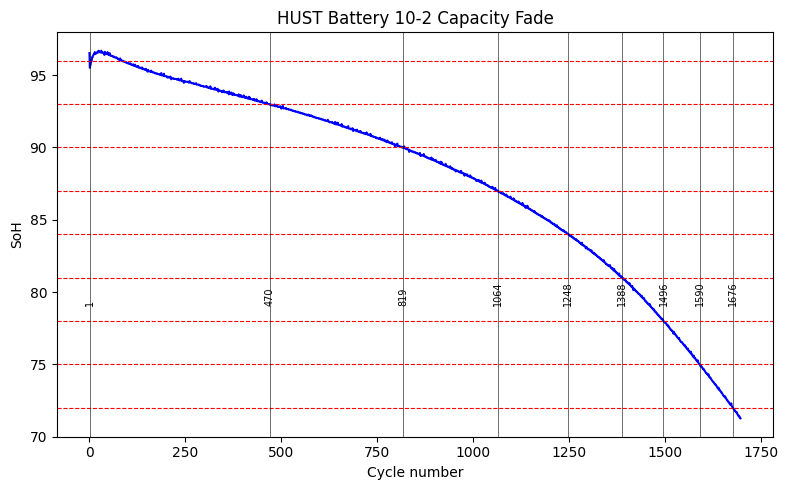

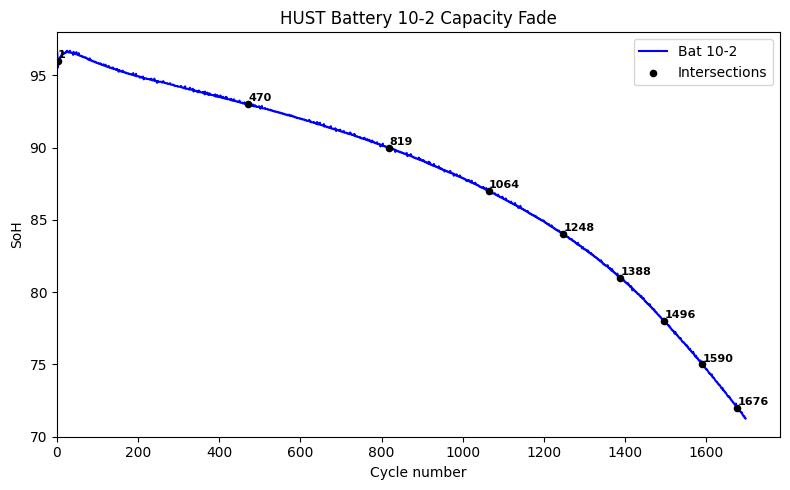

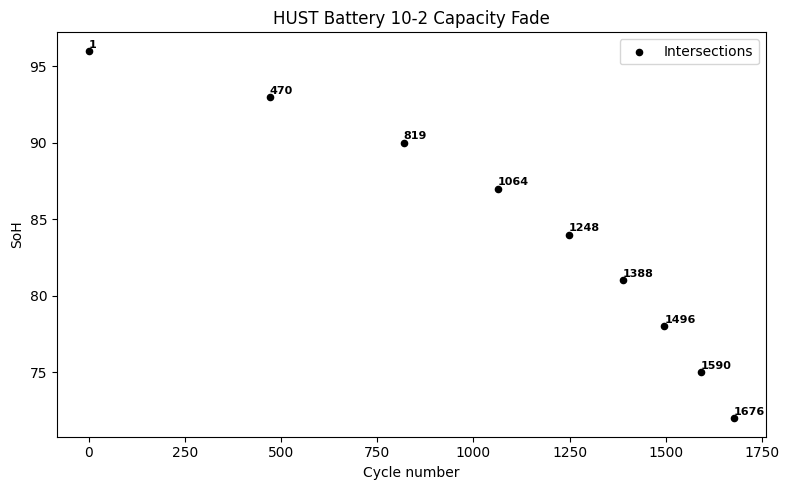

--------------------------------------------------------------------------------
10-1
1702


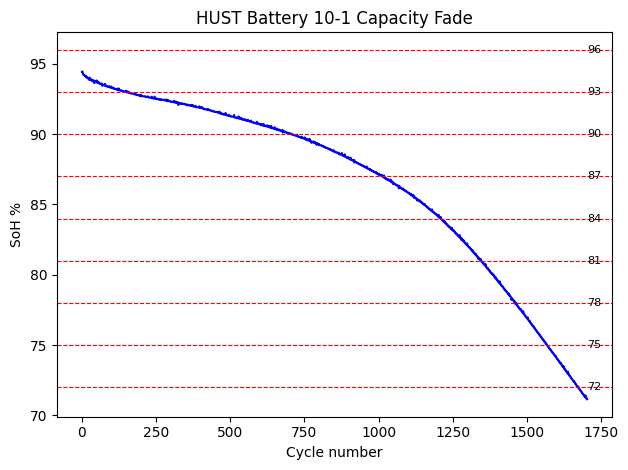

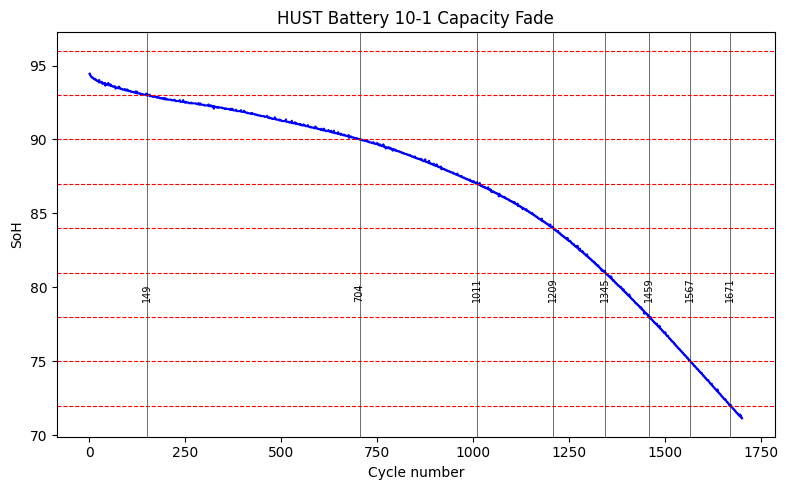

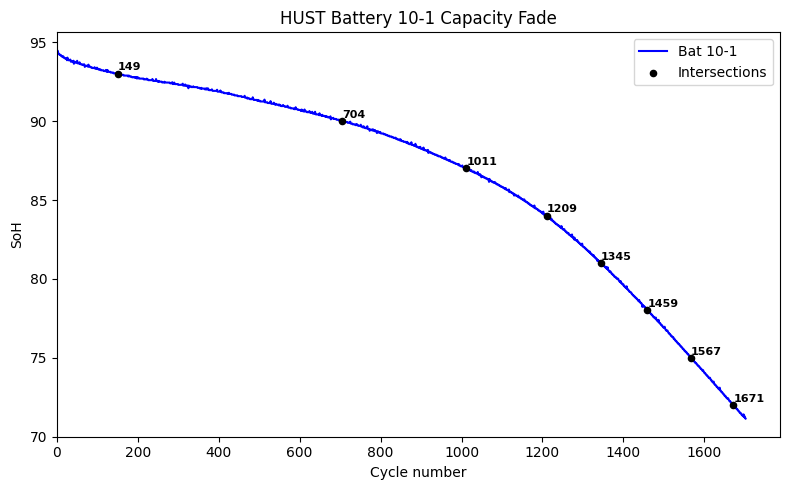

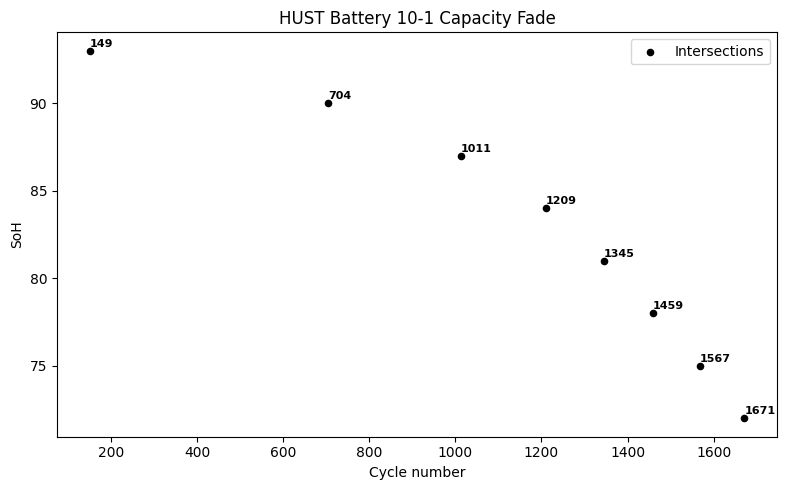

--------------------------------------------------------------------------------
4-8
1706


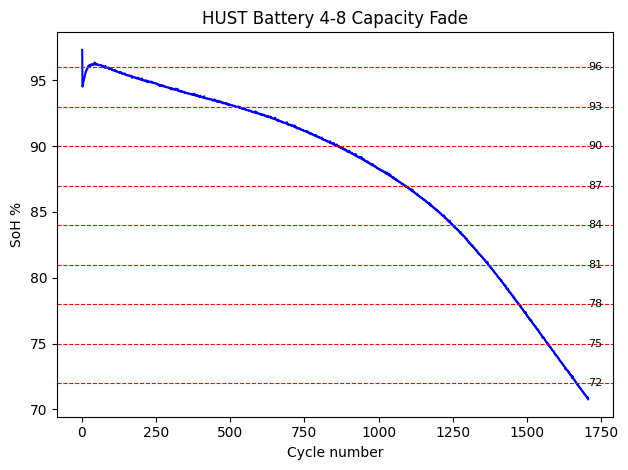

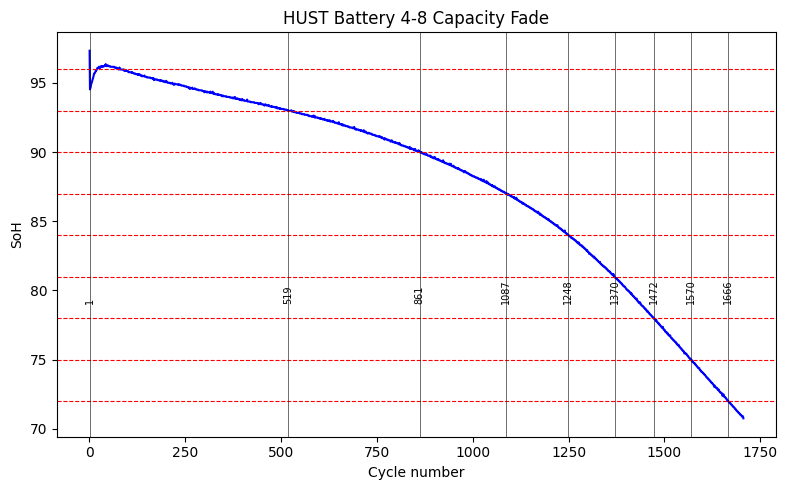

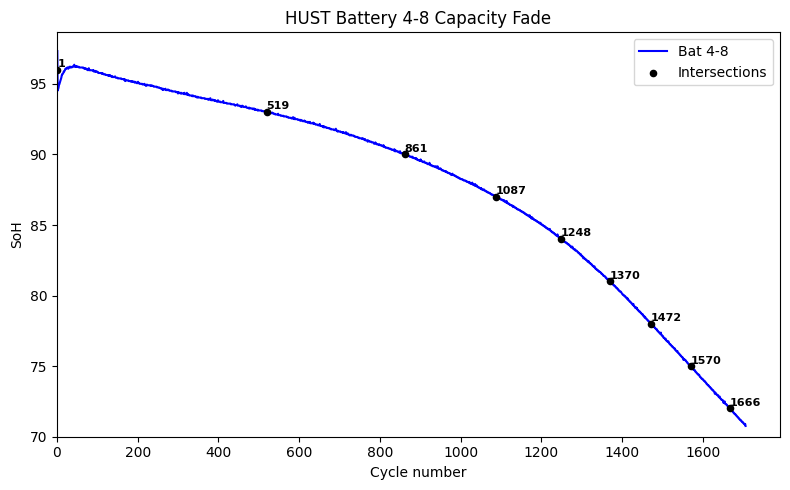

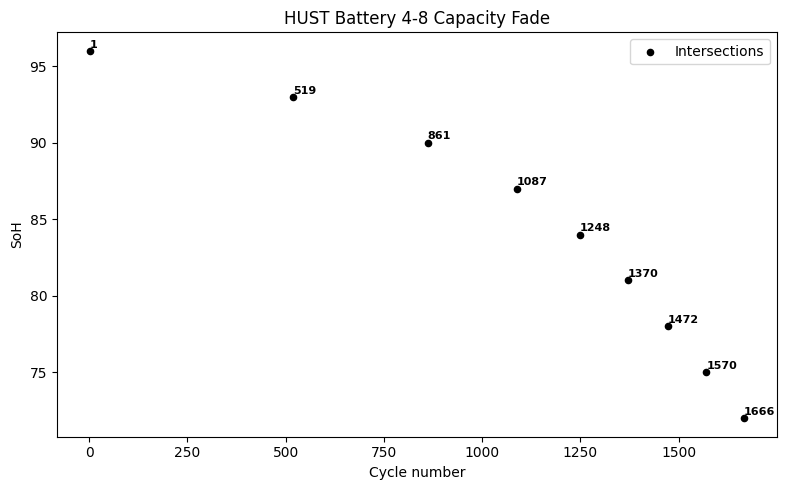

--------------------------------------------------------------------------------
6-4
1717


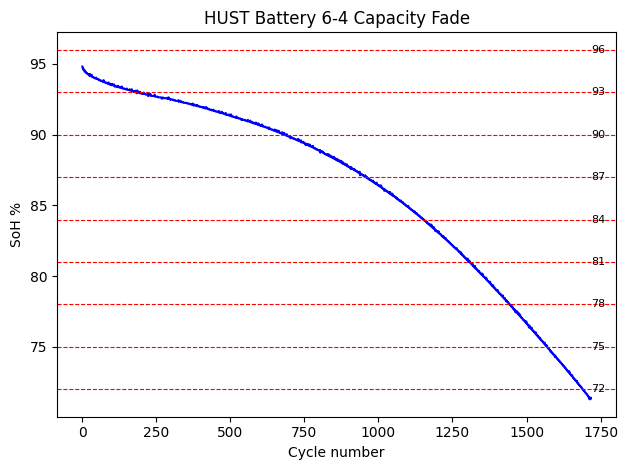

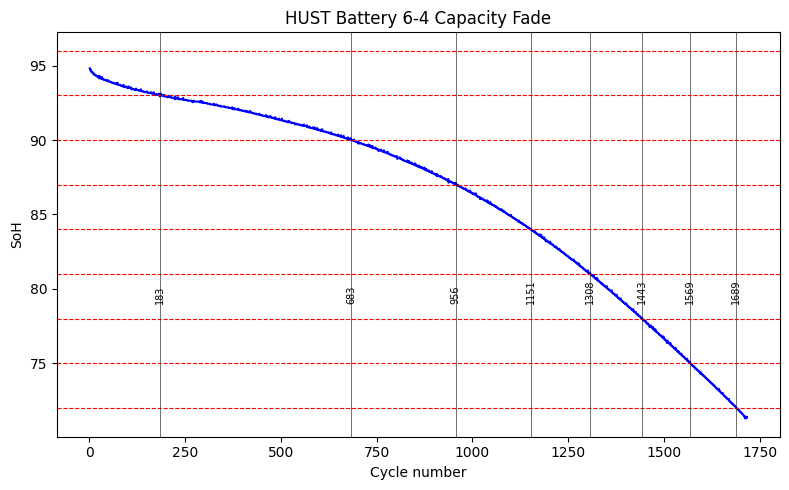

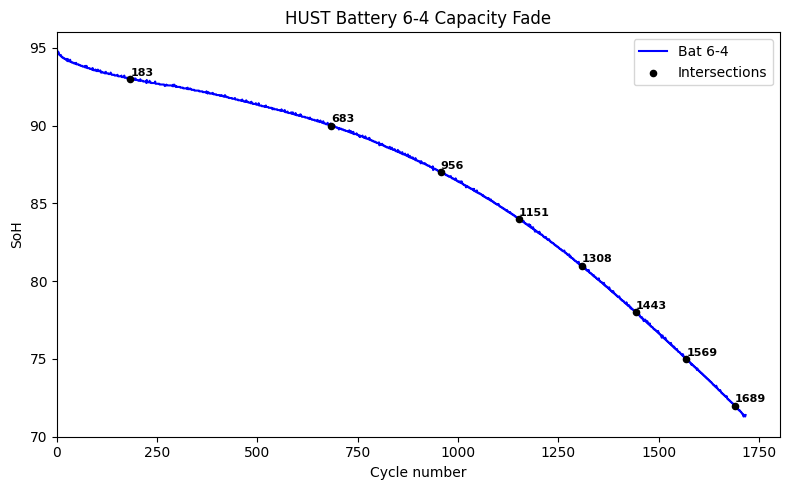

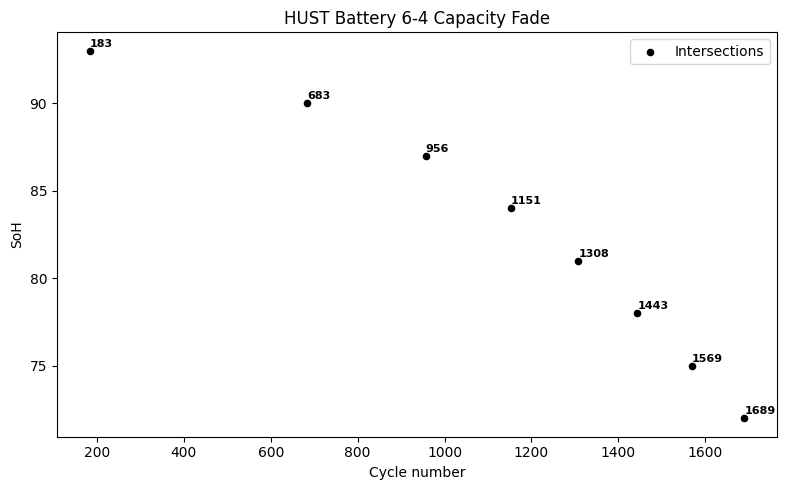

--------------------------------------------------------------------------------
9-6
1742


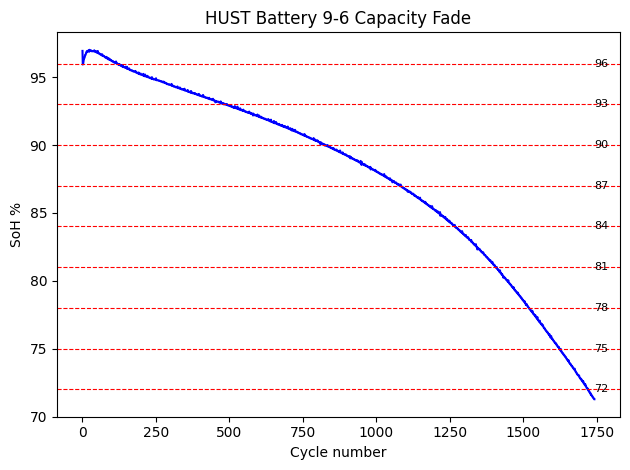

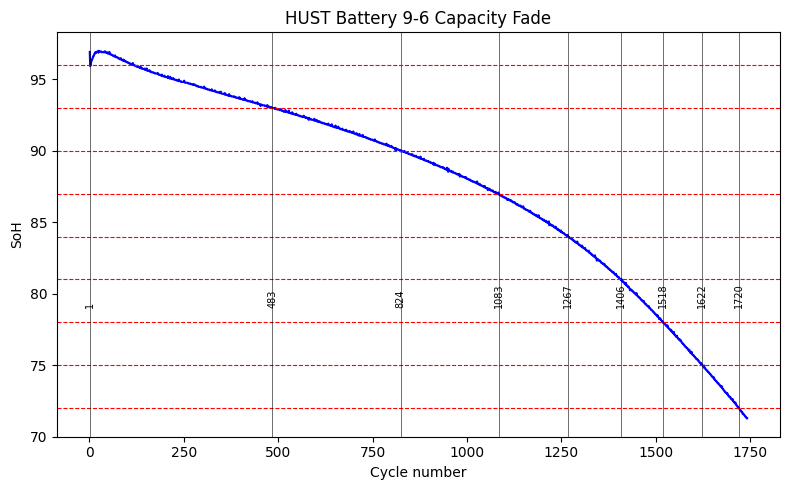

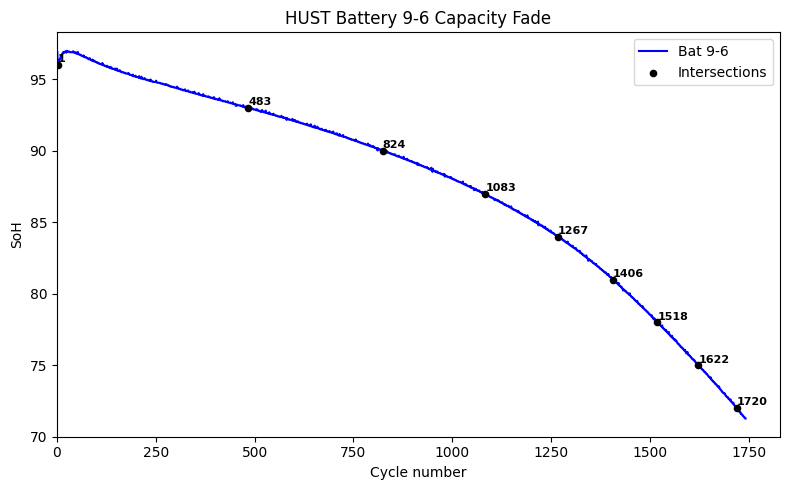

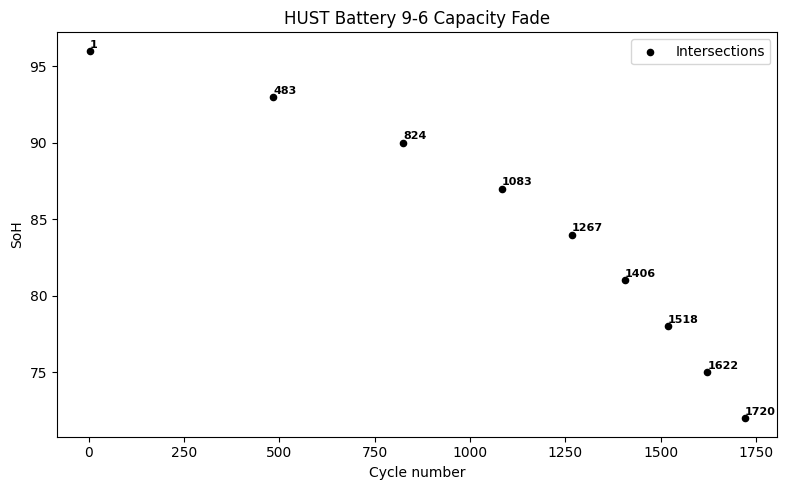

--------------------------------------------------------------------------------
2-3
1751


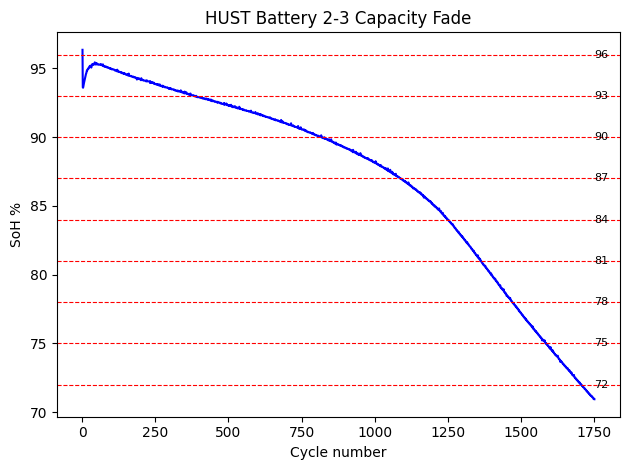

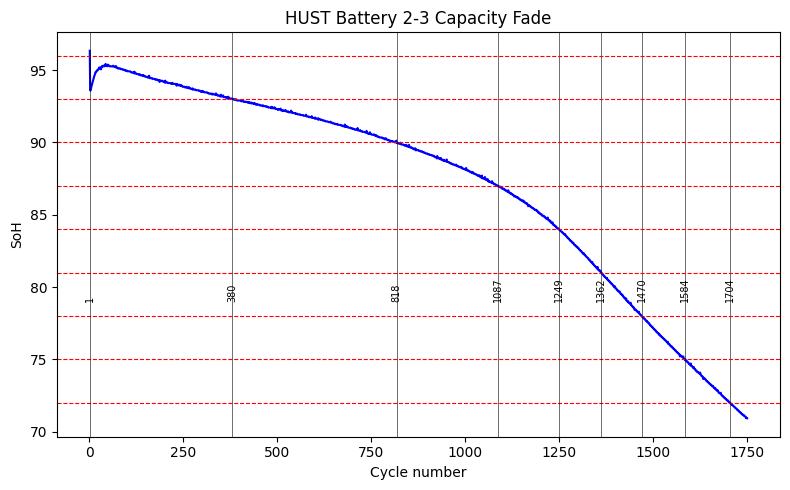

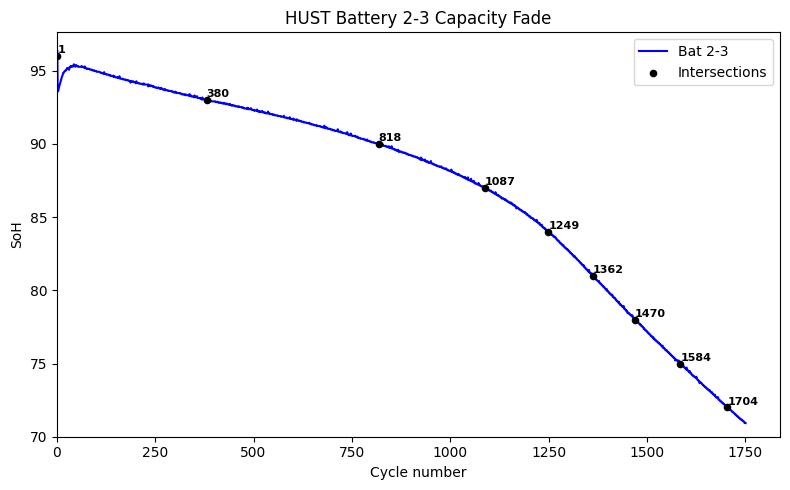

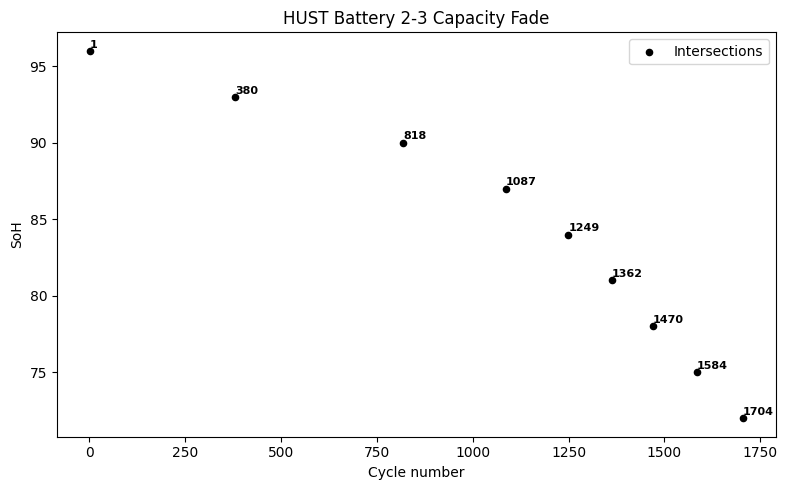

--------------------------------------------------------------------------------
3-4
1766


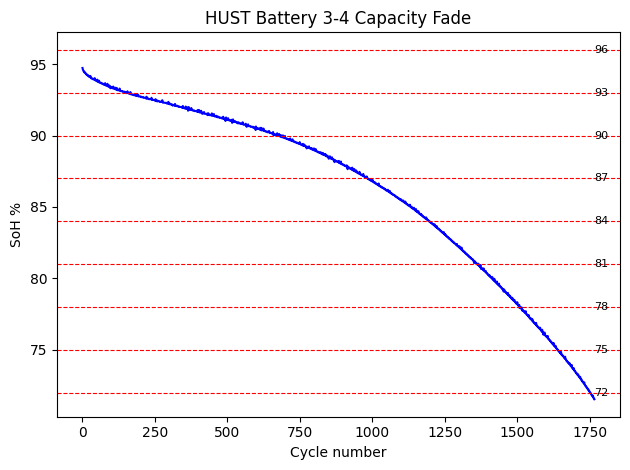

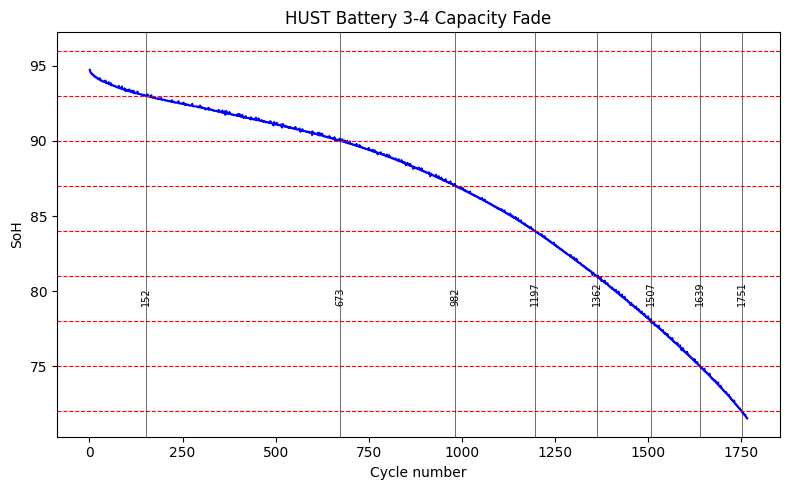

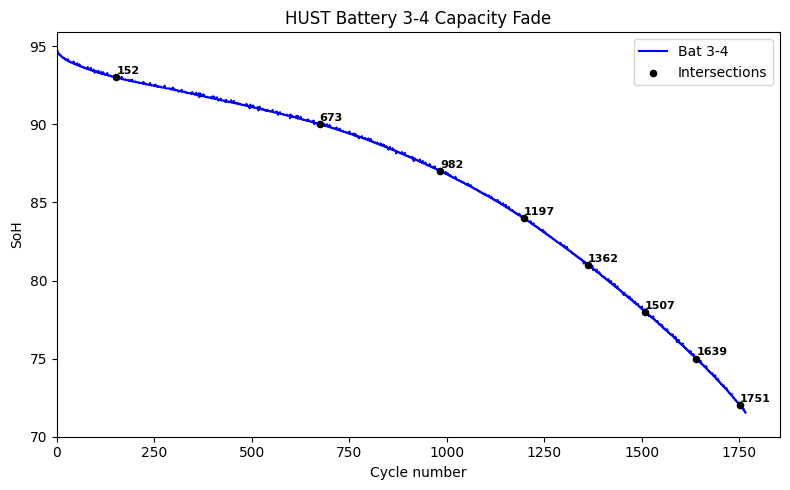

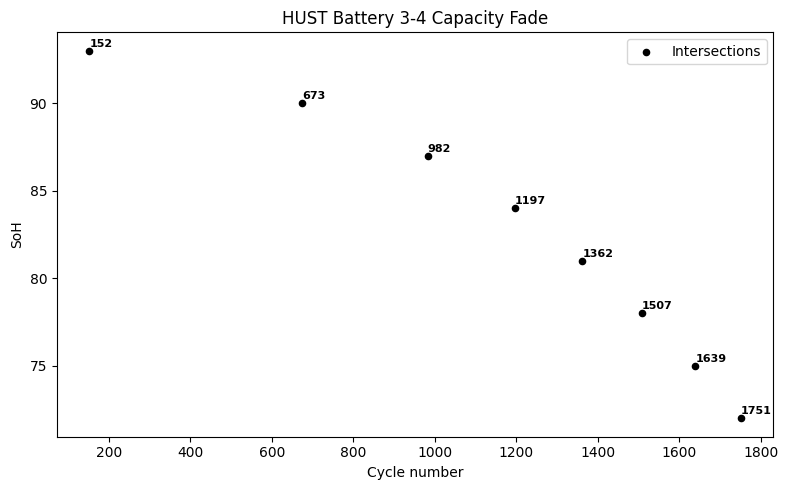

--------------------------------------------------------------------------------
4-2
1782


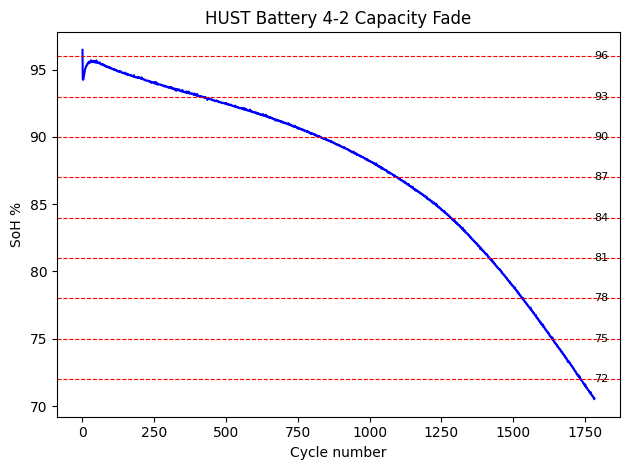

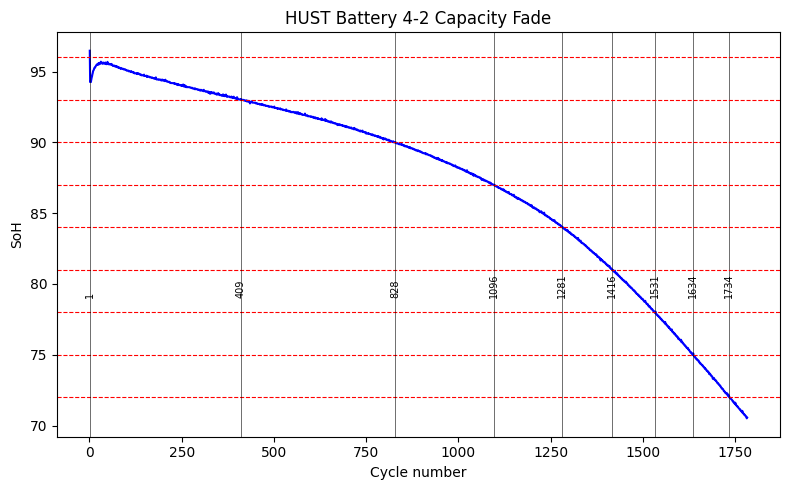

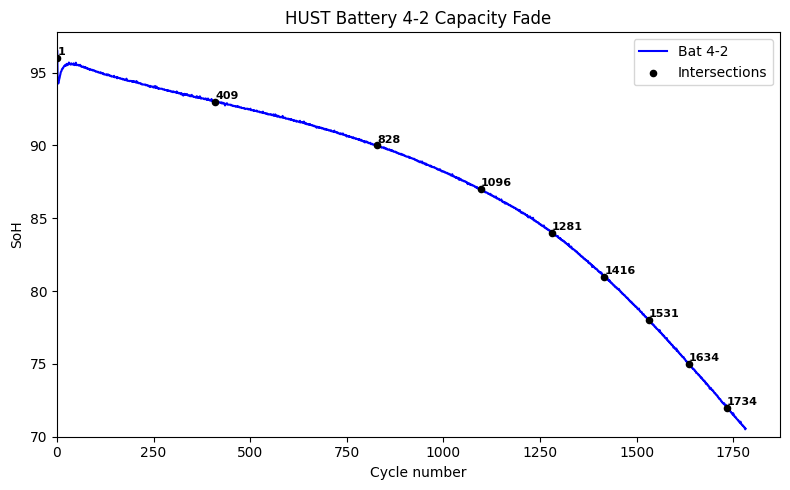

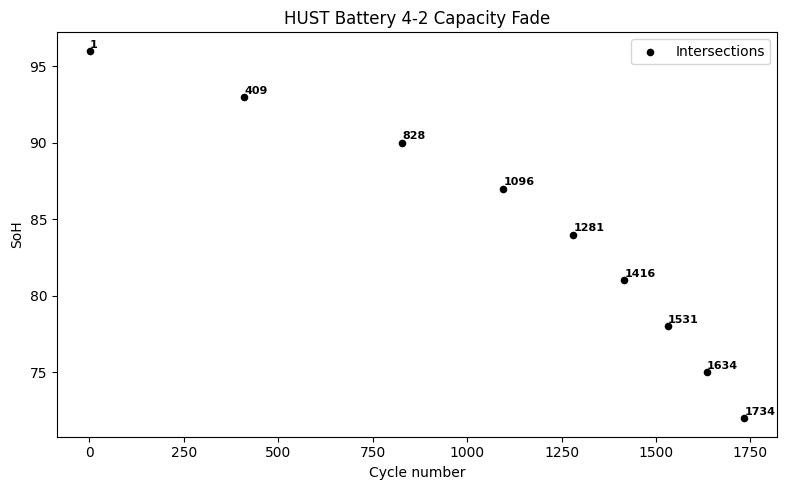

--------------------------------------------------------------------------------
10-7
1783


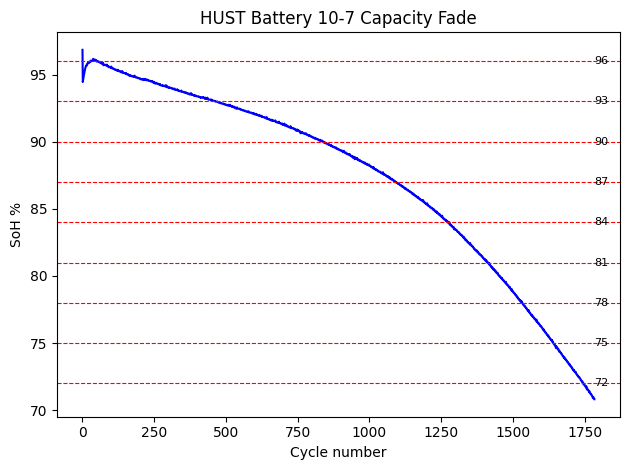

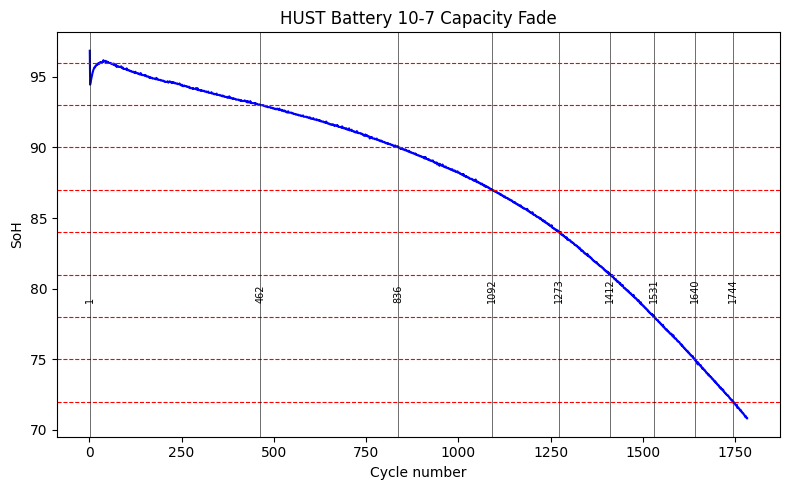

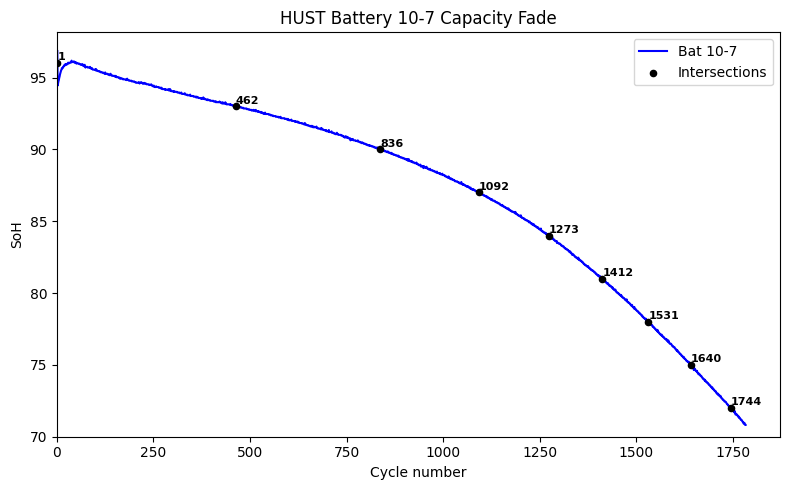

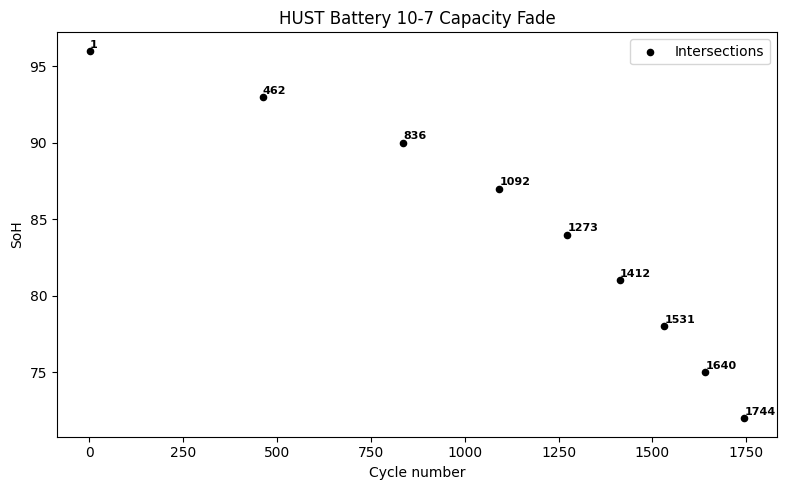

--------------------------------------------------------------------------------
6-3
1804


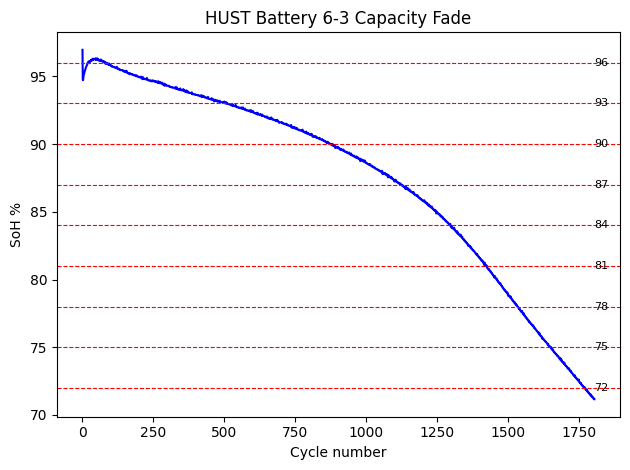

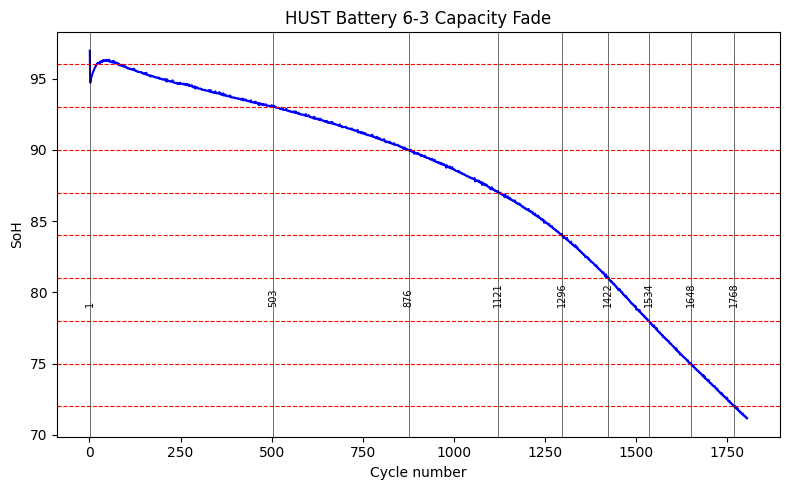

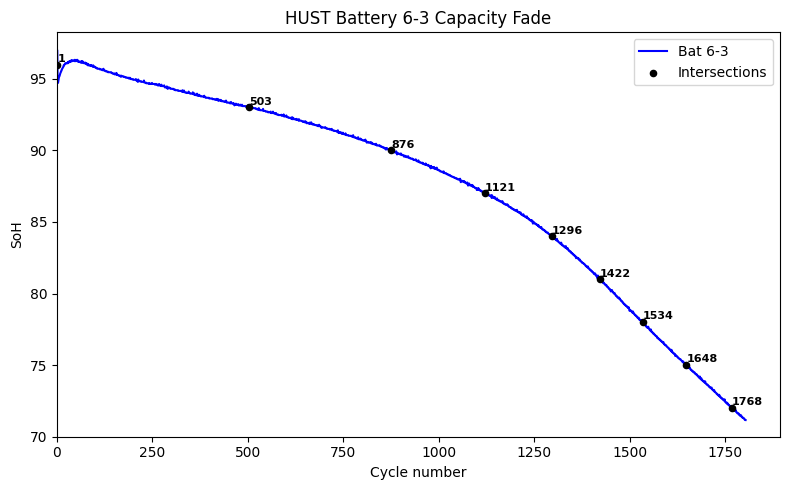

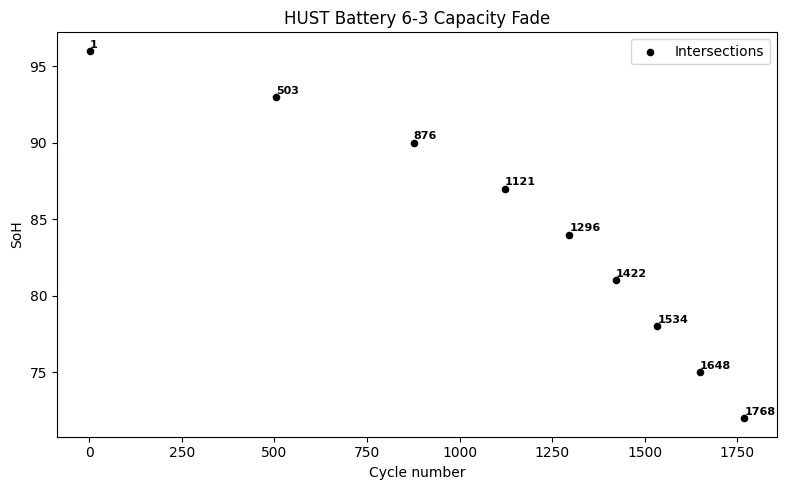

--------------------------------------------------------------------------------
10-4
1811


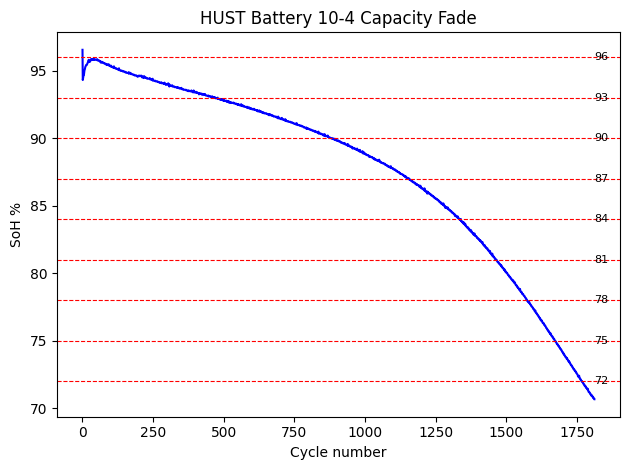

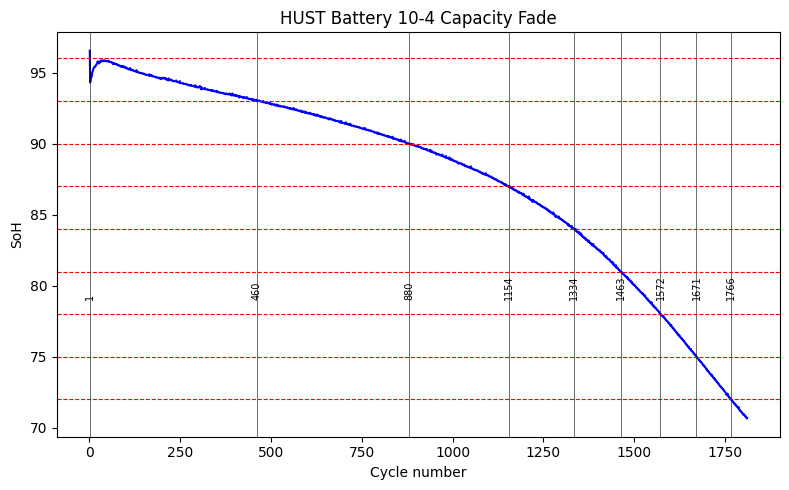

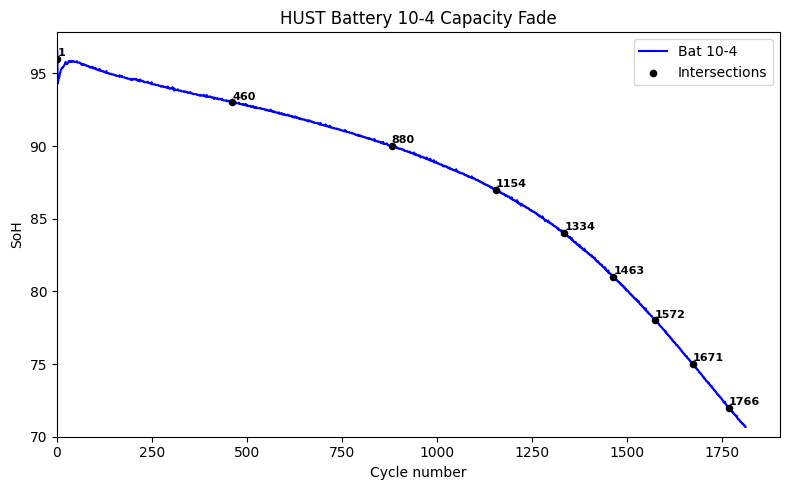

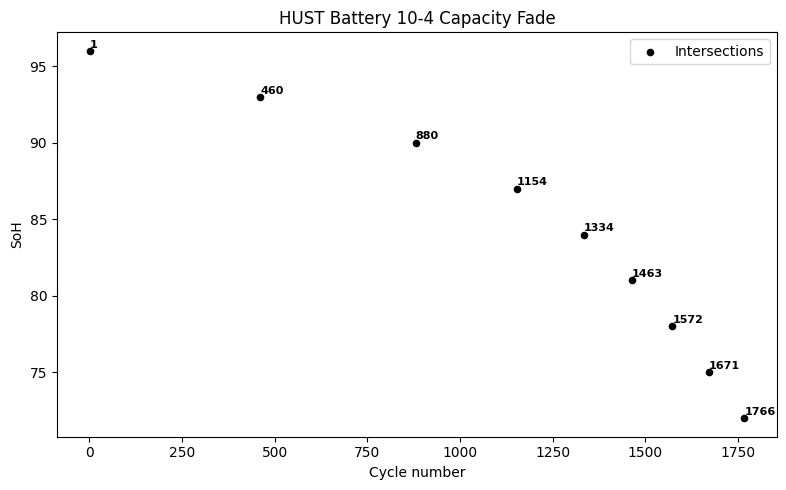

--------------------------------------------------------------------------------
10-3
1848


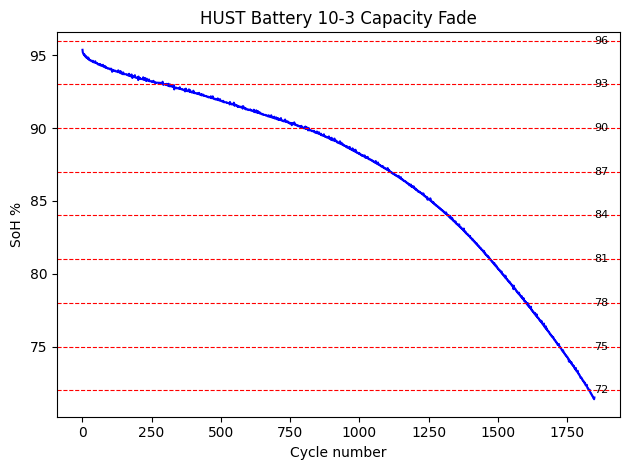

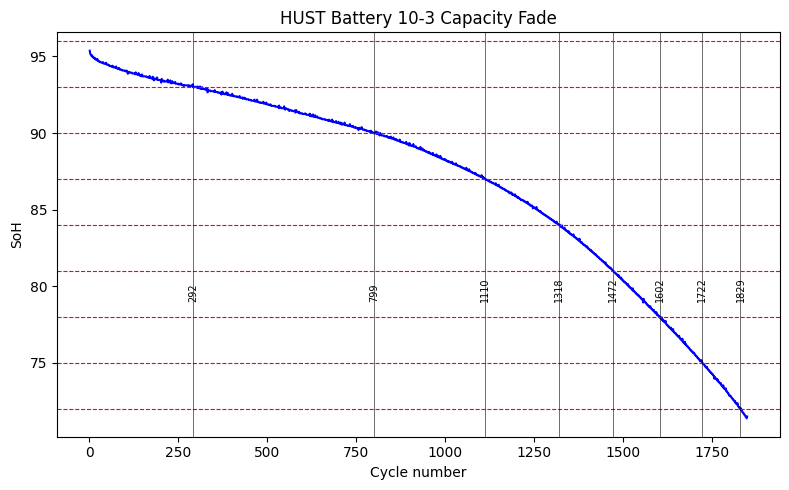

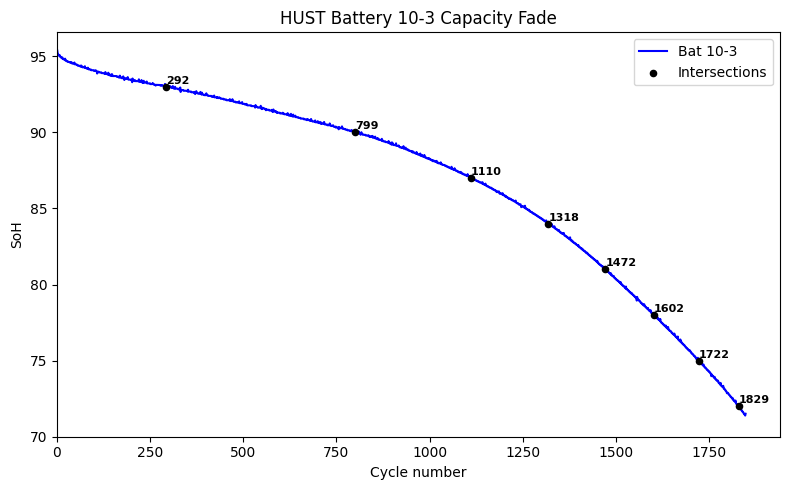

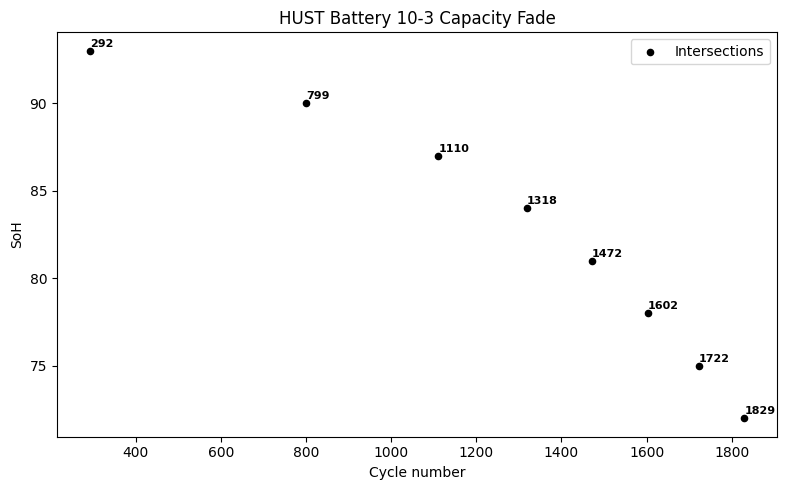

--------------------------------------------------------------------------------
1-3
1858


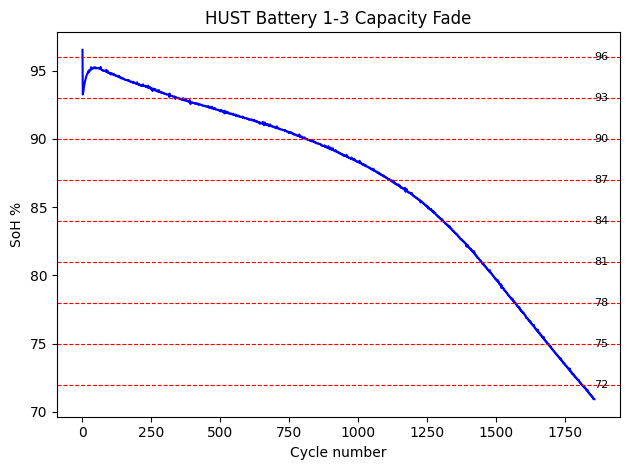

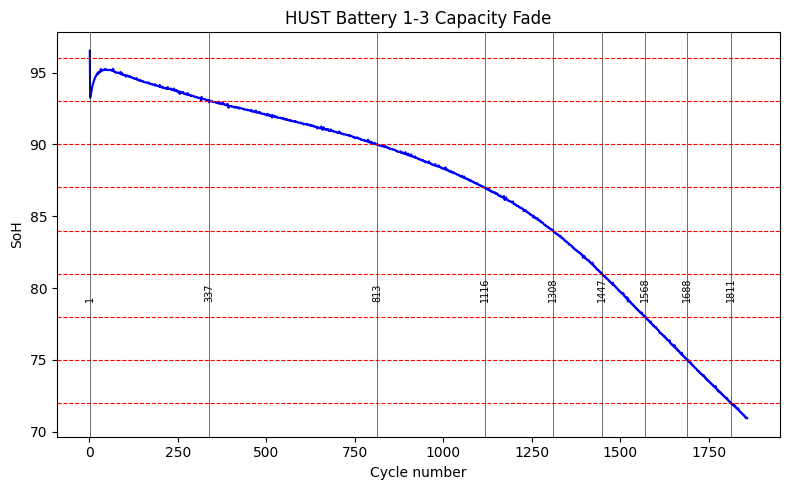

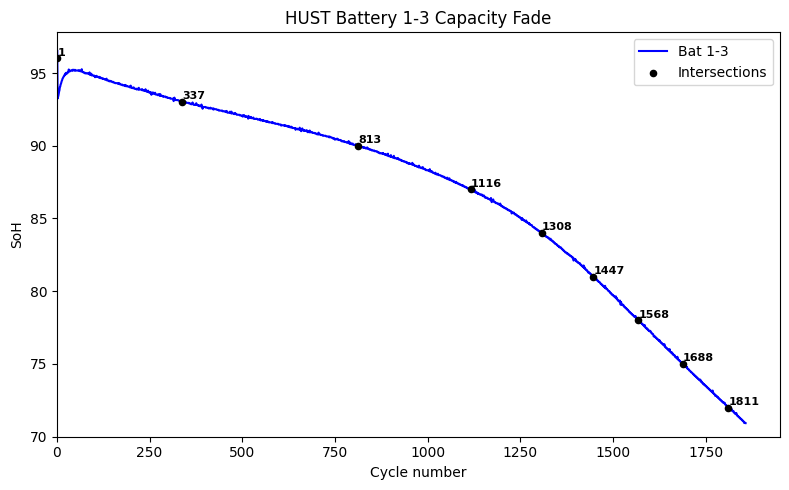

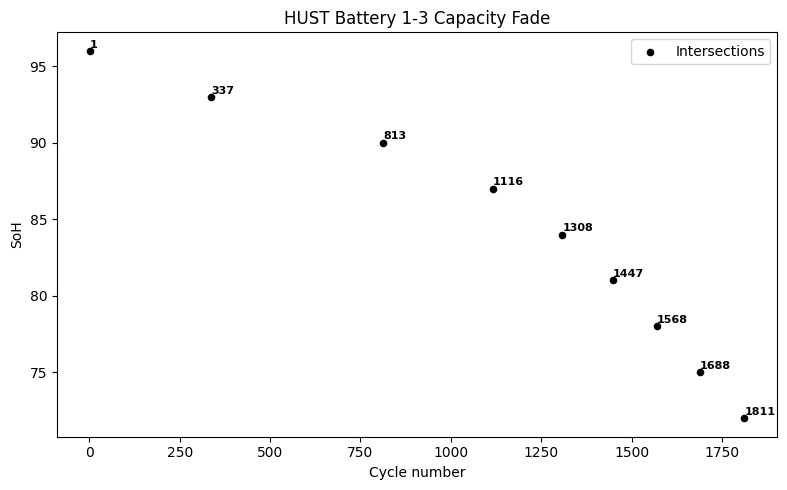

--------------------------------------------------------------------------------
7-5
1875


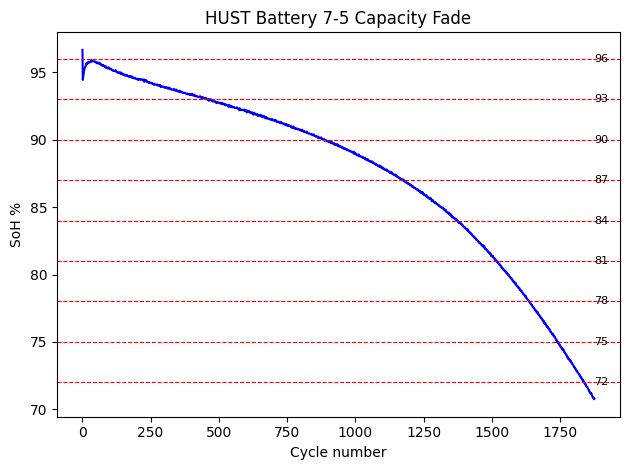

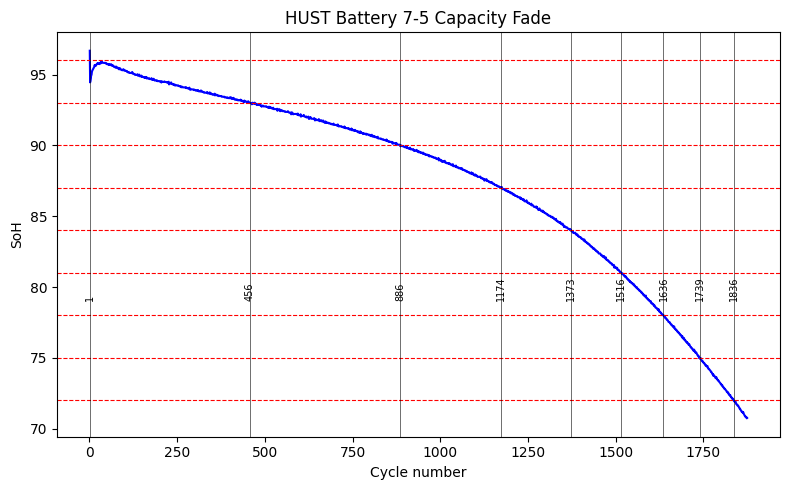

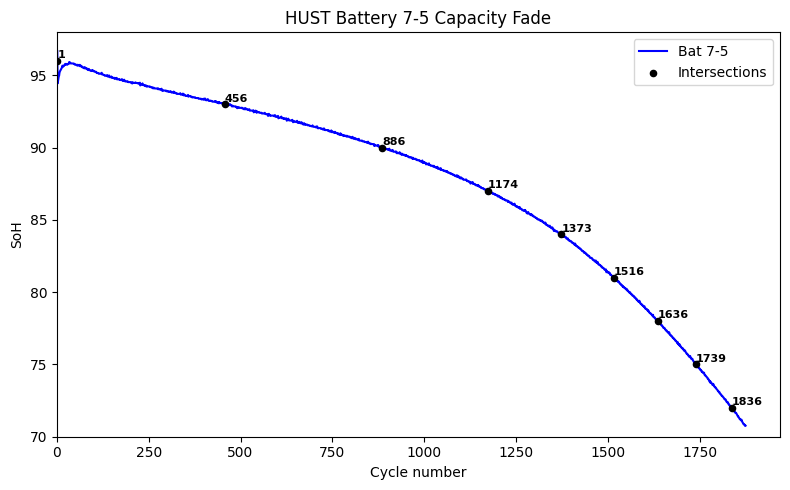

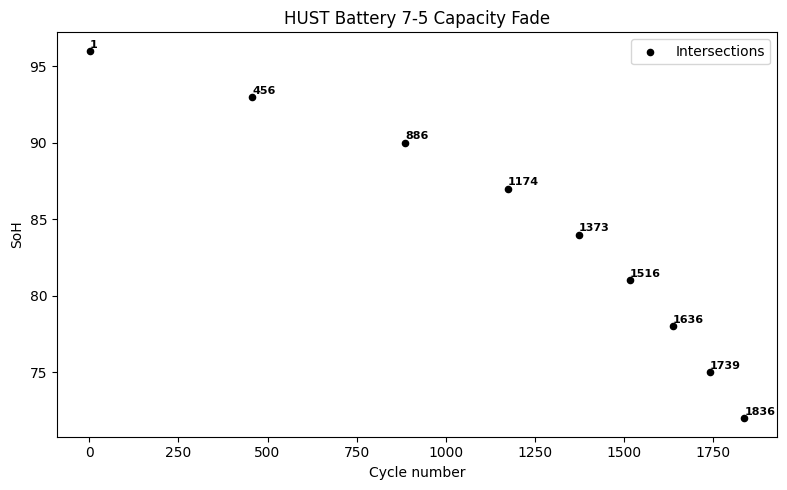

--------------------------------------------------------------------------------
8-4
1885


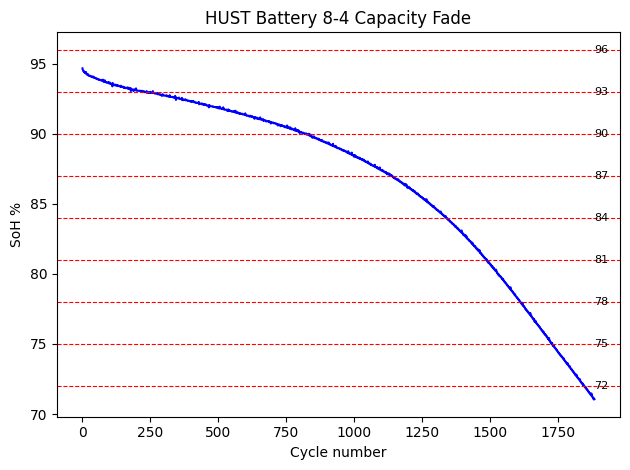

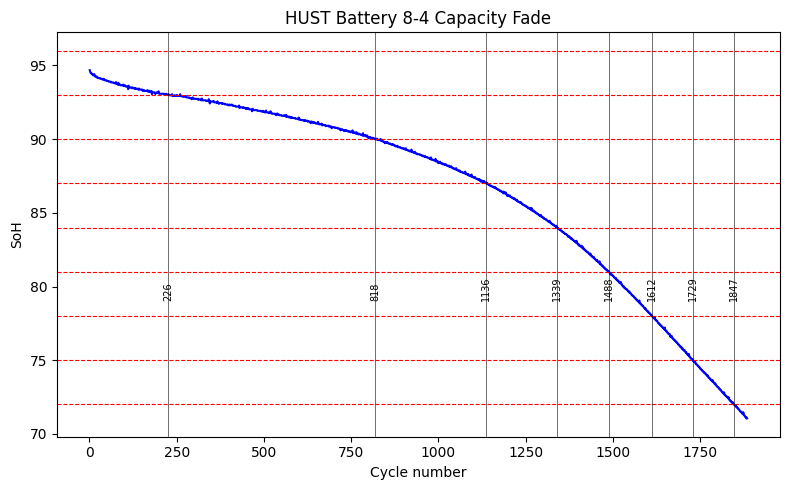

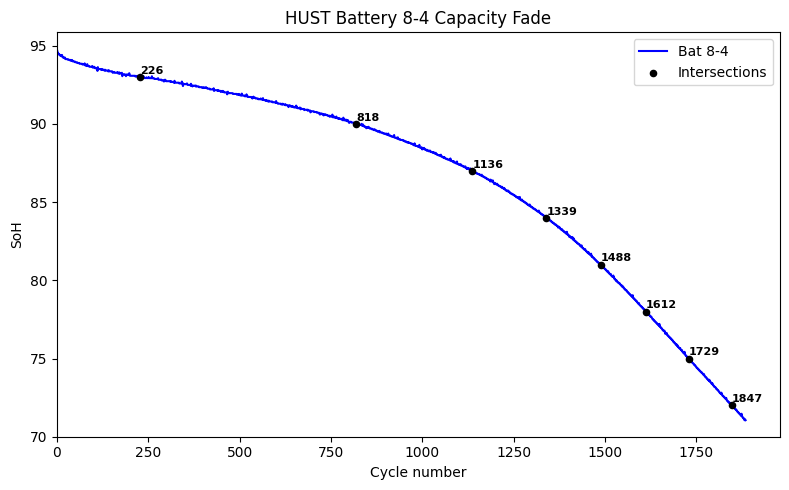

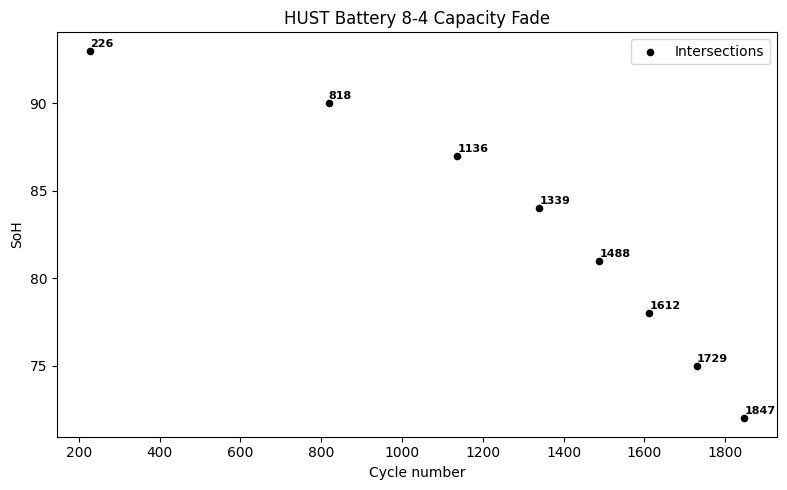

--------------------------------------------------------------------------------
9-3
1905


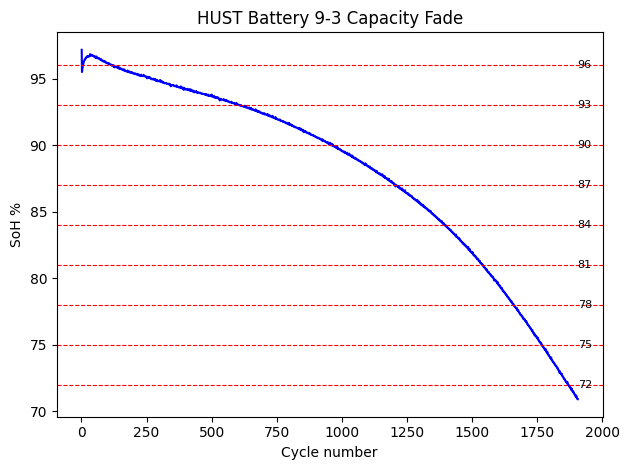

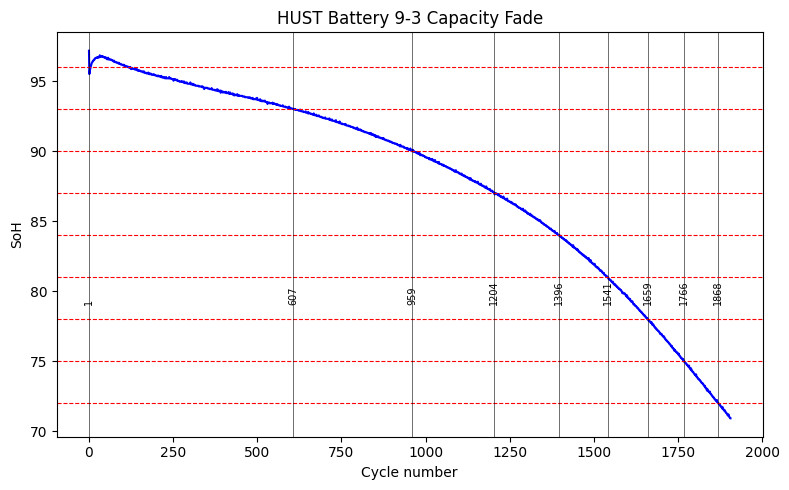

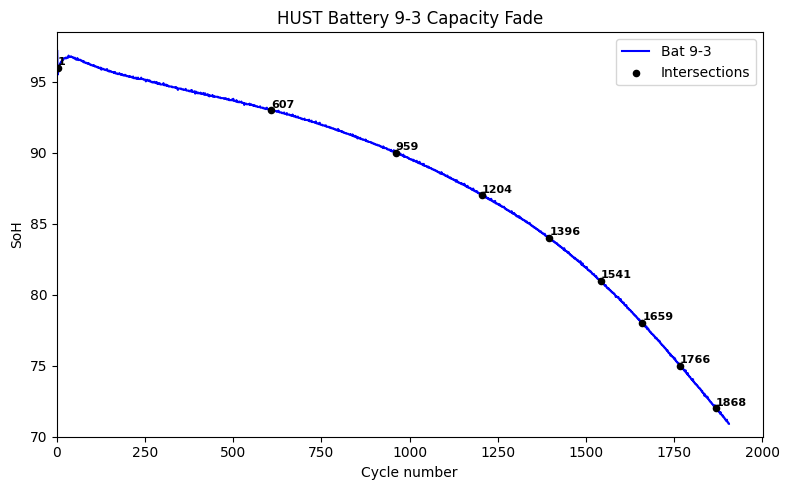

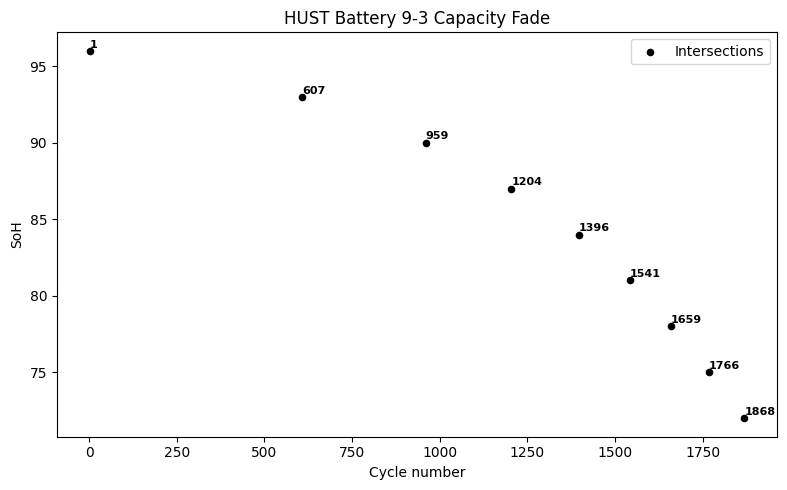

--------------------------------------------------------------------------------
6-2
1908


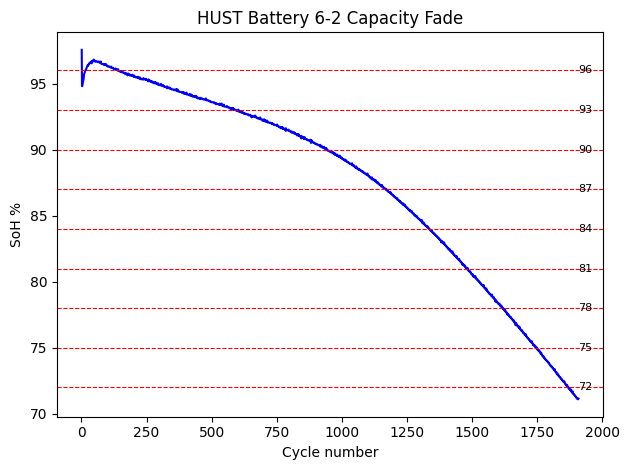

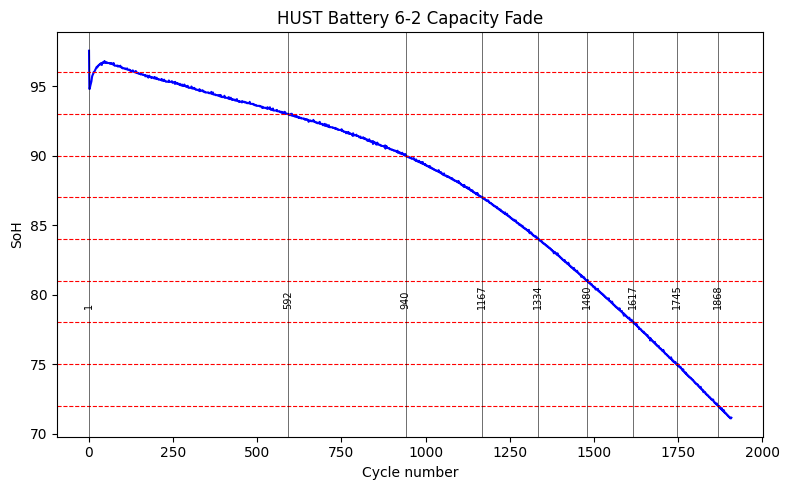

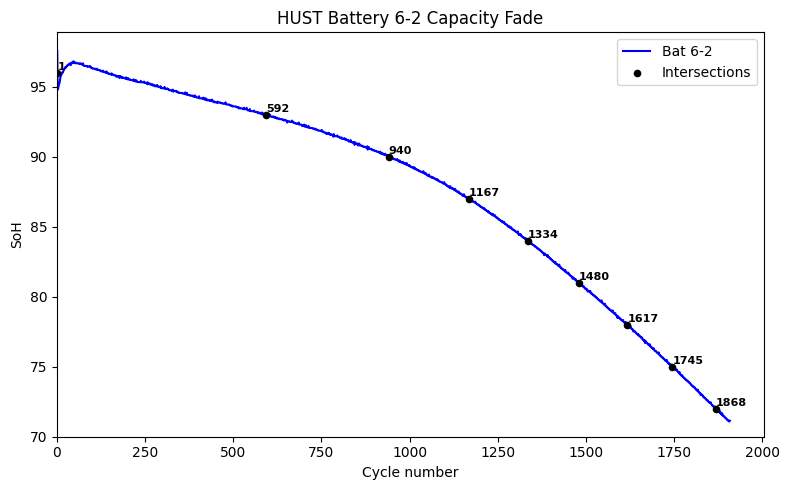

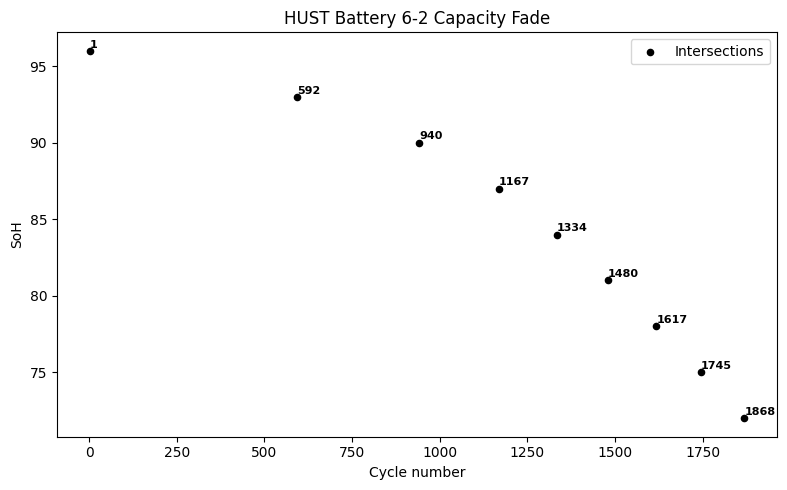

--------------------------------------------------------------------------------
5-2
1926


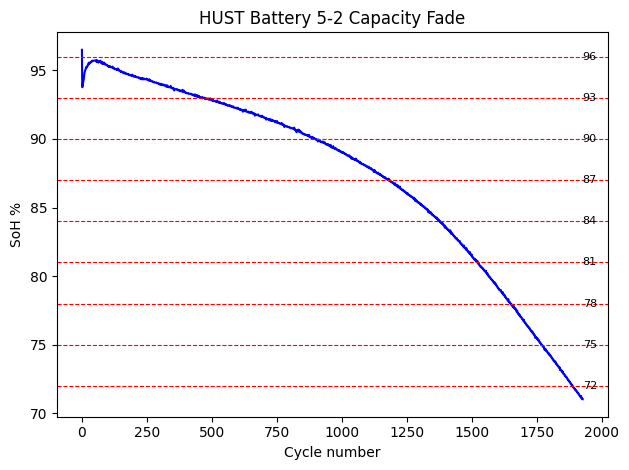

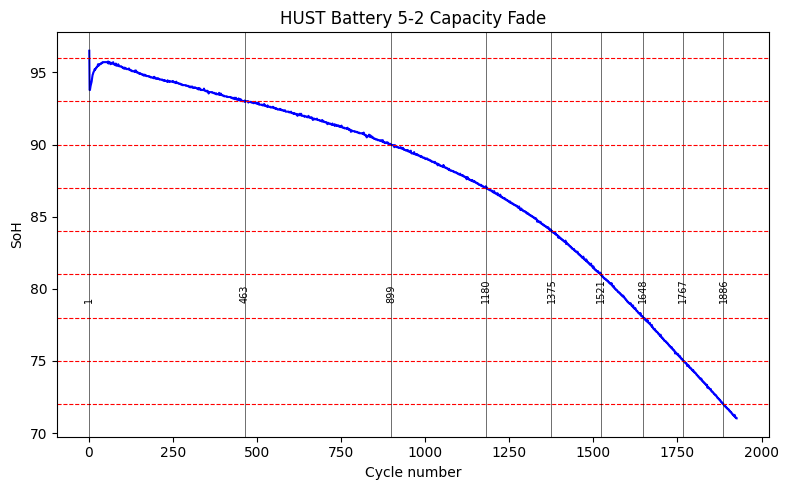

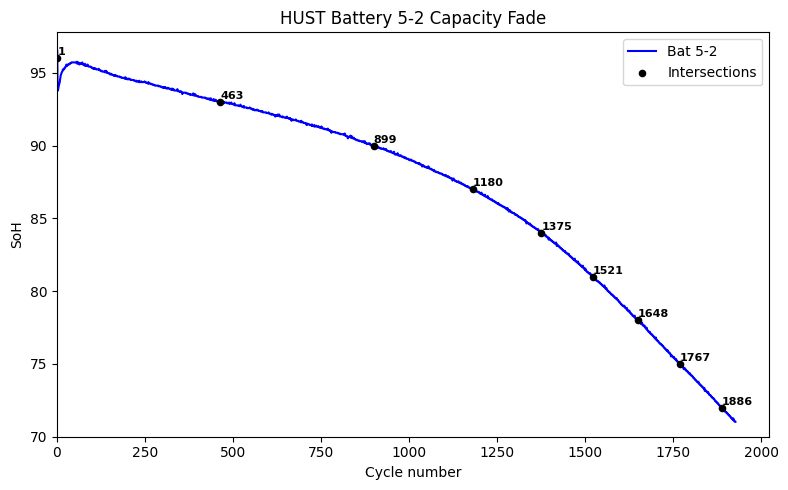

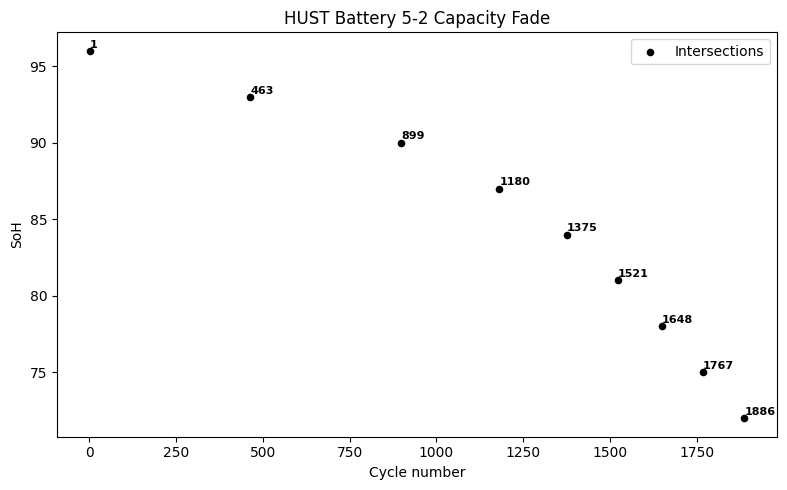

--------------------------------------------------------------------------------
3-1
1938


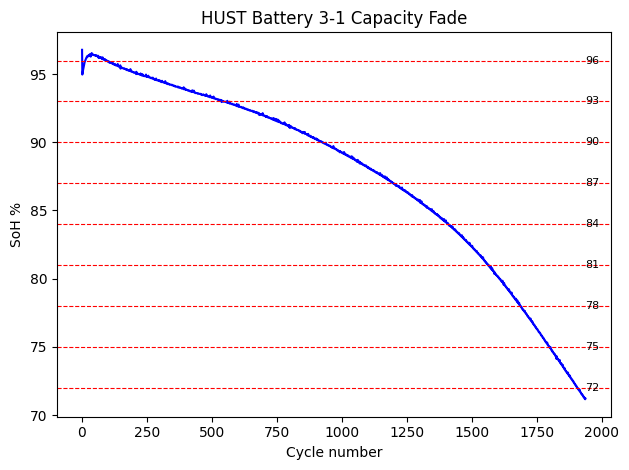

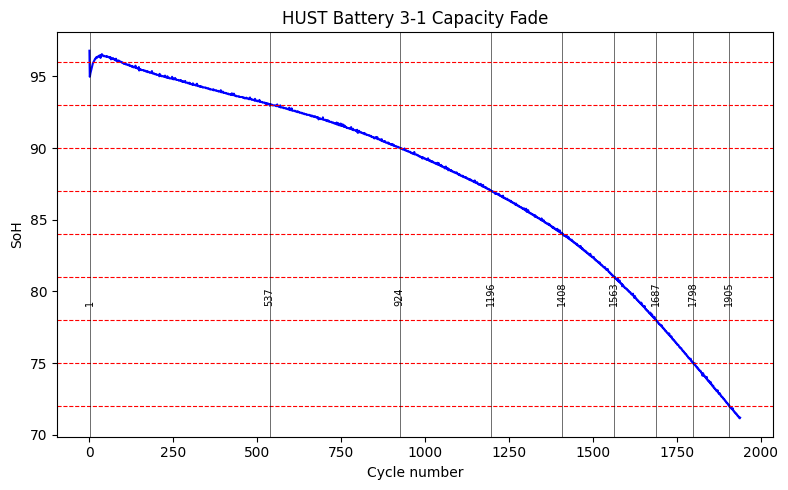

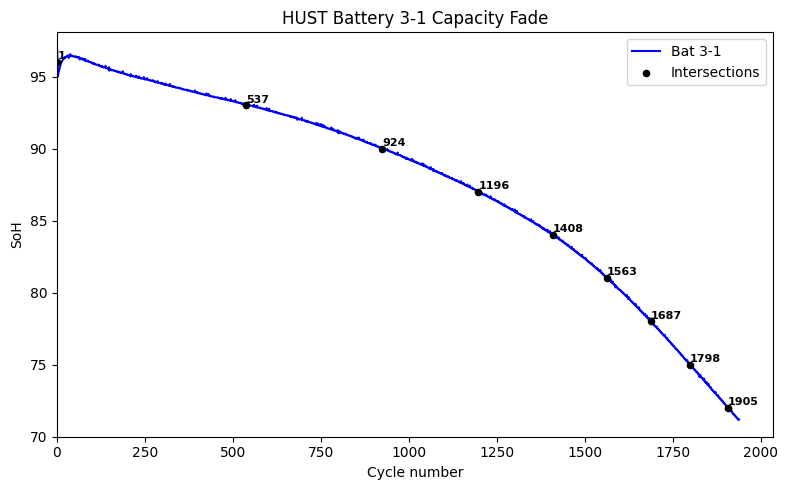

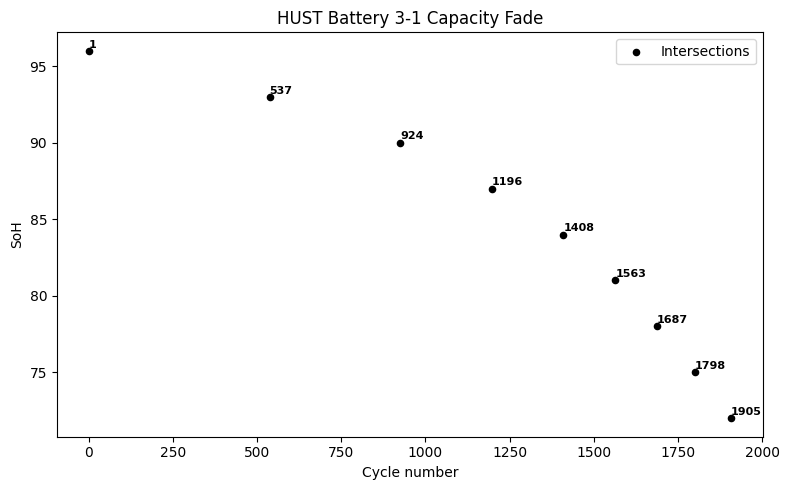

--------------------------------------------------------------------------------
7-8
1938


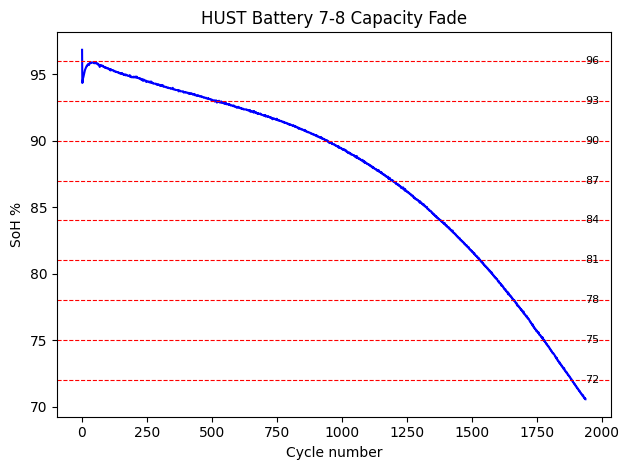

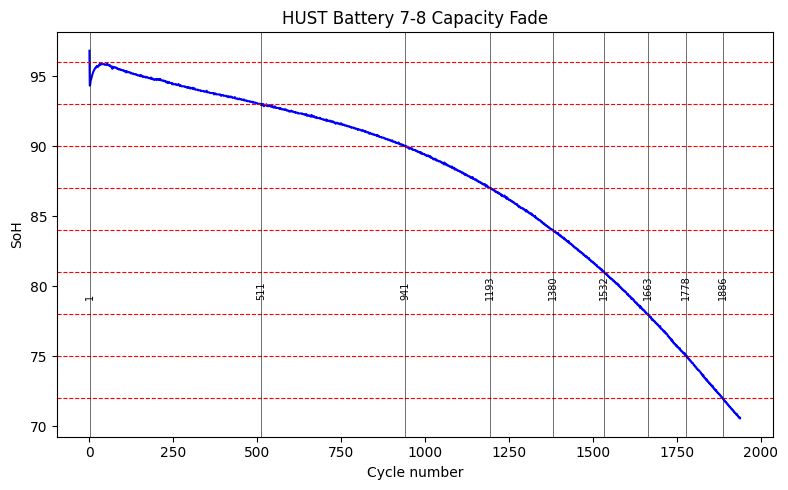

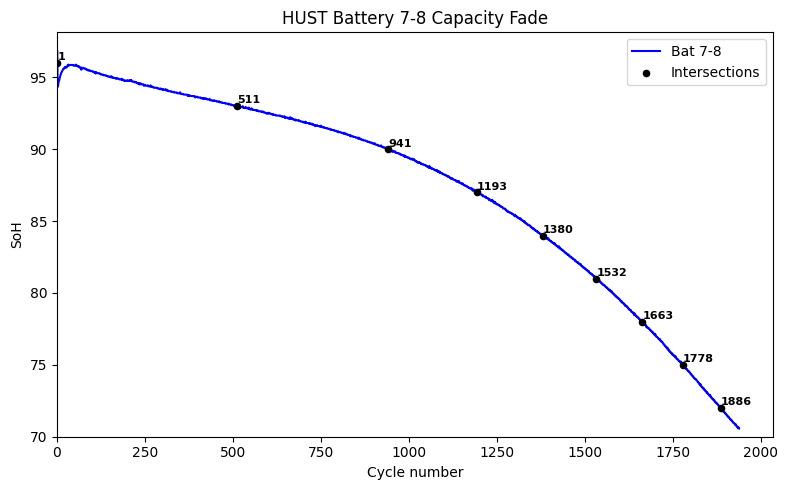

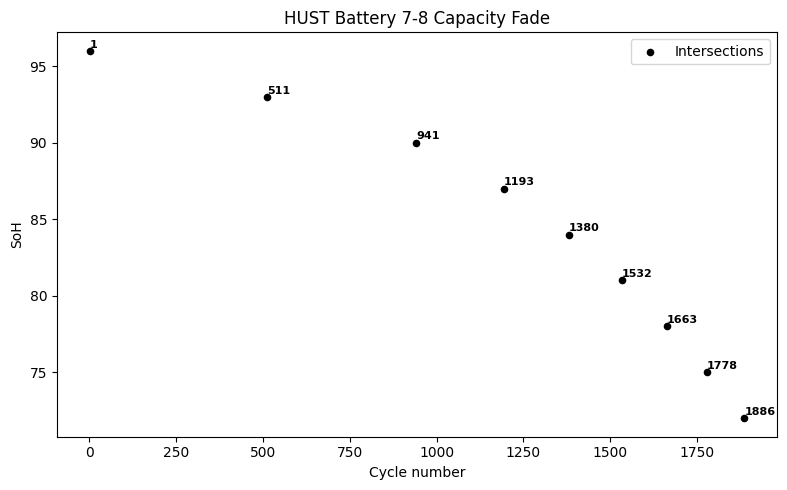

--------------------------------------------------------------------------------
5-4
1962


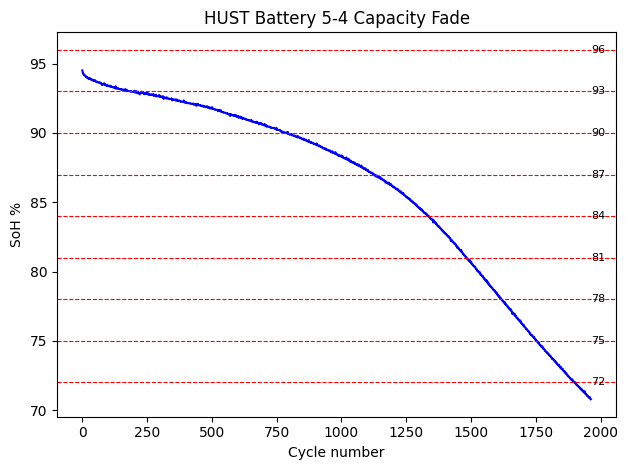

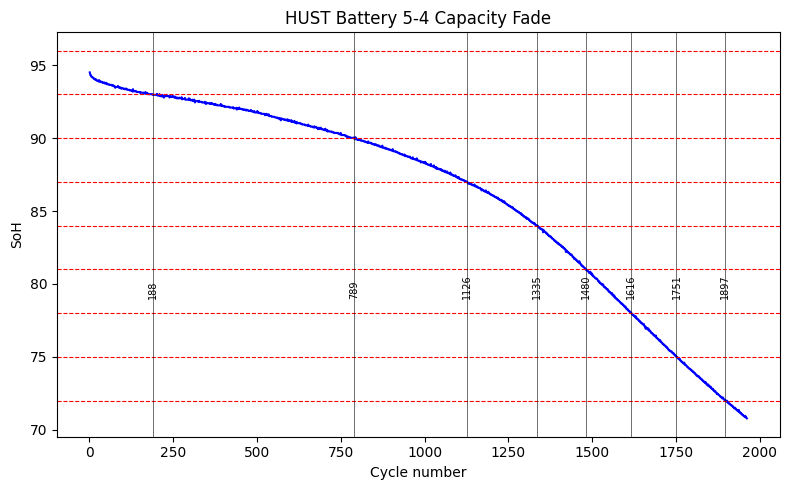

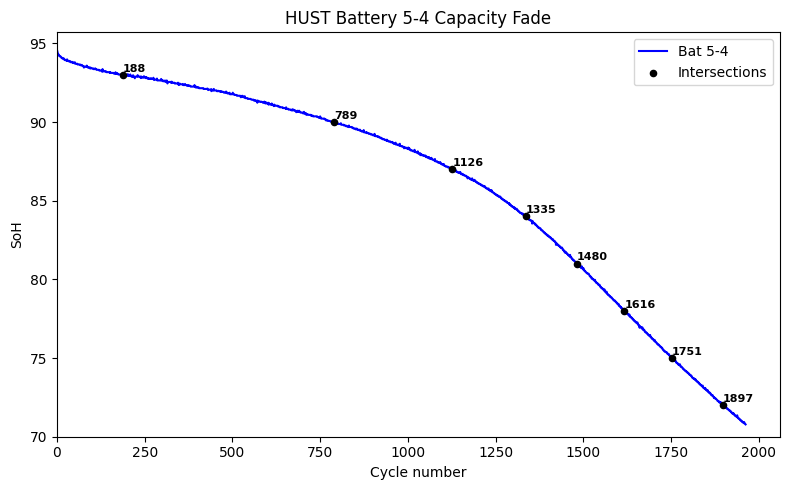

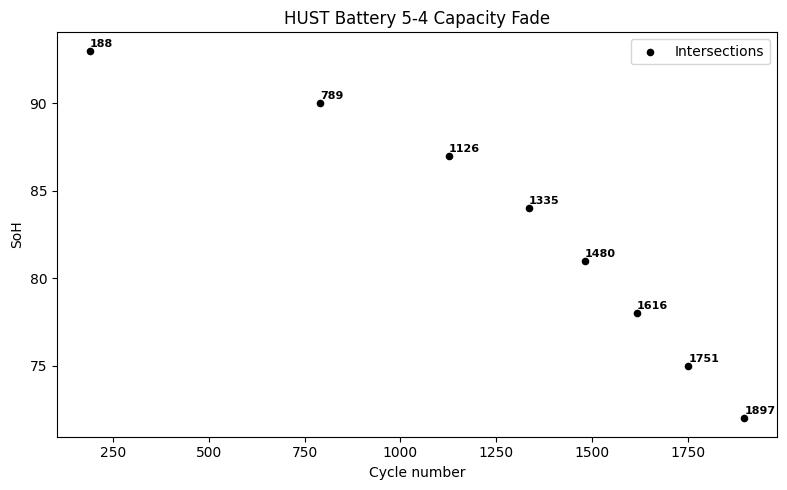

--------------------------------------------------------------------------------
1-5
1971


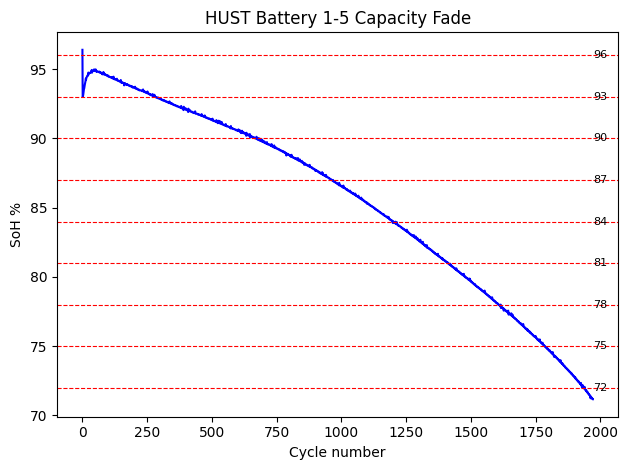

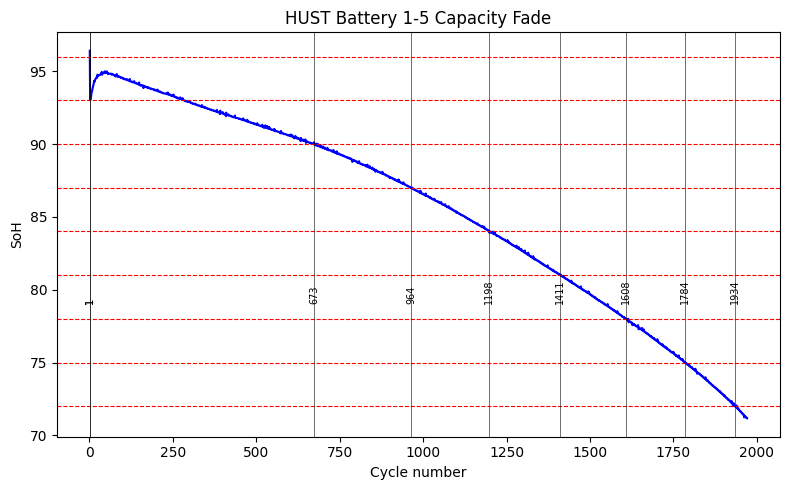

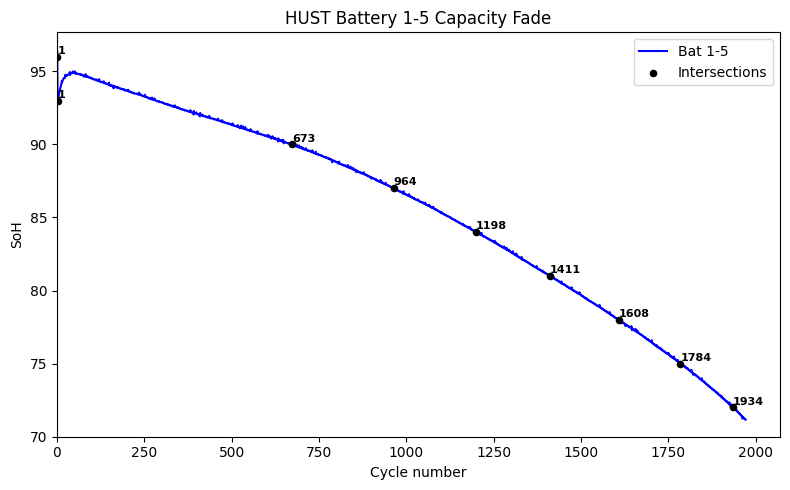

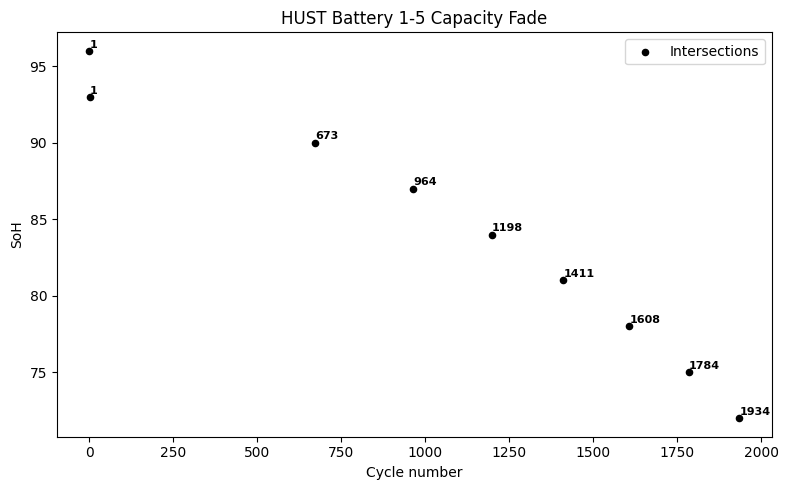

--------------------------------------------------------------------------------
9-4
1975


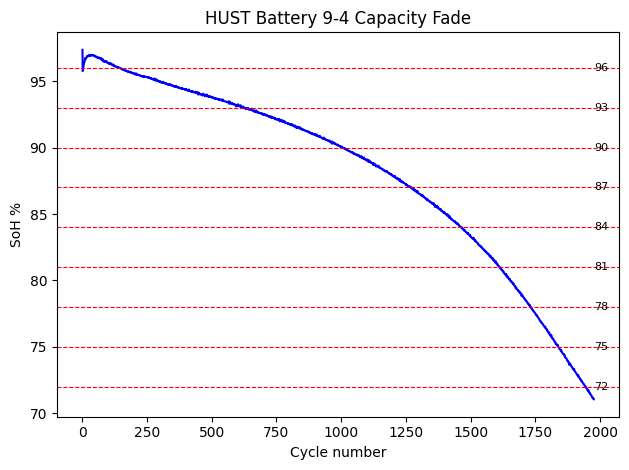

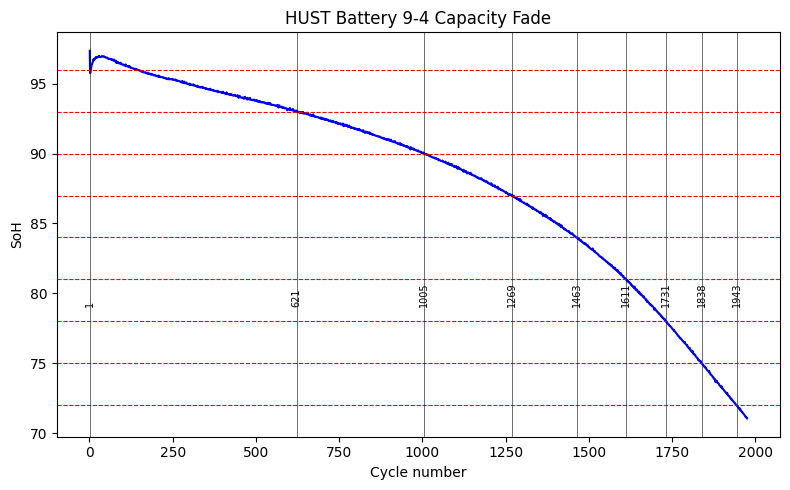

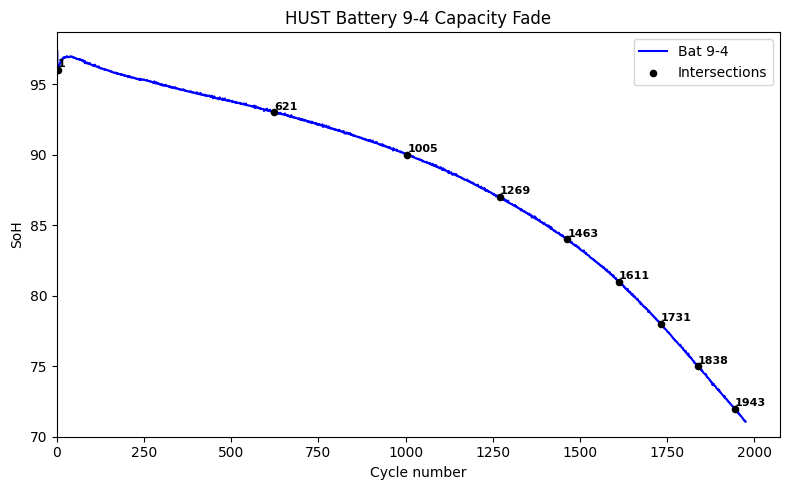

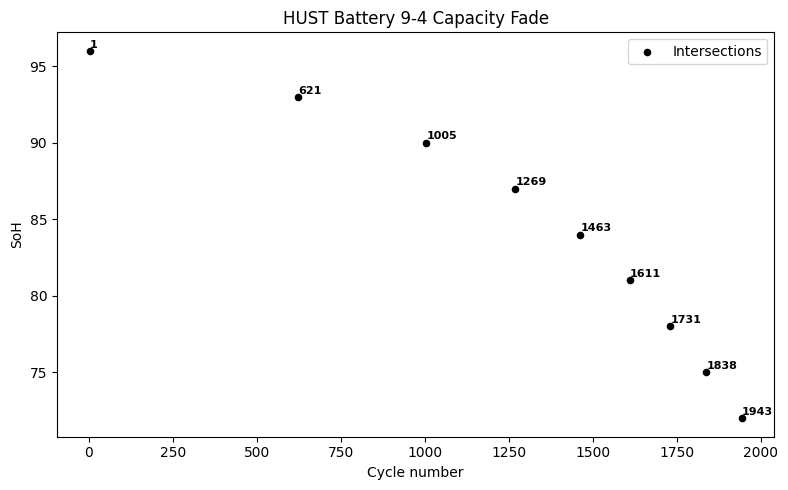

--------------------------------------------------------------------------------
9-7
2012


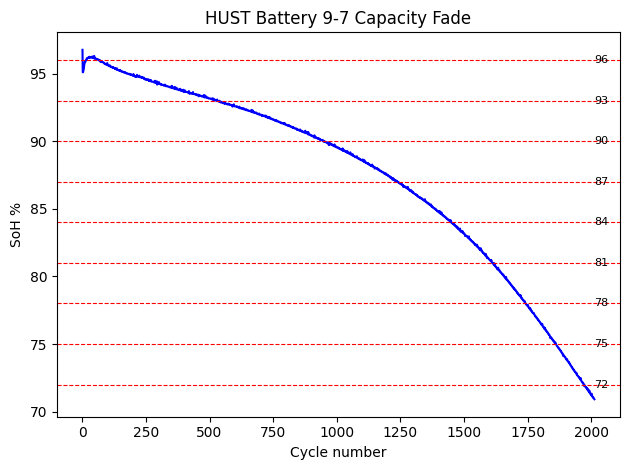

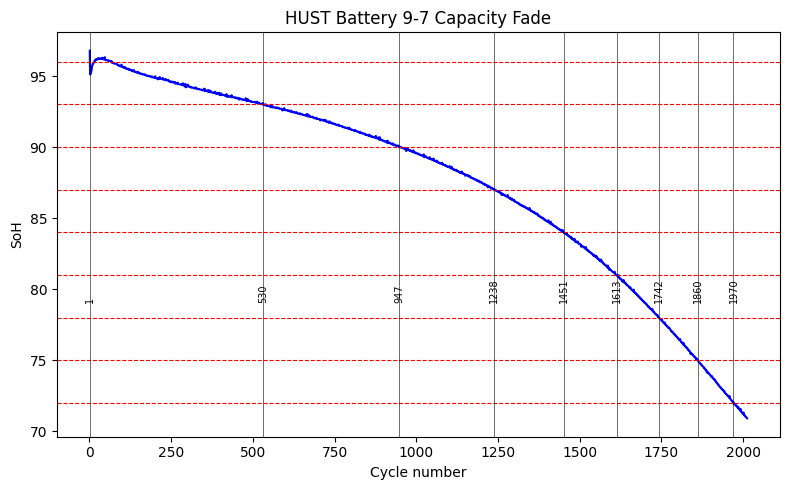

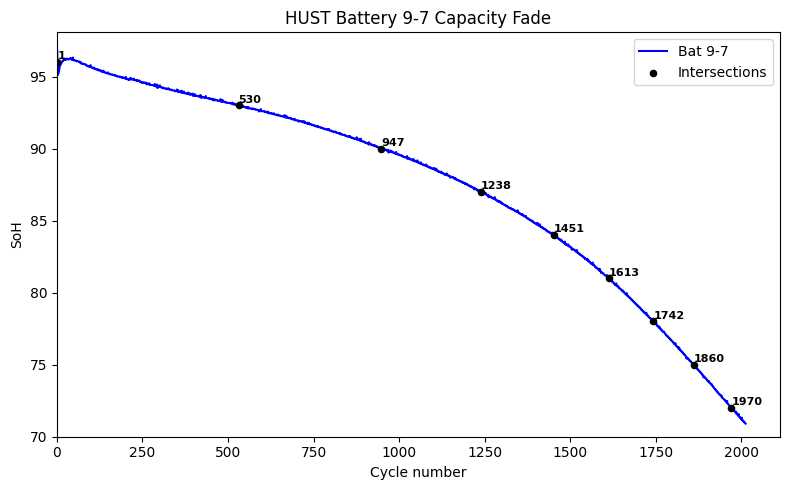

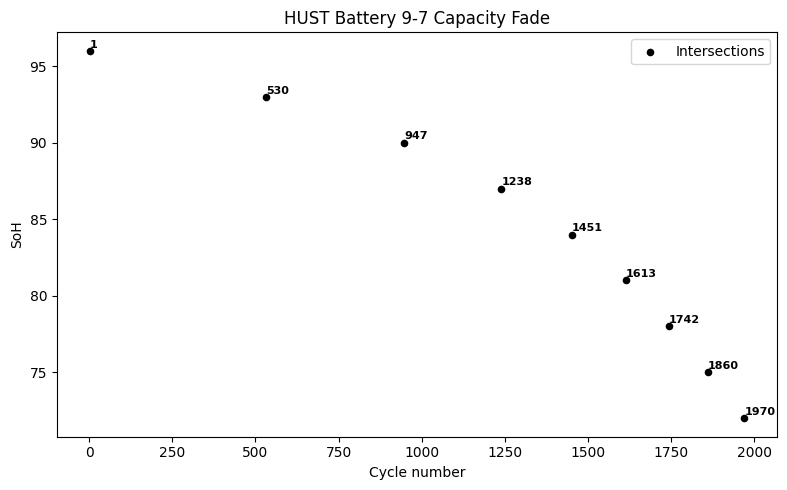

--------------------------------------------------------------------------------
10-5
2030


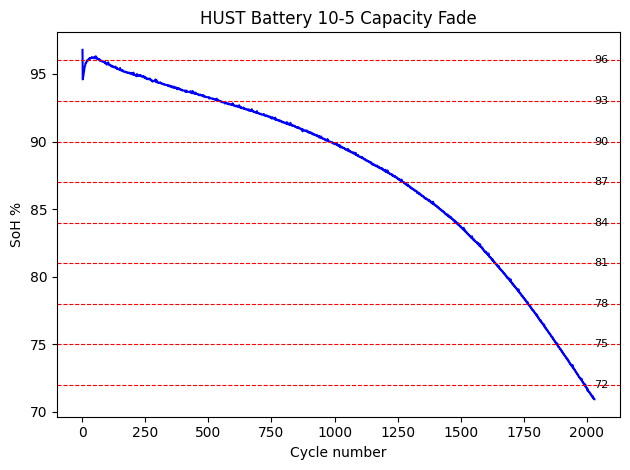

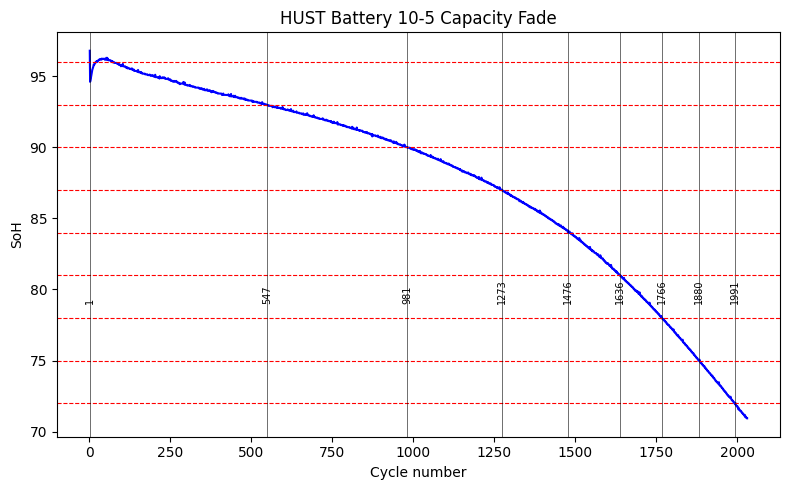

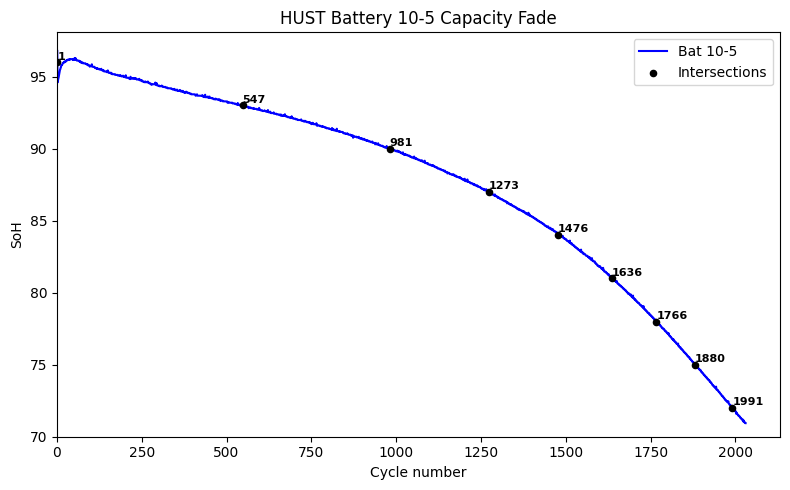

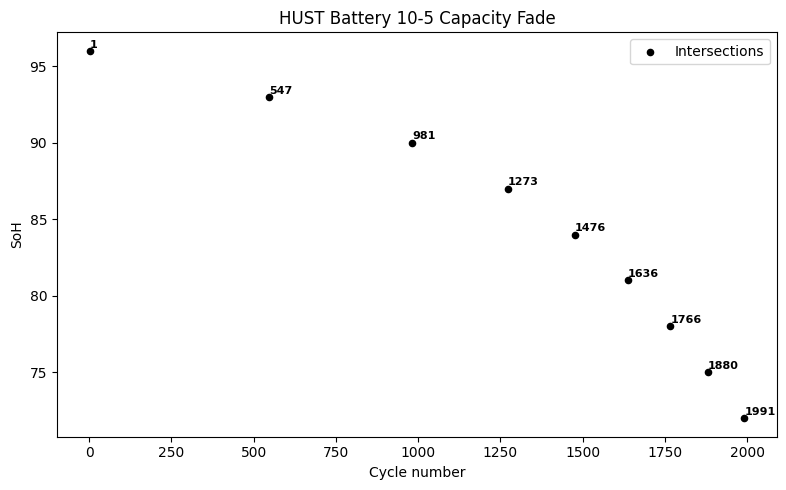

--------------------------------------------------------------------------------
7-2
2030


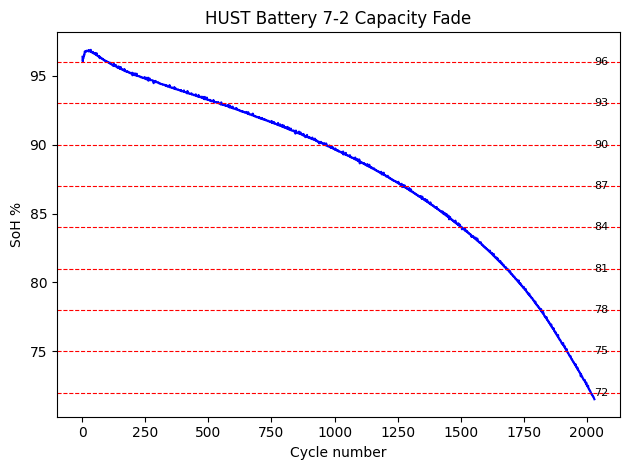

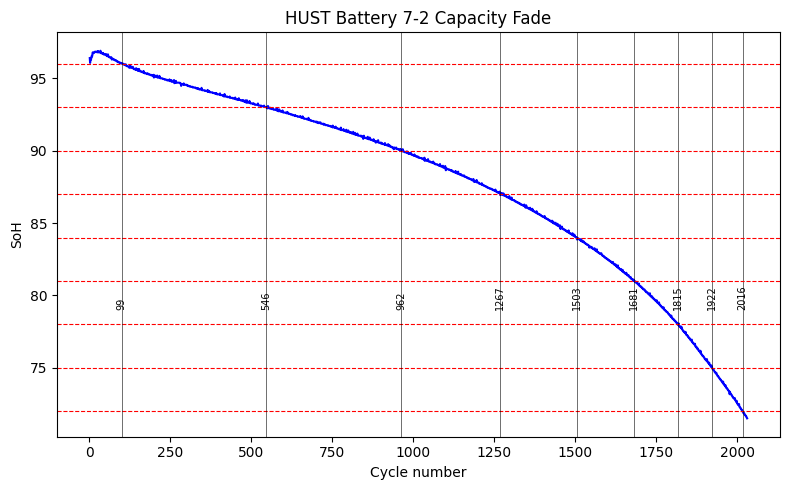

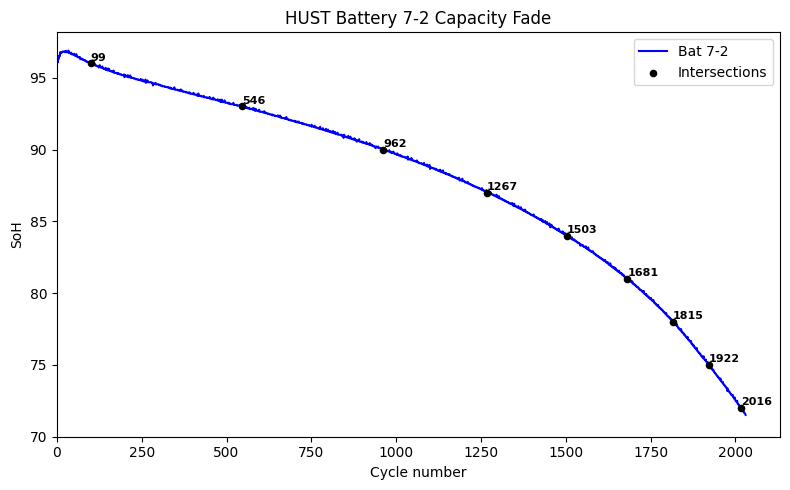

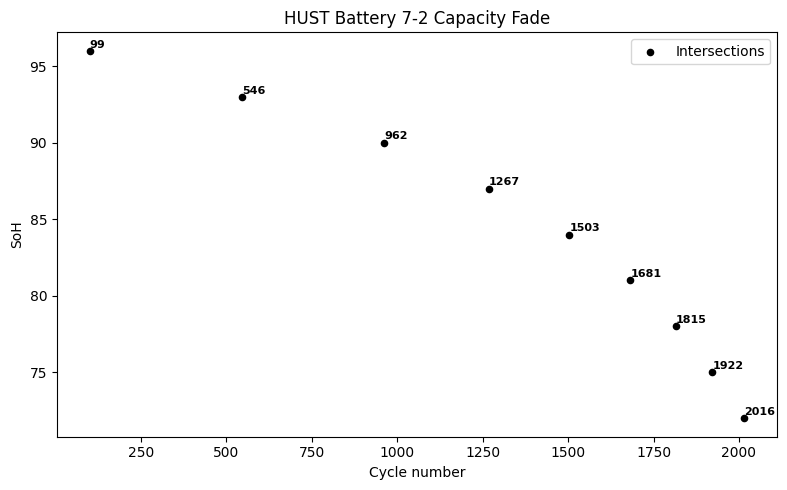

--------------------------------------------------------------------------------
8-2
2041


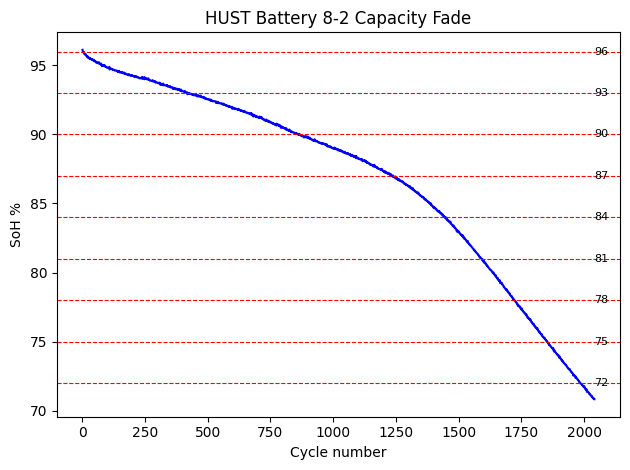

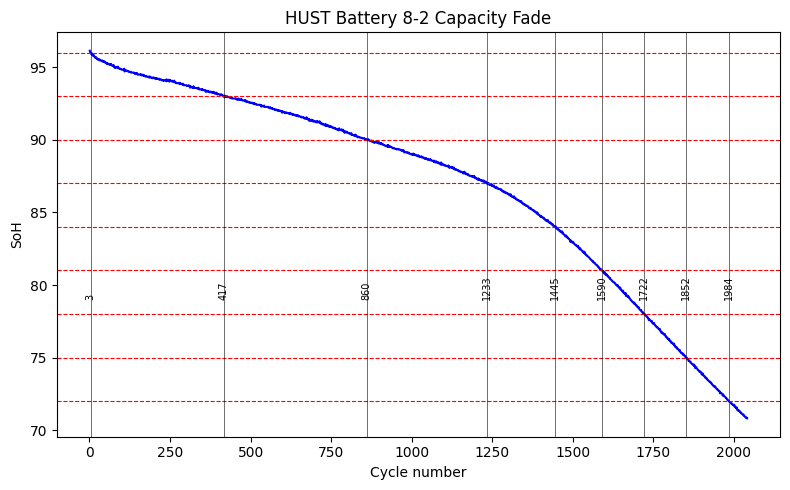

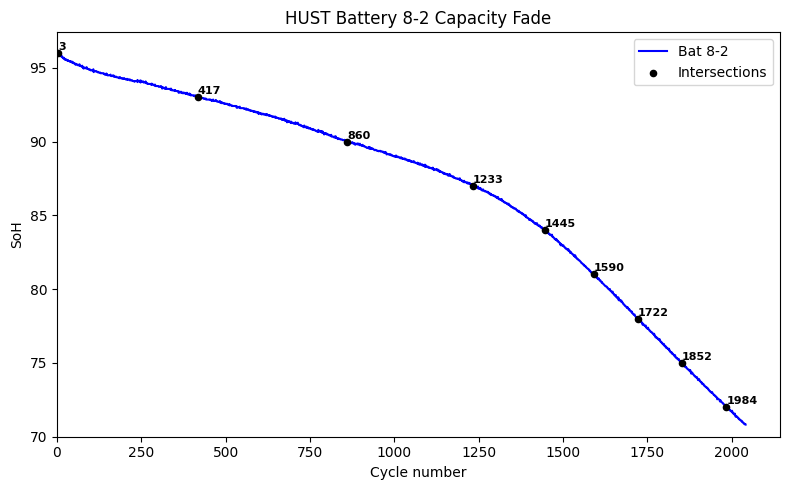

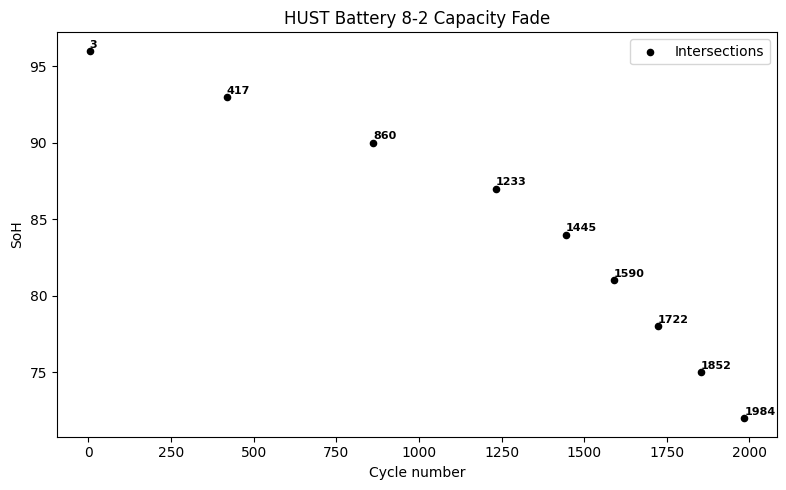

--------------------------------------------------------------------------------
8-7
2047


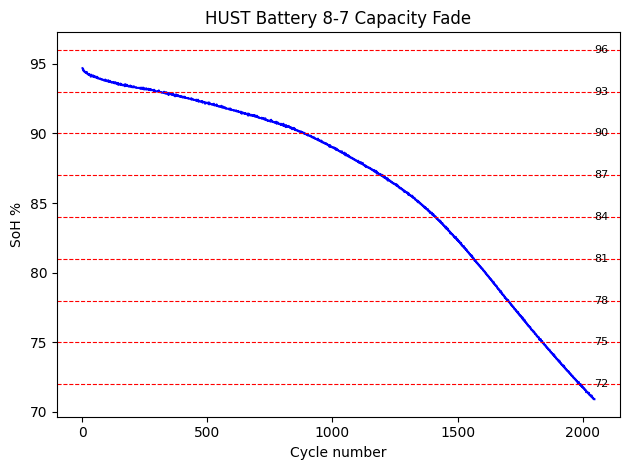

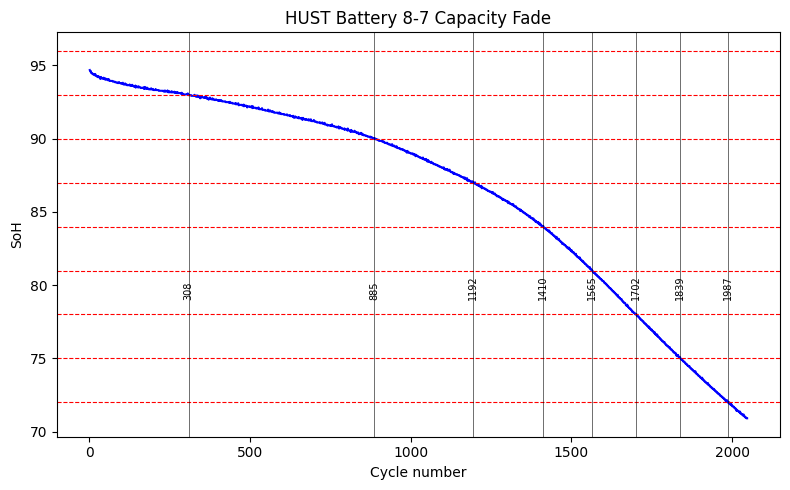

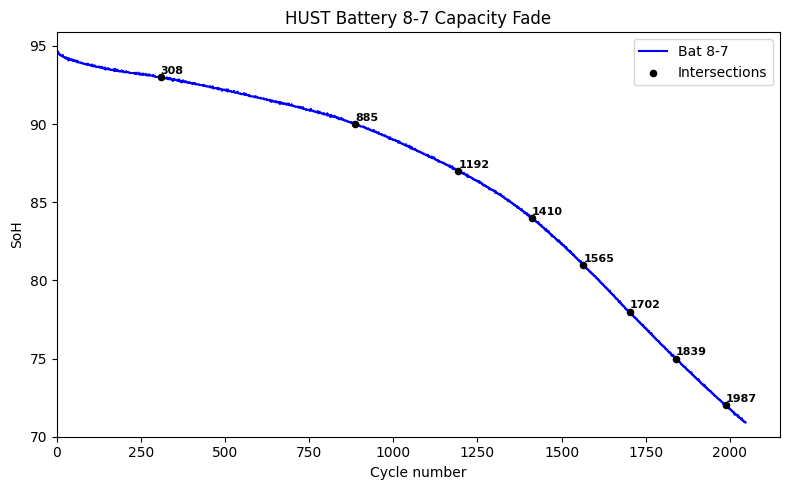

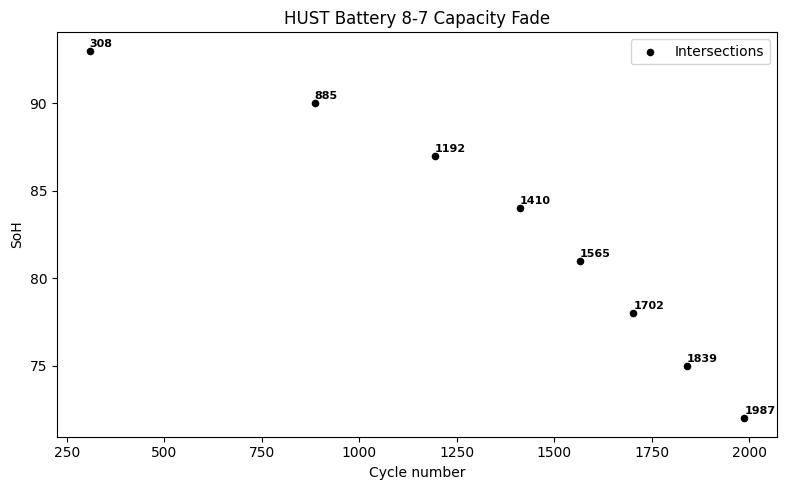

--------------------------------------------------------------------------------
9-1
2057


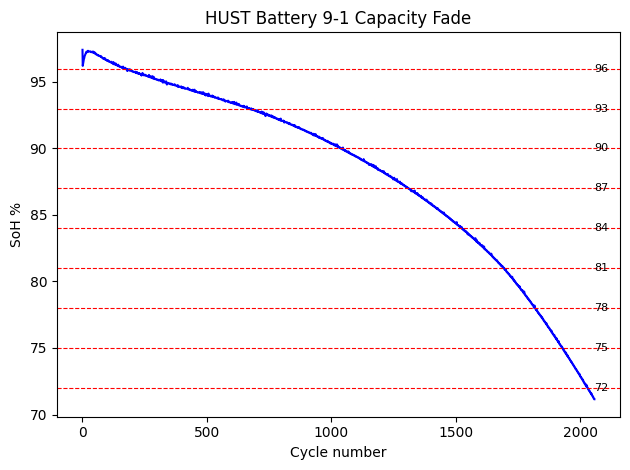

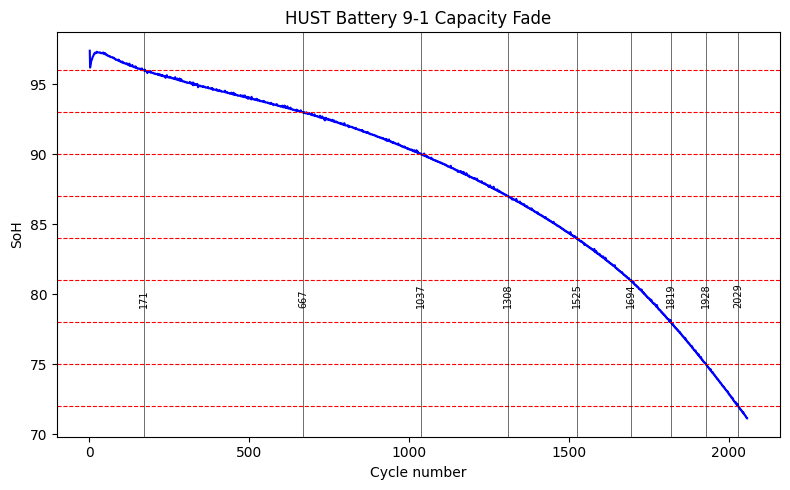

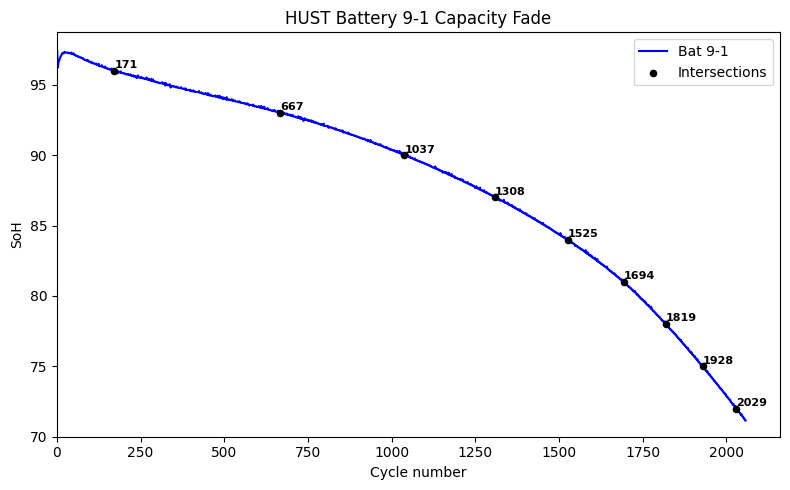

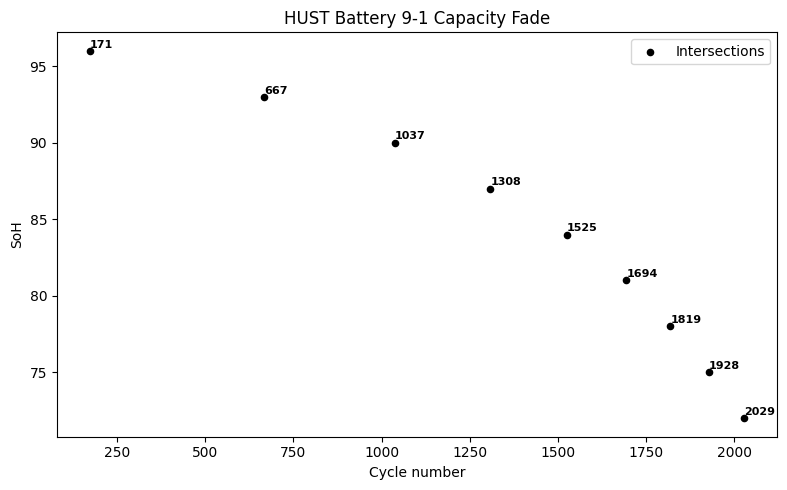

--------------------------------------------------------------------------------
9-2
2143


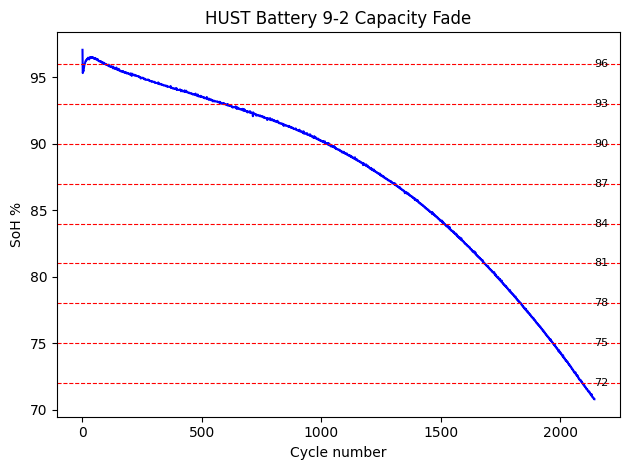

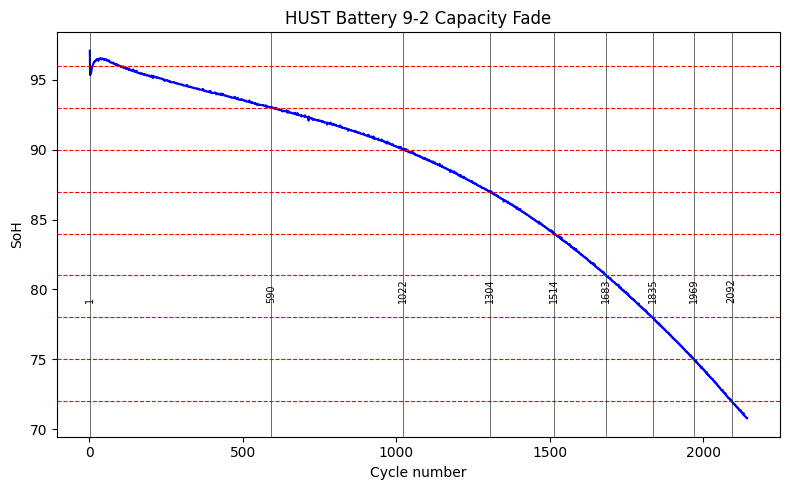

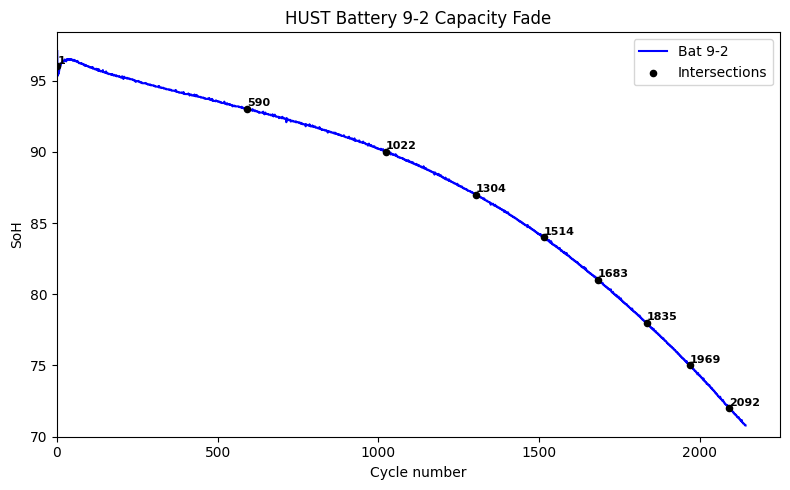

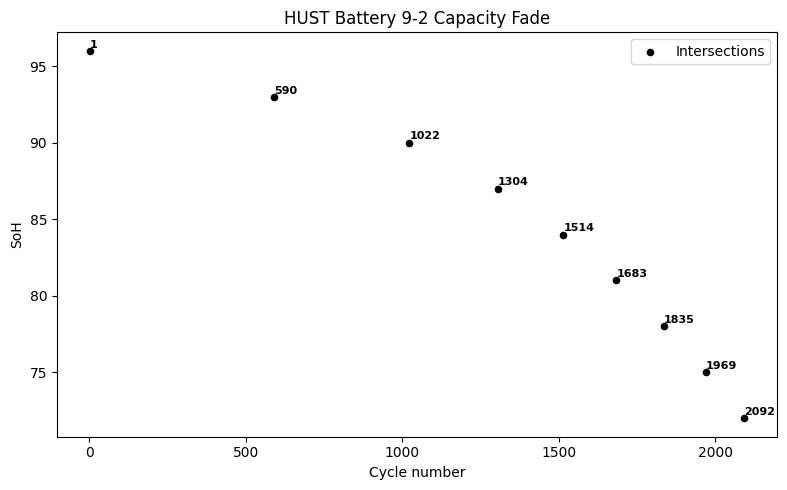

--------------------------------------------------------------------------------
9-5
2168


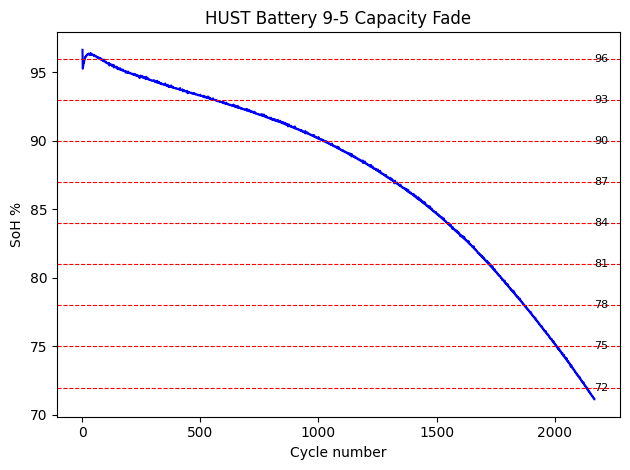

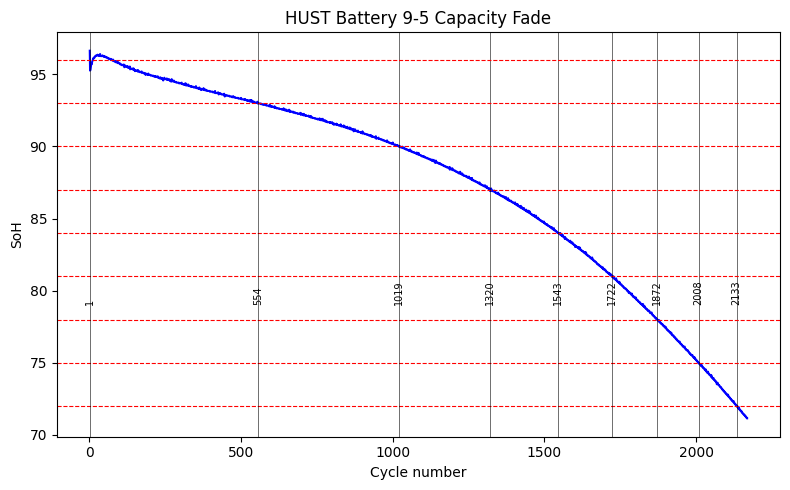

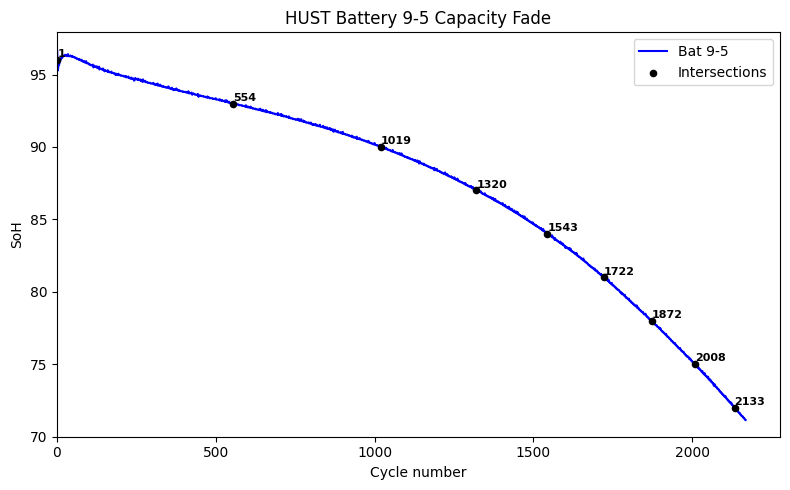

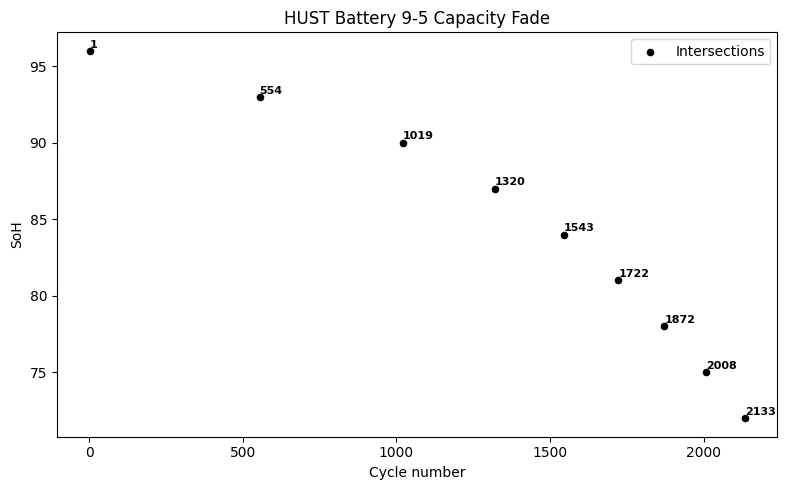

--------------------------------------------------------------------------------
6-5
2178


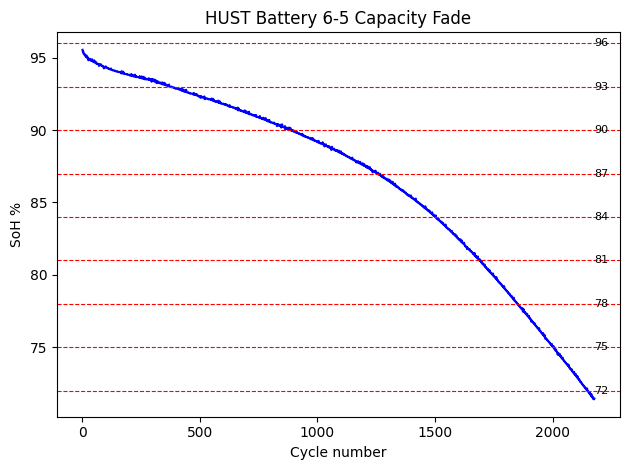

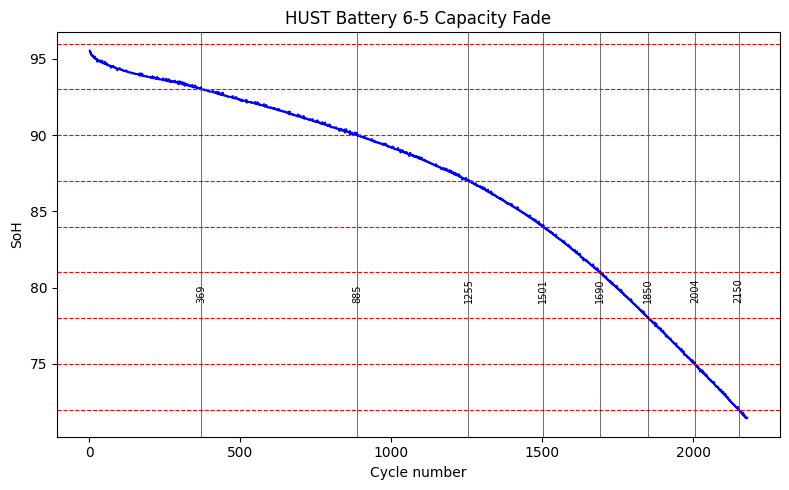

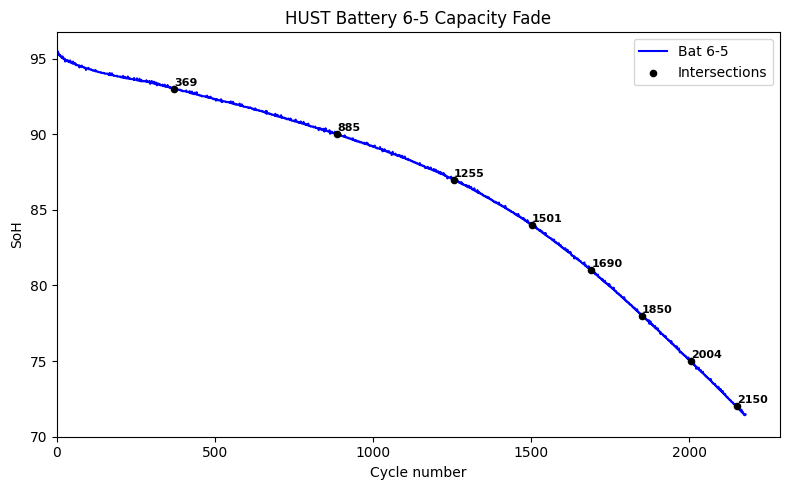

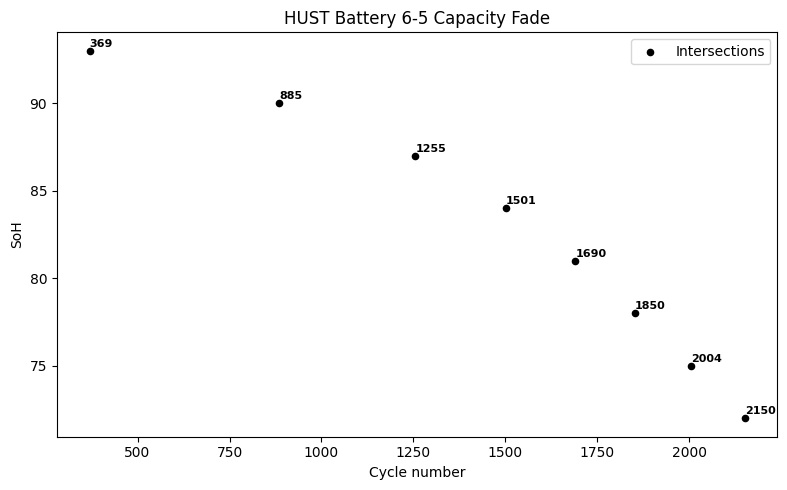

--------------------------------------------------------------------------------
2-7
2202


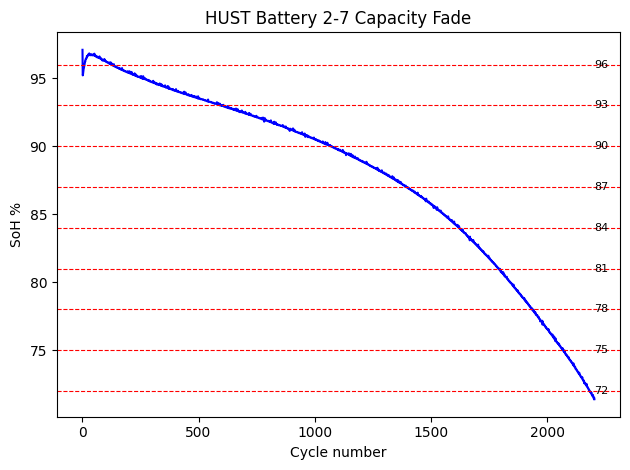

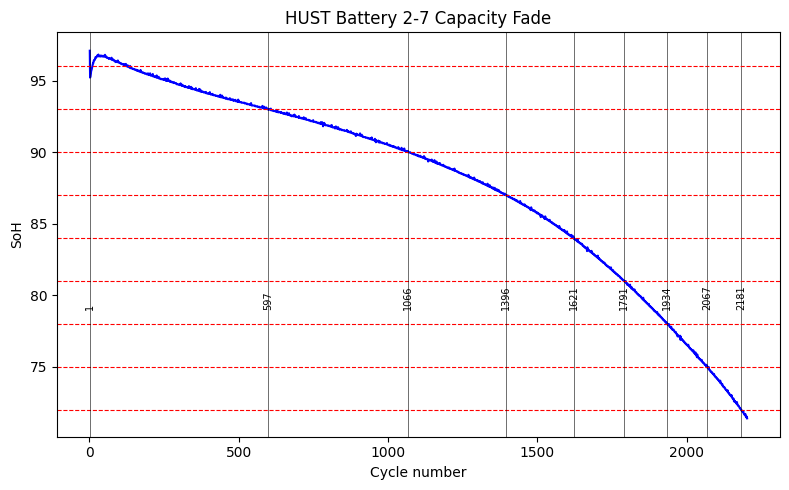

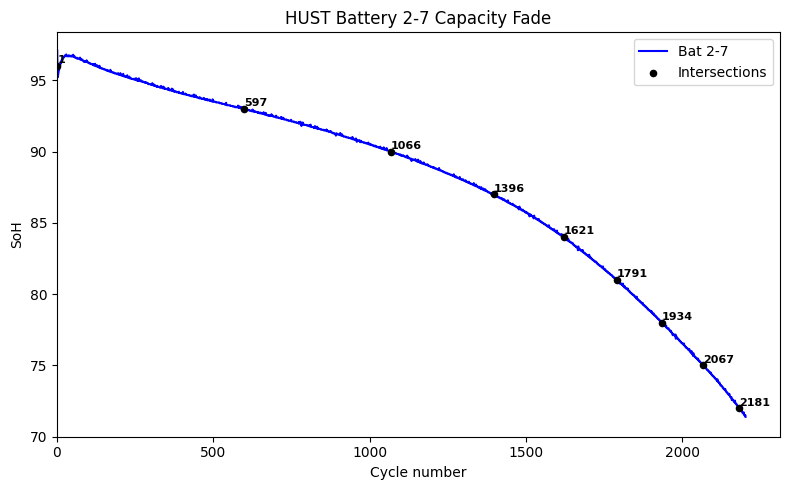

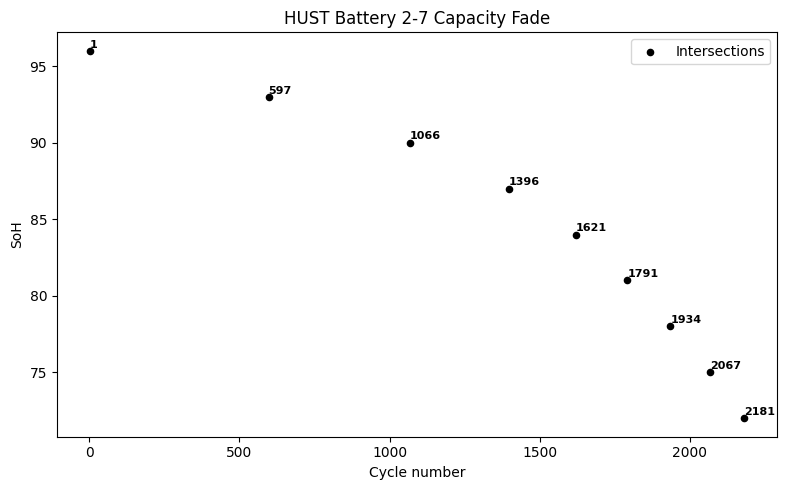

--------------------------------------------------------------------------------
4-7
2216


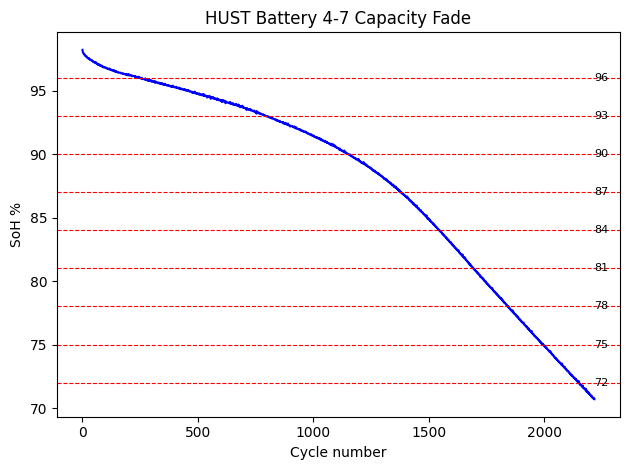

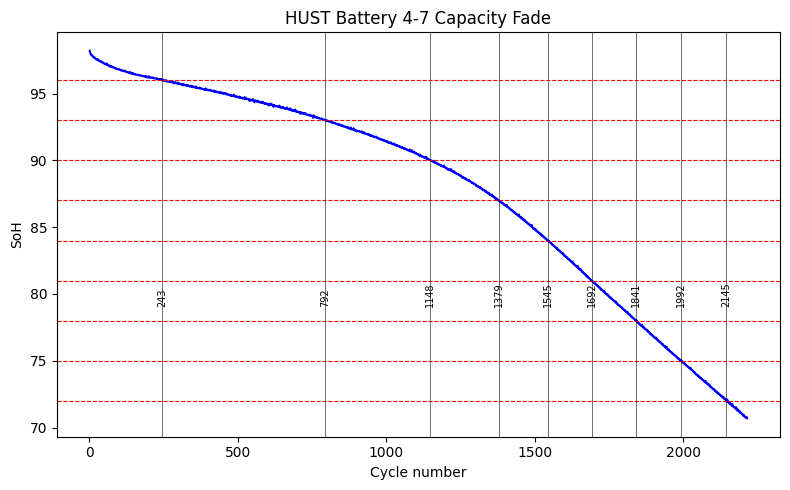

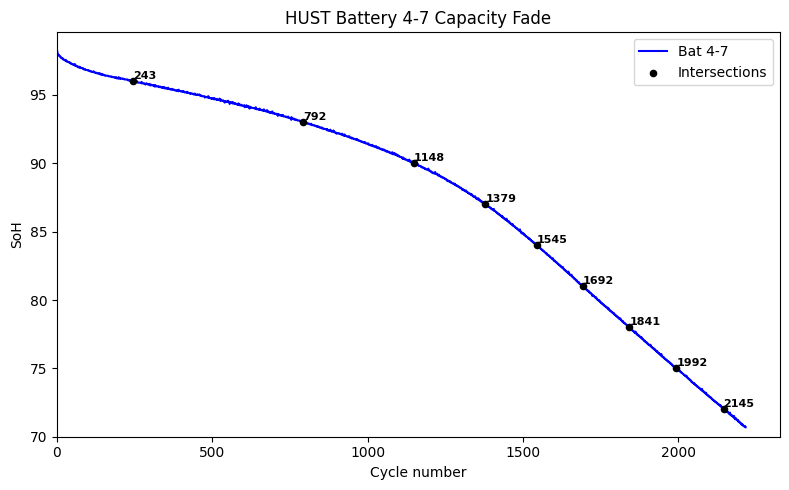

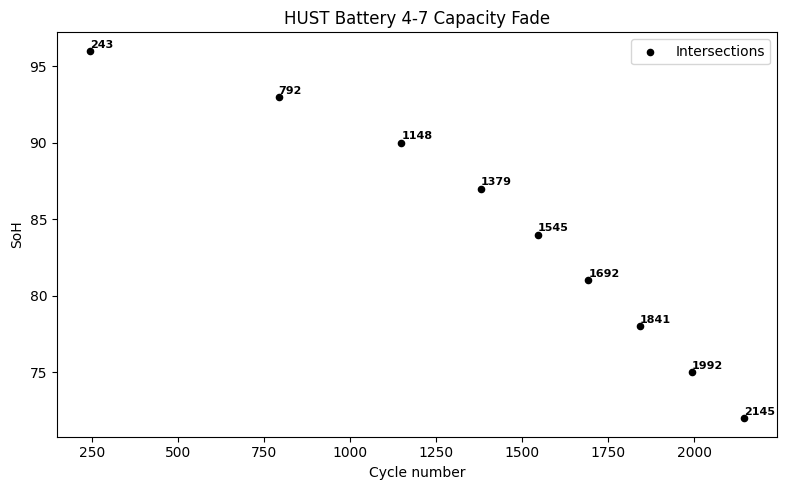

--------------------------------------------------------------------------------
4-1
2217


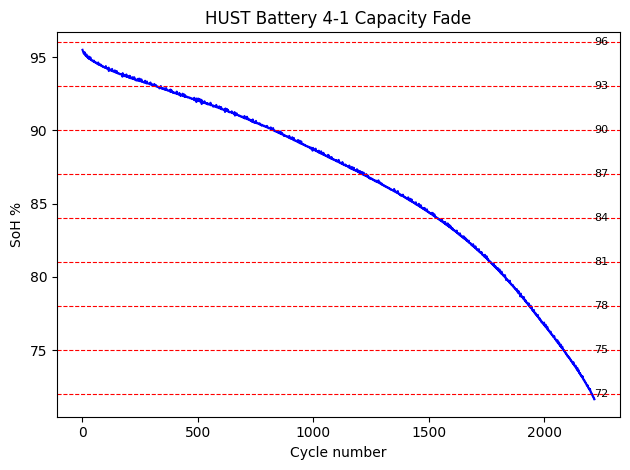

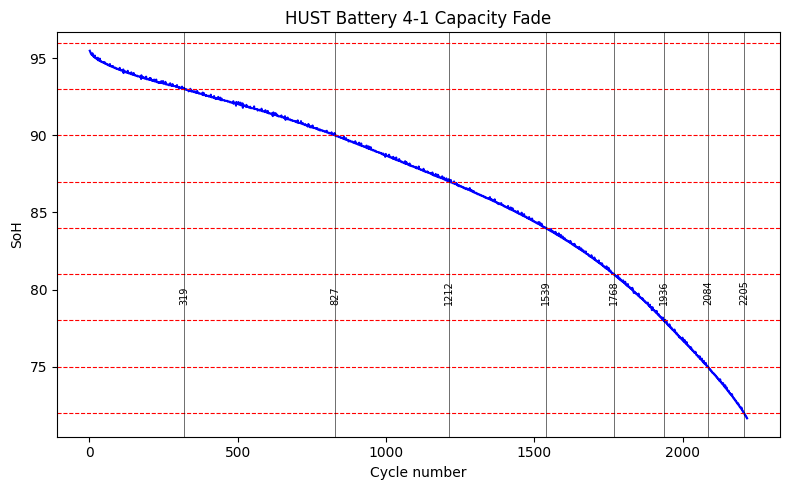

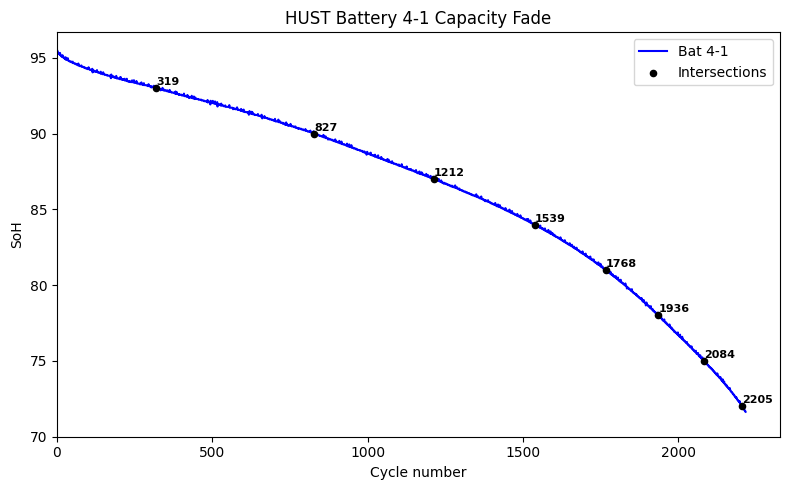

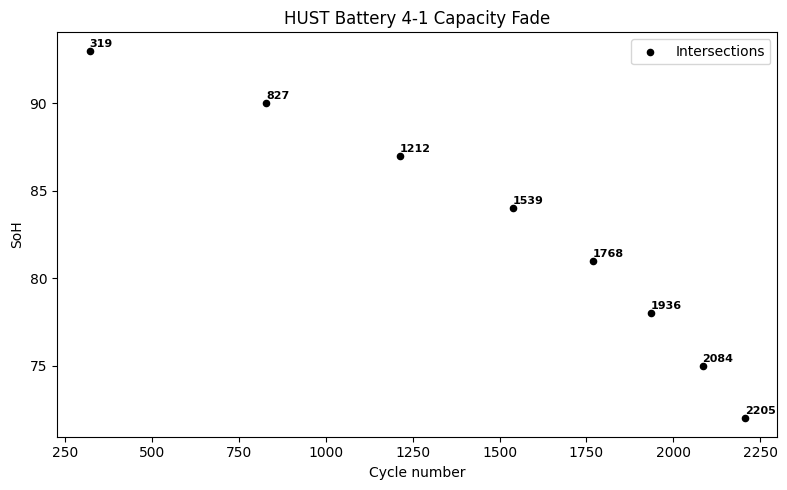

--------------------------------------------------------------------------------
3-2
2283


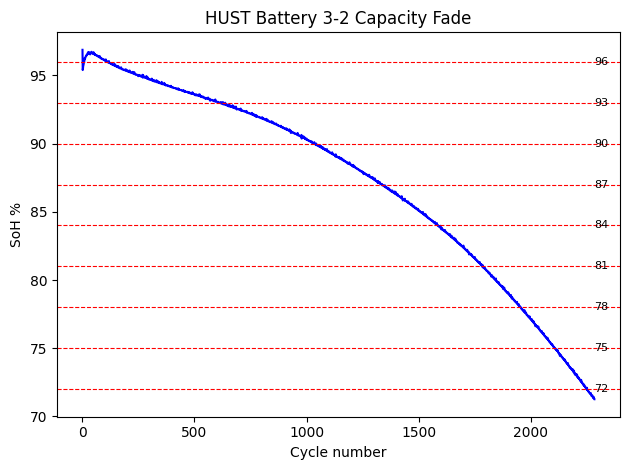

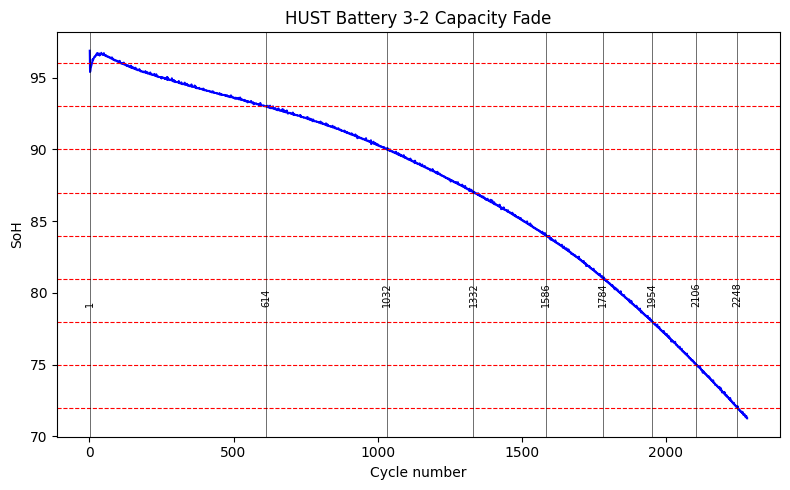

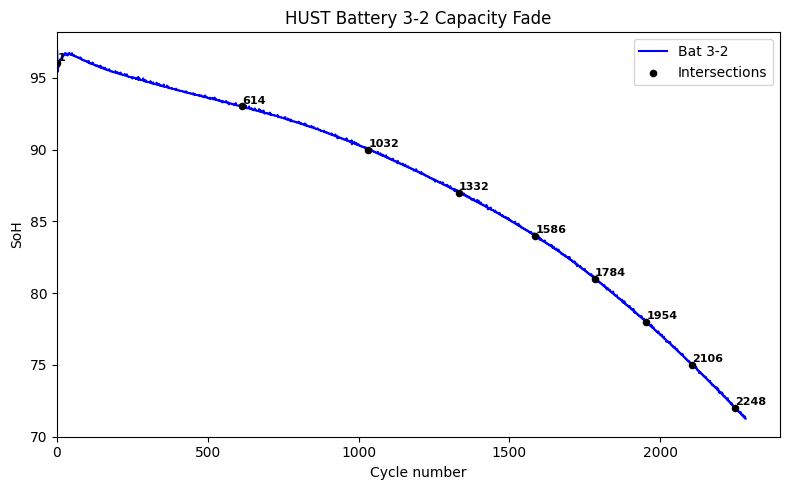

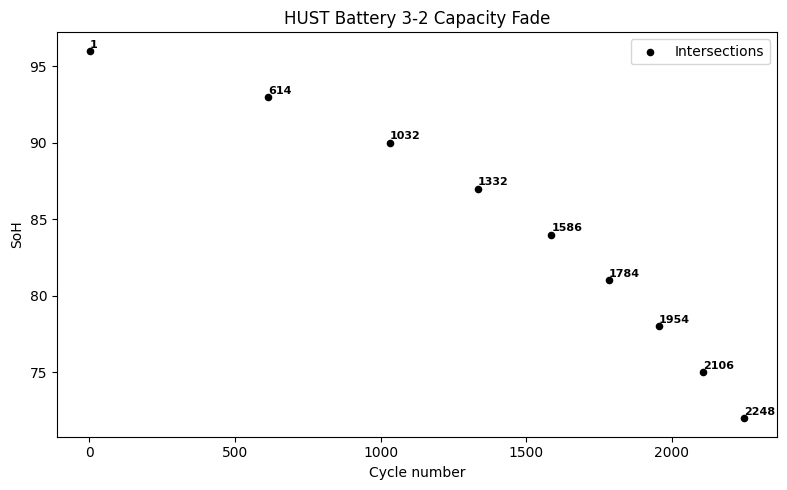

--------------------------------------------------------------------------------
10-6
2285


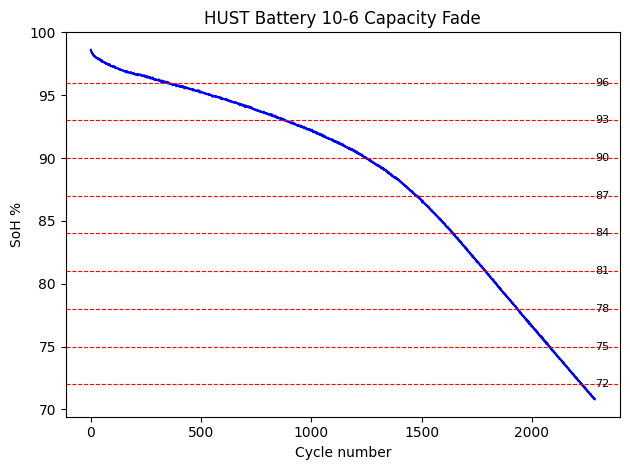

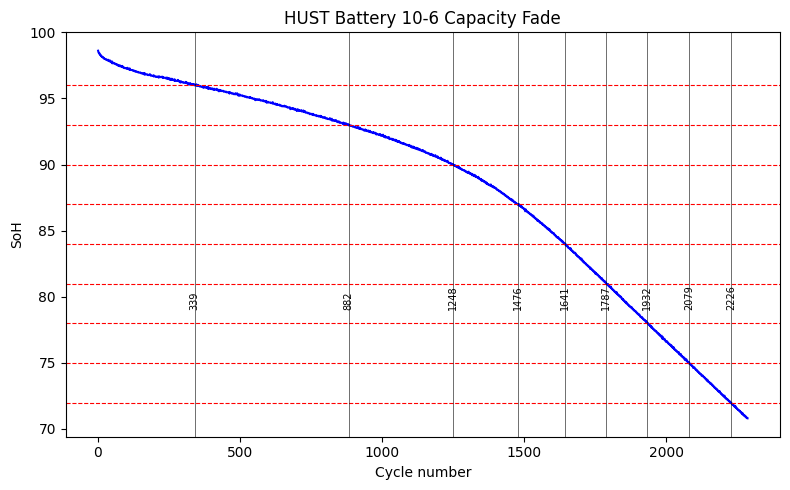

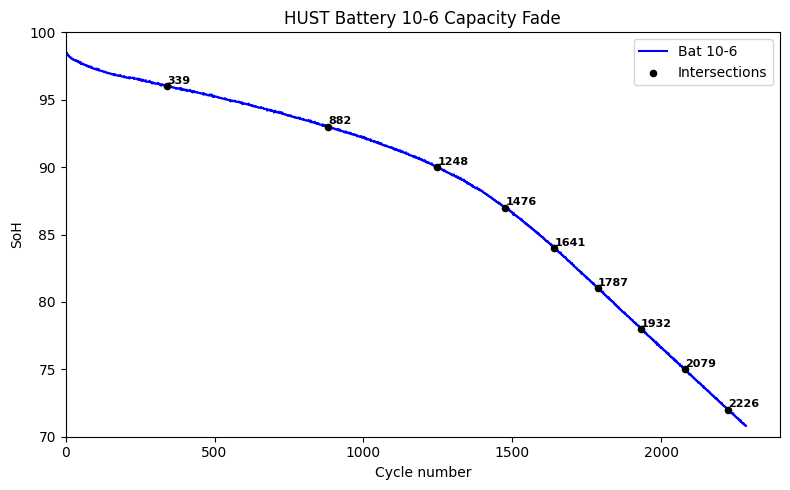

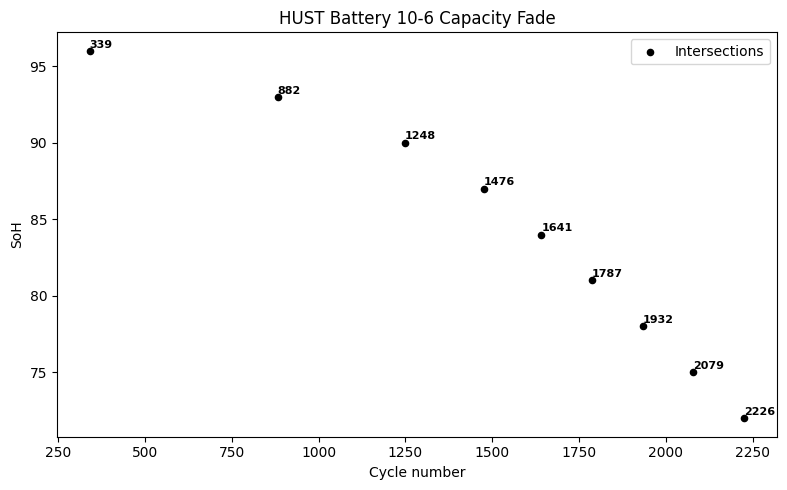

--------------------------------------------------------------------------------
1-8
2285


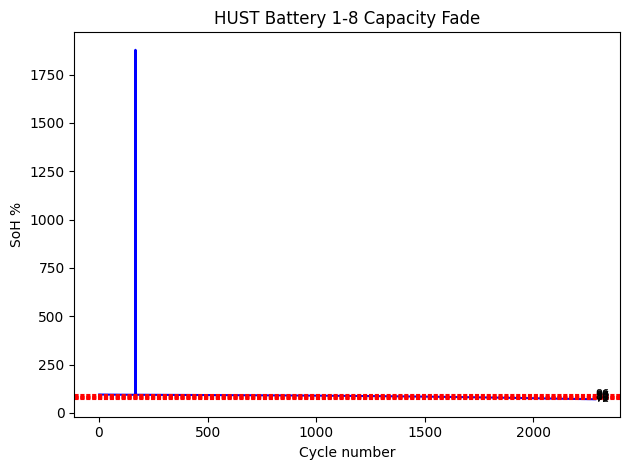

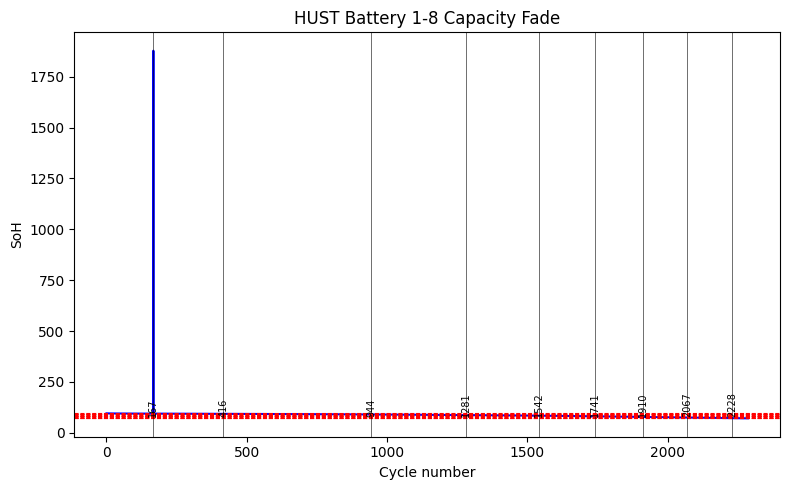

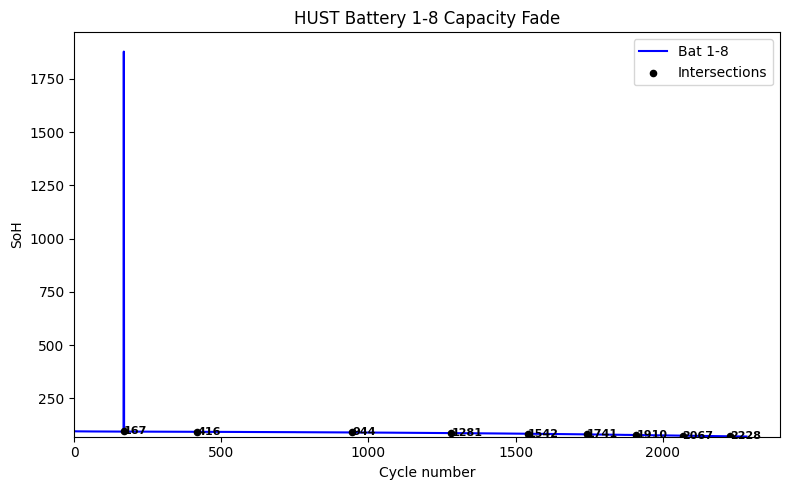

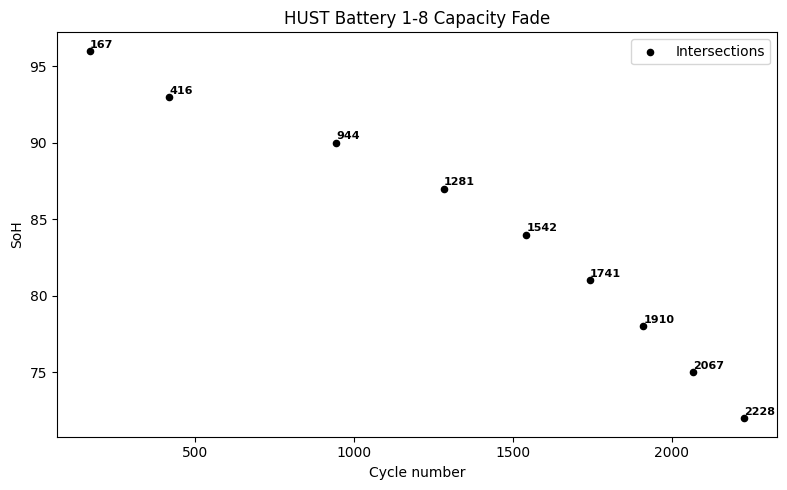

--------------------------------------------------------------------------------
8-3
2290


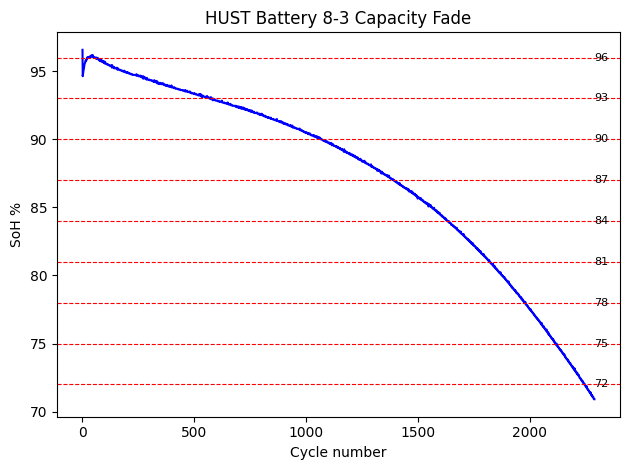

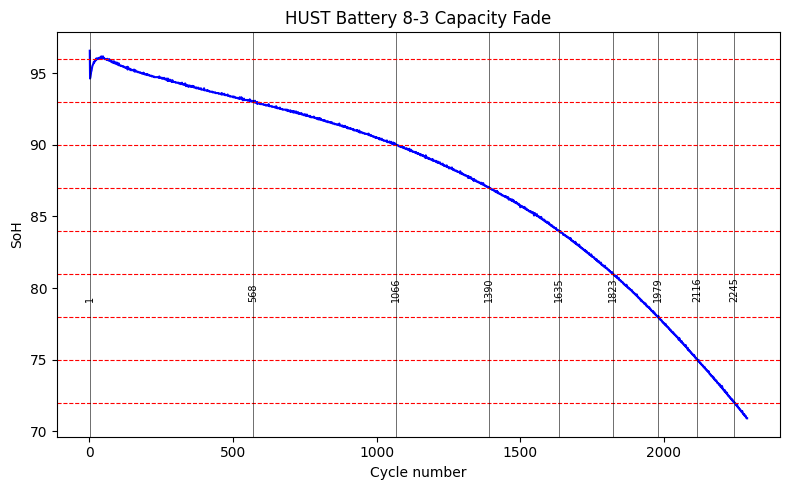

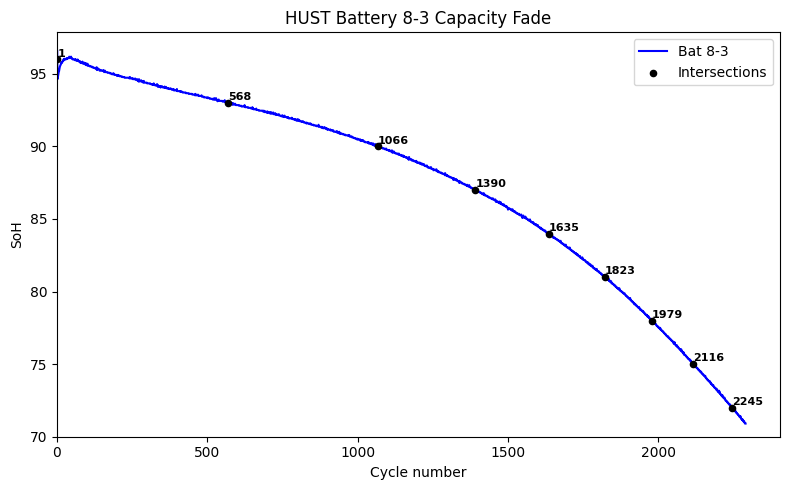

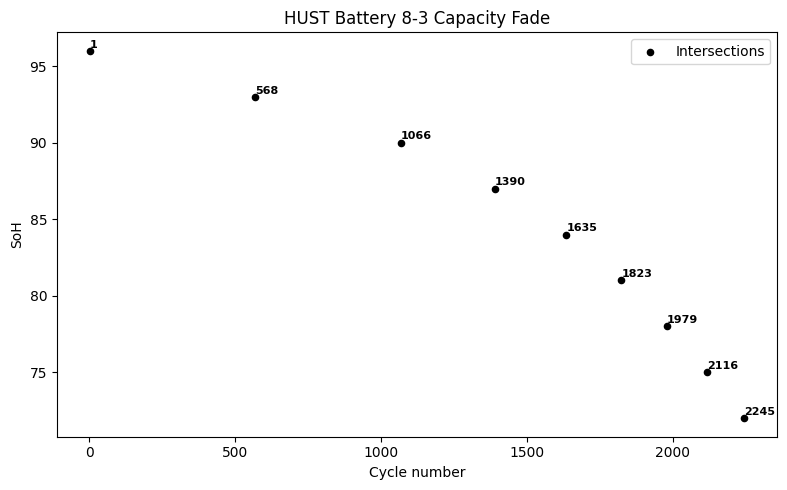

--------------------------------------------------------------------------------
9-8
2308


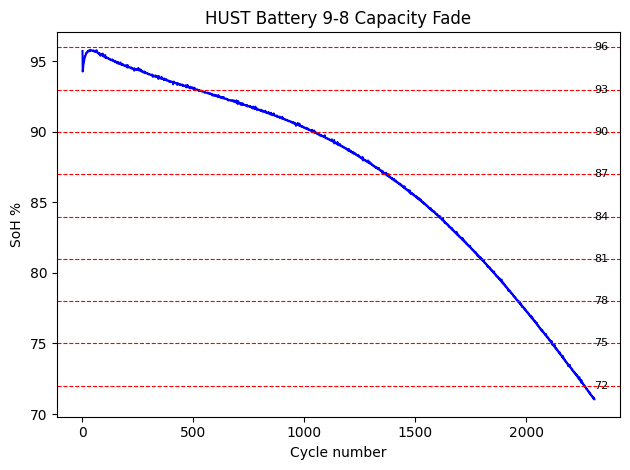

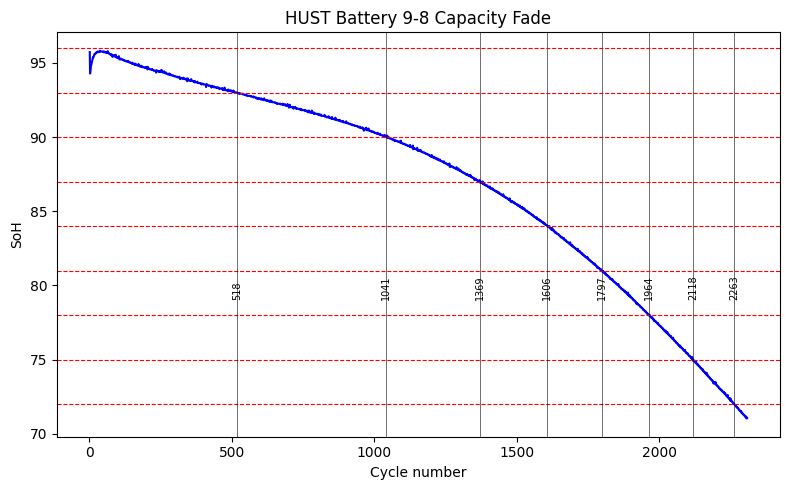

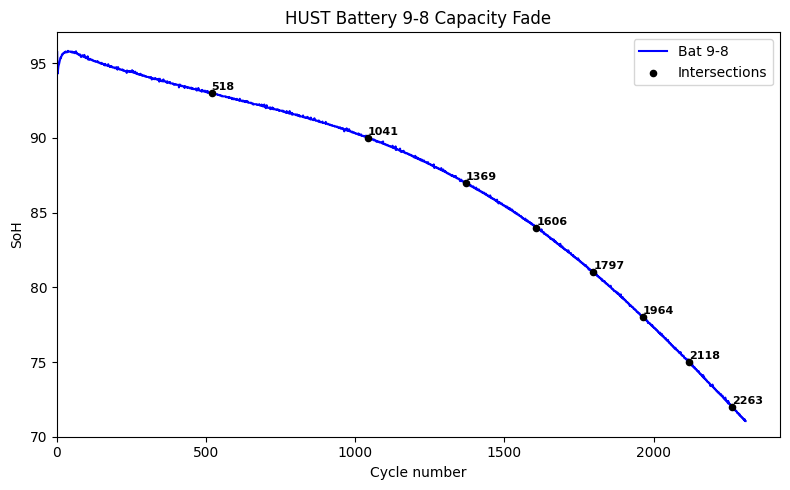

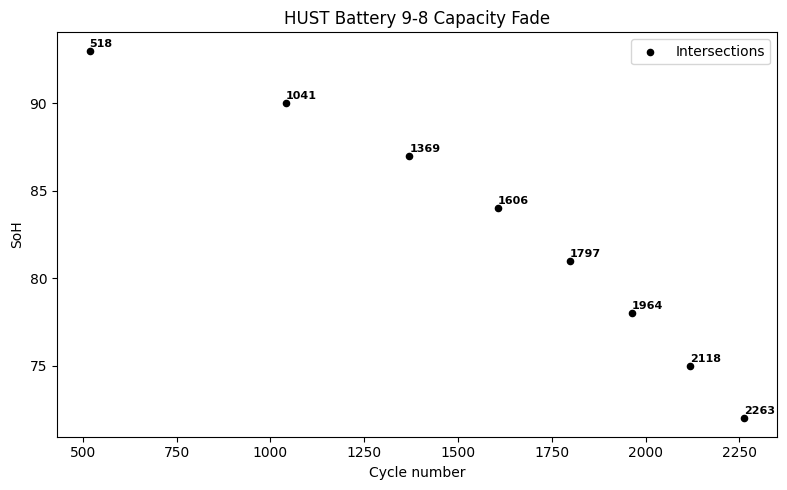

--------------------------------------------------------------------------------
3-8
2342


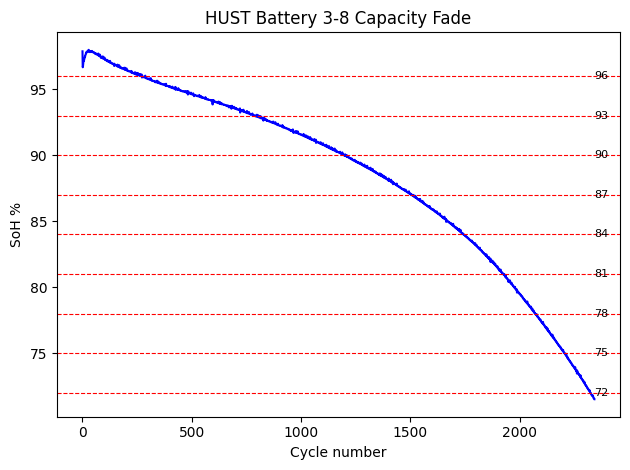

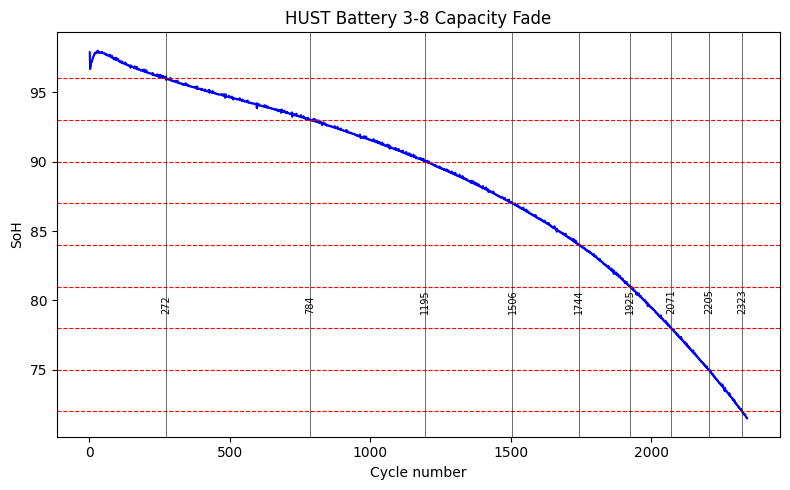

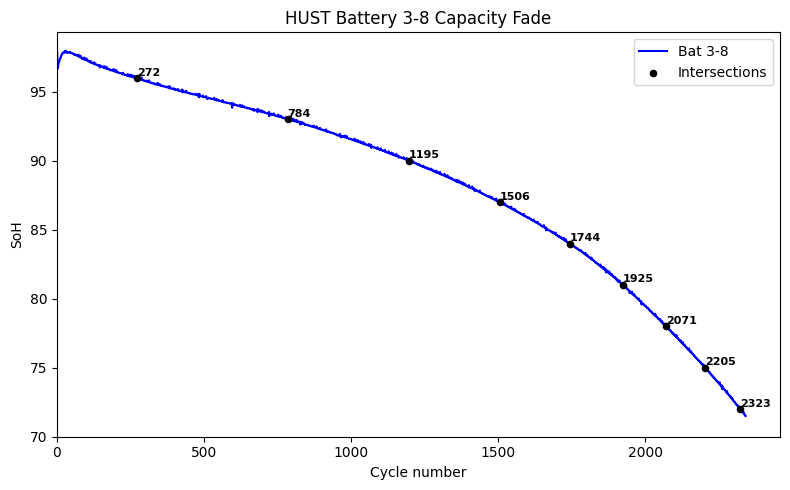

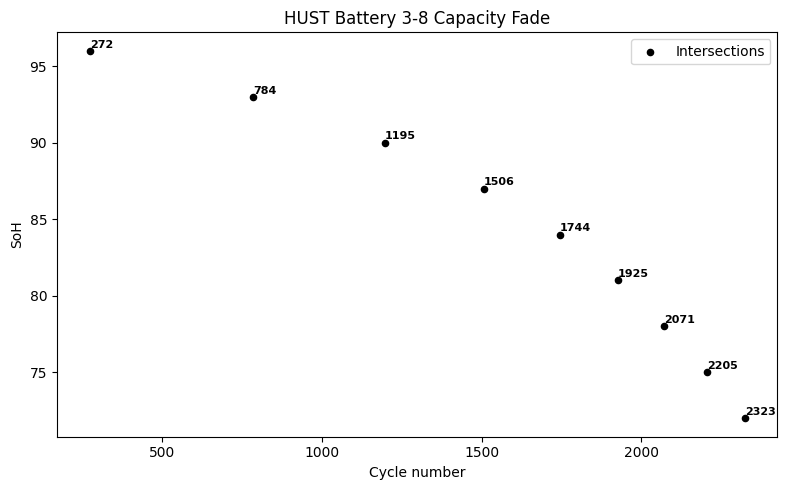

--------------------------------------------------------------------------------
8-6
2365


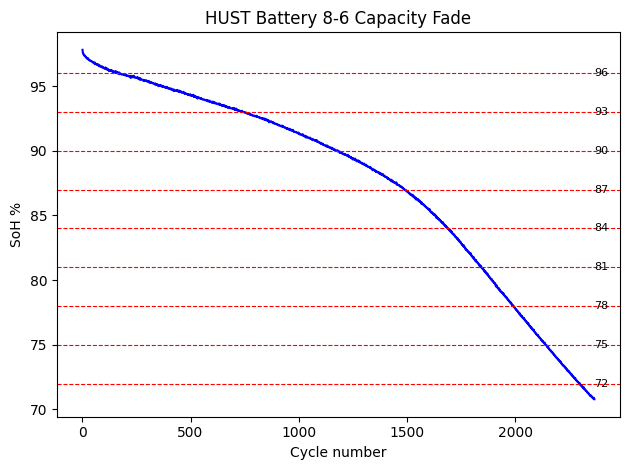

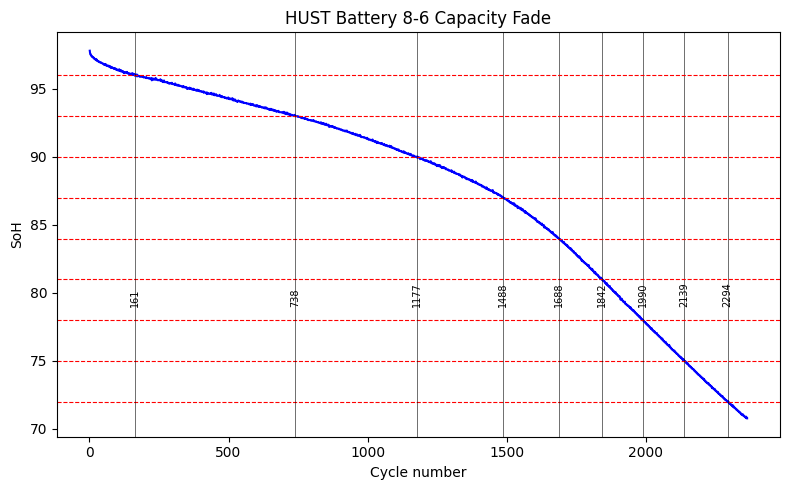

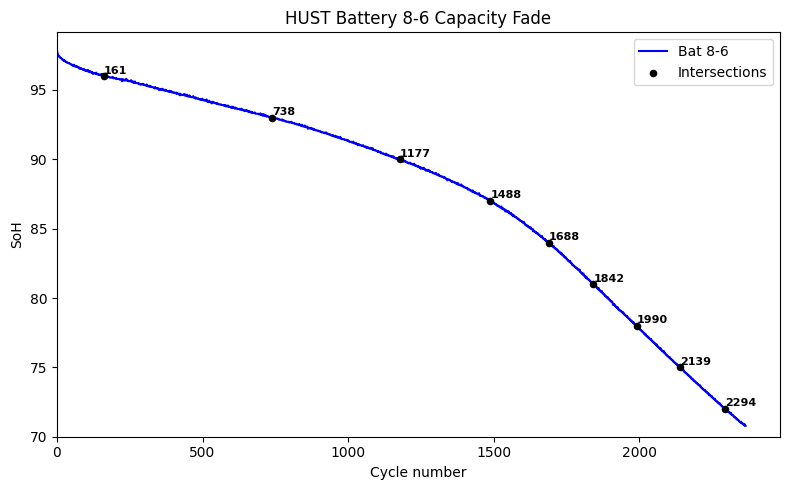

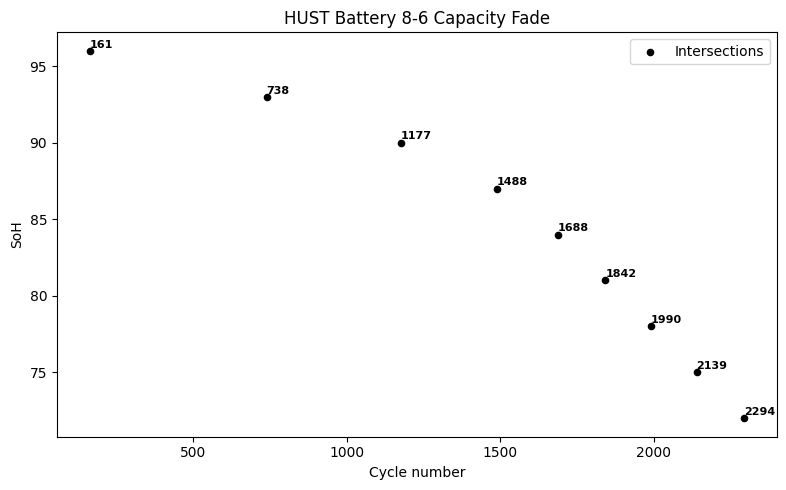

--------------------------------------------------------------------------------
6-8
2450


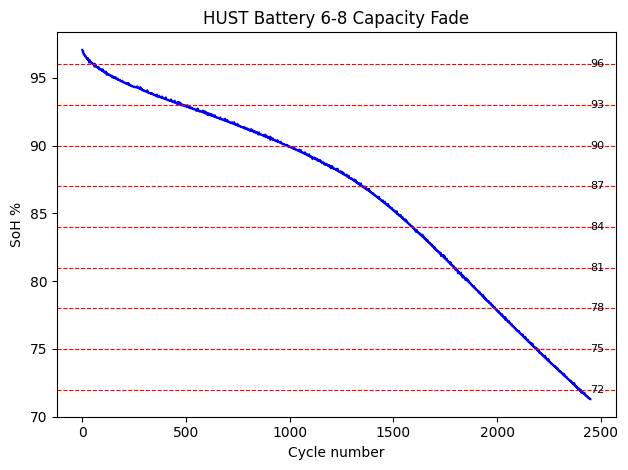

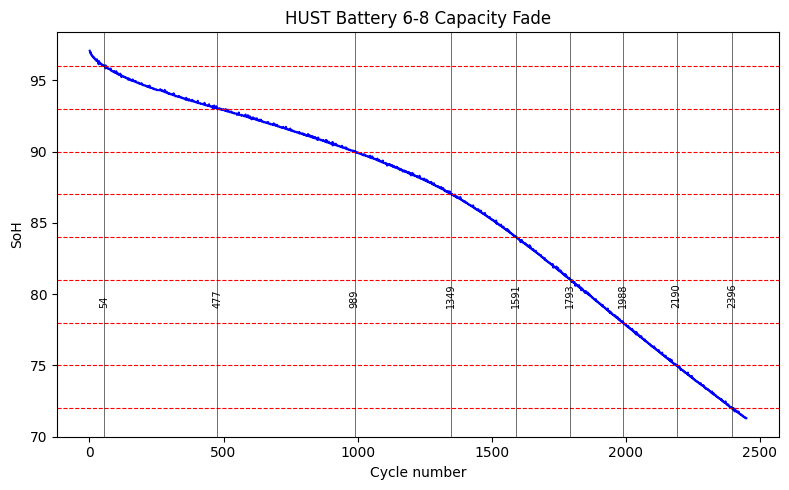

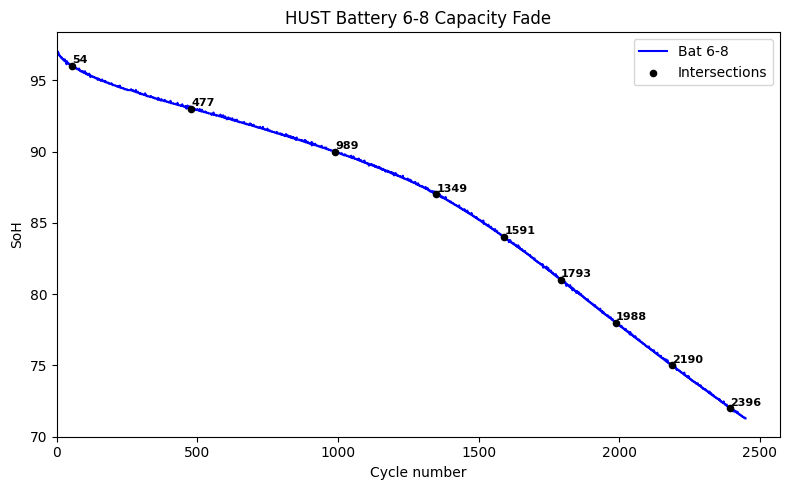

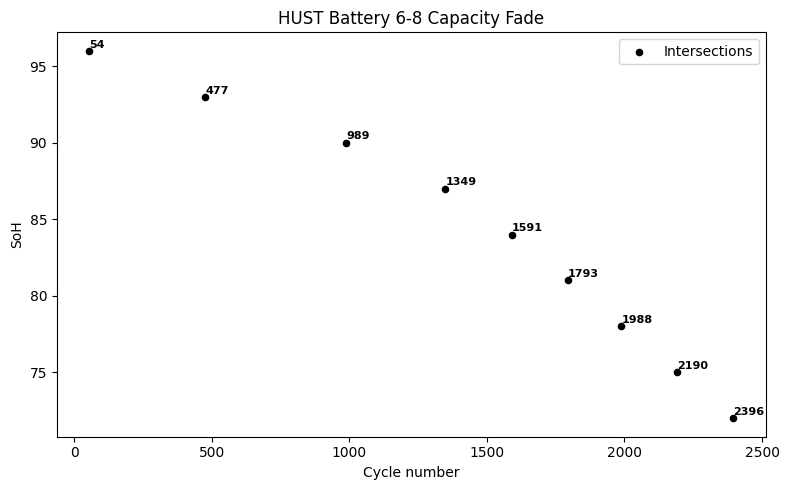

--------------------------------------------------------------------------------
5-6
2460


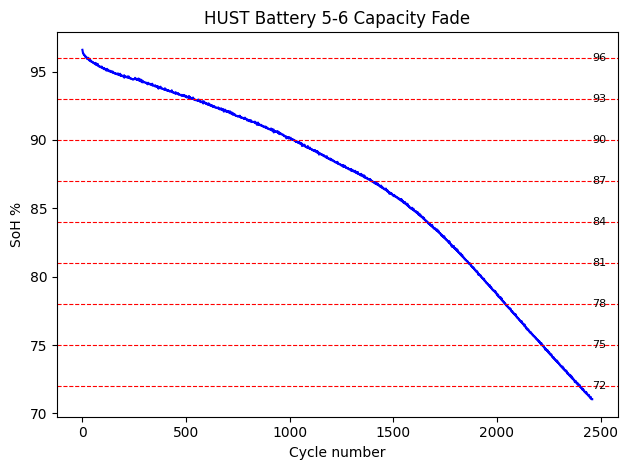

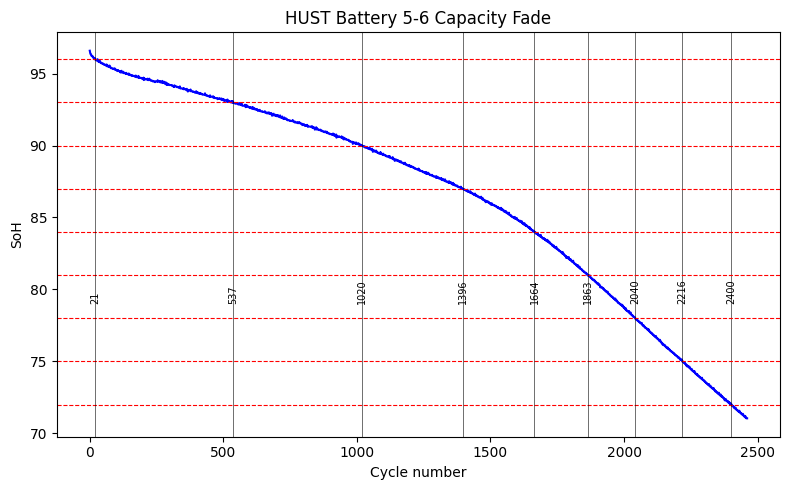

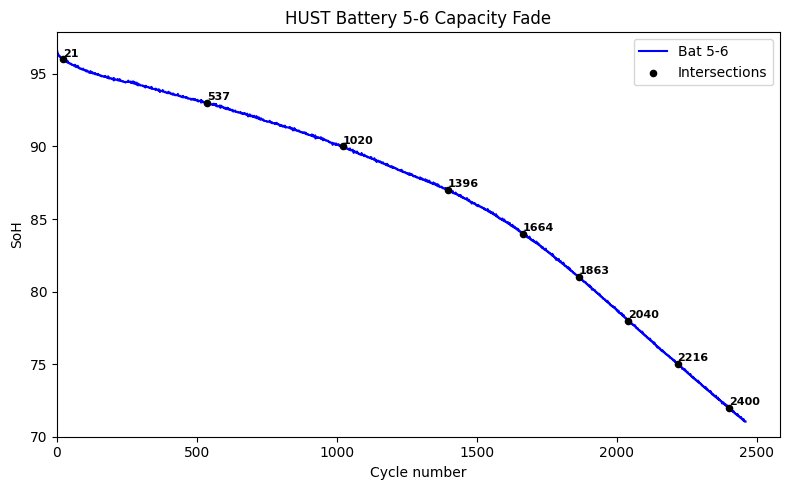

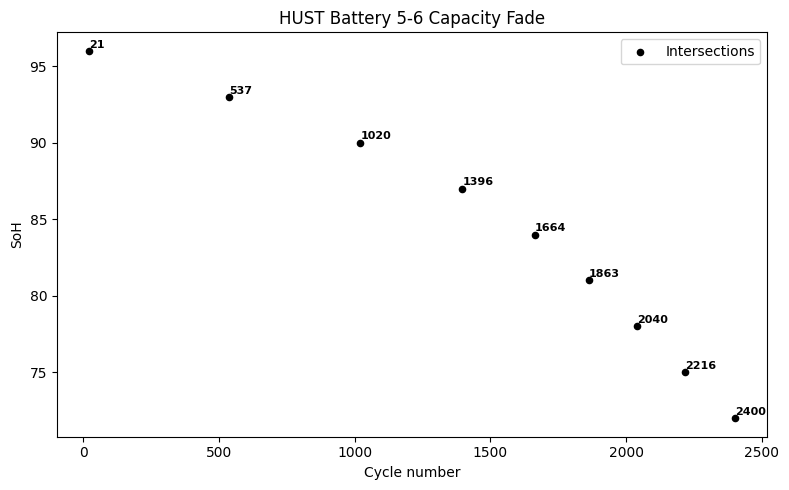

--------------------------------------------------------------------------------
6-6
2468


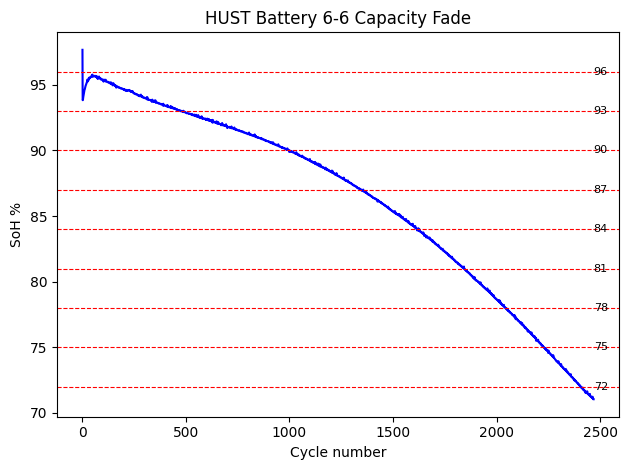

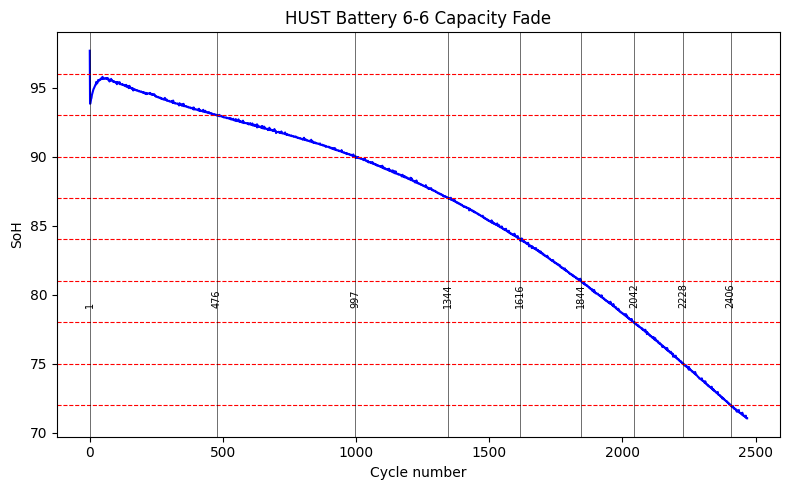

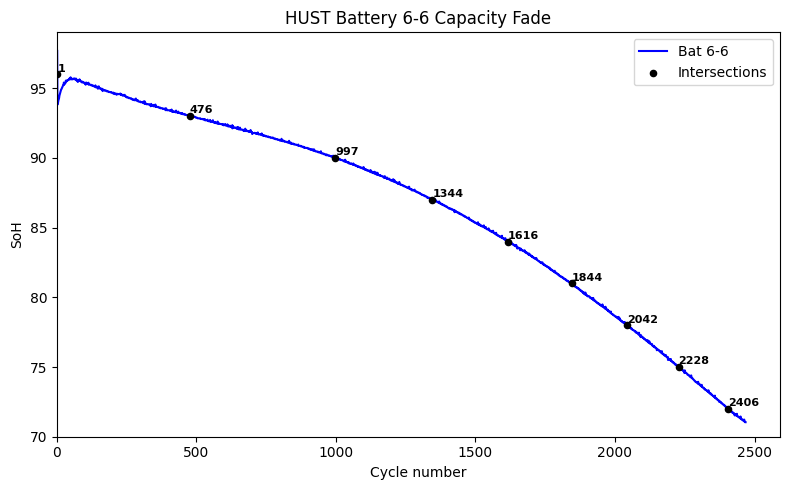

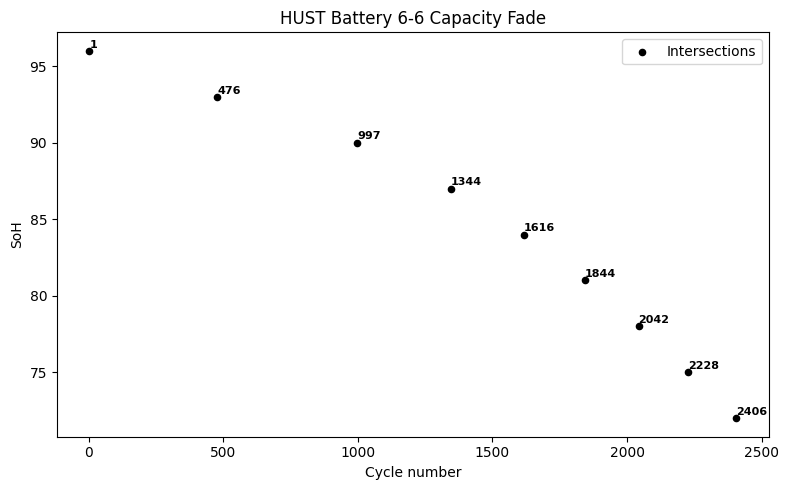

--------------------------------------------------------------------------------
3-7
2479


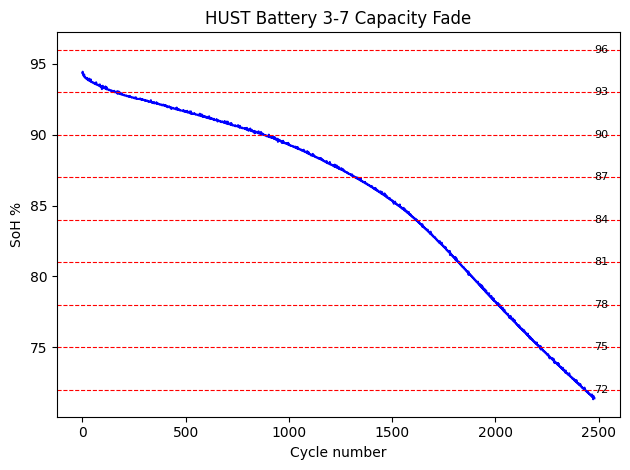

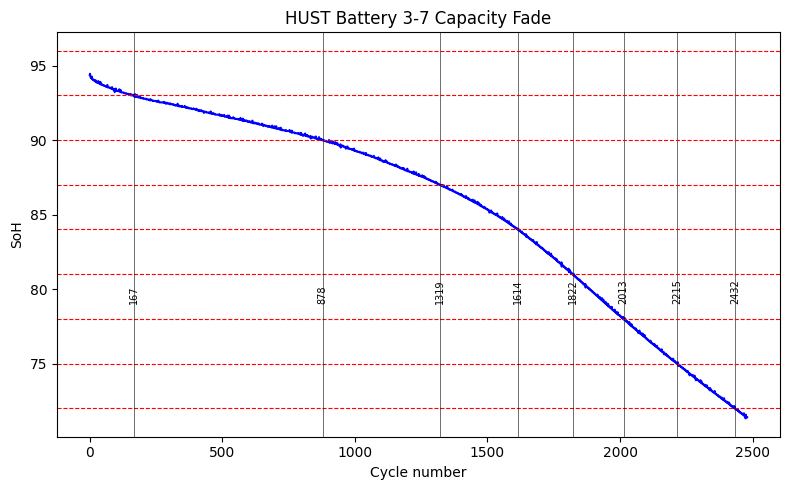

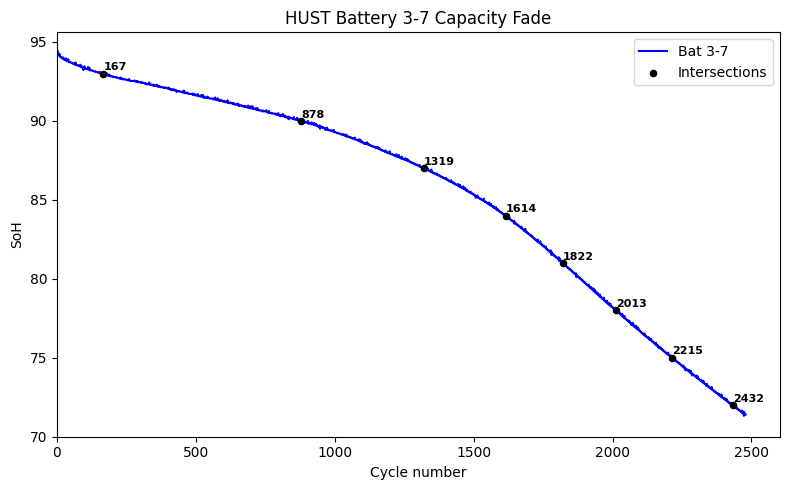

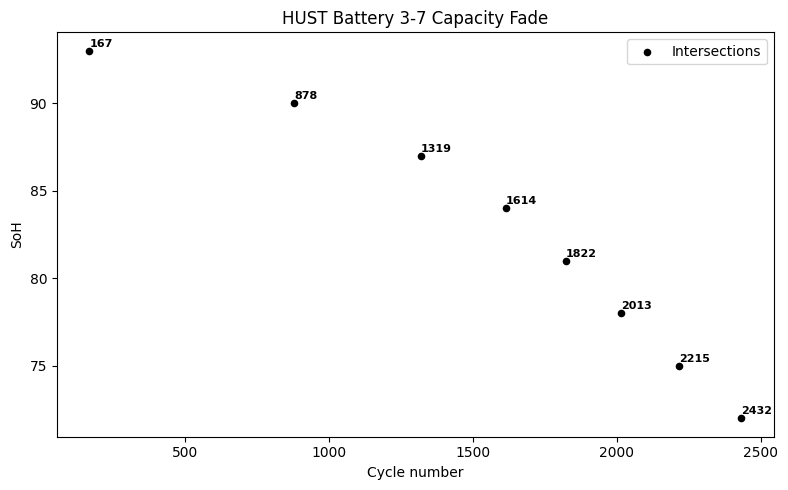

--------------------------------------------------------------------------------
3-6
2491


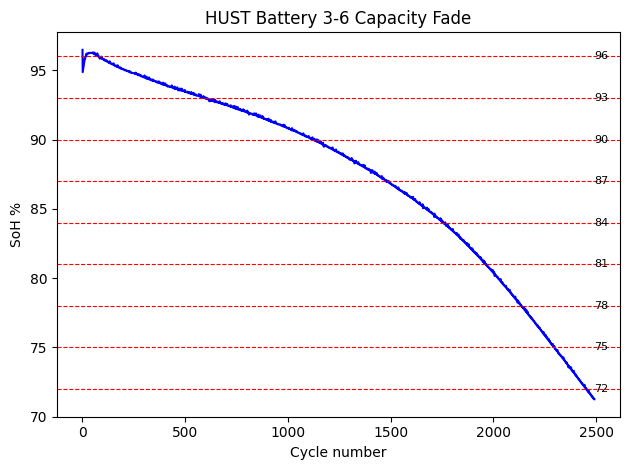

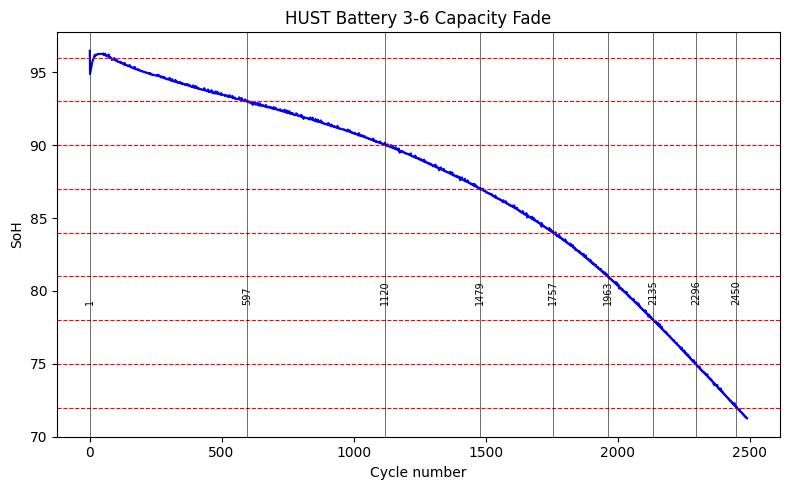

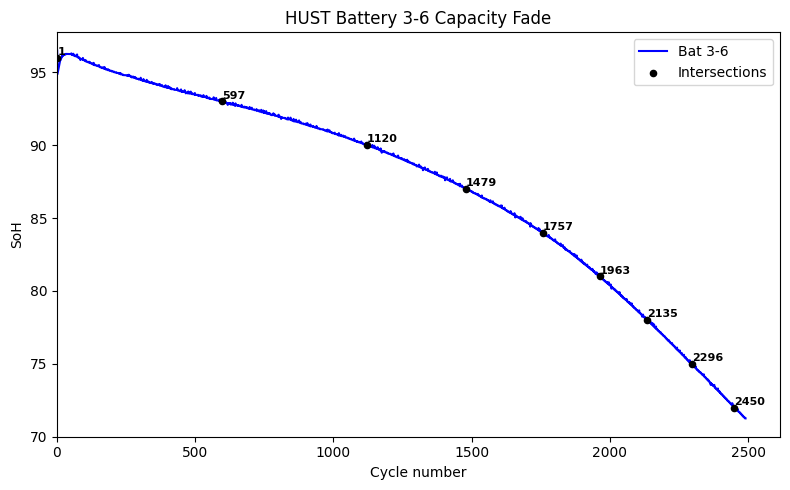

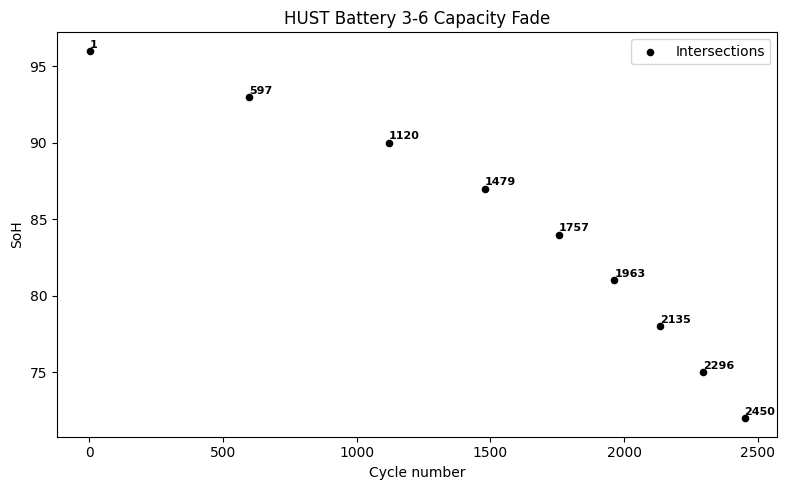

--------------------------------------------------------------------------------
5-1
2507


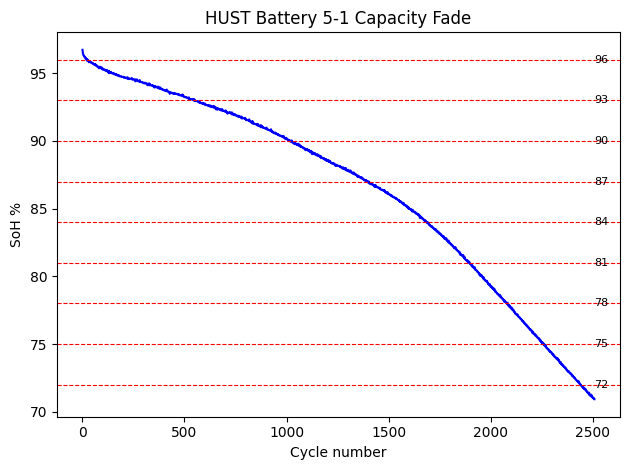

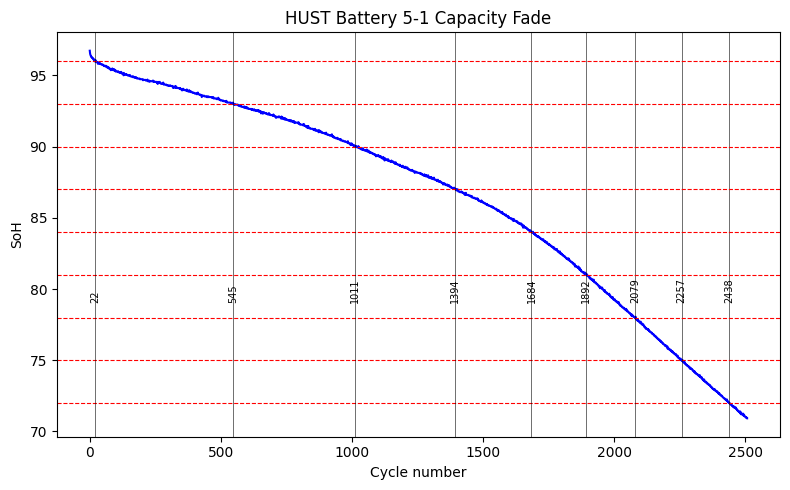

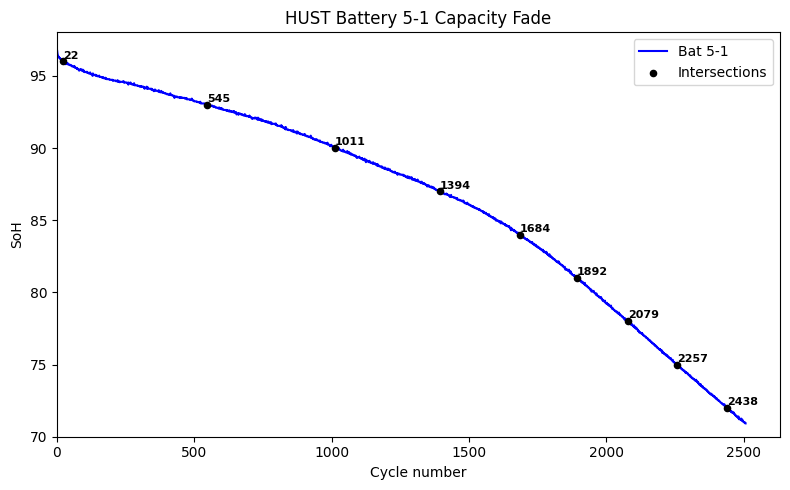

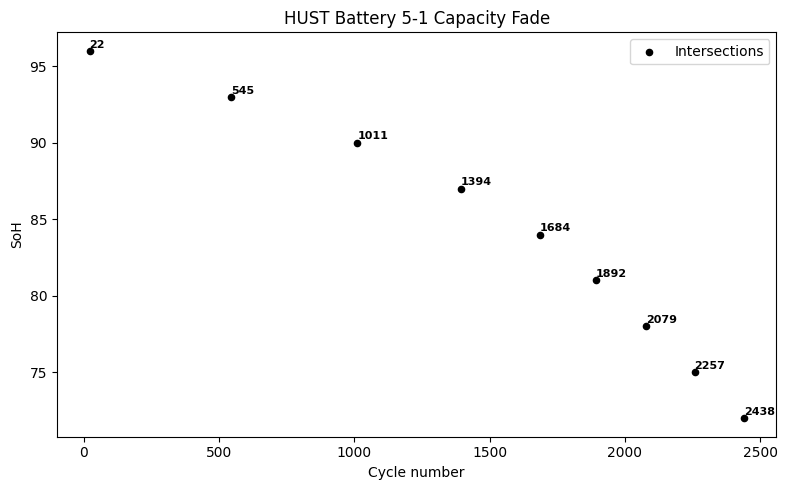

--------------------------------------------------------------------------------
2-2
2651


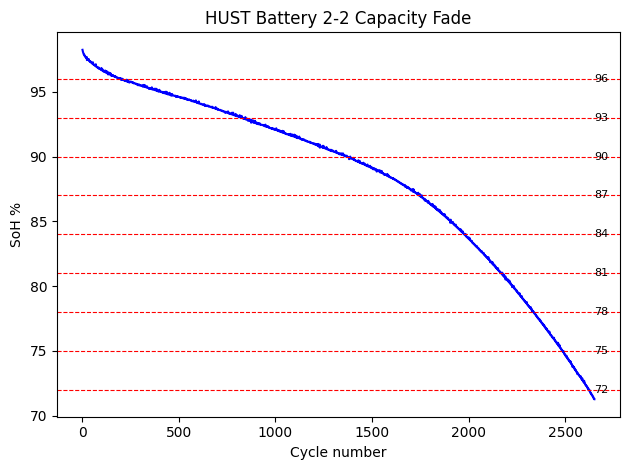

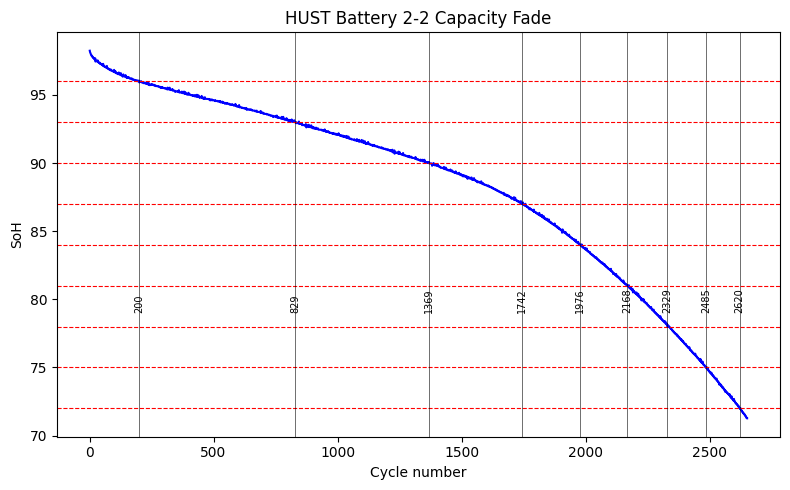

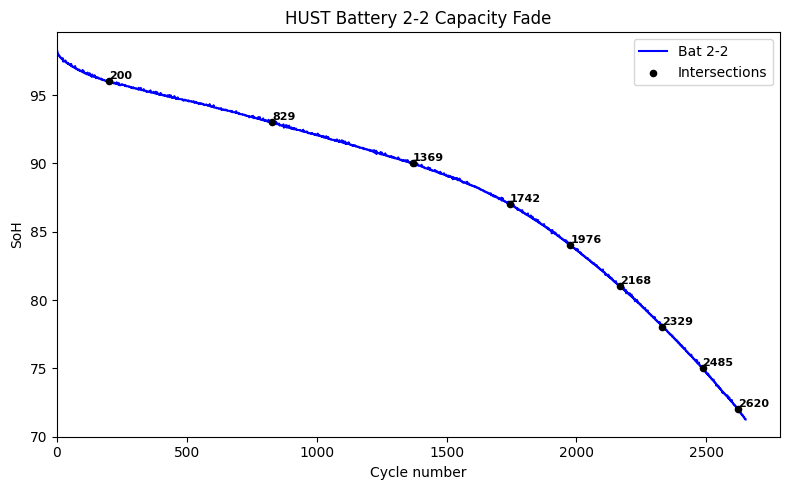

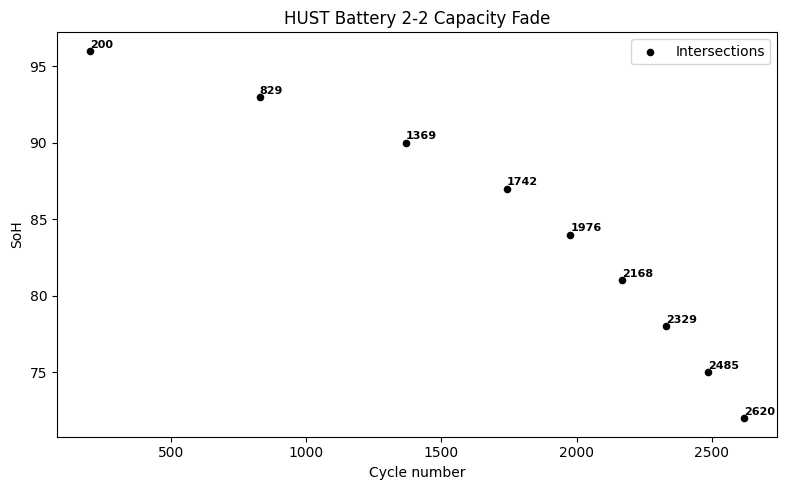

--------------------------------------------------------------------------------
3-5
2657


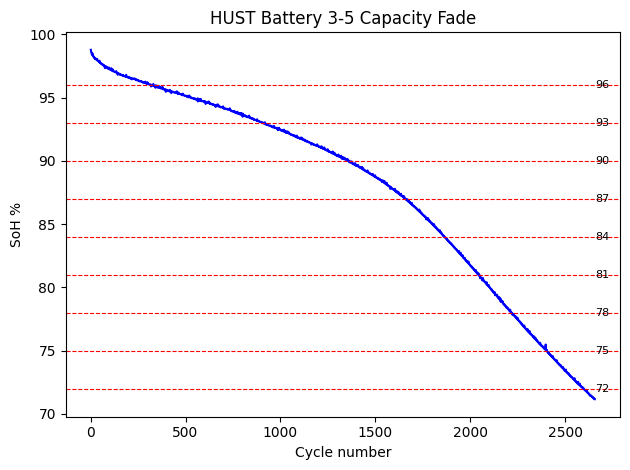

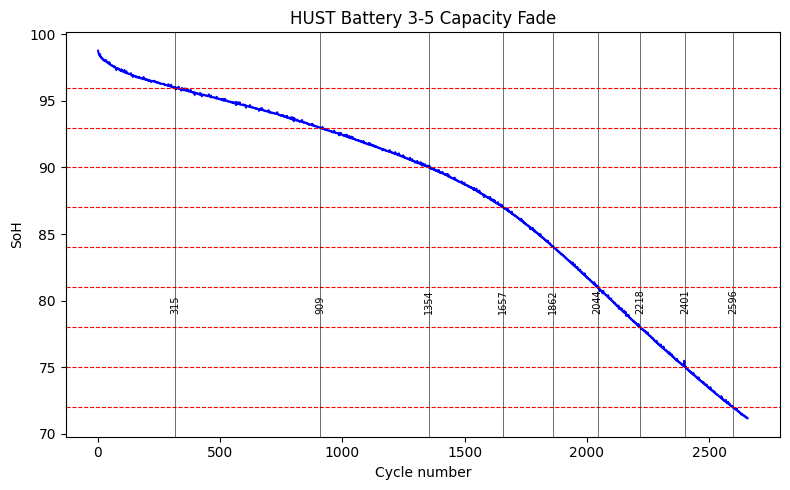

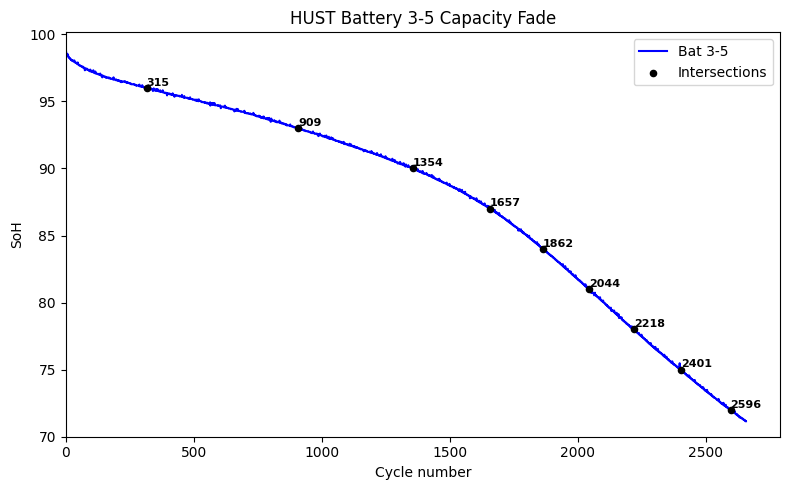

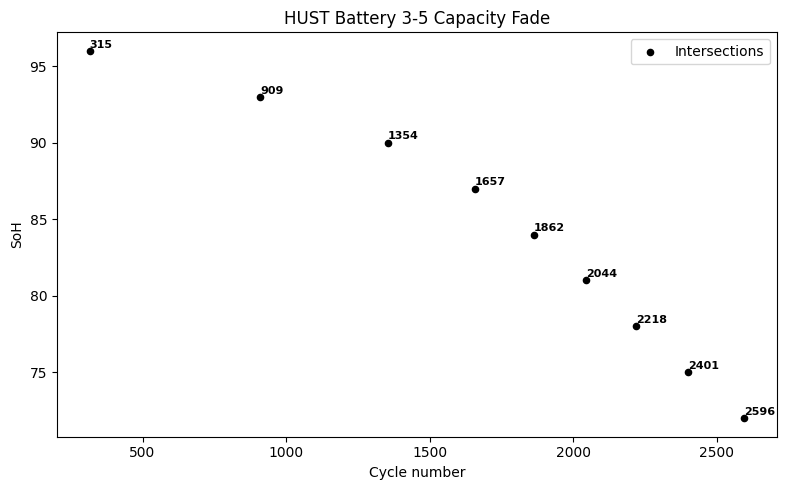

--------------------------------------------------------------------------------
1-2
2678


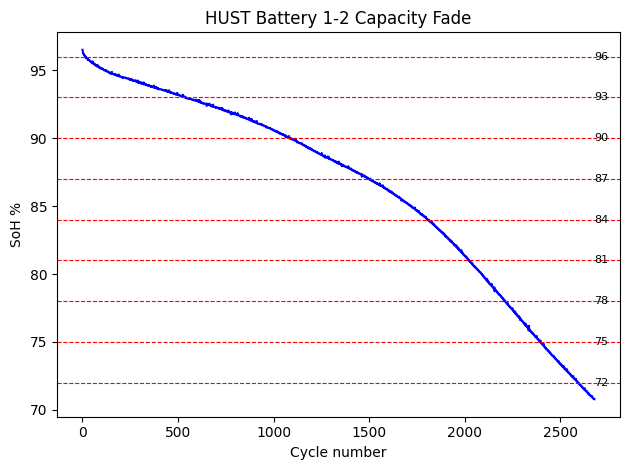

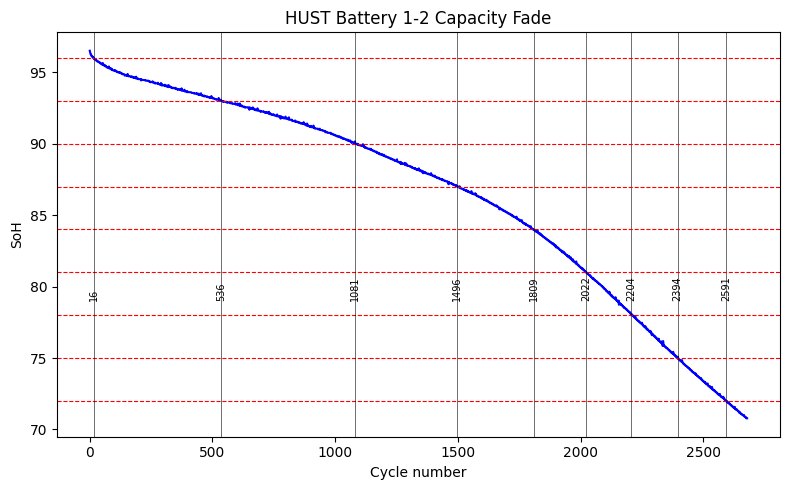

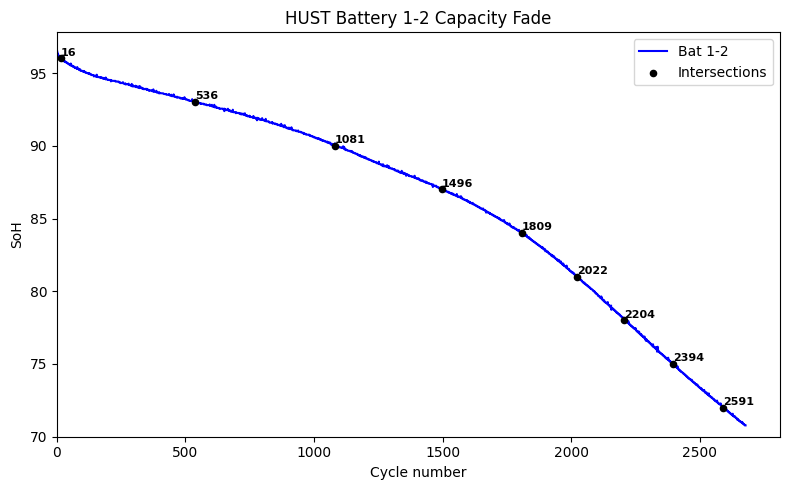

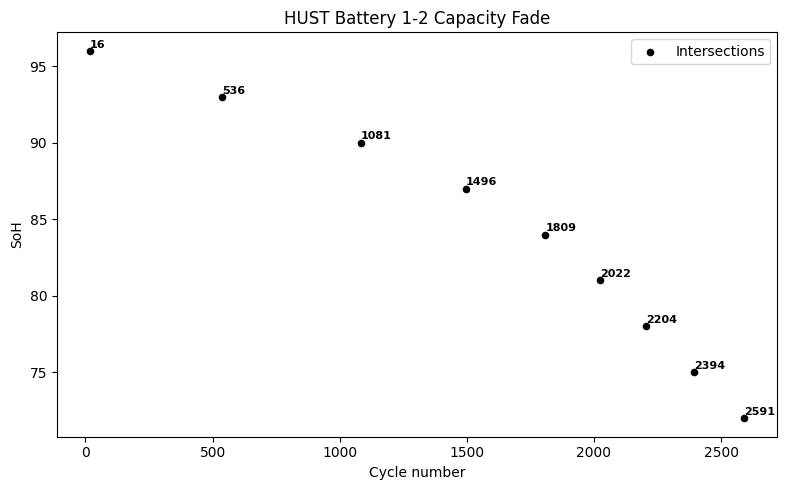

--------------------------------------------------------------------------------
5-3
2689


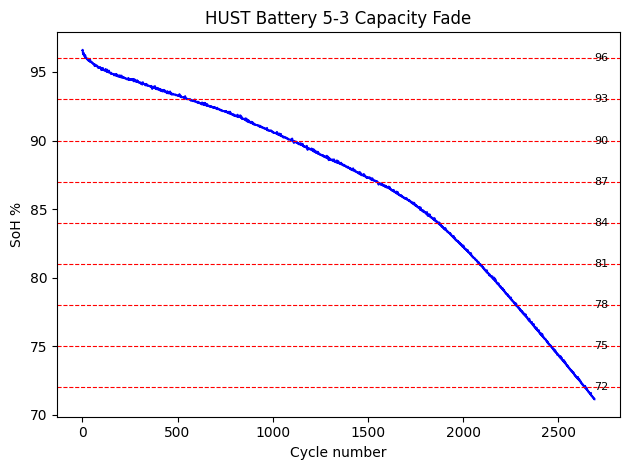

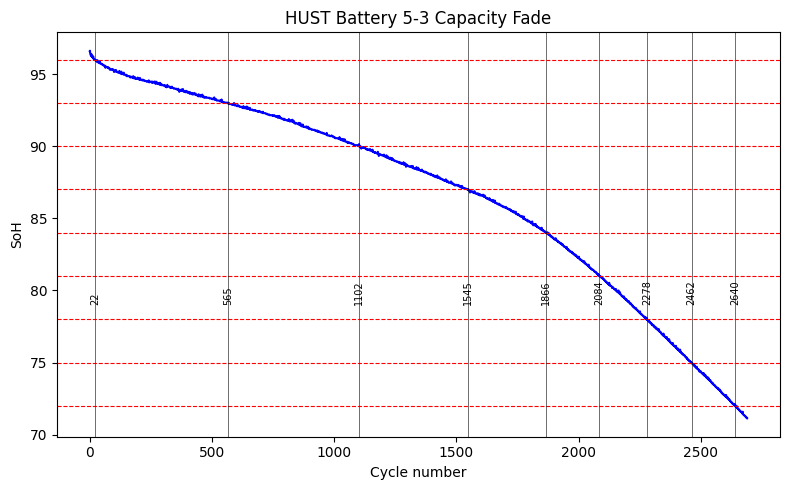

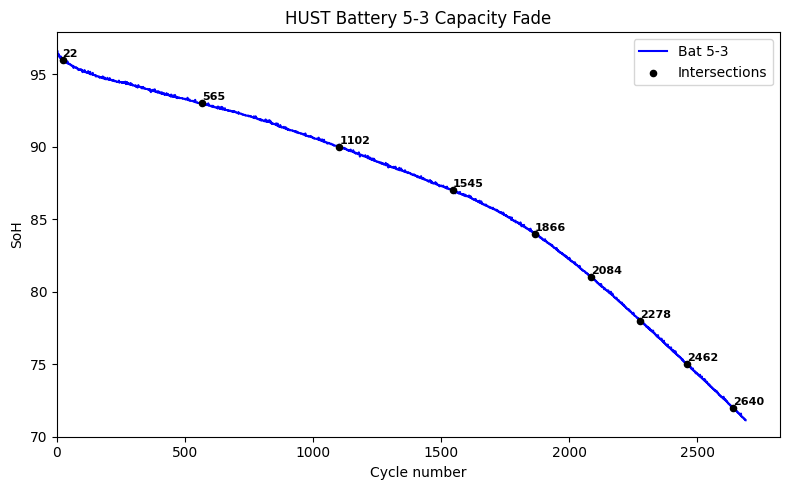

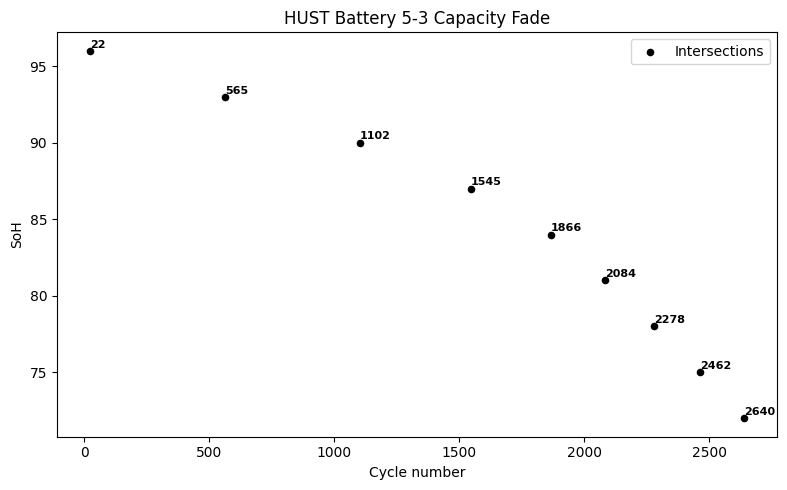

In [38]:
for choice in pairs:
    print('-'*80)
    print(choice)
    df = pd.read_csv("/kaggle/input/generate-hust-data-gompertz-k-a-b/" + choice + "-hust_gompertz_params.csv")
    df['SoH'] = ((df['SoH'])*100)
    #df['norm-SoH'] = df['norm-SoH'].astype(int)
    # Create figure
    fig = plt.figure()
    print(len(df['SoH']))
    plt.plot(df['Cycle number'], ((df['SoH']) /1),
             label=f"Bat {choice}", color='b')
    
    plt.xlabel('Cycle number')
    plt.ylabel('SoH %')
    plt.title(f'HUST Battery {choice} Capacity Fade')
    
    # Add horizontal dotted lines
    for val in range(72, 93+3+1, 3):
        #val = round((val-80)/(115-80),4)
        plt.axhline(y=val, color='r', linestyle='--', linewidth=0.8)
        plt.text(df['Cycle number'].max(), val, str(val), va='center', fontsize=8)
    
    plt.tight_layout()
    plt.show()
    
    x = df['Cycle number'].to_numpy()
    y = df['SoH'].to_numpy()
    
    # Create figure
    fig, ax = plt.subplots(figsize=(8, 5))
    
    ax.plot(x, y, label=f"Bat {choice}", color='b')
    ax.set_xlabel('Cycle number')
    ax.set_ylabel('SoH')
    ax.set_title(f'HUST Battery {choice} Capacity Fade')
    
    # Horizontal reference lines
    for val in range(72, 93+3+1, 3):
        ax.axhline(y=val, color='r', linestyle='--', linewidth=0.8)
        
        # --- Find intersection ---
        # Compute where SoH crosses the horizontal line
        idx = np.where(np.diff(np.sign(y - val)))[0]
        if len(idx) > 0:
            # Take first intersection (or loop for all)
            i = idx[0]
            # Linear interpolation between points
            x_int = x[i] + (x[i+1] - x[i]) * (val - y[i]) / (y[i+1] - y[i])
            
            # Draw vertical line
            ax.axvline(x=x_int, color='k', linestyle='-', linewidth=0.4)
            # Add label
            ax.text(x_int, 79, f"{int(x_int)}", rotation=90,
                    va='bottom', ha='center', fontsize=7, color='k')
    
    plt.tight_layout()
    plt.show()
    
    x = df['Cycle number'].to_numpy()
    y = df['SoH'].to_numpy()
    plot_battery_fade(x, y, choice)
    # Create figure
    fig, ax = plt.subplots(figsize=(8, 5))
    #ax.plot(x, y, label=f"Bat {choice_csv}", color='b')
    
    ax.set_xlabel('Cycle number')
    ax.set_ylabel('SoH')
    ax.set_title(f'HUST Battery {choice} Capacity Fade')
    
    x_hits = []
    y_hits = []
    
    # Horizontal reference lines
    for val in range(72, 93+3+1, 3):
        #ax.axhline(y=val, color='r', linestyle='--', linewidth=0.8)
        
        # Find intersection
        idx = np.where(np.diff(np.sign(y - val)))[0]
        if len(idx) > 0:
            i = idx[0]
            x_int = x[i] + (x[i+1] - x[i]) * (val - y[i]) / (y[i+1] - y[i])
            
            # Save intersection
            x_hits.append(x_int)
            y_hits.append(val)
            
            # # Draw vertical line and label
            # #ax.axvline(x=x_int, color='k', linestyle='-', linewidth=0.8)
            # ax.text(x_int, 107, f"{int(x_int)}", rotation=45,
            #         va='bottom', ha='center', fontsize=7, color='k')
            ax.text(x_int, val + 0.4, f"{int(x_int)}", 
                    rotation=0,         # No rotation needed if close to point
                    va='center',        # Anchor bottom of text to the point
                    ha='left',        # Center horizontally
                    fontsize=8, 
                    color='black',
                    fontweight='bold')
    
    # --- Plot intersection points ---
    ax.scatter(x_hits, y_hits, color='k', s=20, zorder=5, label='Intersections')
    
    plt.legend()
    plt.tight_layout()
    plt.show()
    #break

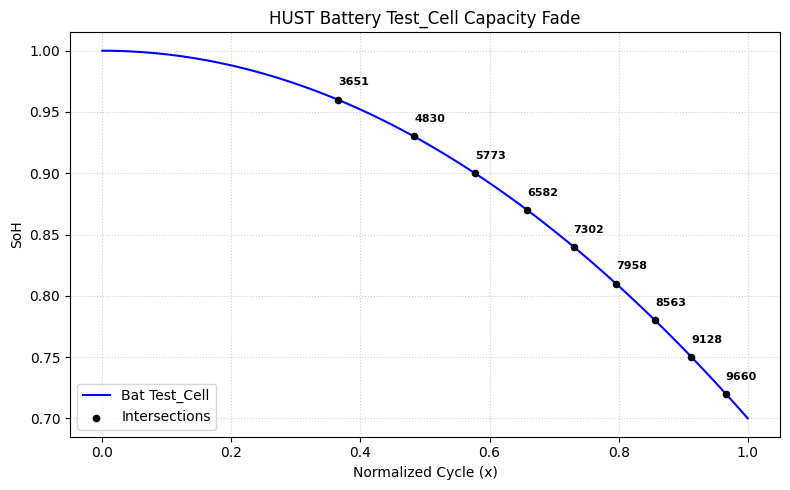

In [39]:
import matplotlib.pyplot as plt
import numpy as np

def plot_battery_fade(x, y, choice):
    """
    Plots battery capacity fade with intersection points labeled next to the markers.
    Adapted for fractional X (0-1) and Y (0.7-1.0) values.
    """
    fig, ax = plt.subplots(figsize=(8, 5))
    ax.plot(x, y, label=f"Bat {choice}", color='b') 
    
    ax.set_xlabel('Normalized Cycle (x)')
    ax.set_ylabel('SoH')
    ax.set_title(f'HUST Battery {choice} Capacity Fade')
    
    # --- FIX START: Adjust limits for fractional data ---
    #ax.set_xlim(0, 1.0)     # X-axis ranges from 0 to 1
    #ax.set_ylim(0.7, 1.02)  # Y-axis ranges from 0.7 to slightly above 1.0
    # ---------------------------------------------
    
    x_hits = []
    y_hits = []
    
    # --- FIX: Loop for fractions (0.72 to 0.96 with step 0.03) ---
    # We use np.arange. We add a small epsilon (0.001) to the stop value 
    # to ensure the final value (0.96) is included.
    target_values = np.arange(0.72, 0.96 + 0.001, 0.03)

    for val in target_values:
        # Find intersection
        # We calculate the difference between the signal and the target value
        idx = np.where(np.diff(np.sign(y - val)))[0]
        
        if len(idx) > 0:
            i = idx[0]
            # Linear interpolation formula
            x_int = x[i] + (x[i+1] - x[i]) * (val - y[i]) / (y[i+1] - y[i])
            
            # Save intersection
            x_hits.append(x_int)
            y_hits.append(val)
            
            # --- PLOT TEXT NEARBY ---
            # FIX: Adjusted offset. 0.4 is too big for a 0-1 scale. 
            # We use 0.01 to place it slightly above the dot.
            # FIX: Changed f"{int(x_int)}" to f"{x_int:.2f}" because x is < 1.
            ax.text(x_int, val + 0.01, f"{int(x_int*10000)}", 
                    rotation=0, 
                    va='bottom', 
                    ha='left', 
                    fontsize=8, 
                    color='black',
                    fontweight='bold')
    
    # --- Plot all intersection points at once ---
    if x_hits:
        ax.scatter(x_hits, y_hits, color='k', s=20, zorder=5, label='Intersections')
    
    plt.legend(loc='lower left')
    plt.grid(True, linestyle=':', alpha=0.6) # Added grid for better readability on small scales
    plt.tight_layout()
    plt.show()

# --- Example Usage ---
# Generating dummy data that fits your criteria (x: 0-1, y: 1.0-0.7)
x_dummy = np.linspace(0, 1, 100)
# Create a curve that fades from 1.0 down to roughly 0.7
y_dummy = 1.0 - (0.3 * x_dummy**2) 

plot_battery_fade(x_dummy, y_dummy, "Test_Cell")

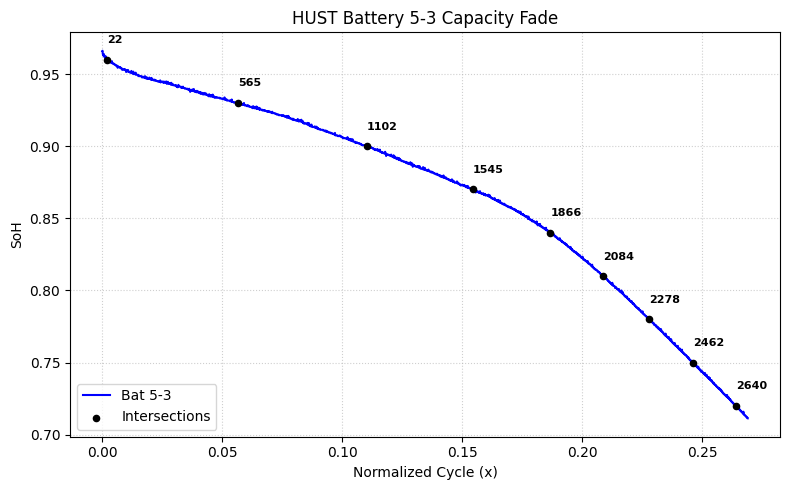

In [40]:
df = pd.read_csv("/kaggle/input/generate-hust-data-gompertz-k-a-b/" + choice + "-hust_gompertz_params.csv")
x = df['Cycle number'].to_numpy()/10000
y = df['SoH'].to_numpy()
plot_battery_fade(x, y, choice)

7-8
SoH Threshold :  93%
1.0673852909226793 -2.22717858511325 -4.865657298632758
72% SoH RUL estimation:  2648
90% SoH RUL estimation:  942
7-8
SoH Threshold :  90%
1.0583285209359563 -2.305330146284086 -5.036442417368492
72% SoH RUL estimation:  2670
90% SoH RUL estimation:  963
7-8
SoH Threshold :  87%
0.9939607648642036 -3.249649854215684 -10.14127412563434
72% SoH RUL estimation:  2080
90% SoH RUL estimation:  926
7-8
SoH Threshold :  84%
0.9813528944397588 -3.601209325385062 -12.461701485973858
72% SoH RUL estimation:  1942
90% SoH RUL estimation:  926
7-8
SoH Threshold :  81%
0.9767298973559104 -3.7579951071961486 -13.49691348293234
72% SoH RUL estimation:  1898
90% SoH RUL estimation:  929
7-8
SoH Threshold :  78%
0.9746440296550062 -3.8331813553306255 -13.975895839416582
72% SoH RUL estimation:  1882
90% SoH RUL estimation:  932
7-8
SoH Threshold :  75%
0.973773731887427 -3.864805585907504 -14.169535417333448
72% SoH RUL estimation:  1876
90% SoH RUL estimation:  934
7-8
SoH Th

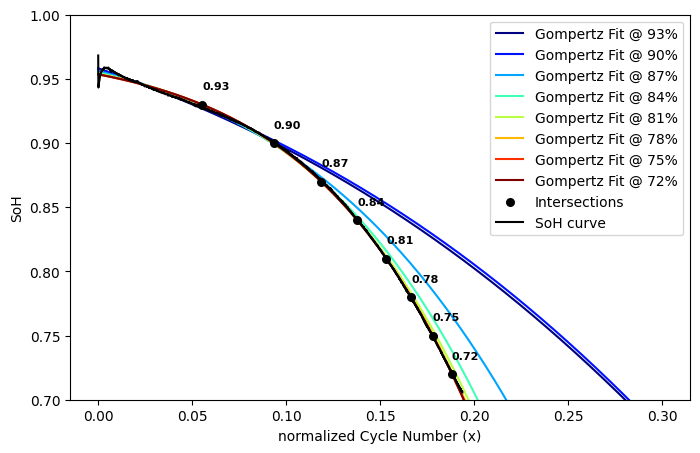

In [41]:
import matplotlib.cm as cm

choice = '7-8'
df = pd.read_csv("/kaggle/input/generate-hust-data-gompertz-k-a-b/" + choice + "-hust_gompertz_params.csv")
df['SoH'] = ((df['SoH']))
SoH_Thresholds = ['93%','90%','87%','84%','81%','78%','75%','72%']
cycle_nums = [511,941,1193,1380,1532,1663,1778,1886]#[63,431,637,758,849,925, 992, 1054,1110,1142] #[548,1031,1423,1756,1972,2153,2315,2473,2628,2688]
colors = cm.jet(np.linspace(0, 1, len(cycle_nums)))

def gompertz_func(x,k,a,b):
    return k*np.exp(-np.exp(a-(b*x)))
    
plt.figure(figsize=(8, 5))
for i, cycle_num in enumerate(cycle_nums):
    x = np.array([j/10000 for j in range(1,3000,1)]) 
    print(choice)
    print('SoH Threshold : ',SoH_Thresholds[i])
    temp_df = df[df['Cycle number']==cycle_num]
    k,a,b = temp_df['k'].item(),temp_df['a'].item(),temp_df['b'].item()
    print(k,a,b)
    #temp_df.head()
    # gompertz_func(x=df,k=k,a=a,b=b

    
    print("72% SoH RUL estimation: ",int(inverse_gompertz_func(y=0.72173913,k=k,a=a,b=b)*10000))
    print("90% SoH RUL estimation: ",int(inverse_gompertz_func(y=0.9,k=k,a=a,b=b)*10000))



    # Compute y values
    y = gompertz_func(x,k,a,b)
    

    
    plt.plot(x, y, label=f'Gompertz Fit @ {SoH_Thresholds[i]}', color=colors[i])
    # plt.axhline(0, color='black', linewidth=0.5)
    # plt.axhline(1, color='black', linewidth=0.5)
    # plt.axvline(0, color='black', linewidth=0.5)
    plt.xlabel("normalized Cycle Number (x)")
    plt.ylim(0.7, 1)
    plt.ylabel("SoH")
    # break
x_hits = []
y_hits = []

# Target values: 0.72 to 0.96 with step 0.03
target_values = np.arange(0.72, 0.96 + 0.001, 0.03)

# # Generate distinct colors for each threshold curve
# colors = cm.jet(np.linspace(0, 1, len(target_values)))

for idx_val, val in enumerate(target_values):
    # 1. Find intersection on the main blue line
    # We look for where the data crosses the 'val' threshold
    idx = np.where(np.diff(np.sign(y - val)))[0]
    
    if len(idx) > 0:
        inter = idx[0]
        # Linear interpolation for precise x-coordinate
        x_int = x[inter] + (x[inter+1] - x[inter]) * (val - y[inter]) / (y[inter+1] - y[inter])
        
        x_hits.append(x_int)
        y_hits.append(val)
        
        # 2. Overlay Gompertz Curve (if df_params is provided)
        if df is not None:
            # Find the row in df_params with SoH closest to current 'val'
            # We assume df_params has a column 'SoH' (fractions like 0.93) or similar.
            # If df uses strings '93%', you might need to convert them first.
            
            # Finding closest match by absolute difference
            closest_row_idx = (df['SoH'] - val).abs().idxmin()
            row = df.loc[closest_row_idx]
            
            k, a, b = row['k'], row['a'], row['b']
            
            # Generate the Gompertz curve
            # NOTE: If k, a, b were fitted on INTEGER cycles, we must treat x as such
            # or assume the user has normalized k, a, b.
            # Here, we pass 'x' (0-1) directly. 
            #y_gomp = gompertz_func(x, k, a, b)
            
            # ax.plot(x, y_gomp, 
            #         color=colors[idx_val], 
            #         linestyle='--', 
            #         linewidth=1, 
            #         alpha=0.7,
            #         label=f"Fit @ {val:.2f}" if idx_val % 2 == 0 else "") # Label every other to reduce clutter

        # 3. Label the point
        plt.text(x_int, val + 0.01, f"{val:.2f}", 
                rotation=0, va='bottom', ha='left', fontsize=8, fontweight='bold')

# Plot intersection dots
if x_hits:
    plt.scatter(x_hits, y_hits, color='k', s=30, zorder=5, label='Intersections')

plt.plot(x[:len(df['SoH'])], df['SoH'], label='SoH curve',color='black')
#plt.title(f"Plot of gompertz function k = {round(k,2)}, a = {round(a,2)} and b = {round(b,2)}")
plt.legend()
plt.grid(not True)

# Show the plot
plt.show()

7-8
SoH Threshold :  93%
1.0673852909226793 -2.22717858511325 -4.865657298632758
72% SoH RUL estimation:  2648


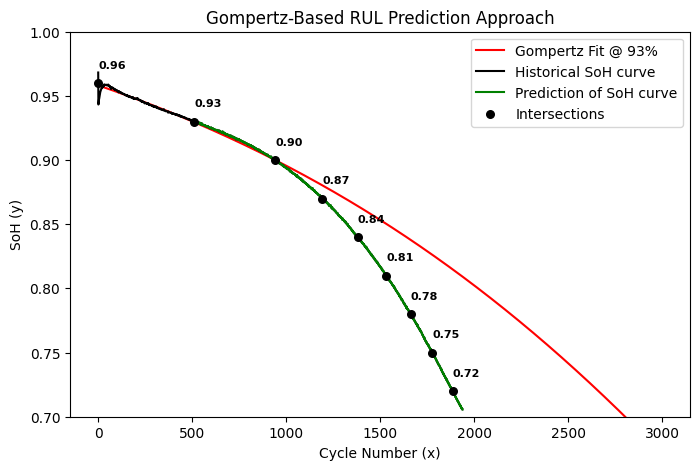

In [42]:
import matplotlib.cm as cm

choice = '7-8'
df = pd.read_csv("/kaggle/input/generate-hust-data-gompertz-k-a-b/" + choice + "-hust_gompertz_params.csv")
df['SoH'] = ((df['SoH']))
SoH_Thresholds = ['93%','90%','87%','84%','81%','78%','75%','72%']
cycle_nums = [511,941,1193,1380,1532,1663,1778,1886]#[63,431,637,758,849,925, 992, 1054,1110,1142] #[548,1031,1423,1756,1972,2153,2315,2473,2628,2688]
colors = cm.jet(np.linspace(0, 1, len(cycle_nums)))

def gompertz_func(x,k,a,b):
    return k*np.exp(-np.exp(a-(b*x)))
    
plt.figure(figsize=(8, 5))
for i, cycle_num in enumerate(cycle_nums):
    x = np.array([j/10000 for j in range(1,3000,1)]) 
    print(choice)
    print('SoH Threshold : ',SoH_Thresholds[i])
    temp_df = df[df['Cycle number']==cycle_num]
    k,a,b = temp_df['k'].item(),temp_df['a'].item(),temp_df['b'].item()
    print(k,a,b)
    #temp_df.head()
    # gompertz_func(x=df,k=k,a=a,b=b

    
    print("72% SoH RUL estimation: ",int(inverse_gompertz_func(y=0.72173913,k=k,a=a,b=b)*10000))


    # Compute y values
    y = gompertz_func(x,k,a,b)
    

    
    plt.plot(x*10000, y, label=f'Gompertz Fit @ {SoH_Thresholds[i]}', color='r')
    # plt.axhline(0, color='black', linewidth=0.5)
    # plt.axhline(1, color='black', linewidth=0.5)
    # plt.axvline(0, color='black', linewidth=0.5)
    plt.xlabel("Cycle Number (x)")
    plt.ylim(0.7, 1)
    plt.ylabel("SoH (y)")
    break
x_hits = []
y_hits = []
y = df['SoH'].to_numpy()
# Target values: 0.72 to 0.96 with step 0.03
target_values = np.arange(0.72, 0.96 + 0.001, 0.03)

# # Generate distinct colors for each threshold curve
# colors = cm.jet(np.linspace(0, 1, len(target_values)))

for idx_val, val in enumerate(target_values):
    # 1. Find intersection on the main blue line
    # We look for where the data crosses the 'val' threshold
    idx = np.where(np.diff(np.sign(y - val)))[0]
    
    if len(idx) > 0:
        inter = idx[0]
        # Linear interpolation for precise x-coordinate
        x_int = x[inter] + (x[inter+1] - x[inter]) * (val - y[inter]) / (y[inter+1] - y[inter])
        
        x_hits.append(x_int*10000)
        y_hits.append(val)
        
        # 2. Overlay Gompertz Curve (if df_params is provided)
        if df is not None:
            # Find the row in df_params with SoH closest to current 'val'
            # We assume df_params has a column 'SoH' (fractions like 0.93) or similar.
            # If df uses strings '93%', you might need to convert them first.
            
            # Finding closest match by absolute difference
            closest_row_idx = (df['SoH'] - val).abs().idxmin()
            row = df.loc[closest_row_idx]
            
            k, a, b = row['k'], row['a'], row['b']
            
            # Generate the Gompertz curve
            # NOTE: If k, a, b were fitted on INTEGER cycles, we must treat x as such
            # or assume the user has normalized k, a, b.
            # Here, we pass 'x' (0-1) directly. 
            #y_gomp = gompertz_func(x, k, a, b)
            
            # ax.plot(x, y_gomp, 
            #         color=colors[idx_val], 
            #         linestyle='--', 
            #         linewidth=1, 
            #         alpha=0.7,
            #         label=f"Fit @ {val:.2f}" if idx_val % 2 == 0 else "") # Label every other to reduce clutter

        # 3. Label the point
        plt.text(x_int*10000, val + 0.01, f"{val:.2f}", 
                rotation=0, va='bottom', ha='left', fontsize=8, fontweight='bold')

plt.plot(x[:len(df['SoH'])]*10000, df['SoH'], label='Historical SoH curve',color='black')
plt.plot(x[511:len(df['SoH'])]*10000, list(df['SoH'])[511:len(df['SoH'])], label='Prediction of SoH curve',color='green')
# Plot intersection dots
if x_hits:
    plt.scatter(x_hits, y_hits, color='k', s=30, zorder=5, label='Intersections')


plt.title(f"Gompertz-Based RUL Prediction Approach")
plt.legend()
plt.grid(not True)

# Show the plot
plt.show()

7-8
SoH Threshold :  93%
1.0673852909226793 -2.22717858511325 -4.865657298632758
72% SoH RUL estimation:  2648


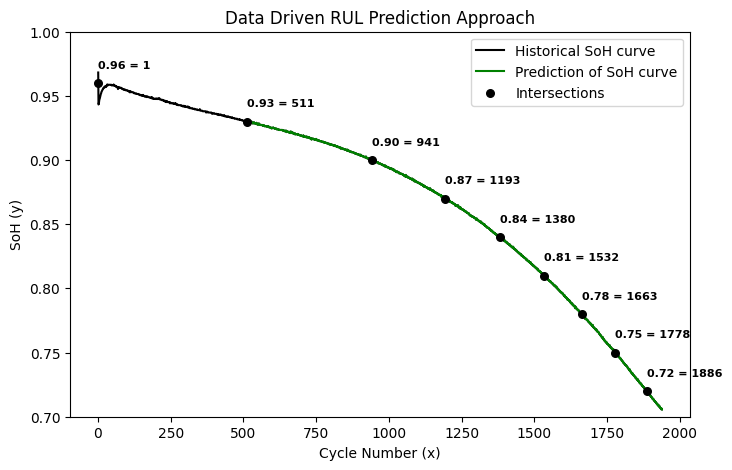

In [43]:
import matplotlib.cm as cm

choice = '7-8'
df = pd.read_csv("/kaggle/input/generate-hust-data-gompertz-k-a-b/" + choice + "-hust_gompertz_params.csv")
df['SoH'] = ((df['SoH']))
SoH_Thresholds = ['93%','90%','87%','84%','81%','78%','75%','72%']
cycle_nums = [511,941,1193,1380,1532,1663,1778,1886]#[63,431,637,758,849,925, 992, 1054,1110,1142] #[548,1031,1423,1756,1972,2153,2315,2473,2628,2688]
colors = cm.jet(np.linspace(0, 1, len(cycle_nums)))

def gompertz_func(x,k,a,b):
    return k*np.exp(-np.exp(a-(b*x)))
    
plt.figure(figsize=(8, 5))
for i, cycle_num in enumerate(cycle_nums):
    x = np.array([j/10000 for j in range(1,3000,1)]) 
    print(choice)
    print('SoH Threshold : ',SoH_Thresholds[i])
    temp_df = df[df['Cycle number']==cycle_num]
    k,a,b = temp_df['k'].item(),temp_df['a'].item(),temp_df['b'].item()
    print(k,a,b)
    #temp_df.head()
    # gompertz_func(x=df,k=k,a=a,b=b

    
    print("72% SoH RUL estimation: ",int(inverse_gompertz_func(y=0.72173913,k=k,a=a,b=b)*10000))


    # Compute y values
    y = gompertz_func(x,k,a,b)
    

    
    #plt.plot(x*10000, y, label=f'Gompertz Fit @ {SoH_Thresholds[i]}', color='r')
    # plt.axhline(0, color='black', linewidth=0.5)
    # plt.axhline(1, color='black', linewidth=0.5)
    # plt.axvline(0, color='black', linewidth=0.5)
    plt.xlabel("Cycle Number (x)")
    plt.ylim(0.7, 1)
    plt.ylabel("SoH (y)")
    break
x_hits = []
y_hits = []
y = df['SoH'].to_numpy()
# Target values: 0.72 to 0.96 with step 0.03
target_values = np.arange(0.72, 0.96 + 0.001, 0.03)

# # Generate distinct colors for each threshold curve
# colors = cm.jet(np.linspace(0, 1, len(target_values)))

for idx_val, val in enumerate(target_values):
    # 1. Find intersection on the main blue line
    # We look for where the data crosses the 'val' threshold
    idx = np.where(np.diff(np.sign(y - val)))[0]
    
    if len(idx) > 0:
        inter = idx[0]
        # Linear interpolation for precise x-coordinate
        x_int = x[inter] + (x[inter+1] - x[inter]) * (val - y[inter]) / (y[inter+1] - y[inter])
        
        x_hits.append(x_int*10000)
        y_hits.append(val)
        
        # 2. Overlay Gompertz Curve (if df_params is provided)
        if df is not None:
            # Find the row in df_params with SoH closest to current 'val'
            # We assume df_params has a column 'SoH' (fractions like 0.93) or similar.
            # If df uses strings '93%', you might need to convert them first.
            
            # Finding closest match by absolute difference
            closest_row_idx = (df['SoH'] - val).abs().idxmin()
            row = df.loc[closest_row_idx]
            
            k, a, b = row['k'], row['a'], row['b']
            
            # Generate the Gompertz curve
            # NOTE: If k, a, b were fitted on INTEGER cycles, we must treat x as such
            # or assume the user has normalized k, a, b.
            # Here, we pass 'x' (0-1) directly. 
            #y_gomp = gompertz_func(x, k, a, b)
            
            # ax.plot(x, y_gomp, 
            #         color=colors[idx_val], 
            #         linestyle='--', 
            #         linewidth=1, 
            #         alpha=0.7,
            #         label=f"Fit @ {val:.2f}" if idx_val % 2 == 0 else "") # Label every other to reduce clutter

        # 3. Label the point
        plt.text(x_int*10000, val + 0.01, f"{val:.2f} = {int(x_int*10000)}", 
                rotation=0, va='bottom', ha='left', fontsize=8, fontweight='bold')

plt.plot(x[:len(df['SoH'])]*10000, df['SoH'], label='Historical SoH curve',color='black')
plt.plot(x[511:len(df['SoH'])]*10000, list(df['SoH'])[511:len(df['SoH'])], label='Prediction of SoH curve',color='green')
#plt.plot(x[:941]*10000, df['SoH'][:941], label='Historical SoH curve',color='black')
#plt.plot(x[941:]*10000, df['SoH'][941:], label='Prediction of SoH curve',color='green')
# Plot intersection dots
if x_hits:
    plt.scatter(x_hits, y_hits, color='k', s=30, zorder=5, label='Intersections')


plt.title(f"Data Driven RUL Prediction Approach")
plt.legend()
plt.grid(not True)

# Show the plot
plt.show()